In [2015]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

168


In [2016]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [2017]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [2042]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [2043]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [2044]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [2045]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,7950458,6789.0,289160.0,431.0,4835669.0,"+5,032",2825629,18336.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,8489498,7970.0,162628.0,96.0,6864343.0,"+26,714",1462527,19357.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,7073893,810.0,227166.0,47.0,5771324.0,"+1,556",1075403,15251.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1352693,NaN,32556.0,NaN,1096779.0,NaN,223358,1486.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [2046]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
225,NaN,Total:,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
226,NaN,Total:,1352693,NaN,32556.0,NaN,1096779.0,NaN,223358,1486.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
227,NaN,Total:,29967,46.0,843.0,7.0,25940.0,24,3184,25.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
228,NaN,Total:,721,NaN,15.0,NaN,651.0,NaN,55,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
229,NaN,European Union,2208576,2202.0,142236.0,16.0,851158.0,NaN,512814,3235.0,4960.29972,319.451624,68516076.0,153882.081762,NaN,Europe,NaN,NaN,NaN


In [2047]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,7950458,6789.0,289160.0,431.0,4835669.0,"+5,032",2825629,18336.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,8489498,7970.0,162628.0,96.0,6864343.0,"+26,714",1462527,19357.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,7073893,810.0,227166.0,47.0,5771324.0,"+1,556",1075403,15251.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1352693,NaN,32556.0,NaN,1096779.0,NaN,223358,1486.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [2048]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
135,129.0,Lithuania,3335,39.0,86.0,0.0,2070.0,0,1179,0.0,1229.0,32.0,694139.0,255733.0,"2,714,310",Europe,814,"31,562",4


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


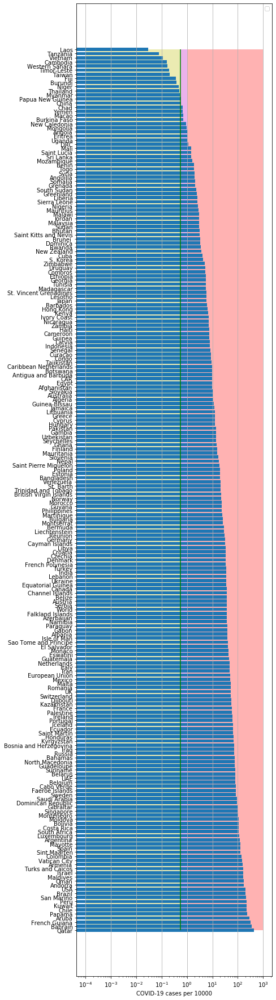

In [2049]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


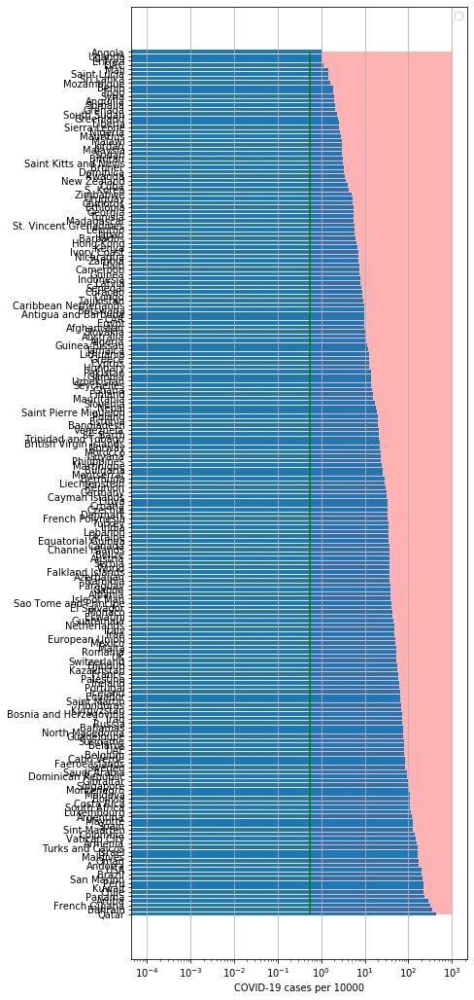

In [2050]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

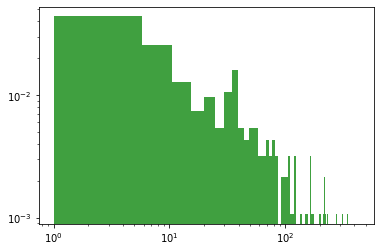

In [2051]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [2052]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
206 2020-09-08  534513       0  29594.0
207 2020-09-09  543379       0  29628.0
208 2020-09-10  554143       0  29699.0
209 2020-09-11  576697       0  29747.0
210 2020-09-12  576697       0  29747.0
GB
           date   cases  active    death
195 2020-09-08  352560       0  41586.0
196 2020-09-09  355219       0  41594.0
197 2020-09-10  358138       0  41608.0
198 2020-09-11  361677       0  41614.0
199 2020-09-12  365174       0  41623.0
IT
           date   cases  active    death
198 2020-09-08  280153   33789  35563.0
199 2020-09-09  281583   34734  35577.0
200 2020-09-10  283180   35708  35587.0
201 2020-09-11  284796   36767  35597.0
202 2020-09-12  286297   37503  35603.0
LT
           date   cases  active  death     tests
183 2020-09-08  3163.0    1069   86.0  676600.0
184 2020-09-09  3199.0    1083   86.0  682097.0
185 2020-09-10  3243.0    1108   86.0  687118.0
186 2020-09-11  3296.0    1127   86.0  692118.0
187 2020-09-12  3335.0  

In [2053]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [2054]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5035929976662356
intercept: 1.2795642551521844
slope: [0.02040183]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


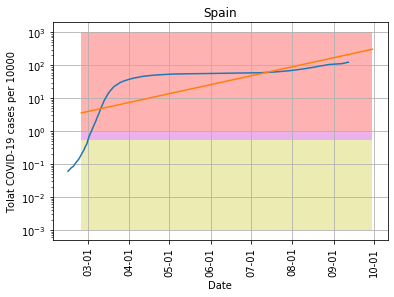

In [2055]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-09-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [2056]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5503645800395384
intercept: -0.6337589698429853
slope: [0.03126503]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


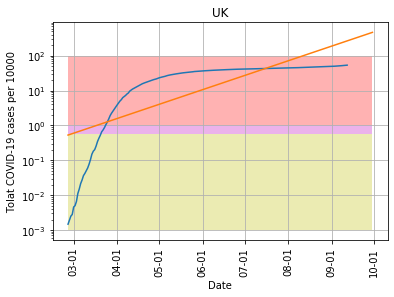

In [2057]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-09-30', "pictures/coronaGB.png", model1, 'UK',100)

In [2058]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 5.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.633108481935024
intercept: 1.0546771957528247
slope: [-0.0073539]


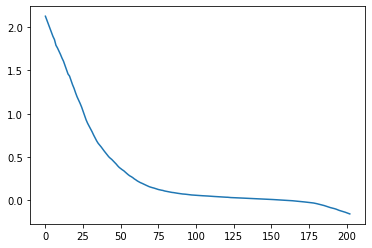

In [2059]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


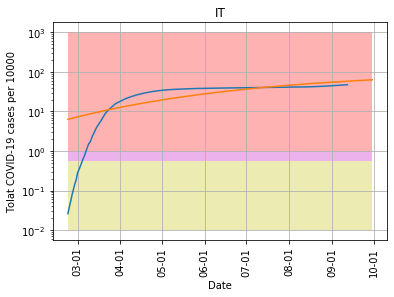

In [2060]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-09-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [2061]:
cs=y_pred11[-1]/10000.*populationIT

In [2062]:
cs

381388.75291144504

In [2063]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.45093290106629963
intercept: -0.11130244615324258
slope: [0.01682304]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


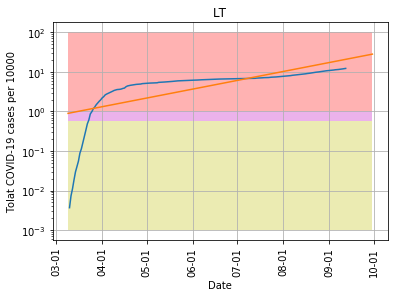

In [2064]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-09-30', "pictures/coronaLT.png", model1, 'LT',100)

In [2065]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7065497256564574
intercept: -2.6034066256033155
slope: [0.03971905]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


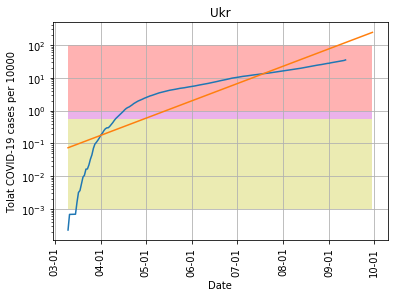

In [2066]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-09-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


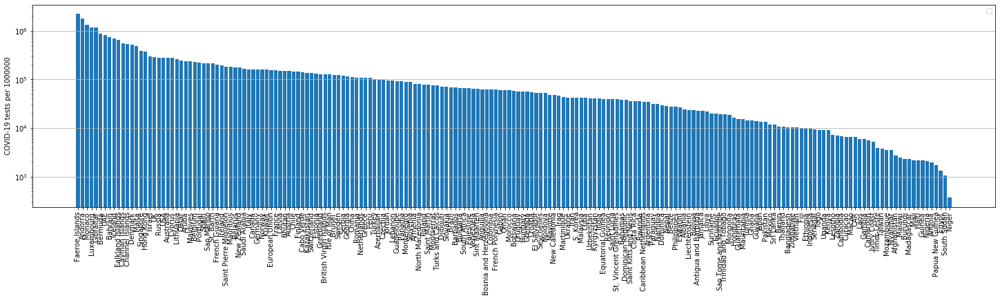

In [2067]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [2068]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6353480527858468
intercept: -0.24091948575342803
slope: [0.03600147]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


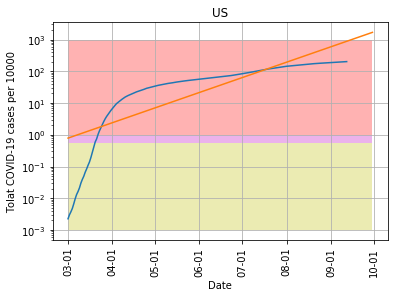

In [2069]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-09-30', "pictures/coronaUS.png", model11, 'US',1000)

In [2070]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.064402


Text(0.5, 1.0, 'Death rate')

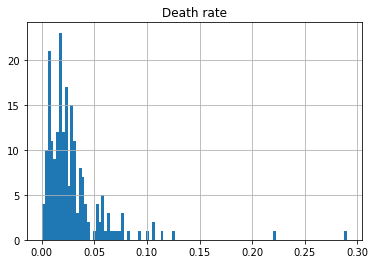

In [2071]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

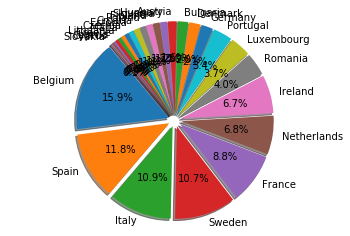

In [2072]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [2073]:
dfTTh.head()

,Country,Deathsper1Mpop
42,Belgium,855.0
15,Spain,636.0
26,Italy,589.0
44,Sweden,578.0
19,France,473.0


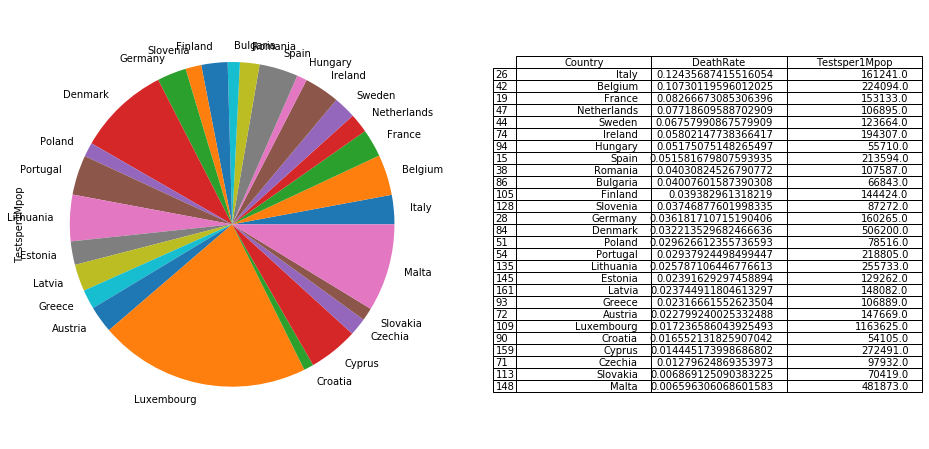

In [2074]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

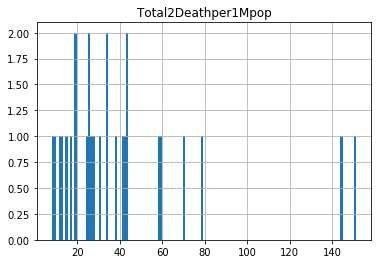

In [2075]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [2076]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,12334.0,636.0
19,France,5726.0,473.0
26,Italy,4737.0,589.0
28,Germany,3108.0,112.0
38,Romania,5330.0,215.0


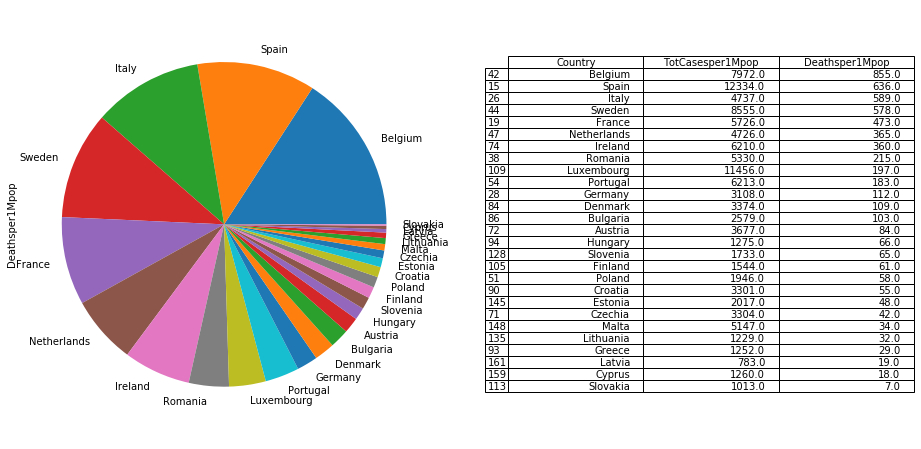

In [2077]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [2078]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,7950458,6789.0,289160.0,431.0,4835669.0,"+5,032",2825629,18336.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,8489498,7970.0,162628.0,96.0,6864343.0,"+26,714",1462527,19357.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,7073893,810.0,227166.0,47.0,5771324.0,"+1,556",1075403,15251.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1352693,0.0,32556.0,0.0,1096779.0,0,223358,1486.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [2079]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.057745
19,France,0.037392
26,Italy,0.029378
28,Germany,0.019393
38,Romania,0.049541


In [2080]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.069179
     Croatia             0.061011
       Spain             0.057745
     Romania             0.049541
 Netherlands             0.044212
    Bulgaria             0.038583
      France             0.037392
     Belgium             0.035574
     Czechia             0.033738
     Ireland             0.031960
       Italy             0.029378
    Portugal             0.028395
     Austria             0.024900
      Poland             0.024785
     Hungary             0.022886
    Slovenia             0.019857
     Germany             0.019393
     Estonia             0.015604
    Slovakia             0.014385
      Greece             0.011713
     Finland             0.010691
       Malta             0.010681
  Luxembourg             0.009845
     Denmark             0.006665
      Latvia             0.005288
   Lithuania             0.004806
      Cyprus             0.004624


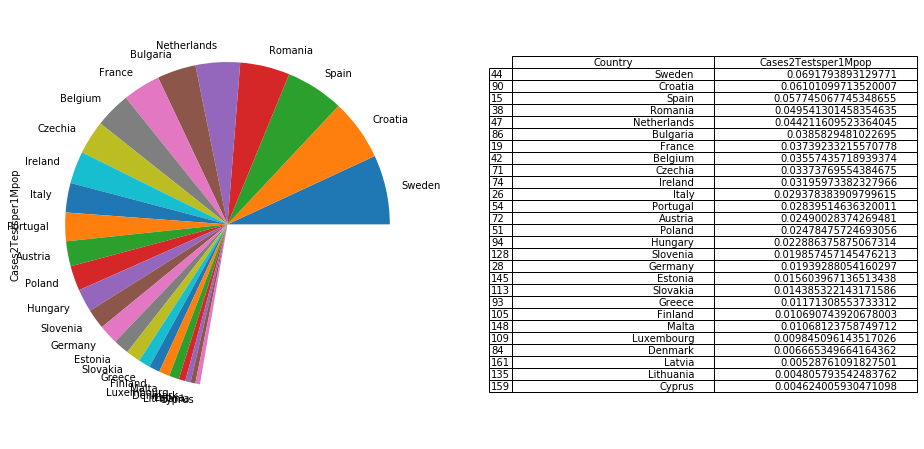

In [2081]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [2082]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
57,Singapore,0.000470,389295.0
34,Qatar,0.001687,244262.0
169,French Polynesia,0.002099,61056.0
180,Burundi,0.002123,2328.0
102,Maldives,0.003535,237928.0
...,...,...,...
42,Belgium,0.107301,224094.0
20,UK,0.113981,283901.0
26,Italy,0.124357,161241.0
219,MS Zaandam,0.222222,0.0


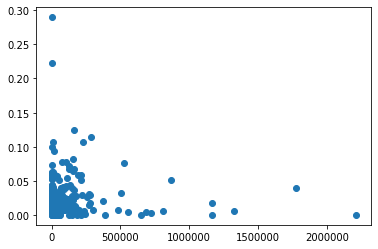

In [2083]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


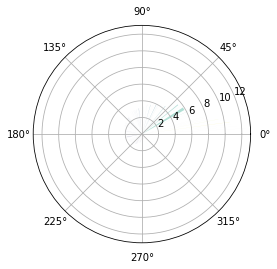

In [2084]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

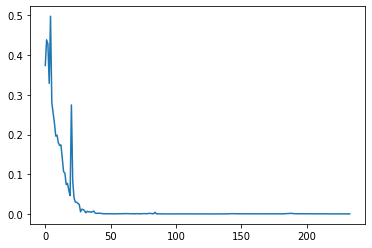

In [2085]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [2086]:
#np.diff(np.log(dfCN["cases"].values))

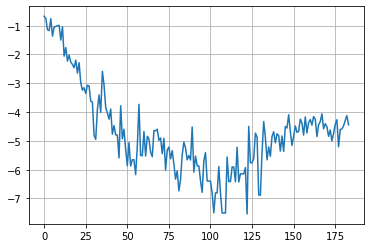

In [2087]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

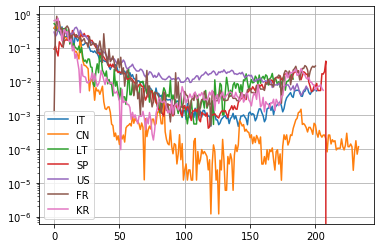

In [2088]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

195 195
coefficient of determination: 0.7084896869009908
intercept: -12.345306398875334
slope: [-0.05277947]


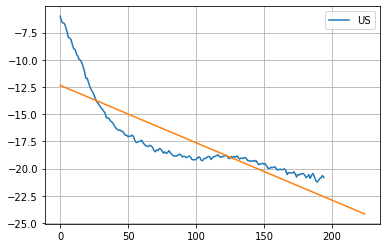

In [2089]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [2090]:
#np.diff(dfIT["cases"])

202 202
coefficient of determination: 0.5933693597818452
intercept: -12.879643819465645
slope: [-0.04043074]


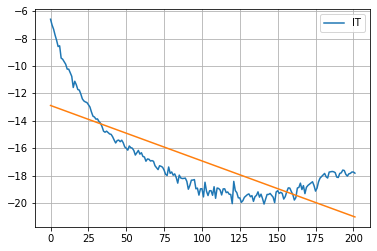

In [2091]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [2092]:
#model11.coef_

In [2093]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

184 184
coefficient of determination: 0.8749868752363824
intercept: -16.303924616989676
slope: [-0.03418601]


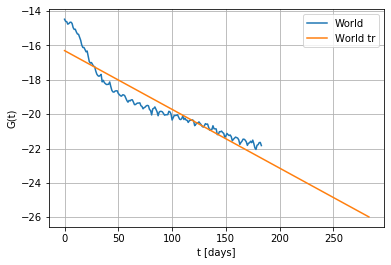

In [2094]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

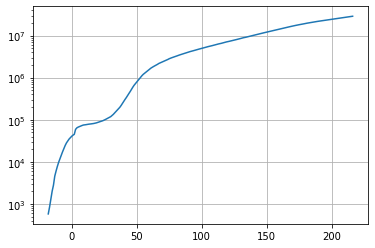

In [2095]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [2096]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.00331001e+08  2.92605646e-01 -1.99804631e+02  2.75892132e-02]


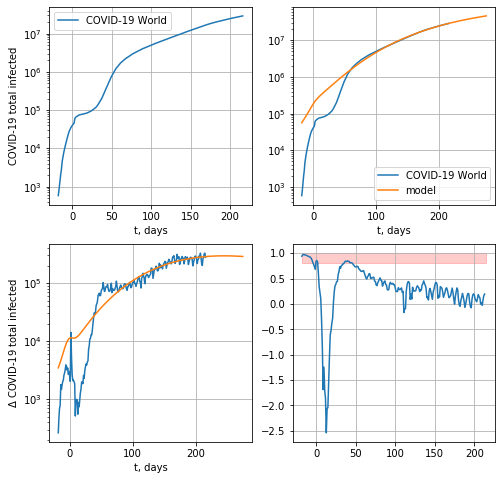

273374.656844432


In [2097]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

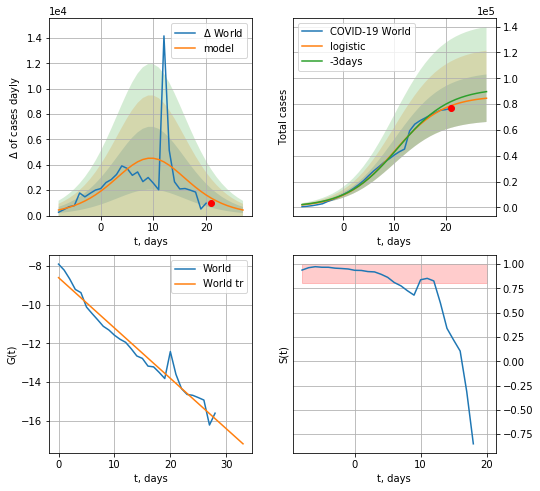

World data at: 2020-09-12
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +7 days
	 deltaDaycases:  439
	 total cases:  84536 ± 18412
	 total death:  2699 ± 1763
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


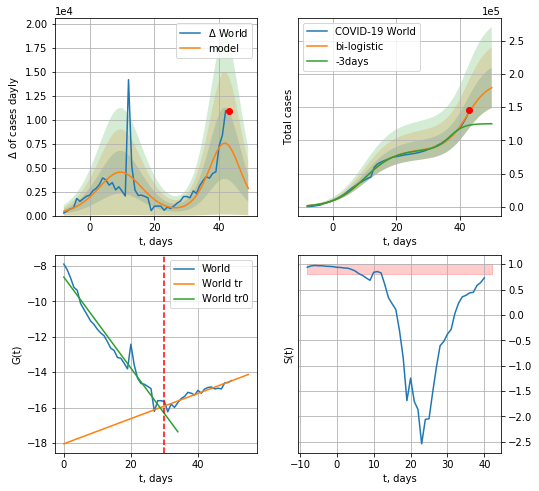

World data at: 2020-09-12
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +7 days
	 deltaDaycases:  2839
	 total cases:  179325 ± 30472
	 total death:  5727 ± 2919
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


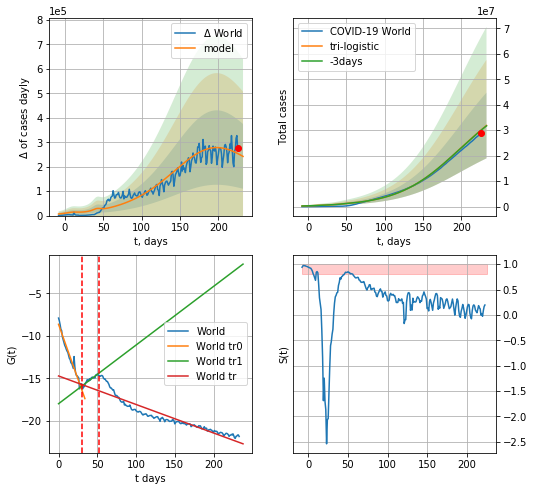

World data at: 2020-09-12
+3 day model MAPE: 0.003927950539875614
model: tri-logistic
coeffs:  [4.04443033e+07 2.55769487e-02 1.93052014e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.40507933983785066
forecast at the end of period: +7 days
	 deltaDaycases:  242095
	 total cases:  31853565 ± 12903221
	 total death:  1017303 ± 1236265
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.875884
 intercept: -14.707132
 slope: -0.033534


In [2098]:
vL = 30
T18 = 25
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

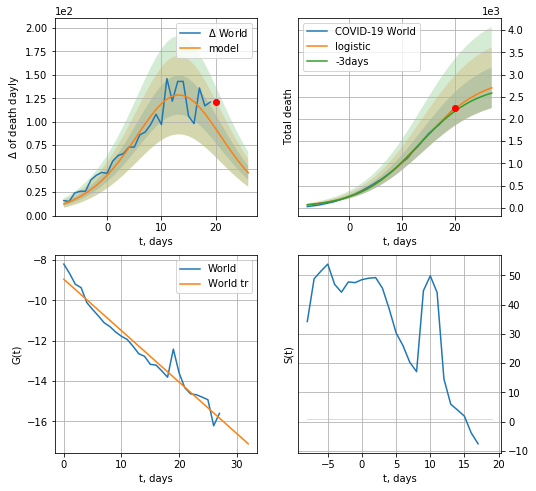

World data at: 2020-09-12
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +7 days
	 total death:  2700 ± 457
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


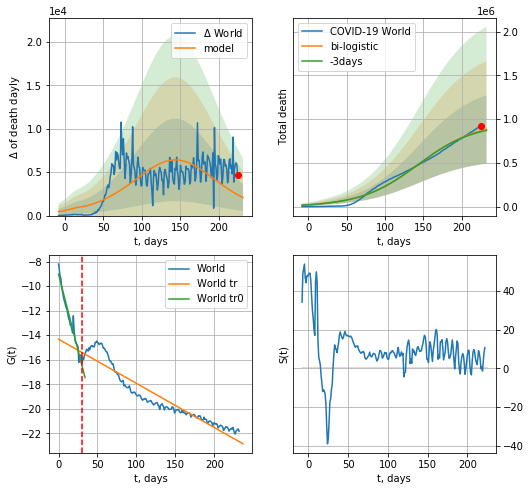

World data at: 2020-09-12
+3 day model MAPE: 0.011963631018347836
model: bi-logistic
coeffs:  [9.63168137e+05 2.66581932e-02 1.43792112e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.44276906837990343
forecast at the end of period: +7 days
	 deltaDaydeath:  2060
	 total death:  882390 ± 390695
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.898924
 intercept: -14.326243
 slope: -0.035964


In [2099]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [2100]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


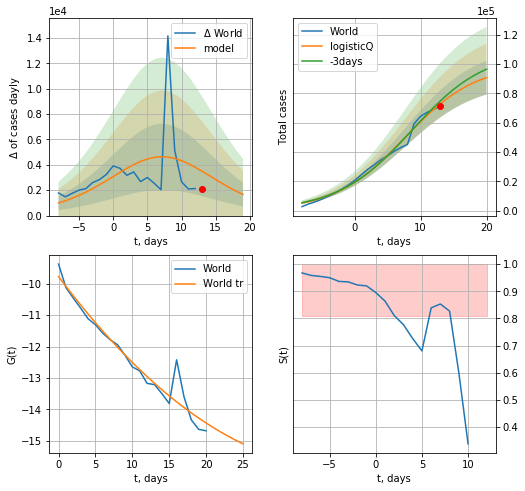

World data at: 2020-09-12
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +7 days
	 deltaDaycases: 1662
	 total cases: 90765 ± 11523
	 total death: 2898 ± 1103
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


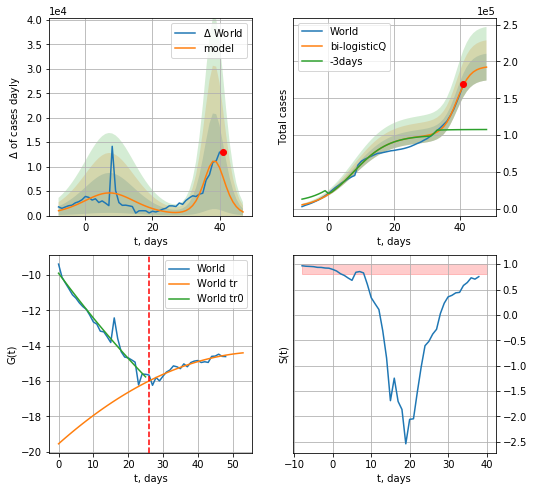

World data at: 2020-09-12
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +7 days
	 deltaDaycases: 744
	 total cases: 192353 ± 18215
	 total death: 6143 ± 1745
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


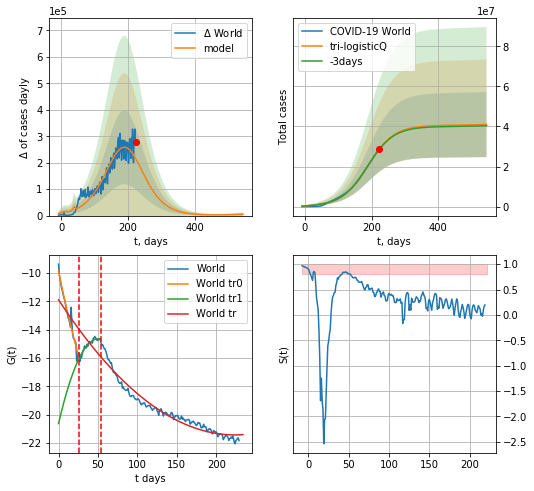

World data at: 2020-09-12
+3 day model MAPE: 0.005016
model: tri-logisticQ
coeffs: [ 4.03826030e+07  2.31818111e-07  1.88949028e+02 -1.10302764e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396358
forecast at the end of period: +322 days
	 deltaDaycases: 4862
	 total cases: 40953195 ± 16232133
	 total death: 1307916 ± 1555209
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.955163
 intercept_: -11.890622110752117
 coeffs_: [ 0.         -0.08530454  0.00019077]


In [2101]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


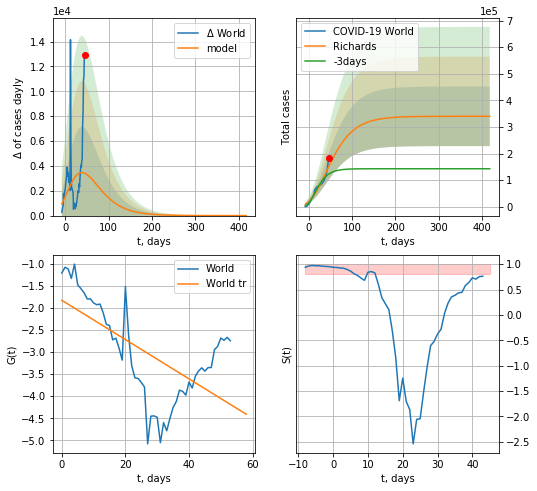

World data at: 2020-09-12
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +372 days
	 deltaDaycases: 0
	 total cases: 340067 ± 111976
	 total death: 10860 ± 10727
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


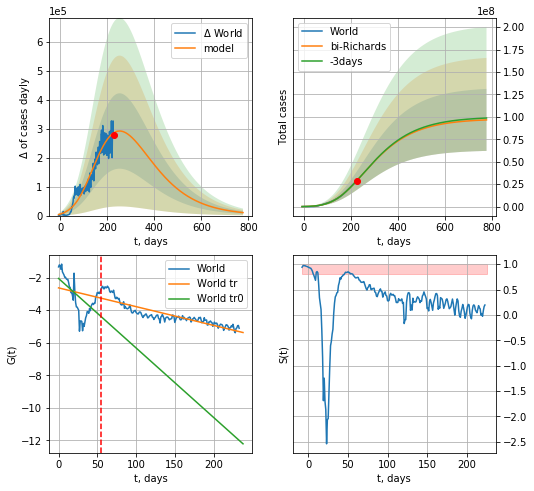

World data at: 2020-09-12
+3 day model MAPE: 0.001381
model: bi-Richards
coeffs: [ 9.74998511e+07  3.04755722e-01 -1.84527138e+02  2.71044983e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.357517
forecast at the end of period: +552 days
	 deltaDaycases: 10385
	 total cases: 96581012 ± 34529339
	 total death: 3084495 ± 3308276
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.366999
 intercept: -2.053805
 slope: -0.042676
trend coefficient of determination: 0.782352
 intercept: -2.632922
 slope: -0.011520


In [2102]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

235


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


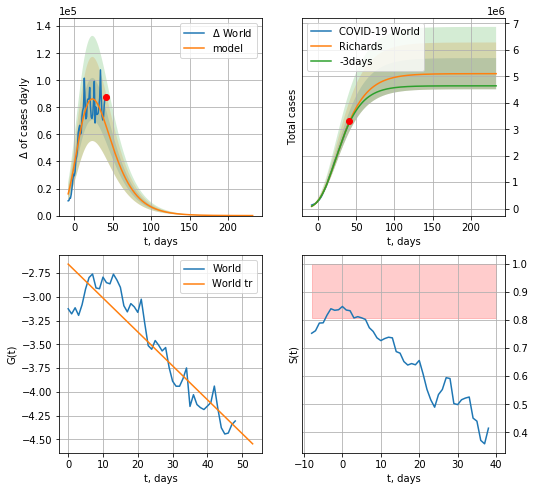

World data at: 2020-09-12
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +192 days
	 deltaDaycases: 13
	 total cases: 5102256 ± 589451
	 total death: 162950 ± 56475
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


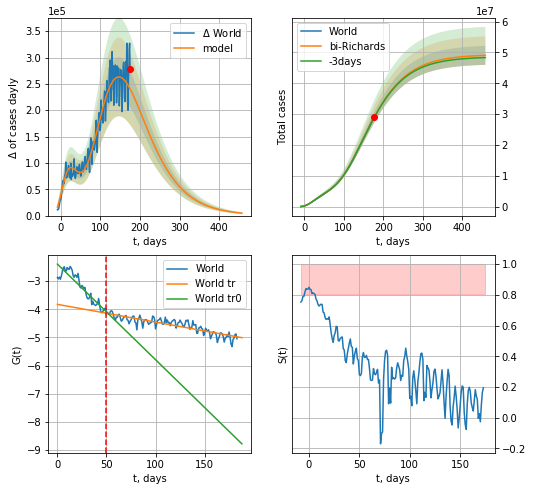

World data at: 2020-09-12
+3 day model MAPE: 0.002474
model: bi-Richards
coeffs: [ 4.42232660e+07  7.01232418e-01 -8.25880498e+01  2.32734460e-02]
rational stdev: 0.062581
forecast at the end of period: +282 days
	 deltaDaycases: 4578
	 total cases: 49046646 ± 3069384
	 total death: 1566396 ± 294079
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.846273
 intercept: -2.394188
 slope: -0.033946
trend coefficient of determination: 0.768474
 intercept: -3.823477
 slope: -0.006291


In [2103]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


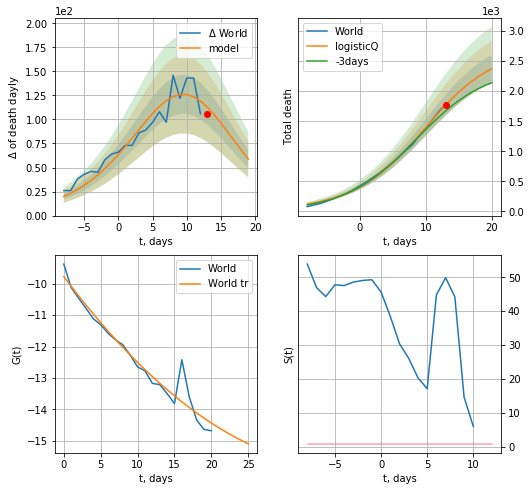

World data at: 2020-09-12
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +7 days
	 total death: 2372 ± 232
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


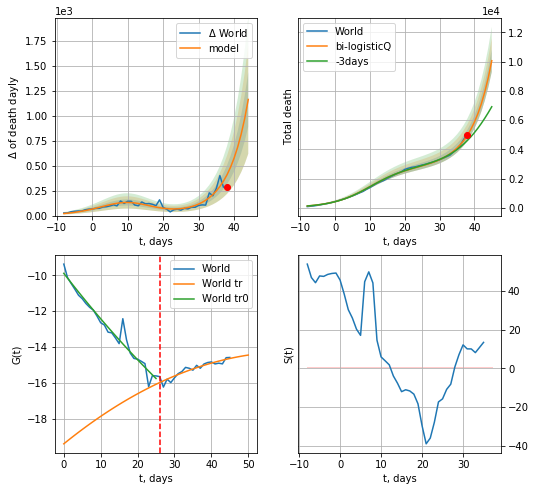

World data at: 2020-09-12
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +7 days
	 total death: 10056 ± 770
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:477: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


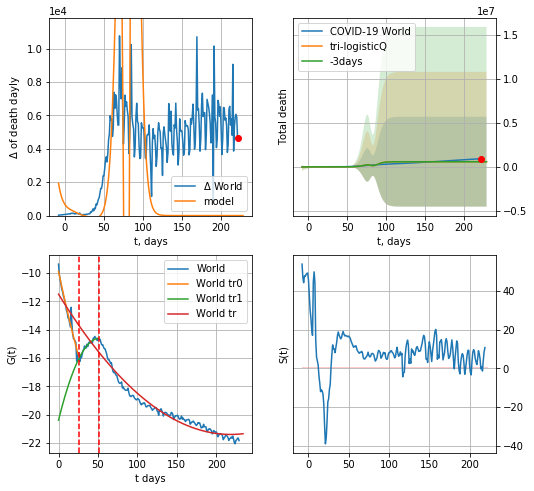

World data at: 2020-09-12
+3 day model MAPE: 0.013772
model: tri-logisticQ
coeffs: [-5.85984371e+06  2.13859716e-03 -3.91926045e+01  7.92606443e+01]
rational stdev: 8.775908
forecast at the end of period: +7 days
	 total death: 582930 ± 5115742
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.955083
 intercept_: -11.497853016151321
 coeffs_: [ 0.         -0.09066238  0.00020767]


In [2104]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


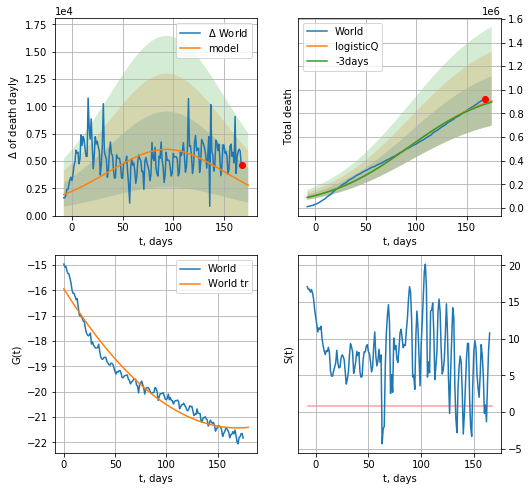

World data at: 2020-09-12
+3 day model MAPE: 0.009297
model: logisticQ
coeffs: [ 1.04019796e+06  9.64503703e-07  9.36163925e+01 -2.40601146e+04]
rational stdev: 0.230850
forecast at the end of period: +7 days
	 total death: 905133 ± 208949
trend coefficient of determination: 0.955163
 intercept_: -15.940715317350392
 coeffs_: [ 0.         -0.06470406  0.00019078]


In [2105]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [2106]:
#trend(dfSP,'SP',10)

In [2107]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
206 2020-09-08  534513       0  29594.0
207 2020-09-09  543379       0  29628.0
208 2020-09-10  554143       0  29699.0
209 2020-09-11  576697       0  29747.0
210 2020-09-12  576697       0  29747.0


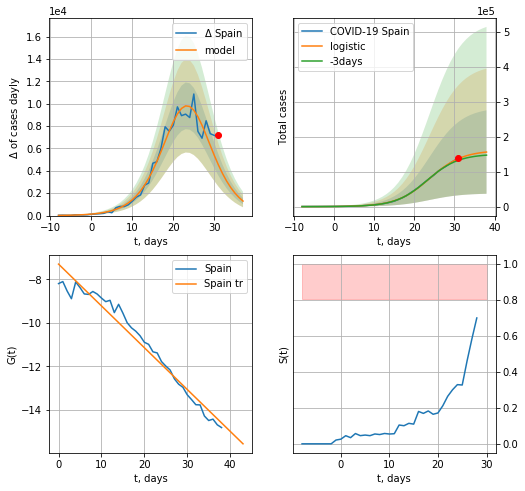

Spain data at: 2020-09-12
+3 day model MAPE: 0.04065647450118455
model: logistic
coeffs:  [1.61048783e+05 2.44209245e-01 2.38061166e+01]
rational stdev:  0.7646314126726975
forecast at the end of period: +7 days
	 deltaDaycases:  1297
	 total cases:  156171 ± 119413
	 total death:  8055 ± 18477
trend coefficient of determination: 0.963842
 intercept: -7.302330
 slope: -0.192029
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


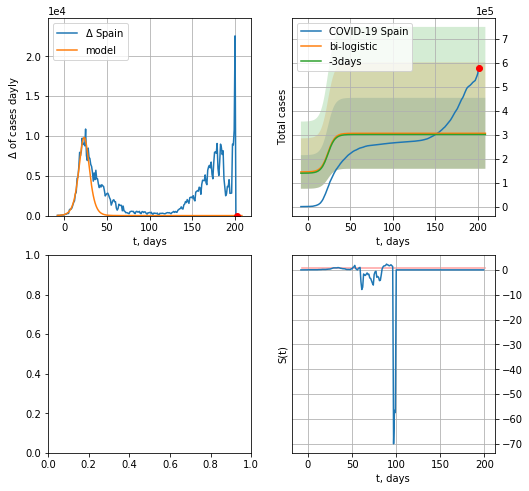

In [2108]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


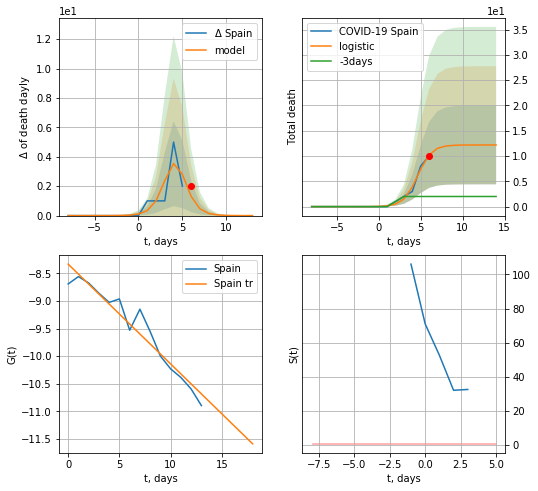

Spain data at: 2020-09-11
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +8 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


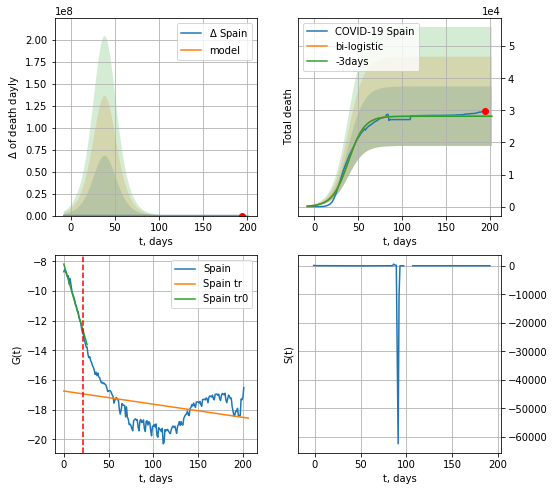

Spain data at: 2020-09-11
+3 day model MAPE: 0.0013734717190930993
model: bi-logistic
coeffs:  [2.81812202e+04 1.10361153e-01 3.87743954e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.3288604607045956
forecast at the end of period: +8 days
	 deltaDaydeath:  0
	 total death:  28193 ± 9271
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.103495
 intercept: -16.736299
 slope: -0.008865


In [1709]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


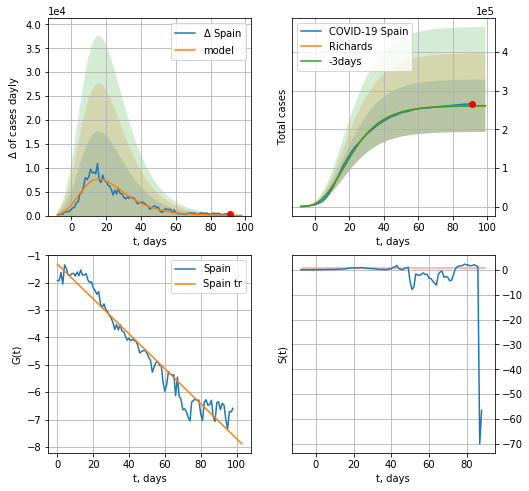

Spain data at: 2020-09-11
+3 day model MAPE: 0.002063
model: Richards
coeffs: [ 2.61234581e+05  1.11545617e+01 -4.55891964e+01  7.16375241e-03]
rational stdev: 0.259932
forecast at the end of period: +8 days
	 deltaDaycases: 29
	 total cases: 260884 ± 67812
	 total death: 13456 ± 10492
trend coefficient of determination: 0.950456
 intercept: -1.320749
 slope: -0.063751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


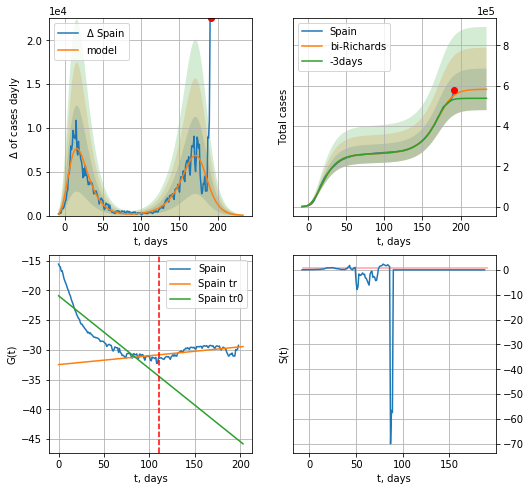

Spain data at: 2020-09-11
+3 day model MAPE: 0.039927
model: bi-Richards
coeffs: [3.21239299e+05 5.61558805e-02 1.77403076e+02 1.96123754e+00]
rational stdev: 0.177217
forecast at the end of period: +43 days
	 deltaDaycases: 37
	 total cases: 582152 ± 103167
	 total death: 30028 ± 15964
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.796795
 intercept: -20.907914
 slope: -0.122723
trend coefficient of determination: 0.262058
 intercept: -32.490667
 slope: 0.014941


In [1718]:
iL = 10
vL = 110+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[iL:],d1,7*30-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


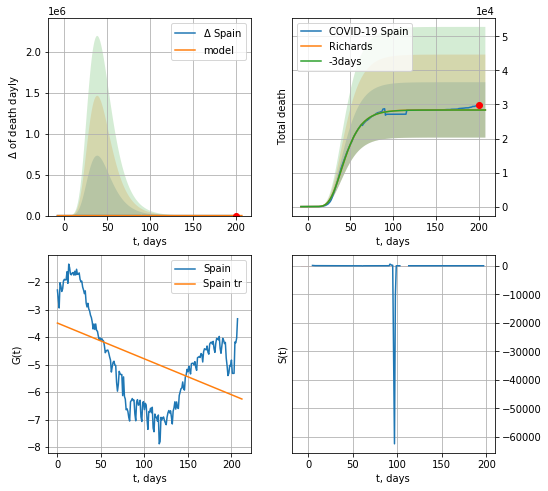

Spain data at: 2020-09-11
+3 day model MAPE: 0.001289
model: Richards
coeffs: [ 2.84003261e+04  1.08381231e+01 -2.76760721e+01  6.89726058e-03]
rational stdev: 0.286052
forecast at the end of period: +8 days
	 total death: 28400 ± 8123
trend coefficient of determination: 0.217264
 intercept: -3.490038
 slope: -0.013016


In [1719]:
x = forecastRR('Spain',dfSP[1:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


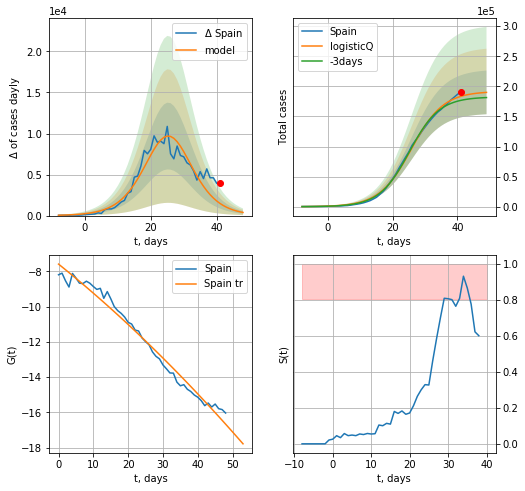

Spain data at: 2020-09-11
+3 day model MAPE: 0.039620
model: logisticQ
coeffs: [ 1.91639792e+05  4.37629447e-06  2.57854469e+01 -4.62652240e+04]
rational stdev: 0.190974
forecast at the end of period: +8 days
	 deltaDaycases: 382
	 total cases: 189921 ± 36270
	 total death: 9796 ± 5612
trend coefficient of determination: 0.980342
 intercept_: -7.592220633878184
 coeffs_: [ 0.         -0.15834655 -0.00063881]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


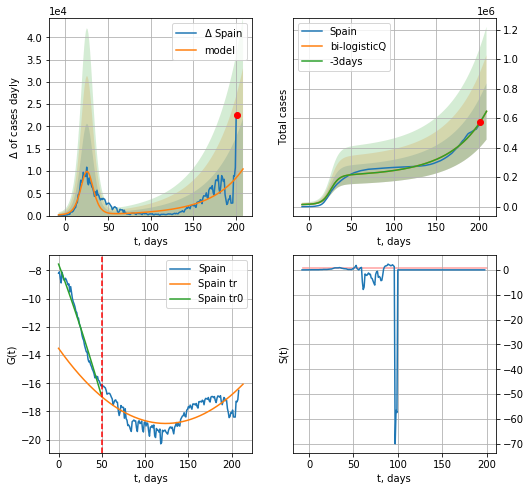

Spain data at: 2020-09-11
+3 day model MAPE: 0.001448
model: bi-logisticQ
coeffs: [ 4.33415758e+08  3.41784042e-05  4.30597164e+02 -6.96980429e+02]
rational stdev: 0.296001
forecast at the end of period: +8 days
	 deltaDaycases: 10455
	 total cases: 644986 ± 190916
	 total death: 33269 ± 29542
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980214
 intercept_: -7.556685473365861
 coeffs_: [ 0.         -0.16443157 -0.0004811 ]
trend coefficient of determination: 0.479175
 intercept_: -13.523112382776304
 coeffs_: [ 0.         -0.08619182  0.00034864]


In [1720]:
x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


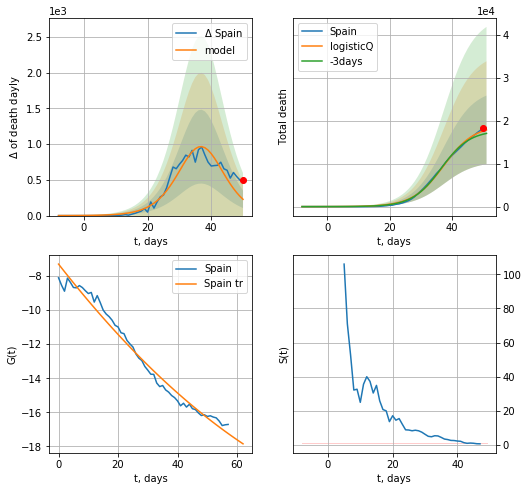

Spain data at: 2020-09-11
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +1 days
	 total death: 17878 ± 8003
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


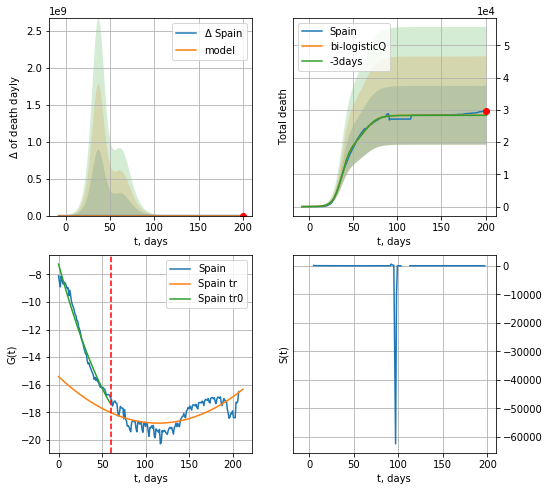

Spain data at: 2020-09-11
+3 day model MAPE: 0.001437
model: bi-logisticQ
coeffs: [ 9.35904016e+03  3.01961731e-07  6.33374370e+01 -4.52894163e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321911
forecast at the end of period: +1 days
	 total death: 28337 ± 9122
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.433511
 intercept_: -15.411092721087709
 coeffs_: [ 0.         -0.05912241  0.00025849]


In [1721]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [1722]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

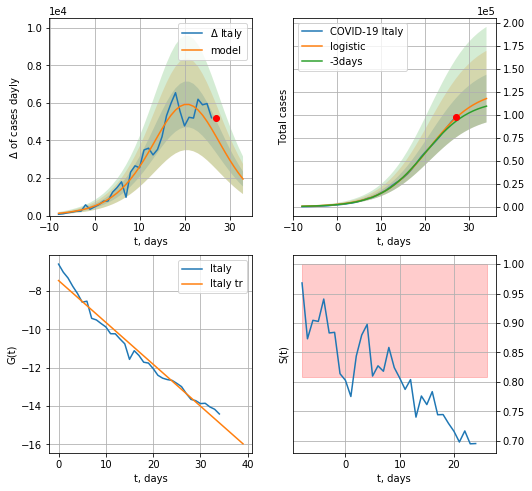

Italy data at: 2020-09-12
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +7 days
	 deltaDaycases:  1946
	 total cases:  117526 ± 25932
	 total death:  14615 ± 9674
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp


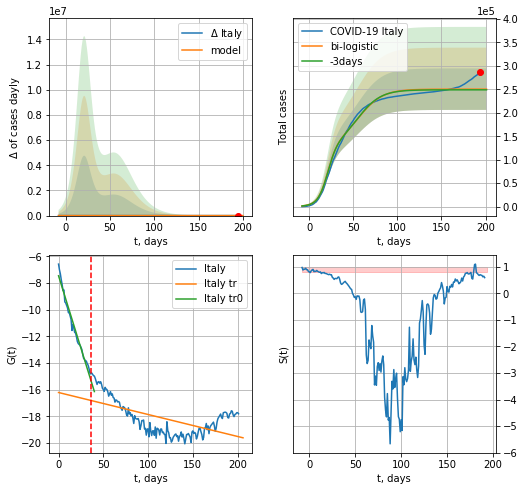

Italy data at: 2020-09-12
+3 day model MAPE: 0.005746270092949991
model: bi-logistic
coeffs:  [1.22230389e+05 7.37280236e-02 5.58524546e+01] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.17655417776792942
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  250366 ± 44203
	 total death:  31134 ± 16490
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.354032
 intercept: -16.220454
 slope: -0.016487


In [2109]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

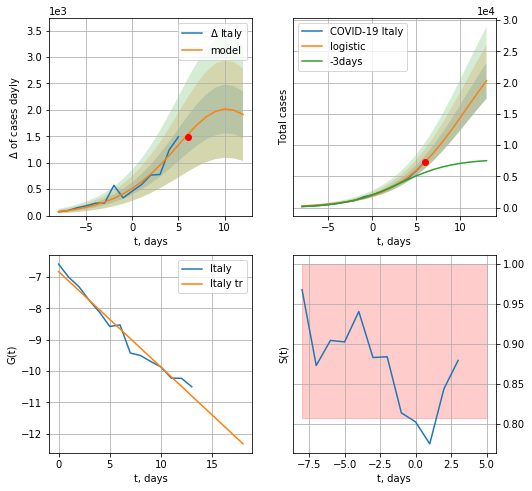

Italy data at: 2020-09-12
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +7 days
	 deltaDaycases:  1911
	 total cases:  20287 ± 2870
	 total death:  2522 ± 1070
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


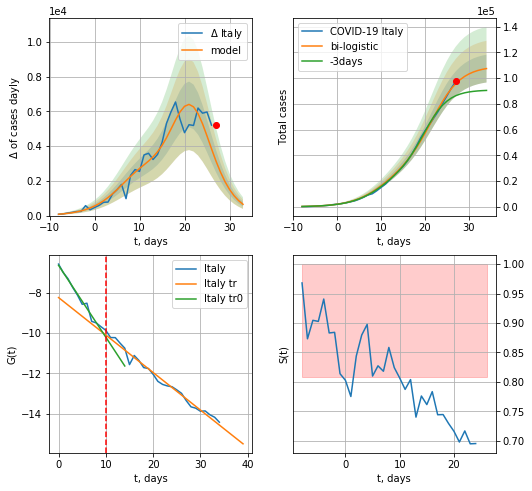

Italy data at: 2020-09-12
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +7 days
	 deltaDaycases:  651
	 total cases:  107480 ± 10801
	 total death:  13365 ± 4029
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


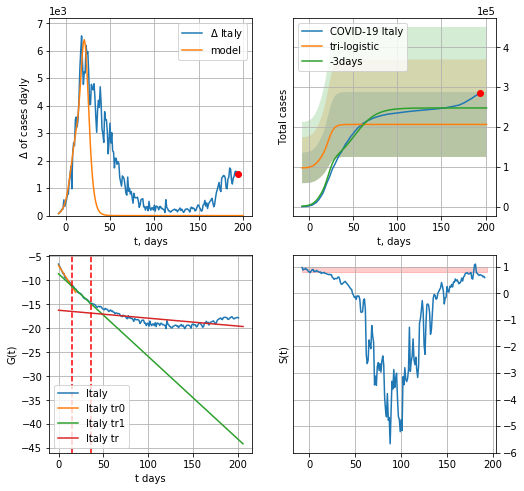

Italy data at: 2020-09-12
+3 day model MAPE: 0.16701862792736166
model: tri-logistic
coeffs:  [ 9.71725066e+04 -5.07834755e-01  2.34765509e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.39530855343507787
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  206534 ± 81644
	 total death:  25684 ± 30459
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.354032
 intercept: -16.220454
 slope: -0.016487


In [2110]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

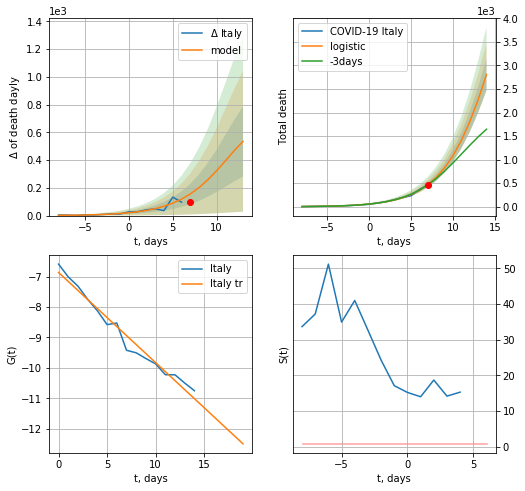

Italy data at: 2020-09-12
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +7 days
	 total death:  2806 ± 337
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


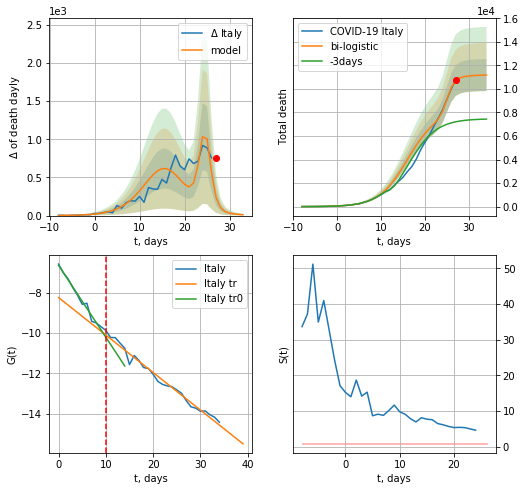

Italy data at: 2020-09-12
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +7 days
	 deltaDaydeath:  11
	 total death:  11180 ± 1361
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


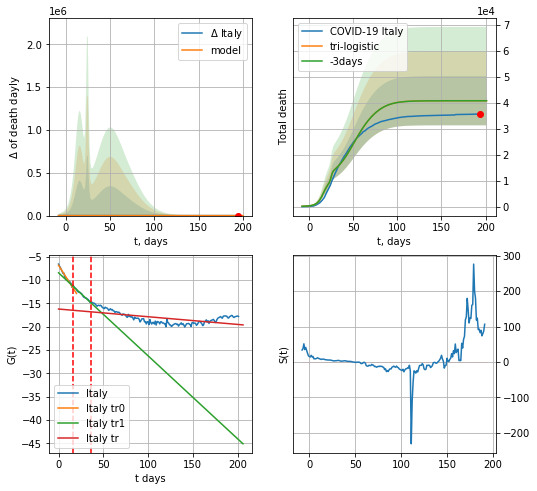

Italy data at: 2020-09-12
+3 day model MAPE: 0.0007390026772495754
model: tri-logistic
coeffs:  [2.36038913e+04 9.32912580e-02 4.91839209e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.23221241776529686
forecast at the end of period: +7 days
	 deltaDaydeath:  0
	 total death:  40716 ± 9454
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.354032
 intercept: -16.220454
 slope: -0.016487


In [2111]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


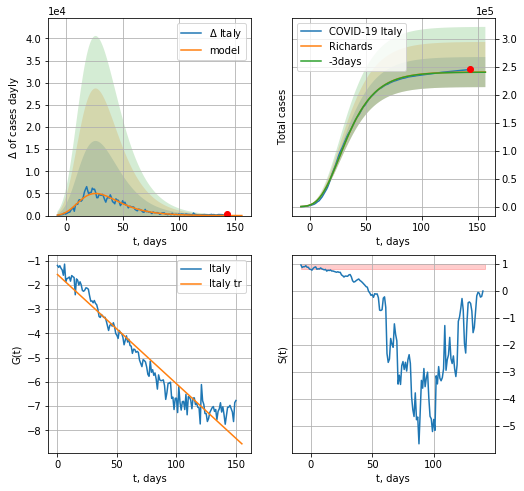

Italy data at: 2020-09-12
+3 day model MAPE: 0.001137
model: Richards
coeffs: [ 2.40825315e+05  8.29717345e+00 -6.16464143e+01  6.82557212e-03]
rational stdev: 0.111816
forecast at the end of period: +14 days
	 deltaDaycases: 8
	 total cases: 240677 ± 26911
	 total death: 29929 ± 10039
trend coefficient of determination: 0.940744
 intercept: -1.565853
 slope: -0.045125


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


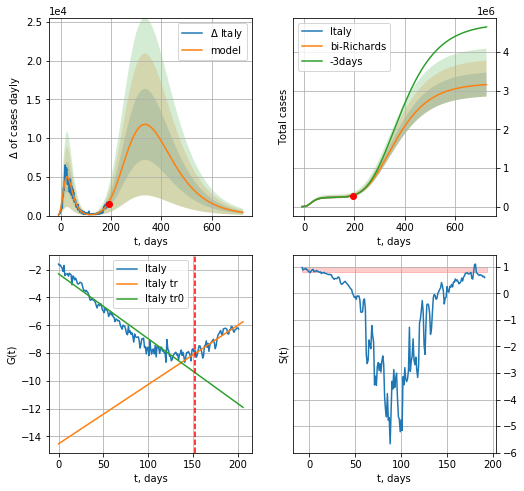

Italy data at: 2020-09-12
+3 day model MAPE: 0.001515
model: bi-Richards
coeffs: [2.95417795e+06 1.39258353e-01 1.12910150e+02 8.09721572e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.098112
forecast at the end of period: +532 days
	 deltaDaycases: 406
	 total cases: 3158965 ± 309931
	 total death: 392839 ± 115626
bi-Richards approximation splitting point: 152
trend coefficient of determination: 0.933689
 intercept: -2.298352
 slope: -0.046651
trend coefficient of determination: 0.824394
 intercept: -14.533909
 slope: 0.042651


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


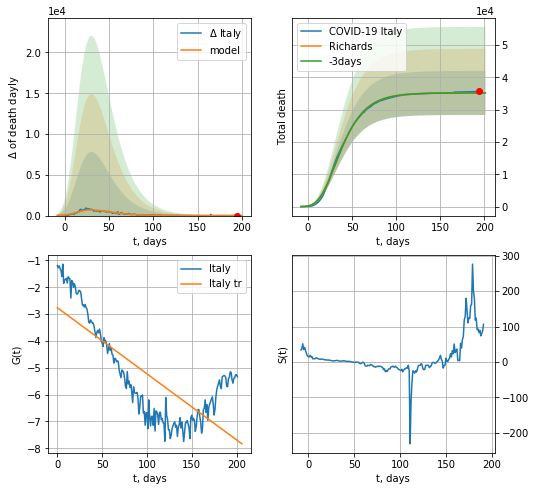

Italy data at: 2020-09-12
+3 day model MAPE: 0.000431
model: Richards
coeffs: [ 3.51462439e+04  8.02893361e+00 -6.20444701e+01  6.70906067e-03]
rational stdev: 0.193622
forecast at the end of period: +7 days
	 total death: 35142 ± 6804
trend coefficient of determination: 0.598173
 intercept: -2.766074
 slope: -0.024605


In [2113]:
vL=152
x = forecastRR('Italy',dfIT[:vL],d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,100*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


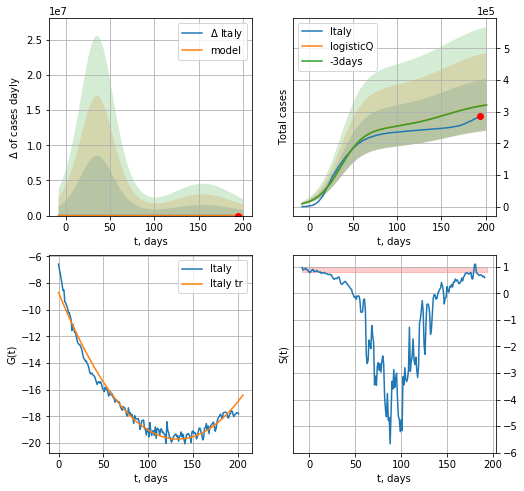

Italy data at: 2020-09-12
+3 day model MAPE: 0.002301
model: logisticQ
coeffs: [ 2.47468261e+05  1.14131813e-07  3.56757041e+01 -6.54489902e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.254695
forecast at the end of period: +7 days
	 deltaDaycases: 432
	 total cases: 321691 ± 81933
	 total death: 40004 ± 30566
trend coefficient of determination: 0.973994
 intercept_: -8.719840939794807
 coeffs_: [ 0.         -0.16522531  0.00062087]


In [2114]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


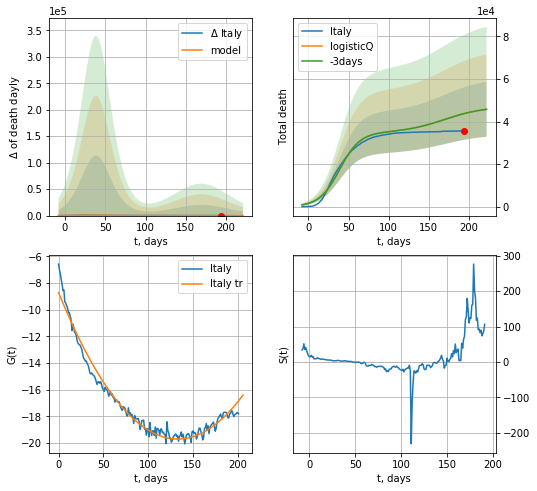

Italy data at: 2020-09-12
+3 day model MAPE: 0.000312
model: logisticQ
coeffs: [ 3.47641409e+04  1.62035799e-07  3.88480347e+01 -4.90356854e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.282241
forecast at the end of period: +28 days
	 total death: 45740 ± 12909
trend coefficient of determination: 0.973994
 intercept_: -8.719840939794807
 coeffs_: [ 0.         -0.16522531  0.00062087]


In [2115]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [2116]:
dT

168

FR
           date     cases  active    death
206 2020-09-08  335524.0  216534  30764.0
207 2020-09-09  344101.0  224783  30794.0
208 2020-09-10  353944.0  234389  30813.0
209 2020-09-11  363350.0  243398  30893.0
210 2020-09-12  373911.0  253942  30910.0


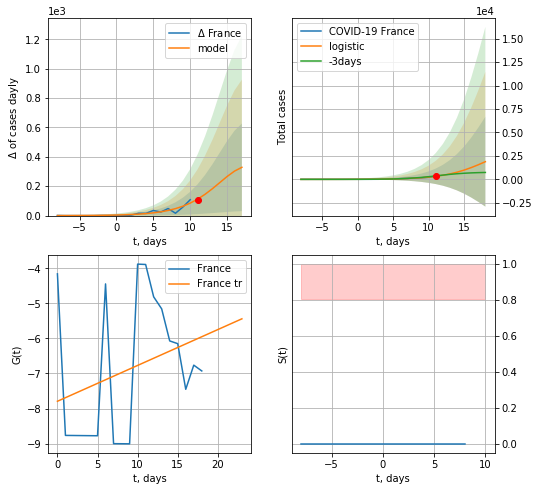

France data at: 2020-09-12
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +7 days
	 deltaDaycases:  328
	 total cases:  1885 ± 4787
	 total death:  155 ± 1180
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


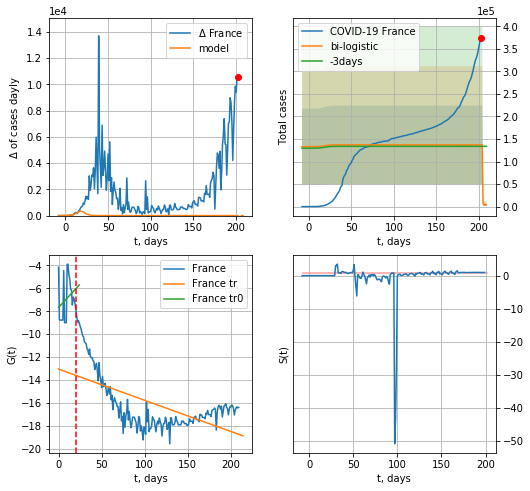

France data at: 2020-09-12
+3 day model MAPE: 0.024472722982046786
model: bi-logistic
coeffs:  [ 1.32762052e+05 -1.15482071e+01  2.04617903e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  0.6366999754604428
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  4173 ± 2657
	 total death:  345 ± 658
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.377448
 intercept: -13.058613
 slope: -0.027265


In [2117]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [2118]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

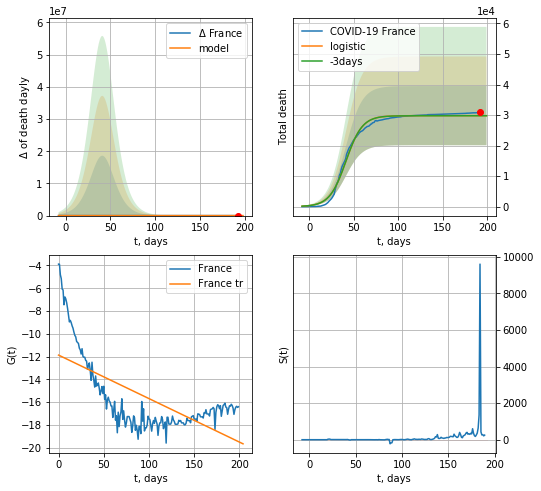

France data at: 2020-09-12
+3 day model MAPE: 0.000986897303164779
model: logistic
coeffs:  [2.98010641e+04 1.08888696e-01 4.12793973e+01]
rational stdev:  0.32523446379367354
forecast at the end of period: +7 days
	 total death:  29801 ± 9692
trend coefficient of determination: 0.450021
 intercept: -11.866010
 slope: -0.038165


In [2119]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


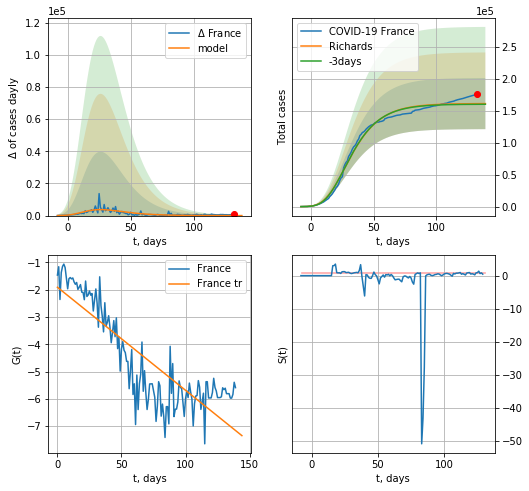

France data at: 2020-09-12
+3 day model MAPE: 0.006316
model: Richards
coeffs: [ 1.60997599e+05  1.46350142e+01 -5.95952768e+01  4.31594545e-03]
rational stdev: 0.248135
forecast at the end of period: +7 days
	 deltaDaycases: 8
	 total cases: 160864 ± 39916
	 total death: 13298 ± 9899
trend coefficient of determination: 0.728995
 intercept: -1.912518
 slope: -0.037751


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


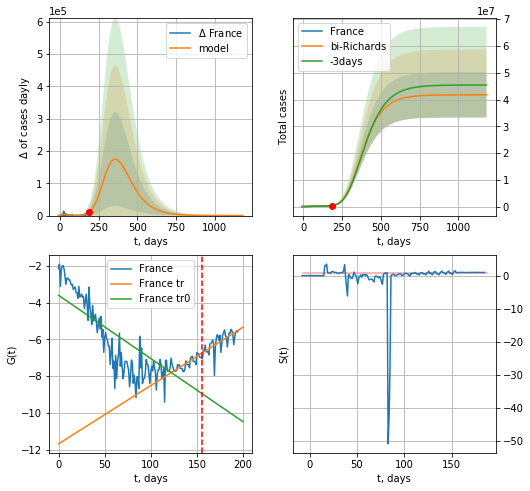

France data at: 2020-09-12
+3 day model MAPE: 0.004413
model: bi-Richards
coeffs: [4.15828500e+07 8.10628052e-02 2.04743828e+02 1.51644232e-01]
rational stdev: 0.202603
forecast at the end of period: +994 days
	 deltaDaycases: 20
	 total cases: 41742184 ± 8457097
	 total death: 3450689 ± 2097361
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.644391
 intercept: -3.598204
 slope: -0.034432
trend coefficient of determination: 0.496544
 intercept: -11.687590
 slope: 0.031761


In [2120]:
vL = 86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,166*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


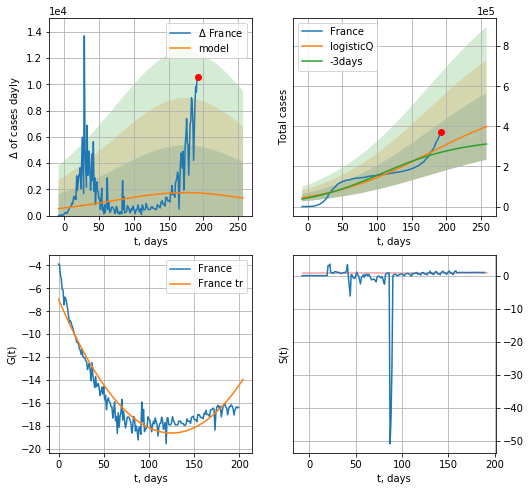

France data at: 2020-09-12
+3 day model MAPE: 0.096933
model: logisticQ
coeffs: [ 5.20791052e+05  4.11337144e-08  1.73562813e+02 -3.22297046e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.414949
forecast at the end of period: +66 days
	 deltaDaycases: 1327
	 total cases: 399103 ± 165607
	 total death: 32992 ± 41070
trend coefficient of determination: 0.912429
 intercept_: -6.946165771177915
 coeffs_: [ 0.         -0.18725173  0.00074918]


In [2121]:
x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


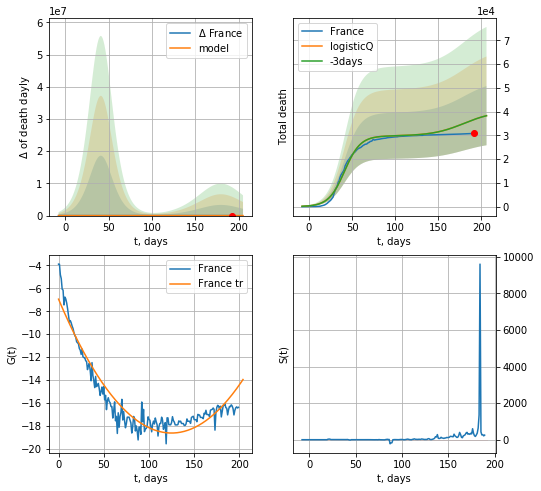

France data at: 2020-09-12
+3 day model MAPE: 0.000377
model: logisticQ
coeffs: [ 2.98010269e+04  2.41272828e-07  4.12797382e+01 -4.51103924e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325282
forecast at the end of period: +14 days
	 total death: 38314 ± 12462
trend coefficient of determination: 0.912429
 intercept_: -6.946165771177915
 coeffs_: [ 0.         -0.18725173  0.00074918]


In [2122]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [2123]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [2124]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
197 2020-09-08  254957   14948  9409.0
198 2020-09-09  256349   15039  9410.0
199 2020-09-10  258107   15388  9419.0
200 2020-09-11  259725   15452  9423.0
201 2020-09-12  260546   15819  9427.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


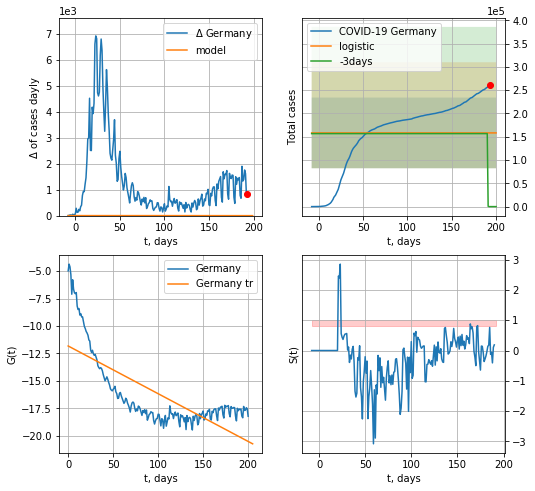

Germany data at: 2020-09-12
+3 day model MAPE: 9.107843608640654e+68
model: logistic
coeffs:  [ 1.58281703e+05 -2.61570993e+00  2.04280326e+02]
rational stdev:  0.4794119137876456
forecast at the end of period: +7 days
	 deltaDaycases:  -2
	 total cases:  158279 ± 75881
	 total death:  5726 ± 8235
trend coefficient of determination: 0.545209
 intercept: -11.823106
 slope: -0.043517


In [2125]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


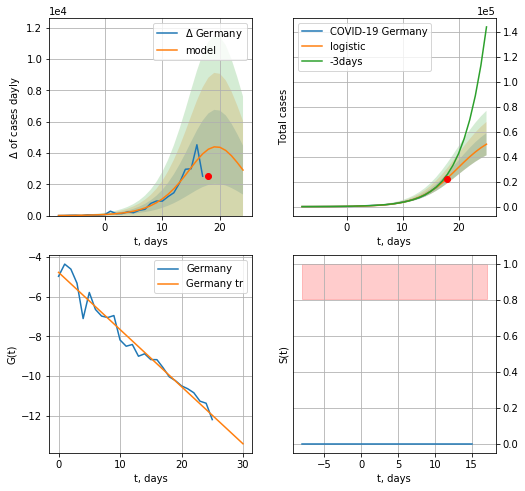

Germany data at: 2020-09-12
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +7 days
	 deltaDaycases:  2908
	 total cases:  50112 ± 8926
	 total death:  1813 ± 968
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


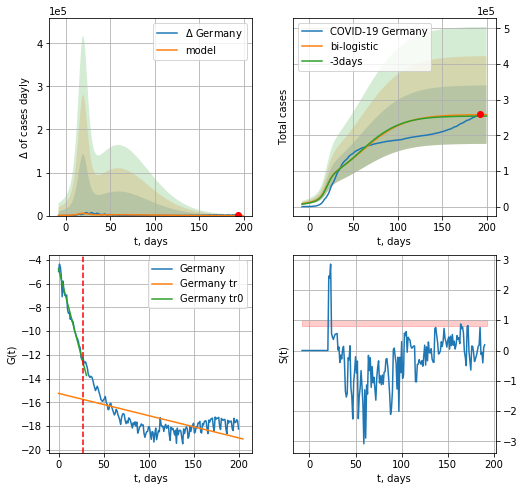

Germany data at: 2020-09-12
+3 day model MAPE: 0.015550027363548513
model: bi-logistic
coeffs:  [1.57519561e+05 4.71728789e-02 5.52028999e+01] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.3179684110998606
forecast at the end of period: +7 days
	 deltaDaycases:  17
	 total cases:  258077 ± 82060
	 total death:  9337 ± 8906
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.400321
 intercept: -15.236749
 slope: -0.018722


In [2126]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [2128]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active   death
197 2020-09-08  254957   14948  9409.0
198 2020-09-09  256349   15039  9410.0
199 2020-09-10  258107   15388  9419.0
200 2020-09-11  259725   15452  9423.0
201 2020-09-12  260546   15819  9427.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


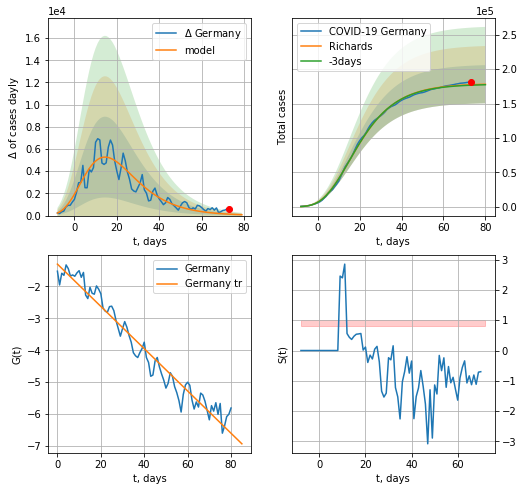

Germany data at: 2020-09-12
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +7 days
	 deltaDaycases: 79
	 total cases: 178156 ± 27778
	 total death: 6445 ± 3014
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


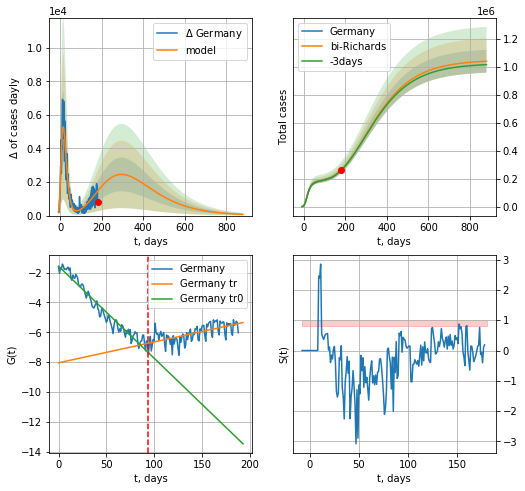

Germany data at: 2020-09-12
+3 day model MAPE: 0.000751
model: bi-Richards
coeffs: [ 8.67918269e+05  3.64026700e-01 -2.00186489e+02  2.13343185e-02]
rational stdev: 0.078678
forecast at the end of period: +700 days
	 deltaDaycases: 70
	 total cases: 1037900 ± 81659
	 total death: 37553 ± 8863
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950631
 intercept: -1.566542
 slope: -0.061686
trend coefficient of determination: 0.419204
 intercept: -8.042349
 slope: 0.013967


In [2129]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,124*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


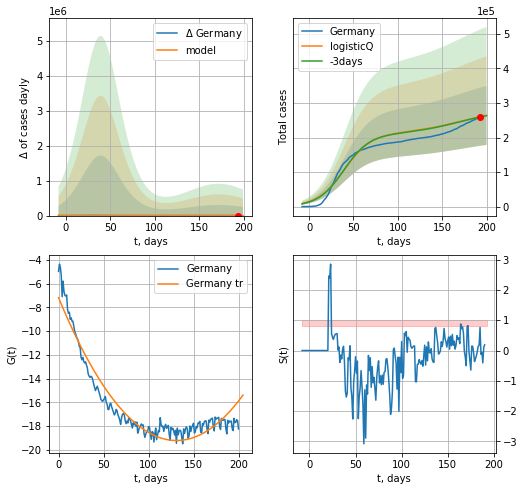

Germany data at: 2020-09-12
+3 day model MAPE: 0.002215
model: logisticQ
coeffs: [ 2.10457735e+05  3.76880222e-08  3.95189438e+01 -1.76773360e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323552
forecast at the end of period: +7 days
	 deltaDaycases: 510
	 total cases: 263906 ± 85387
	 total death: 9548 ± 9267
trend coefficient of determination: 0.924976
 intercept_: -7.1808707650775805
 coeffs_: [ 0.         -0.18348478  0.00069984]


In [2131]:
x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


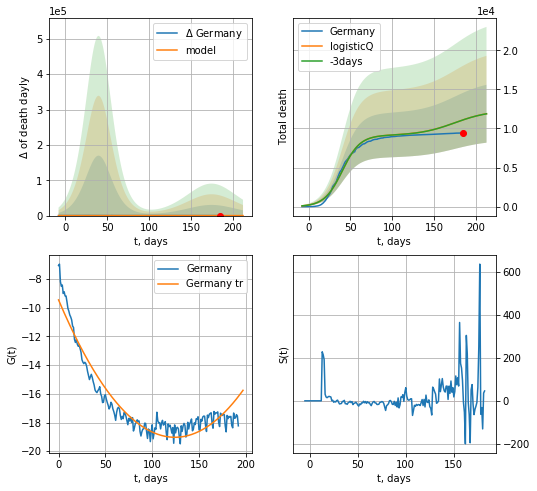

Germany data at: 2020-09-12
+3 day model MAPE: 0.000409
model: logisticQ
coeffs: [ 9.11137252e+03  2.12351897e-07  4.01444792e+01 -4.42318528e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311721
forecast at the end of period: +28 days
	 total death: 11879 ± 3703
trend coefficient of determination: 0.914946
 intercept_: -9.448002643184907
 coeffs_: [ 0.         -0.15416862  0.00062014]


In [2132]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
191 2020-09-08  6514376  2523166  194037.0
192 2020-09-09  6549475  2508141  195239.0
193 2020-09-10  6588181  2511697  196331.0
194 2020-09-11  6636266  2520883  197421.0
195 2020-09-12  6676601  2528119  198128.0


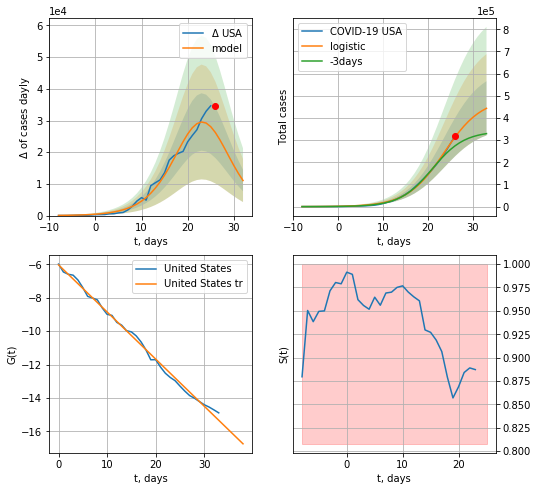

USA data at: 2020-09-12
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +7 days
	 deltaDaycases:  11064
	 total cases:  443300 ± 122382
	 total death:  13154 ± 10894
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


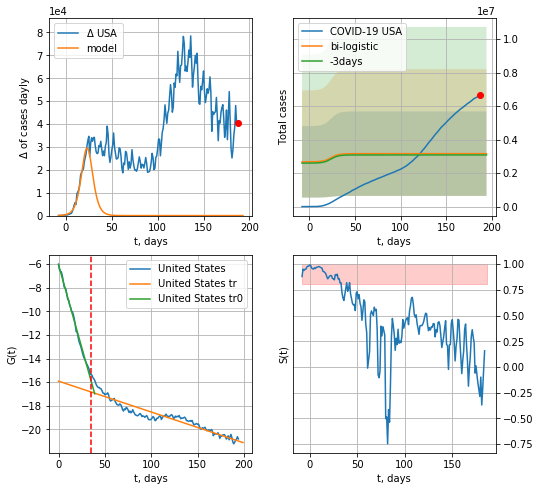

USA data at: 2020-09-12
+3 day model MAPE: 0.025266955818071694
model: bi-logistic
coeffs:  [ 2.13672709e+06 -2.49718100e+01  6.01355590e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7978926378366858
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  3159934 ± 2521288
	 total death:  93770 ± 224455
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.886353
 intercept: -15.920859
 slope: -0.026180


In [2133]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

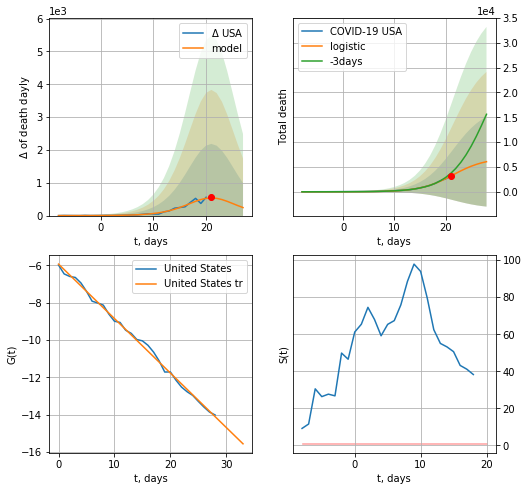

USA data at: 2020-09-12
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +7 days
	 total death:  6060 ± 9047
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


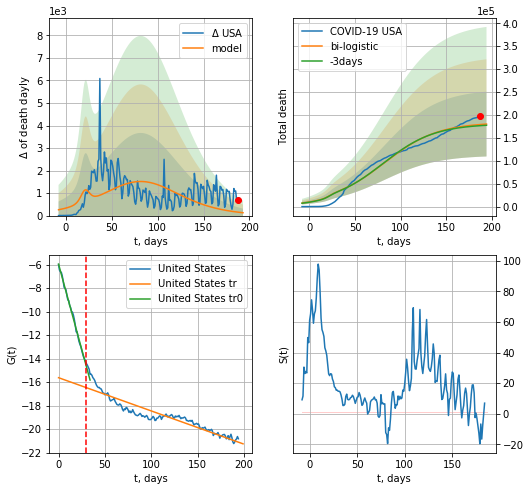

USA data at: 2020-09-12
+3 day model MAPE: 0.014077360968775827
model: bi-logistic
coeffs:  [1.76969703e+05 3.42356589e-02 8.19721893e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.3924539185728065
forecast at the end of period: +7 days
	 deltaDaydeath:  127
	 total death:  180063 ± 70666
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.862706
 intercept: -15.623568
 slope: -0.028299


In [2134]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


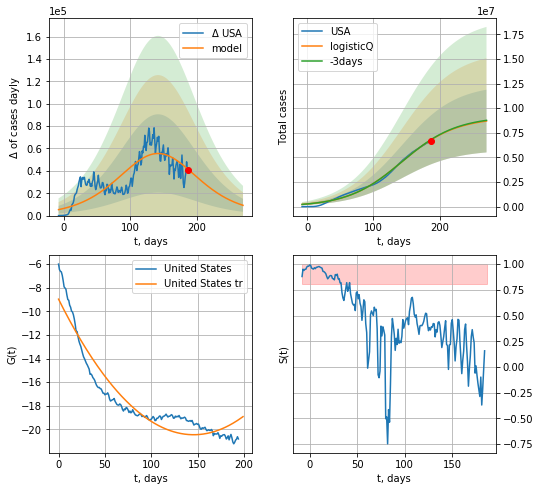

USA data at: 2020-09-12
+3 day model MAPE: 0.003503
model: logisticQ
coeffs: [ 9.01146863e+06  2.68138136e-07  1.42272112e+02 -9.16213632e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366727
forecast at the end of period: +84 days
	 deltaDaycases: 9195
	 total cases: 8690917 ± 3187195
	 total death: 257902 ± 283738
trend coefficient of determination: 0.897509
 intercept_: -8.96641469159616
 coeffs_: [ 0.         -0.15782325  0.00054146]


In [2135]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


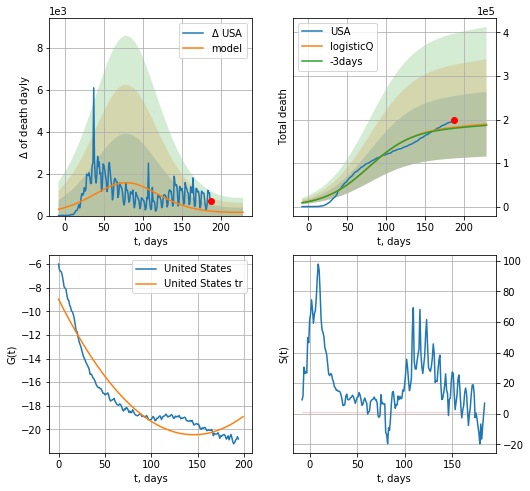

USA data at: 2020-09-12
+3 day model MAPE: 0.013468
model: logisticQ
coeffs: [ 1.82634749e+05  4.24912526e-08  7.88269279e+01 -8.02950981e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392850
forecast at the end of period: +42 days
	 total death: 189494 ± 74442
trend coefficient of determination: 0.897509
 intercept_: -8.96641469159616
 coeffs_: [ 0.         -0.15782325  0.00054146]


In [2136]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


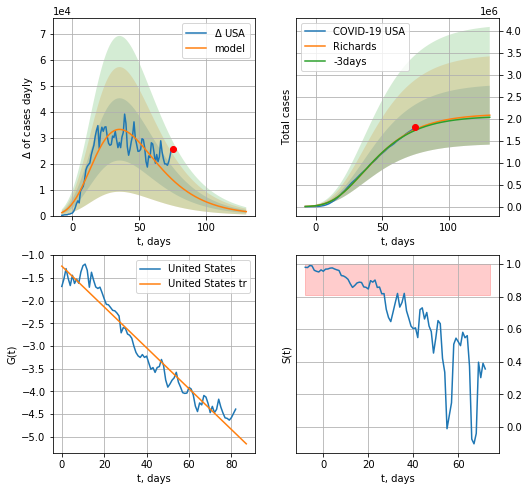

USA data at: 2020-09-12
+3 day model MAPE: 0.011172
model: Richards
coeffs: [ 2.11547275e+06  4.55740072e+00 -7.32299429e+01  9.40207859e-03]
rational stdev: 0.321873
forecast at the end of period: +56 days
	 deltaDaycases: 1532
	 total cases: 2080157 ± 669546
	 total death: 61728 ± 59605
trend coefficient of determination: 0.952323
 intercept: -1.242017
 slope: -0.044961


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


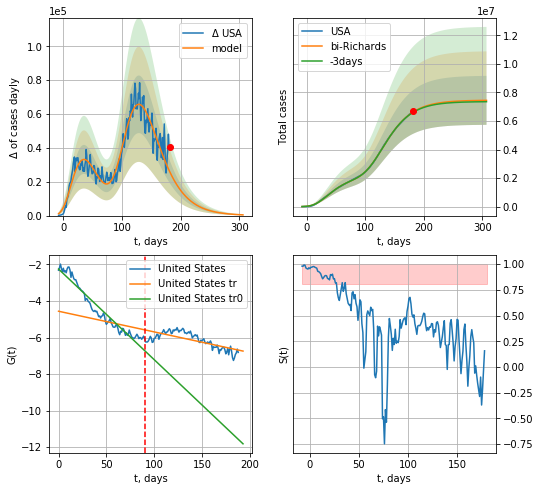

USA data at: 2020-09-12
+3 day model MAPE: 0.003878
model: bi-Richards
coeffs: [5.34070243e+06 3.17110320e-01 6.55390487e+01 1.08548491e-01]
rational stdev: 0.230385
forecast at the end of period: +126 days
	 deltaDaycases: 423
	 total cases: 7444084 ± 1715007
	 total death: 220903 ± 152678
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.940880
 intercept: -2.251715
 slope: -0.049563
trend coefficient of determination: 0.530281
 intercept: -4.560432
 slope: -0.011299


In [2137]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*42-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2138]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
195 2020-09-08  352560       0  41586.0
196 2020-09-09  355219       0  41594.0
197 2020-09-10  358138       0  41608.0
198 2020-09-11  361677       0  41614.0
199 2020-09-12  365174       0  41623.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


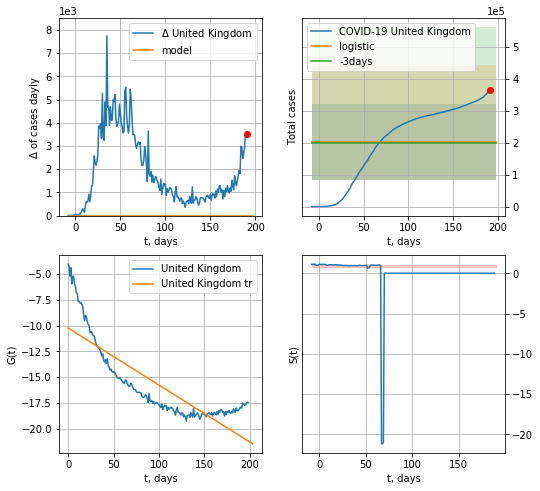

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.012099413938401164
model: logistic
coeffs:  [ 2.02608950e+05 -1.08312793e+01  2.75351606e+02]
rational stdev:  0.5935806355109816
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  202608 ± 120264
	 total death:  23093 ± 41122
trend coefficient of determination: 0.703237
 intercept: -10.235113
 slope: -0.055349


In [2139]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [2141]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


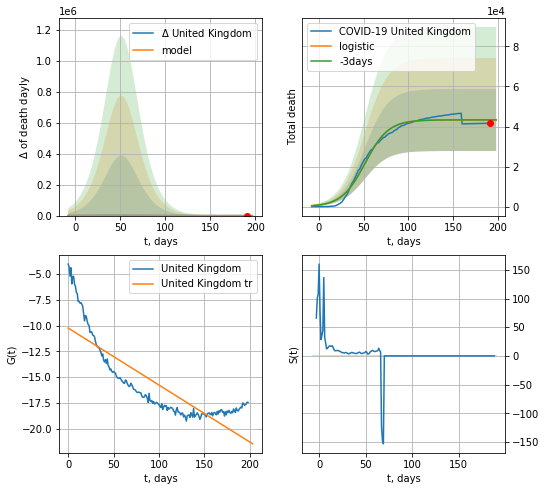

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.0013499493423924204
model: logistic
coeffs:  [4.32764317e+04 7.70589341e-02 5.15410606e+01]
rational stdev:  0.3579965827010288
forecast at the end of period: +7 days
	 total death:  43275 ± 15492
trend coefficient of determination: 0.703237
 intercept: -10.235113
 slope: -0.055349


In [2142]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


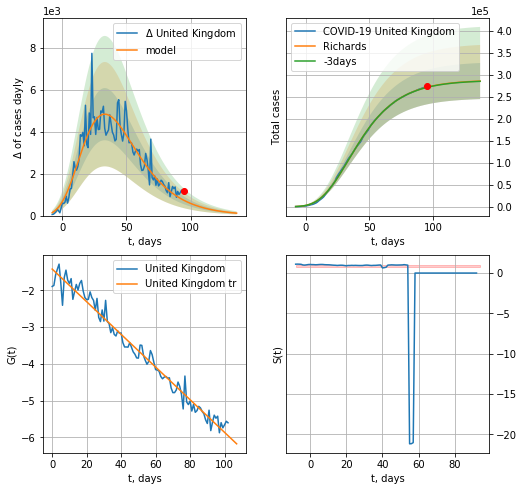

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.001530
model: Richards
coeffs: [ 2.88040344e+05  3.82469918e+00 -6.26359665e+01  1.20178265e-02]
rational stdev: 0.143621
forecast at the end of period: +42 days
	 deltaDaycases: 115
	 total cases: 285571 ± 41013
	 total death: 32549 ± 14024
trend coefficient of determination: 0.974342
 intercept: -1.421044
 slope: -0.044452


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


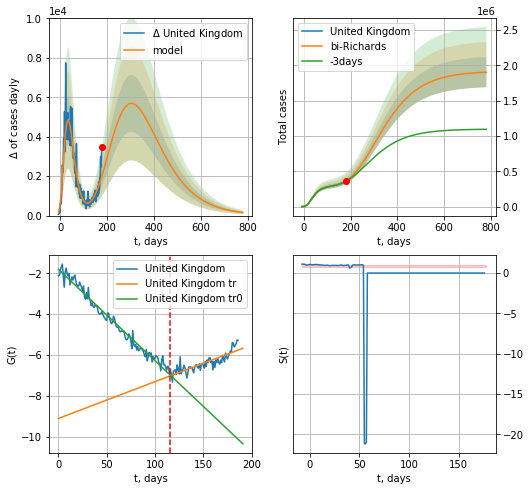

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.009178
model: bi-Richards
coeffs: [ 1.63142320e+06  1.94758375e-01 -4.30715103e+00  4.98911651e-02]
rational stdev: 0.112089
forecast at the end of period: +602 days
	 deltaDaycases: 153
	 total cases: 1903673 ± 213381
	 total death: 216983 ± 72964
bi-Richards approximation splitting point: 116
trend coefficient of determination: 0.977152
 intercept: -1.802491
 slope: -0.044762
trend coefficient of determination: 0.705097
 intercept: -9.108973
 slope: 0.018008


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


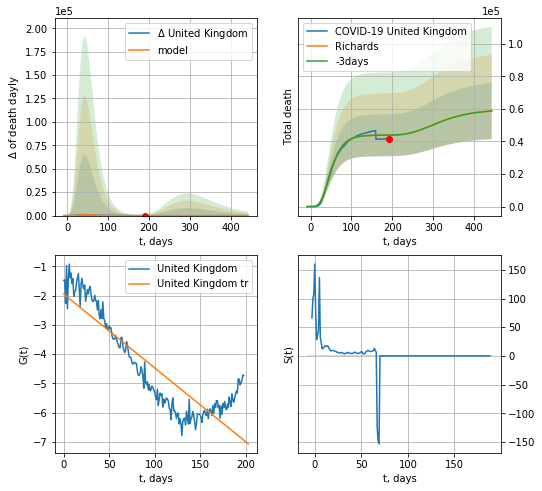

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.001880
model: Richards
coeffs: [ 4.37828788e+04  7.53078178e+00 -5.06849587e+01  7.00882576e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.293748
forecast at the end of period: +252 days
	 total death: 58615 ± 17218
trend coefficient of determination: 0.776451
 intercept: -1.954727
 slope: -0.025193


In [2143]:
vL = 116+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,110*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


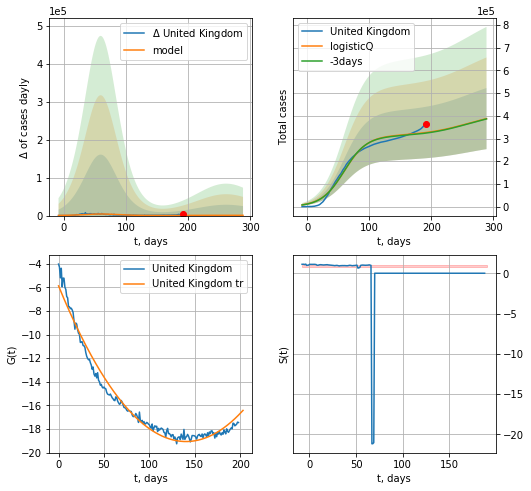

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.007817
model: logisticQ
coeffs: [ 3.12489692e+05  6.97517405e-08  5.99715551e+01 -7.79814375e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347219
forecast at the end of period: +98 days
	 deltaDaycases: 661
	 total cases: 387790 ± 134648
	 total death: 44200 ± 46041
trend coefficient of determination: 0.975748
 intercept_: -5.875696632703029
 coeffs_: [ 0.         -0.18812366  0.00067058]


In [2144]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


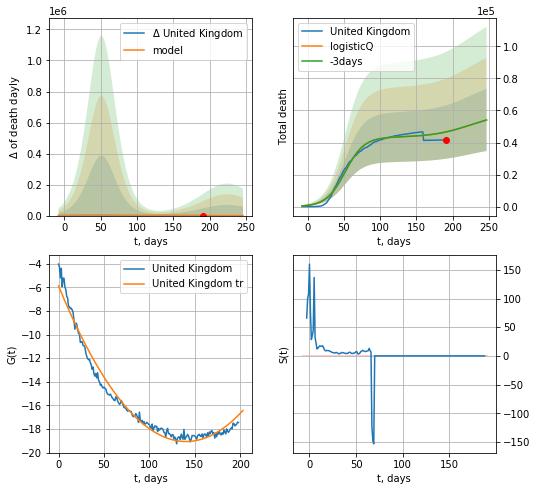

United Kingdom data at: 2020-09-12
+3 day model MAPE: 0.001027
model: logisticQ
coeffs: [ 4.32763305e+04  1.68497165e-07  5.15422473e+01 -4.57144373e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358019
forecast at the end of period: +56 days
	 total death: 54065 ± 19356
trend coefficient of determination: 0.975748
 intercept_: -5.875696632703029
 coeffs_: [ 0.         -0.18812366  0.00067058]


In [2145]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [2146]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [2147]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [2148]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [2149]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [2150]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
194 2020-09-08  18356.0    1821  628.0
195 2020-09-09  18607.0    1989  628.0
196 2020-09-10  18924.0    2226  629.0
197 2020-09-11  19216.0    2448  629.0
198 2020-09-12  19557.0    2680  630.0


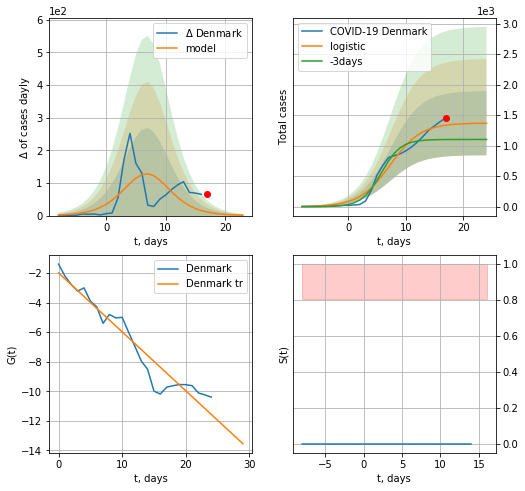

Denmark data at: 2020-09-12
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +7 days
	 deltaDaycases:  1
	 total cases:  1367 ± 526
	 total death:  44 ± 50
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


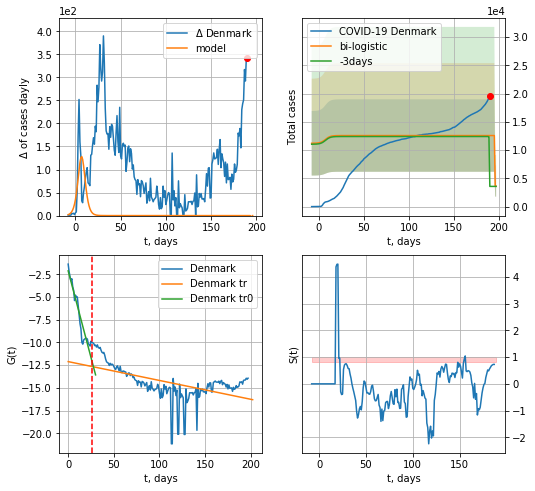

Denmark data at: 2020-09-12
+3 day model MAPE: 2.516066859130203
model: bi-logistic
coeffs:  [8966.62377016  -36.95435865  195.26787684] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5096513709899432
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  3611 ± 1840
	 total death:  116 ± 177
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.292646
 intercept: -12.109896
 slope: -0.020727


In [2151]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [2152]:
d12f(4)

'2020-09-09'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


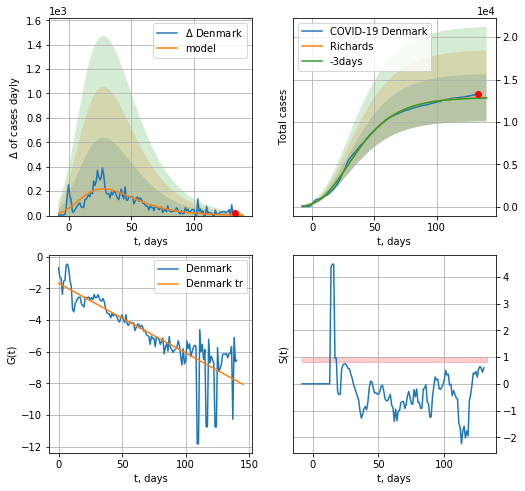

Denmark data at: 2020-09-12
+3 day model MAPE: 0.003205
model: Richards
coeffs: [ 1.29346492e+04  5.54024476e+00 -7.51621135e+01  8.35187087e-03]
rational stdev: 0.216347
forecast at the end of period: +7 days
	 deltaDaycases: 3
	 total cases: 12861 ± 2782
	 total death: 414 ± 268
trend coefficient of determination: 0.712007
 intercept: -1.674251
 slope: -0.044008


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


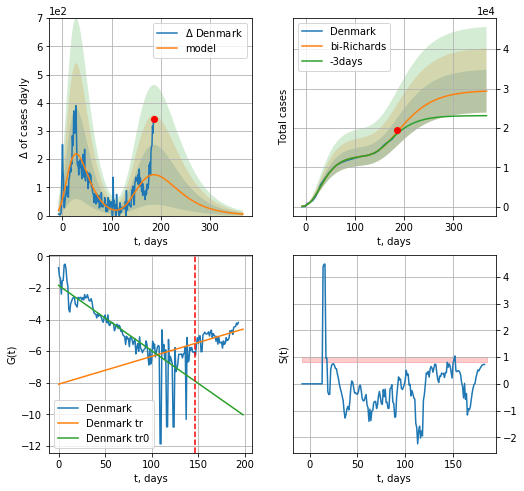

Denmark data at: 2020-09-12
+3 day model MAPE: 0.024366
model: bi-Richards
coeffs: [1.66315956e+04 1.71116688e+00 6.93056025e+00 1.38942780e-02]
rational stdev: 0.185217
forecast at the end of period: +182 days
	 deltaDaycases: 5
	 total cases: 29343 ± 5435
	 total death: 945 ± 525
bi-Richards approximation splitting point: 146
trend coefficient of determination: 0.685805
 intercept: -1.846743
 slope: -0.041294
trend coefficient of determination: 0.267405
 intercept: -8.088249
 slope: 0.017569


In [2153]:
vL = 150#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,50*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


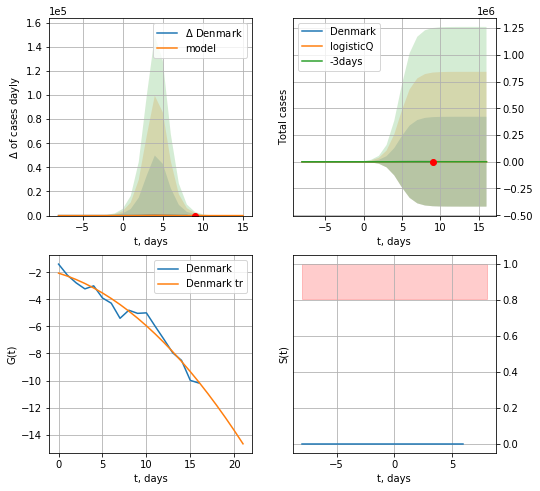

Denmark data at: 2020-09-12
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480486e+02  2.49394711e-04  4.73670535e+00 -4.50101209e+03]
rational stdev: 487.273007
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 862 ± 420262
	 total death: 27 ± 39469
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


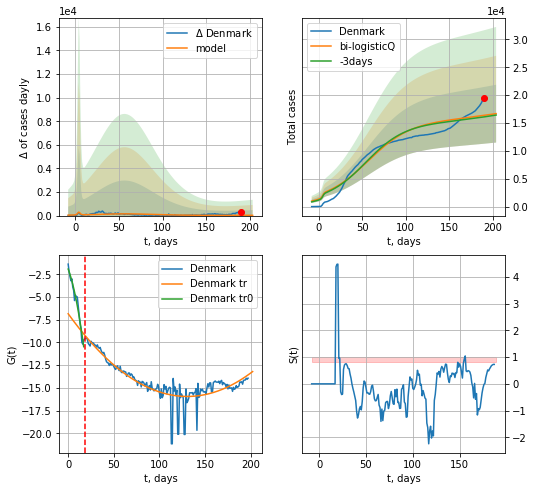

Denmark data at: 2020-09-12
+3 day model MAPE: 0.017227
model: bi-logisticQ
coeffs: [ 1.43559999e+04  2.83536662e-08  5.64664588e+01 -1.44059264e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.310889
forecast at the end of period: +14 days
	 deltaDaycases: 23
	 total cases: 16689 ± 5188
	 total death: 537 ± 500
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.758386
 intercept_: -6.845947652007915
 coeffs_: [ 0.         -0.13949703  0.00053472]


In [2154]:
x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
195 2020-09-08  11623.0    2011  264.0
196 2020-09-09  11746.0    2134  264.0
197 2020-09-10  11867.0    1231  265.0
198 2020-09-11  12003.0    1367  265.0
199 2020-09-12  12079.0    1443  265.0


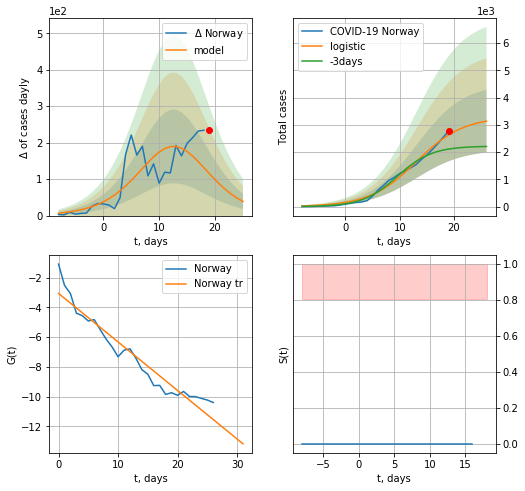

Norway data at: 2020-09-12
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +7 days
	 deltaDaycases:  38
	 total cases:  3138 ± 1153
	 total death:  68 ± 74
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


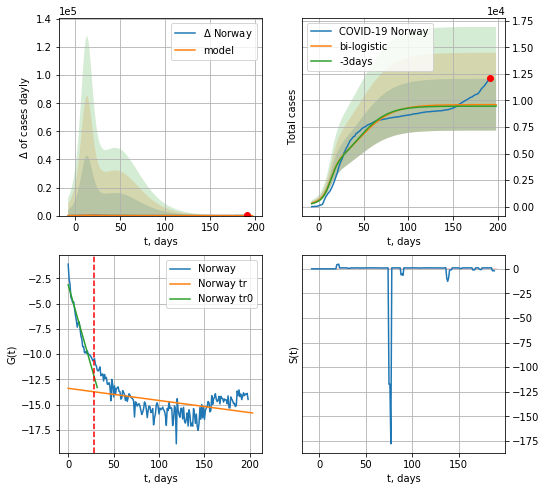

Norway data at: 2020-09-12
+3 day model MAPE: 0.014991732377759635
model: bi-logistic
coeffs:  [6.30746105e+03 5.53705611e-02 4.55705837e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.2541683082056257
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  9604 ± 2441
	 total death:  210 ± 160
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.176870
 intercept: -13.370227
 slope: -0.012019


In [2155]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

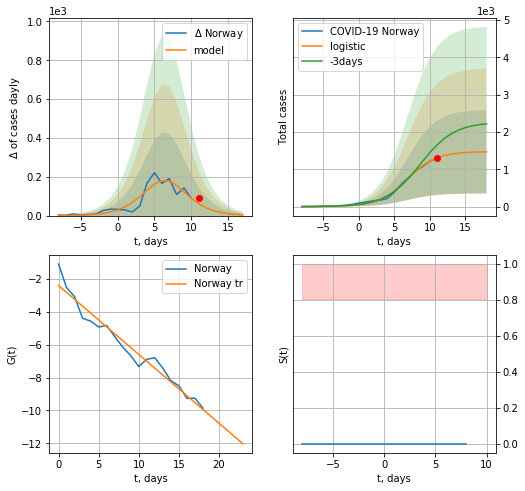

Norway data at: 2020-09-12
+3 day model MAPE: 0.24765534865647335
model: logistic
coeffs:  [1.47478892e+03 4.95866797e-01 6.87524750e+00]
rational stdev:  0.7596156046192828
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  1468 ± 1115
	 total death:  32 ± 72
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


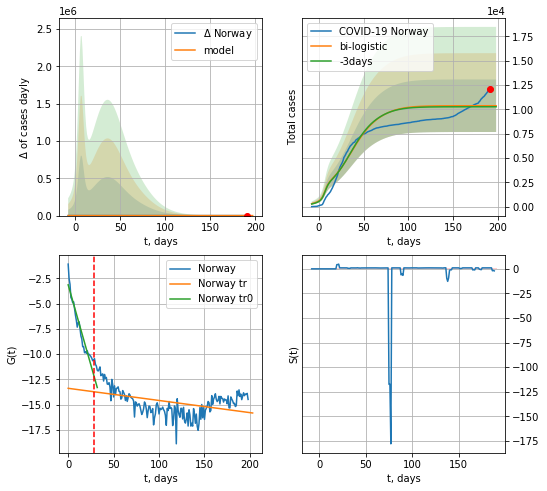

Norway data at: 2020-09-12
+3 day model MAPE: 0.010249624920291116
model: bi-logistic
coeffs:  [7.91068155e+03 7.45891169e-02 3.55273203e+01] [1.47478892e+03 4.95866797e-01 6.87524750e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.2604648333938351
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  10374 ± 2702
	 total death:  227 ± 177
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.176870
 intercept: -13.370227
 slope: -0.012019


In [2156]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


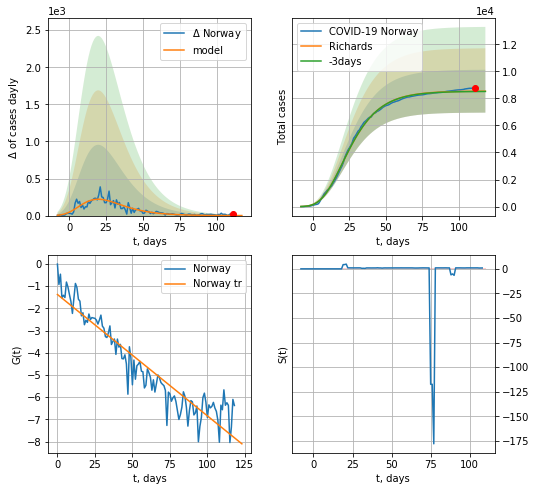

Norway data at: 2020-09-12
+3 day model MAPE: 0.002349
model: Richards
coeffs: [ 8.53893504e+03  9.40298407e+00 -4.93140335e+01  7.49676920e-03]
rational stdev: 0.185681
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 8530 ± 1583
	 total death: 187 ± 104
trend coefficient of determination: 0.886133
 intercept: -1.376205
 slope: -0.054692


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


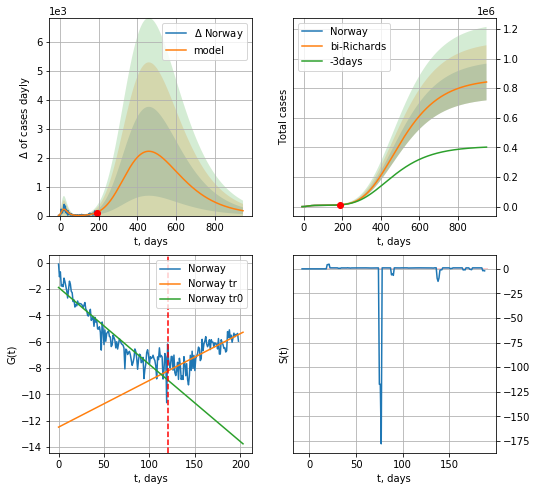

Norway data at: 2020-09-12
+3 day model MAPE: 0.006515
model: bi-Richards
coeffs: [8.56468077e+05 7.74132138e-02 1.40909188e+02 9.53628881e-02]
rational stdev: 0.147367
forecast at the end of period: +756 days
	 deltaDaycases: 168
	 total cases: 841969 ± 124078
	 total death: 18471 ± 8166
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.882282
 intercept: -1.879441
 slope: -0.058556
trend coefficient of determination: 0.587293
 intercept: -12.498214
 slope: 0.035536


In [2157]:
vL = 120#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,132*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


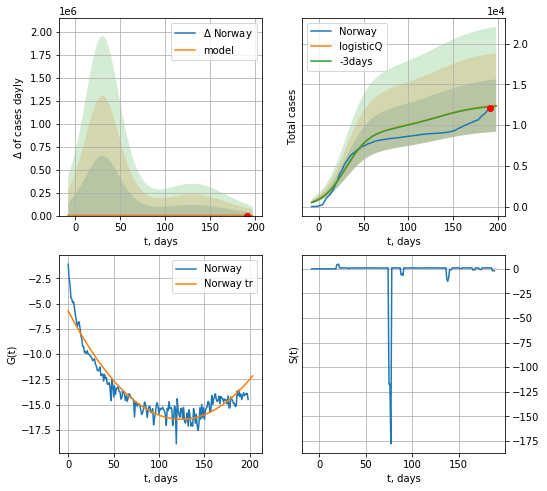

Norway data at: 2020-09-12
+3 day model MAPE: 0.005563
model: logisticQ
coeffs: [ 9.35472035e+03  5.25560040e-08  3.03397151e+01 -1.40195132e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.259480
forecast at the end of period: +7 days
	 deltaDaycases: 9
	 total cases: 12401 ± 3217
	 total death: 272 ± 211
trend coefficient of determination: 0.902365
 intercept_: -5.715609885576475
 coeffs_: [ 0.         -0.17241877  0.00069339]


In [2158]:
x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


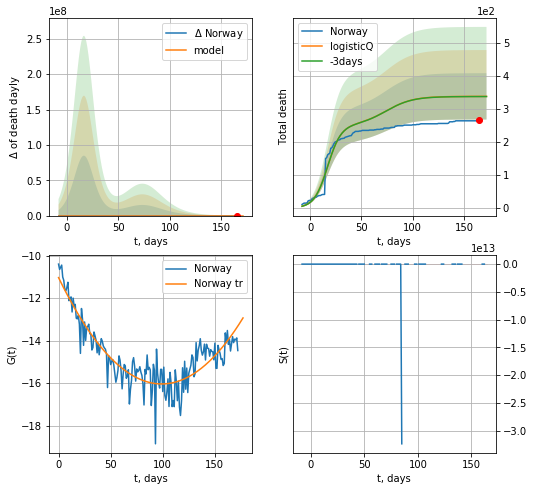

Norway data at: 2020-09-12
+3 day model MAPE: 0.001631
model: logisticQ
coeffs: [ 2.49595045e+02  2.87905951e-07  1.69785522e+01 -5.29963886e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.207284
forecast at the end of period: +7 days
	 total death: 337 ± 70
trend coefficient of determination: 0.800303
 intercept_: -11.035987907279395
 coeffs_: [ 0.         -0.10107546  0.00051048]


In [2159]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
196 2020-09-08  85707       0  5838.0
197 2020-09-09  85880       0  5842.0
198 2020-09-10  86194       0  5843.0
199 2020-09-11  86505       0  5846.0
200 2020-09-12  86505       0  5846.0


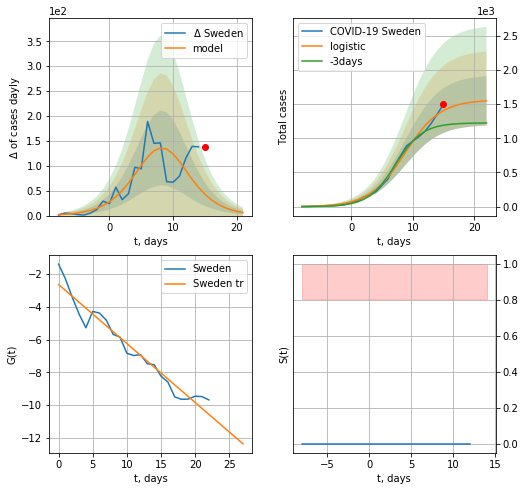

Sweden data at: 2020-09-12
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +7 days
	 deltaDaycases:  6
	 total cases:  1547 ± 360
	 total death:  104 ± 72
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


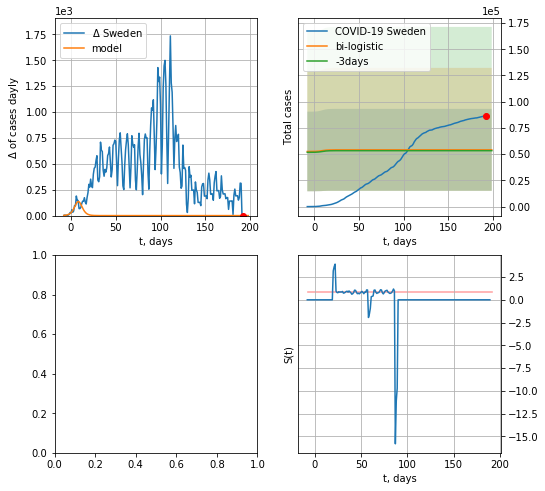

In [2160]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
195 2020-09-07  85558       0  5837.0
196 2020-09-08  85707       0  5838.0
197 2020-09-09  85880       0  5842.0
198 2020-09-10  86194       0  5843.0
199 2020-09-11  86505       0  5846.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


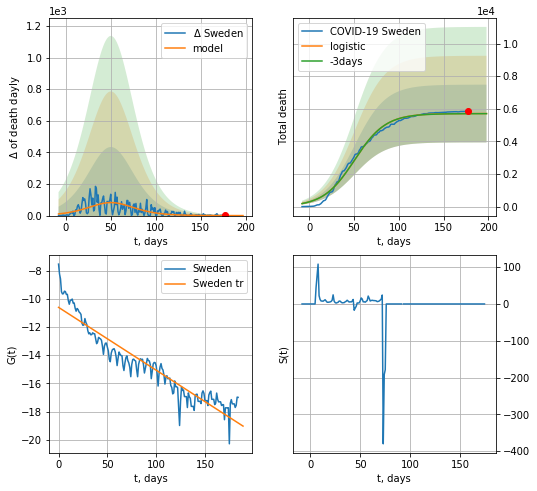

Sweden data at: 2020-09-11
+3 day model MAPE: 0.0012479270950663812
model: logistic
coeffs:  [5.71023283e+03 5.77207802e-02 5.06180445e+01]
rational stdev:  0.3103116217357257
forecast at the end of period: +21 days
	 total death:  5709 ± 1771
trend coefficient of determination: 0.892246
 intercept: -10.610446
 slope: -0.044572


In [1771]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


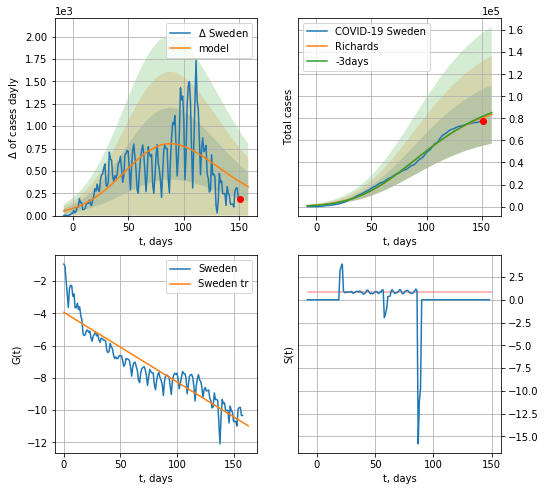

Sweden data at: 2020-09-11
+3 day model MAPE: 0.015048
model: Richards
coeffs: [9.67246034e+04 6.99759012e-02 5.25862336e+01 3.83189345e-01]
rational stdev: 0.316495
forecast at the end of period: +8 days
	 deltaDaycases: 322
	 total cases: 83562 ± 26447
	 total death: 5647 ± 5361
trend coefficient of determination: 0.860612
 intercept: -3.945277
 slope: -0.043120


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


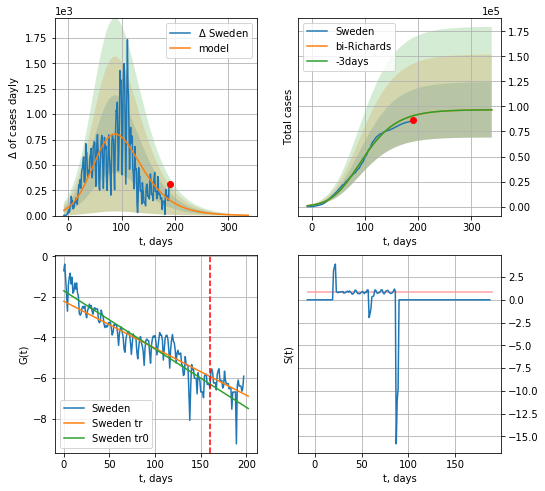

Sweden data at: 2020-09-11
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [9.04899865e+02 7.01504412e-02 1.34540279e+01 2.56155260e-02]
rational stdev: 0.285772
forecast at the end of period: +148 days
	 deltaDaycases: 3
	 total cases: 96604 ± 27606
	 total death: 6528 ± 5596
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.848400
 intercept: -1.701509
 slope: -0.028698
trend coefficient of determination: 0.170805
 intercept: -2.215552
 slope: -0.023149


In [1772]:
iL = 0
vL = 160+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[iL:-1],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


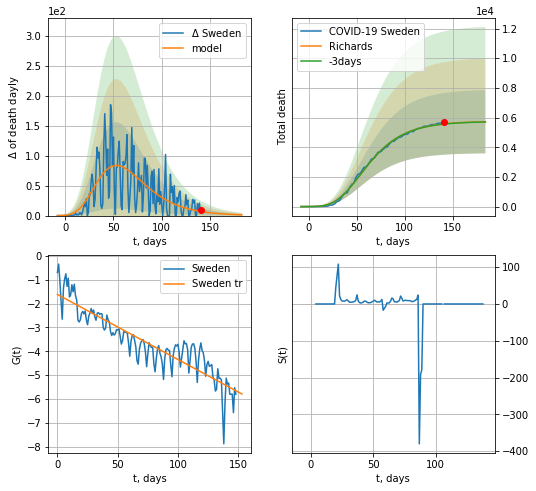

Sweden data at: 2020-09-11
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +43 days
	 total death: 5719 ± 2129
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


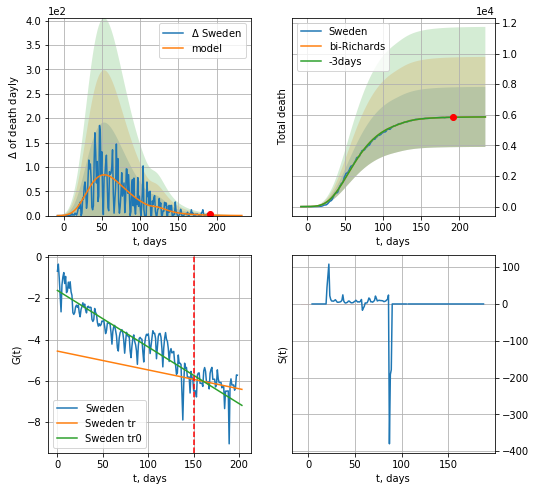

Sweden data at: 2020-09-11
+3 day model MAPE: 0.000096
model: bi-Richards
coeffs: [1.11674082e+02 1.28983859e+01 8.27463787e+01 8.59501119e-03]
rational stdev: 0.334699
forecast at the end of period: +43 days
	 total death: 5858 ± 1960
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.818785
 intercept: -1.626178
 slope: -0.027382
trend coefficient of determination: 0.050875
 intercept: -4.560931
 slope: -0.009112


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [1773]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


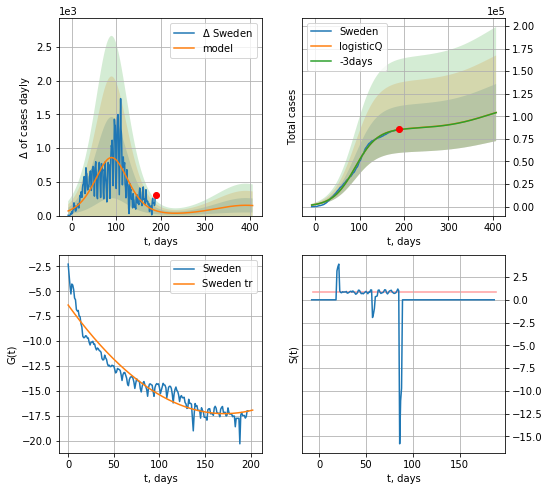

Sweden data at: 2020-09-11
+3 day model MAPE: 0.001636
model: logisticQ
coeffs: [ 8.64630595e+04  4.66632395e-07  8.99258555e+01 -8.50664747e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.303411
forecast at the end of period: +218 days
	 deltaDaycases: 149
	 total cases: 104207 ± 31617
	 total death: 7042 ± 6409
trend coefficient of determination: 0.927910
 intercept_: -6.3833398410032895
 coeffs_: [ 0.         -0.12716469  0.00037143]


In [1774]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


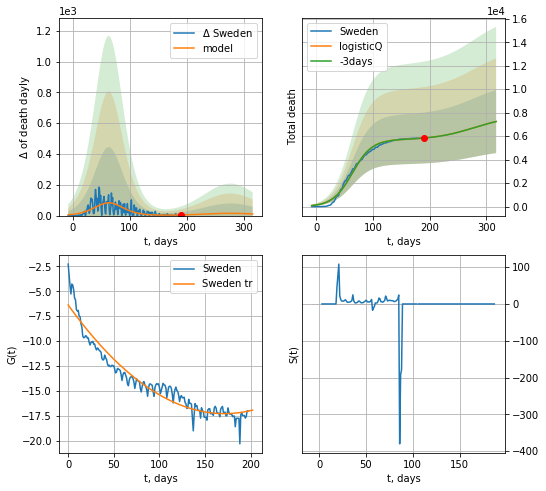

Sweden data at: 2020-09-11
+3 day model MAPE: 0.001233
model: logisticQ
coeffs: [ 5.70576535e+03  1.17572182e-07  6.36009663e+01 -4.94703960e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.370749
forecast at the end of period: +127 days
	 total death: 7245 ± 2686
trend coefficient of determination: 0.927910
 intercept_: -6.3833398410032895
 coeffs_: [ 0.         -0.12716469  0.00037143]


In [1775]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
230 2020-09-08  85146.0     165  4634.0
231 2020-09-09  85153.0     161  4634.0
232 2020-09-10  85168.0     157  4634.0
233 2020-09-11  85174.0     154  4634.0
234 2020-09-12  85184.0     151  4634.0


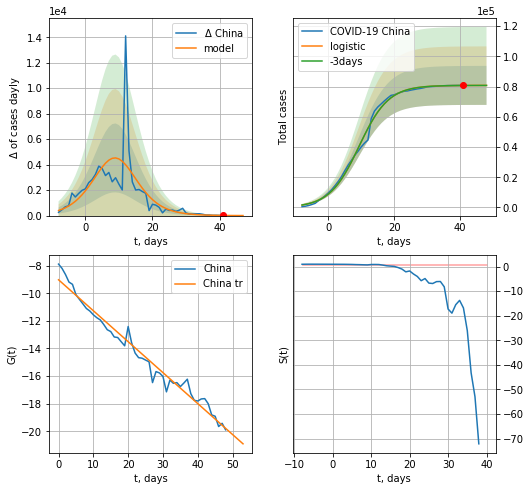

China data at: 2020-09-12
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  80796 ± 12904
	 total death:  4395 ± 2105
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


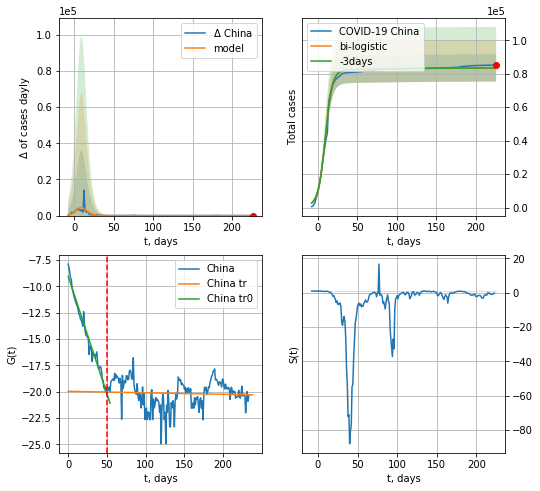

China data at: 2020-09-12
Exception occurs


In [2161]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,24*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [2162]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

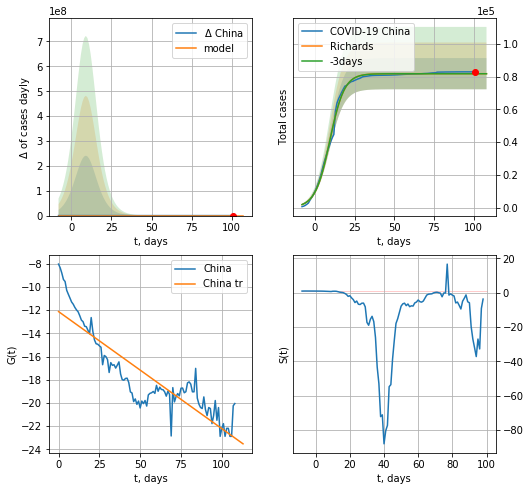

China data at: 2020-09-12
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4448 ± 1553
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


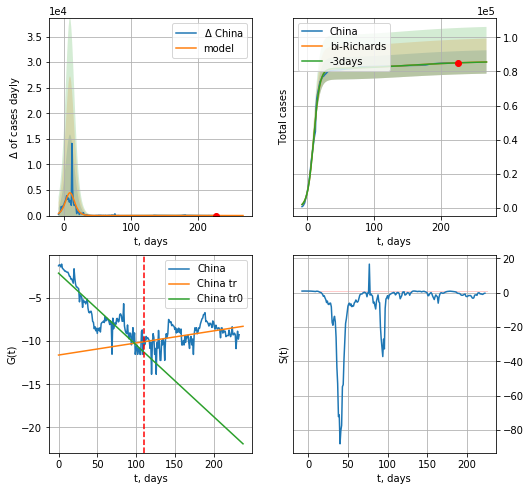

China data at: 2020-09-12
+3 day model MAPE: 0.000221
model: bi-Richards
coeffs: [ 4.48899160e+03  7.63789520e-01 -1.26771352e+02  1.91943902e-02]
rational stdev: 0.080238
forecast at the end of period: +42 days
	 deltaDaycases: 8
	 total cases: 85600 ± 6868
	 total death: 4656 ± 1120
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820920
 intercept: -2.144816
 slope: -0.082974
trend coefficient of determination: 0.165097
 intercept: -11.620183
 slope: 0.013972


In [2163]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,30*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

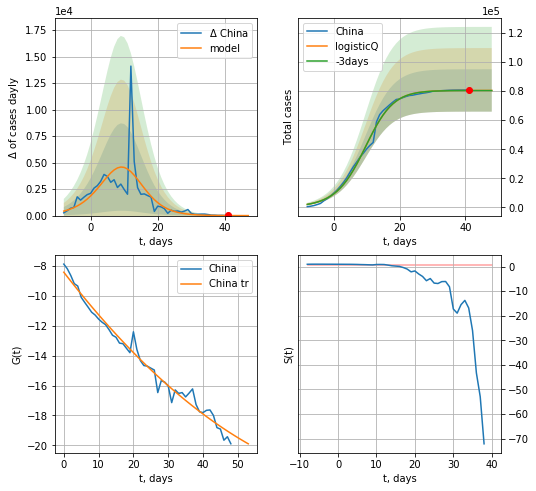

China data at: 2020-09-12
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 80415 ± 14556
	 total death: 4374 ± 2375
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


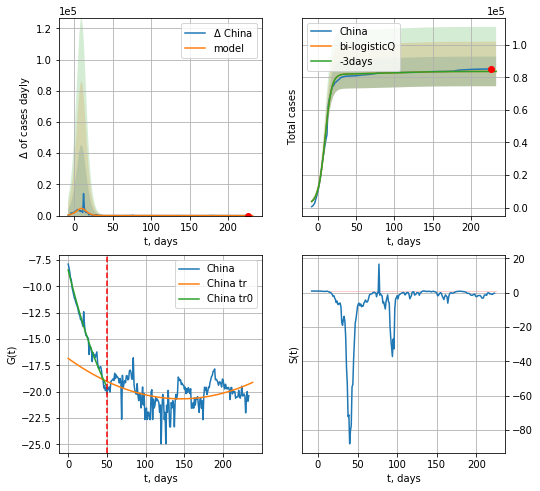

China data at: 2020-09-12
+3 day model MAPE: 0.000577
model: bi-logisticQ
coeffs: [ 3.23968260e+03  1.41942157e-04  2.48299674e+01 -6.02414998e-02]
rational stdev: 0.108900
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 83653 ± 9109
	 total death: 4550 ± 1486
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.124758
 intercept_: -16.844509072833446
 coeffs_: [ 0.         -0.05279443  0.00018162]


In [2164]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [2165]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
206 2020-09-08  21588  4221.0  344.0
207 2020-09-09  21743  4037.0  346.0
208 2020-09-10  21919  3953.0  350.0
209 2020-09-11  22055  3671.0  355.0
210 2020-09-12  22176  3592.0  358.0


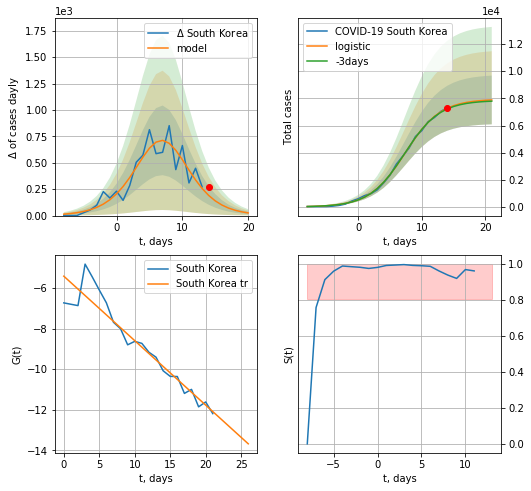

South Korea data at: 2020-09-12
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +7 days
	 deltaDaycases:  25
	 total cases:  7882 ± 1794
	 total death:  127 ± 86
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


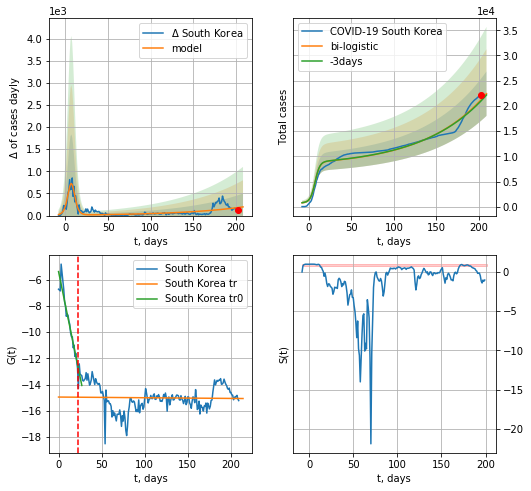

South Korea data at: 2020-09-12
+3 day model MAPE: 0.01069519992579683
model: bi-logistic
coeffs:  [3.21979860e+07 1.36563103e-02 7.73287638e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.19666536831302842
forecast at the end of period: +7 days
	 deltaDaycases:  196
	 total cases:  22426 ± 4410
	 total death:  362 ± 213
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.000870
 intercept: -14.948164
 slope: -0.000522


In [2167]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [2168]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

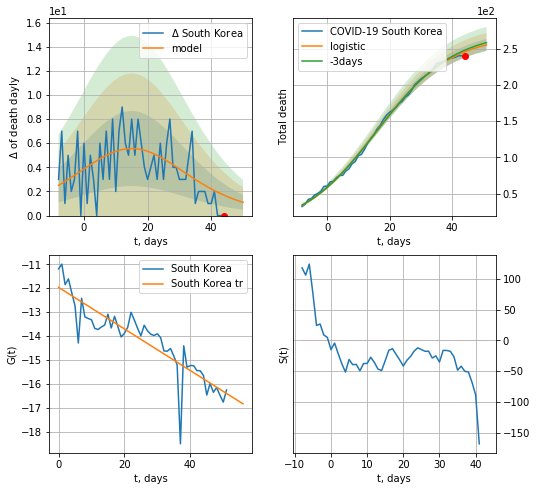

South Korea data at: 2020-09-12
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +7 days
	 total death:  255 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


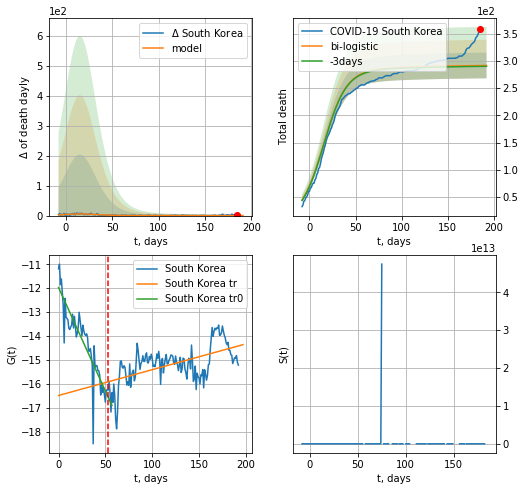

South Korea data at: 2020-09-12
+3 day model MAPE: 0.00530151069528233
model: bi-logistic
coeffs:  [2.47252940e+01 1.53663117e-02 9.73226204e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.0810414869281764
forecast at the end of period: +7 days
	 deltaDaydeath:  0
	 total death:  291 ± 23
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.324639
 intercept: -16.487394
 slope: 0.010779


In [2169]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


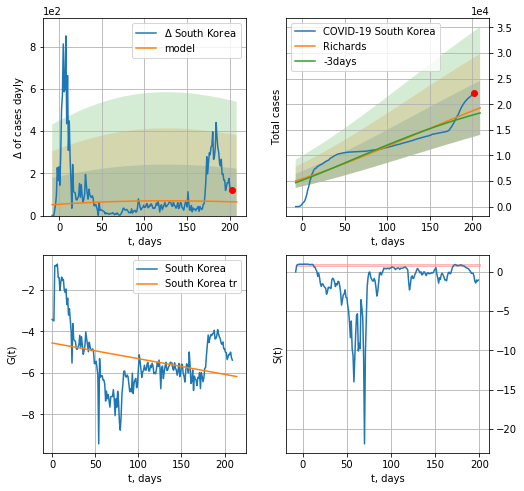

South Korea data at: 2020-09-12
+3 day model MAPE: 0.048580
model: Richards
coeffs: [ 3.67171987e+04  3.00844894e-01 -6.47401446e+02  1.74104376e-02]
rational stdev: 0.272957
forecast at the end of period: +7 days
	 deltaDaycases: 64
	 total cases: 19290 ± 5265
	 total death: 311 ± 254
trend coefficient of determination: 0.093976
 intercept: -4.559251
 slope: -0.007542


In [2170]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


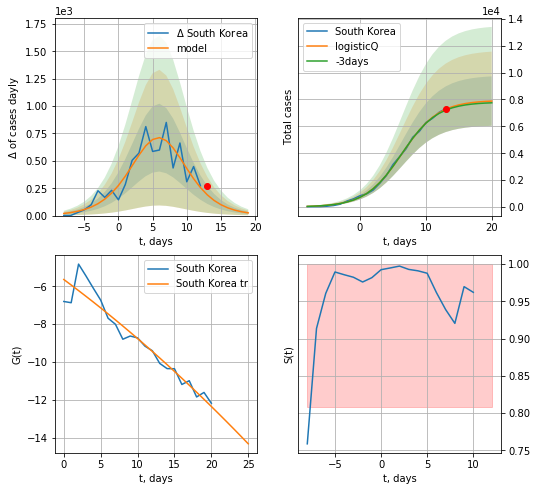

South Korea data at: 2020-09-12
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +7 days
	 deltaDaycases: 24
	 total cases: 7878 ± 1839
	 total death: 127 ± 88
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


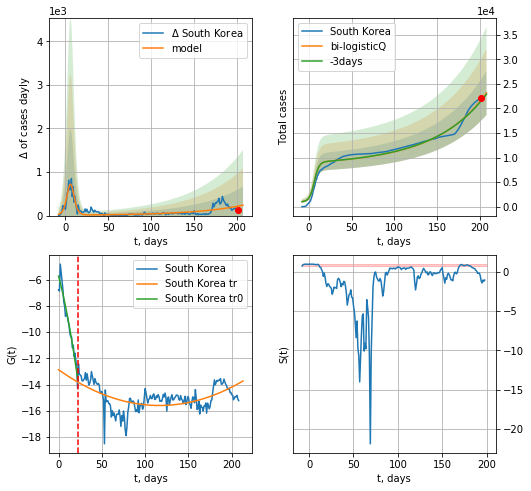

South Korea data at: 2020-09-12
+3 day model MAPE: 0.008677
model: bi-logisticQ
coeffs: [ 6.10802394e+05  1.67238483e-05  3.96387239e+02 -9.55699666e+02]
rational stdev: 0.193358
forecast at the end of period: +7 days
	 deltaDaycases: 240
	 total cases: 23165 ± 4479
	 total death: 373 ± 216
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.293642
 intercept_: -12.867371130201485
 coeffs_: [ 0.         -0.04675691  0.00020066]


In [2171]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [2172]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [2173]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


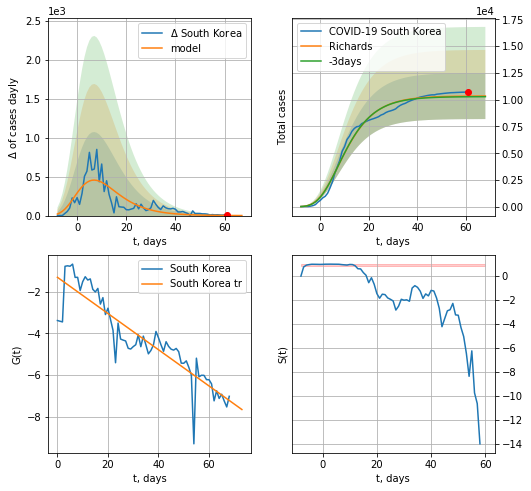

South Korea data at: 2020-09-12
+3 day model MAPE: 0.005852
model: Richards
coeffs: [ 1.03487698e+04  3.01458128e+01 -3.85788003e+01  3.98965943e-03]
rational stdev: 0.208027
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 10341 ± 2151
	 total death: 166 ± 103
trend coefficient of determination: 0.811927
 intercept: -1.308874
 slope: -0.086829


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


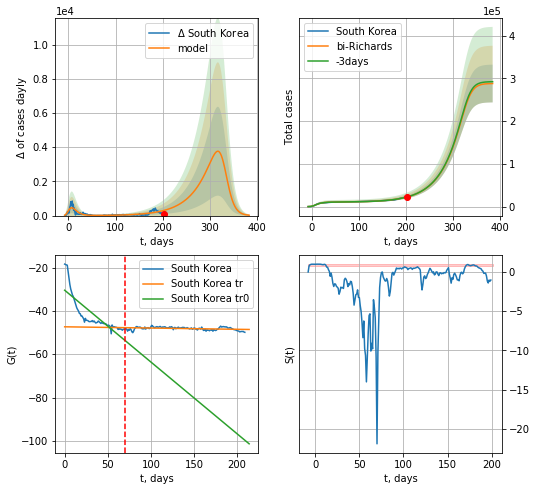

South Korea data at: 2020-09-12
+3 day model MAPE: 0.002611
model: bi-Richards
coeffs: [2.77636967e+05 2.42788659e-02 3.30910696e+02 4.46469643e+00]
rational stdev: 0.153302
forecast at the end of period: +182 days
	 deltaDaycases: 22
	 total cases: 287789 ± 44118
	 total death: 4645 ± 2136
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.675796
 intercept: -30.458495
 slope: -0.331348
trend coefficient of determination: 0.106706
 intercept: -47.343804
 slope: -0.005745


In [2174]:
iL = 0
vL = 70+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[iL:],d1,50*7-dT,x,1.0,vL=vL-iL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [2175]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [2176]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
229 2020-09-08  57166.0     678   27.0
230 2020-09-09  57229.0     710   27.0
231 2020-09-10  57316.0     731   27.0
232 2020-09-11  57357.0     723   27.0
233 2020-09-12  57406.0     680   27.0


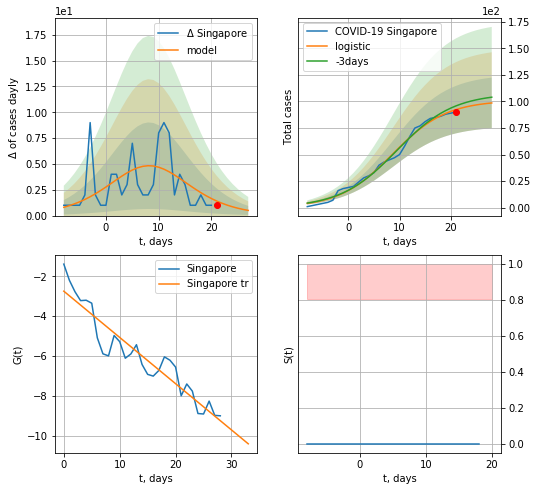

Singapore data at: 2020-09-12
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  98 ± 23
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


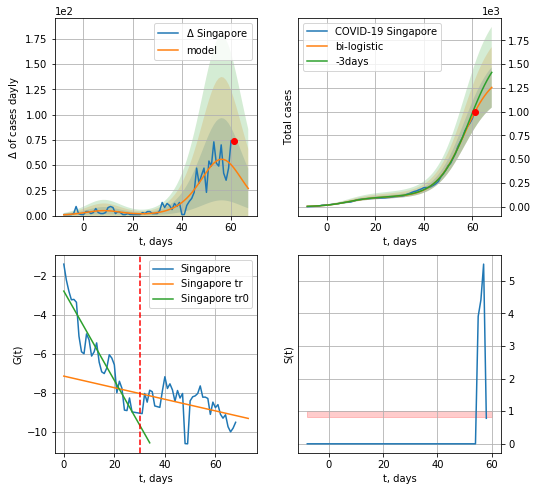

Singapore data at: 2020-09-12
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +7 days
	 deltaDaycases:  26
	 total cases:  1255 ± 212
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


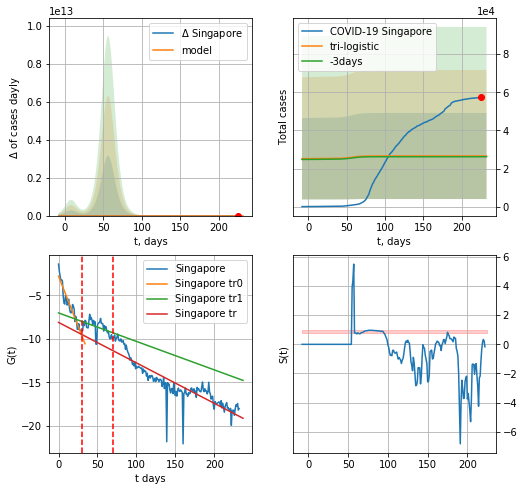

Singapore data at: 2020-09-12
+3 day model MAPE: 0.015278339616409882
model: tri-logistic
coeffs:  [ 2.51430567e+04 -1.61203345e+01  3.90533125e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.8499798659402472
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  26571 ± 22584
	 total death:  12 ± 30
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.784794
 intercept: -8.103395
 slope: -0.046591


In [2177]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

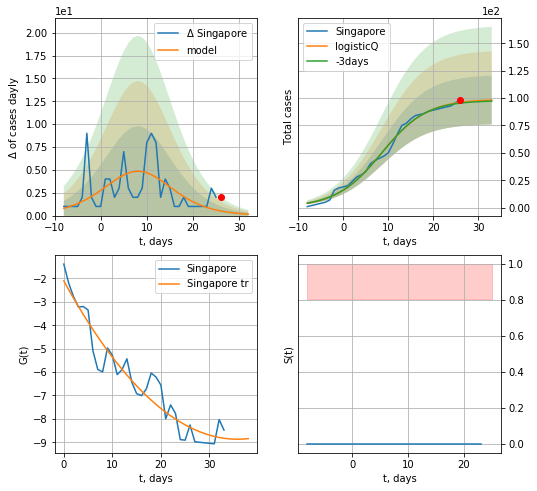

Singapore data at: 2020-09-12
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


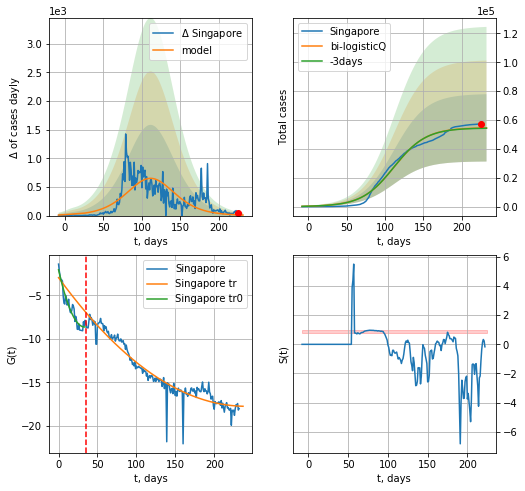

Singapore data at: 2020-09-12
+3 day model MAPE: 0.004398
model: bi-logisticQ
coeffs: [ 5.46057034e+04  6.68787426e-08  1.11705530e+02 -7.12689240e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.427367
forecast at the end of period: +7 days
	 deltaDaycases: 9
	 total cases: 54571 ± 23322
	 total death: 25 ± 32
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.919943
 intercept_: -2.947769778221872
 coeffs_: [ 0.         -0.12312845  0.00025573]


In [2178]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [2179]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


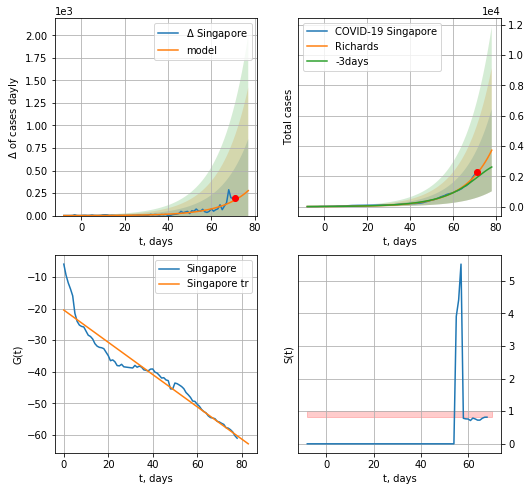

Singapore data at: 2020-09-12
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +7 days
	 deltaDaycases: 276
	 total cases: 3724 ± 2712
	 total death: 1 ± 2
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


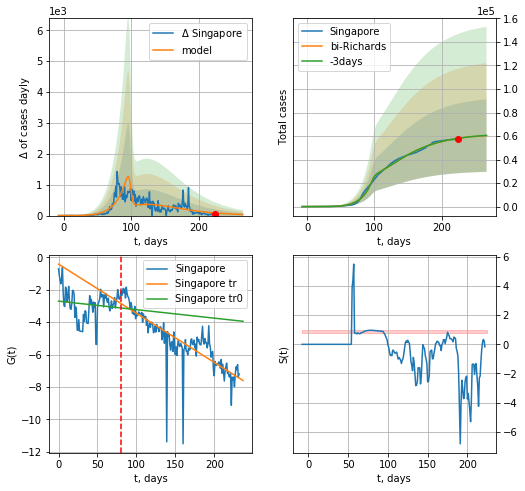

Singapore data at: 2020-09-12
+3 day model MAPE: 0.001535
model: bi-Richards
coeffs: [ 4.26298798e+04  1.98616113e+00 -6.69293356e+01  1.17485030e-02]
rational stdev: 0.510006
forecast at the end of period: +42 days
	 deltaDaycases: 34
	 total cases: 60387 ± 30798
	 total death: 28 ± 42
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.016677
 intercept: -2.698396
 slope: -0.005253
trend coefficient of determination: 0.675451
 intercept: -0.409284
 slope: -0.030371


In [2180]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
180 2020-09-08  2585.0     308   64.0
181 2020-09-09  2600.0     313   64.0
182 2020-09-10  2632.0     335   64.0
183 2020-09-11  2655.0     339   64.0
184 2020-09-12  2676.0     356   64.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


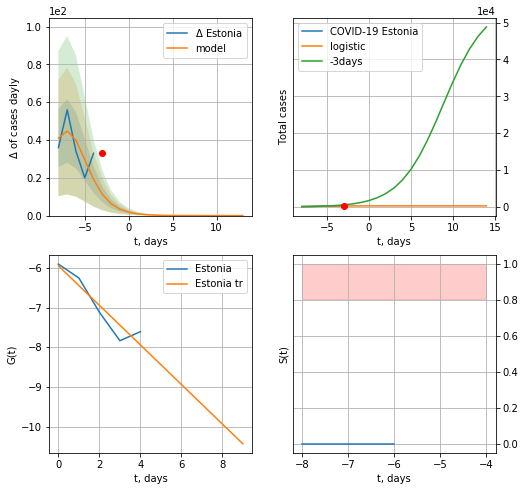

Estonia data at: 2020-09-12
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  6 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


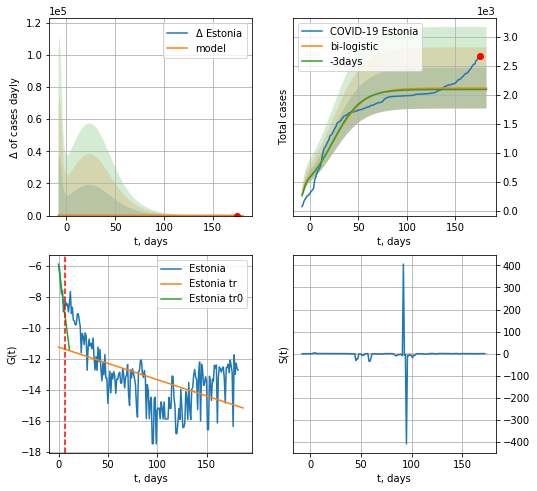

Estonia data at: 2020-09-12
+3 day model MAPE: 0.011747655898190068
model: bi-logistic
coeffs:  [1.84192507e+03 6.40487977e-02 2.41464014e+01] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.16561684620380523
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  2119 ± 351
	 total death:  50 ± 24
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.276824
 intercept: -11.252131
 slope: -0.020974


In [2181]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


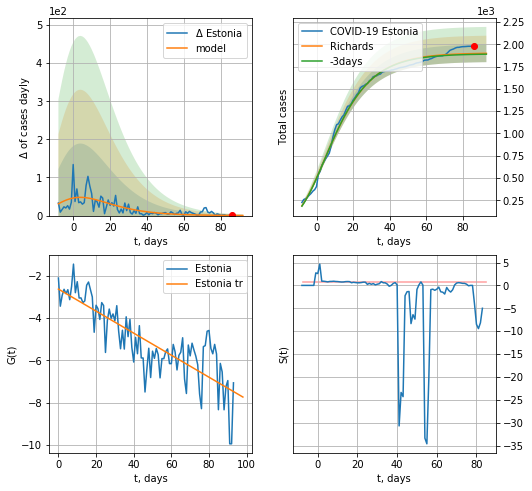

Estonia data at: 2020-09-12
+3 day model MAPE: 0.004828
model: Richards
coeffs: [ 1.90234229e+03  8.05122761e+00 -6.49439772e+01  8.53882183e-03]
rational stdev: 0.052085
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1898 ± 98
	 total death: 45 ± 7
trend coefficient of determination: 0.683583
 intercept: -2.627136
 slope: -0.052184


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


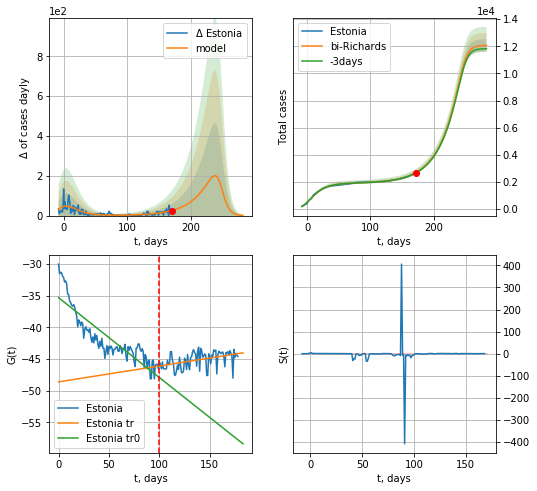

Estonia data at: 2020-09-12
+3 day model MAPE: 0.002950
model: bi-Richards
coeffs: [1.01664584e+04 3.37444123e-02 2.47754017e+02 5.03721840e+00]
rational stdev: 0.037717
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 12063 ± 455
	 total death: 288 ± 32
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.775362
 intercept: -35.320137
 slope: -0.125974
trend coefficient of determination: 0.193945
 intercept: -48.598862
 slope: 0.025010


In [2182]:
iL = 5
vL=100+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[iL:],d1,7*40-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


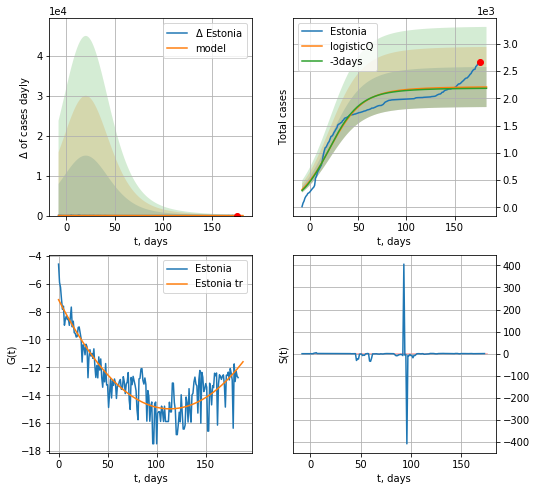

Estonia data at: 2020-09-12
+3 day model MAPE: 0.010659
model: logisticQ
coeffs: [ 2.12027216e+03  3.13380918e-08  2.03911627e+01 -1.92617174e+06]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.166352
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 2208 ± 367
	 total death: 52 ± 25
trend coefficient of determination: 0.784497
 intercept_: -7.1481185992972724
 coeffs_: [ 0.         -0.13797726  0.00060798]


In [2183]:
x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
185 2020-09-08  1443.0     174   35.0
186 2020-09-09  1448.0     165   35.0
187 2020-09-10  1459.0     176   35.0
188 2020-09-11  1464.0     181   35.0
189 2020-09-12  1474.0     191   35.0


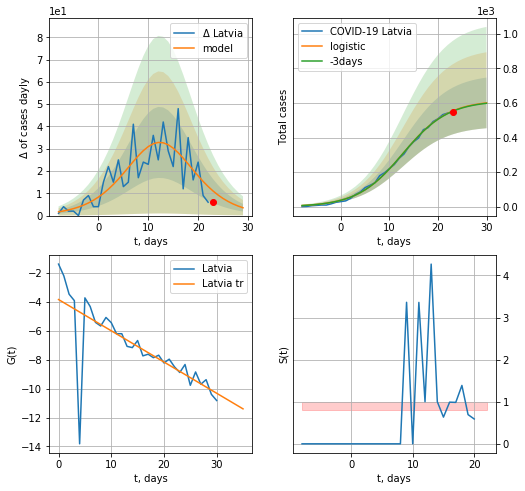

Latvia data at: 2020-09-12
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  600 ± 146
	 total death:  14 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


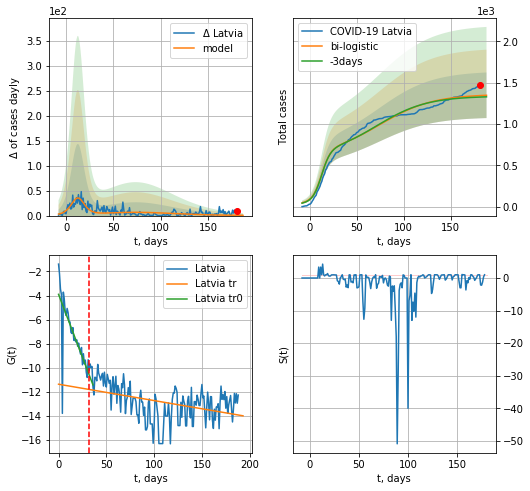

Latvia data at: 2020-09-12
+3 day model MAPE: 0.013688935278429844
model: bi-logistic
coeffs:  [7.44035595e+02 3.52640102e-02 7.38974401e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.2045399829182918
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  1347 ± 275
	 total death:  31 ± 19
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.169380
 intercept: -11.386352
 slope: -0.013629


In [2184]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


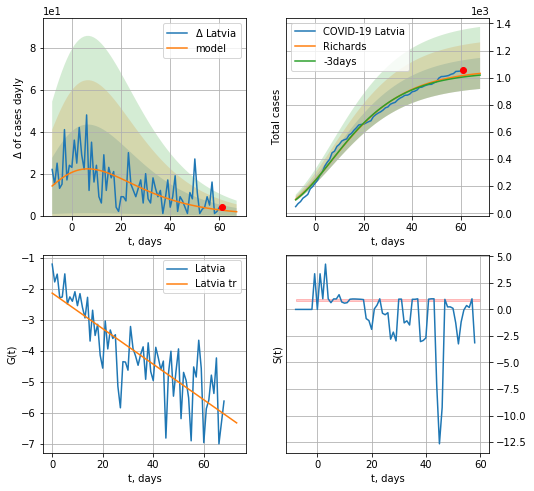

Latvia data at: 2020-09-12
+3 day model MAPE: 0.011078
model: Richards
coeffs: [ 1.06333537e+03  7.08982273e+00 -7.72639807e+01  8.06725773e-03]
rational stdev: 0.110885
forecast at the end of period: +7 days
	 deltaDaycases: 1
	 total cases: 1031 ± 114
	 total death: 24 ± 7
trend coefficient of determination: 0.685809
 intercept: -2.142789
 slope: -0.057409


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


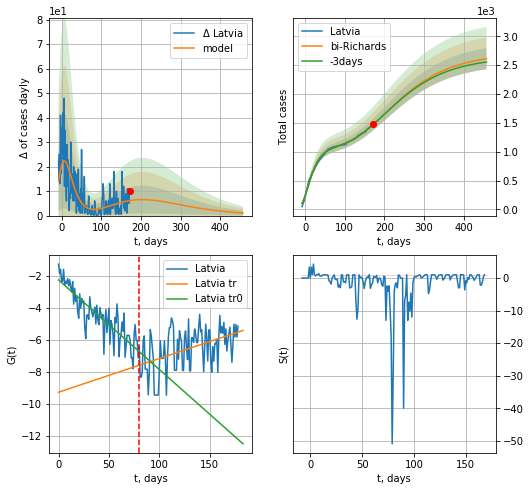

Latvia data at: 2020-09-12
+3 day model MAPE: 0.001009
model: bi-Richards
coeffs: [ 1.64921469e+03  5.53321970e-01 -1.58372985e+02  1.96337961e-02]
rational stdev: 0.070317
forecast at the end of period: +287 days
	 deltaDaycases: 1
	 total cases: 2612 ± 183
	 total death: 62 ± 13
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.732658
 intercept: -2.247143
 slope: -0.056058
trend coefficient of determination: 0.214562
 intercept: -9.275916
 slope: 0.021133


In [2185]:
iL=10
vL = 80+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*65-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


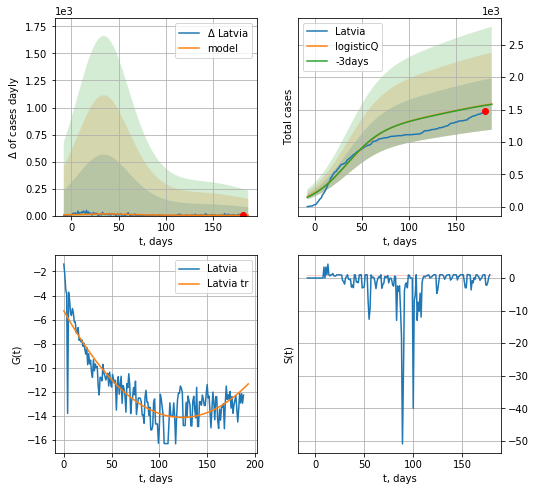

Latvia data at: 2020-09-12
+3 day model MAPE: 0.003298
model: logisticQ
coeffs: [ 1.26089719e+03  3.56924125e-08  3.39676240e+01 -1.37064561e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.250501
forecast at the end of period: +7 days
	 deltaDaycases: 2
	 total cases: 1585 ± 397
	 total death: 37 ± 27
trend coefficient of determination: 0.772986
 intercept_: -5.272438996030265
 coeffs_: [ 0.         -0.14366428  0.00058096]


In [2186]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


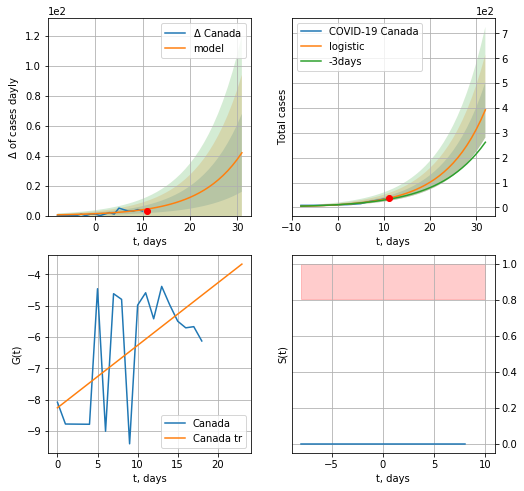

Canada data at: 2020-09-12
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  26 ± 22
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


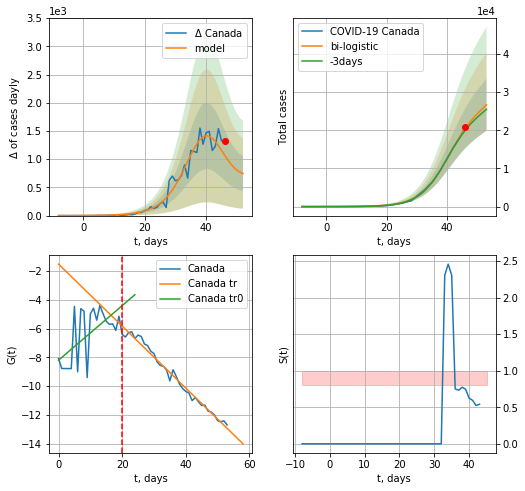

Canada data at: 2020-09-12
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +7 days
	 deltaDaycases:  746
	 total cases:  26694 ± 6805
	 total death:  1798 ± 1375
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


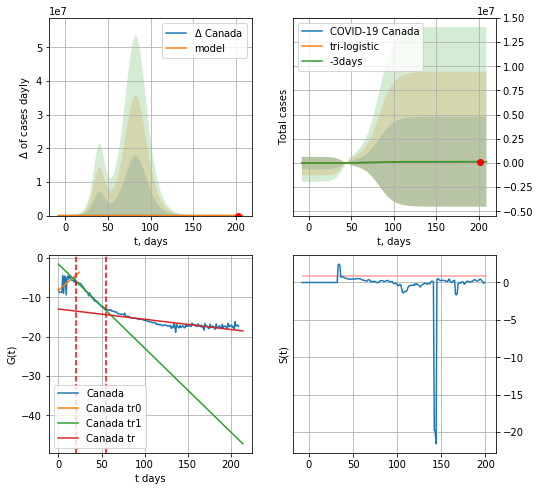

Canada data at: 2020-09-12
+3 day model MAPE: 0.00048131514157005365
model: tri-logistic
coeffs:  [-1.81703247e+04  2.08321339e+00 -3.73130261e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  35.4232900210722
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  131187 ± 4647110
	 total death:  8836 ± 939000
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.709237
 intercept: -12.992915
 slope: -0.026054


In [2187]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
206 2020-09-08  133748.0    7030  9153.0
207 2020-09-09  134294.0    6868  9155.0
208 2020-09-10  134924.0    6771  9163.0
209 2020-09-11  135626.0    6789  9163.0
210 2020-09-12  136141.0    6896  9170.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


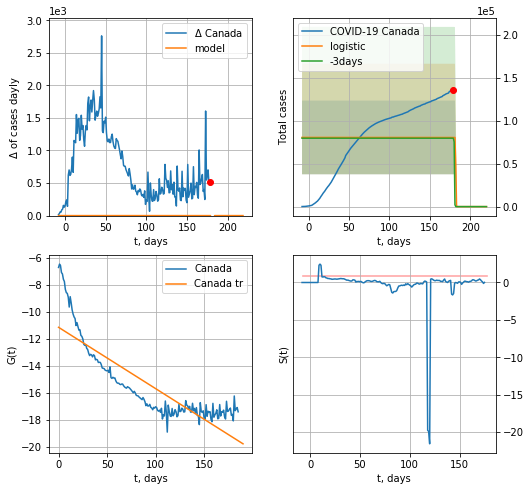

Canada data at: 2020-09-12
+3 day model MAPE: 0.011376624976867018
model: logistic
coeffs:  [ 8.04939251e+04 -6.48318493e+00  1.82070369e+02]
rational stdev:  0.5324916571636155
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.724805
 intercept: -11.132161
 slope: -0.045479


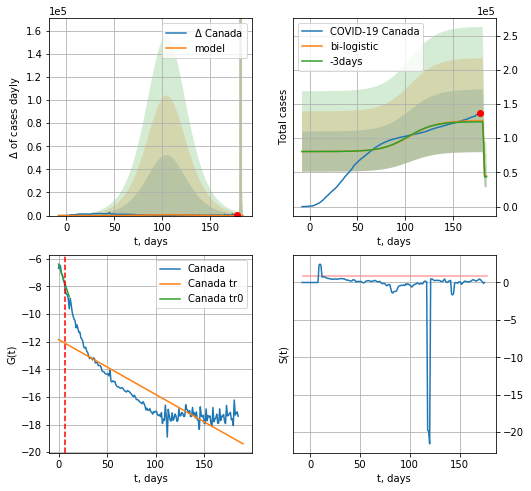

Canada data at: 2020-09-12
+3 day model MAPE: 0.011073177300159895
model: bi-logistic
coeffs:  [4.51009028e+04 7.04920250e-02 1.04794874e+02] [ 8.04939251e+04 -6.48318493e+00  1.82070369e+02]
rational stdev:  0.36482081057549
forecast at the end of period: +7 days
	 deltaDaycases:  11
	 total cases:  44943 ± 16396
	 total death:  3027 ± 3312
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.733484
 intercept: -11.852419
 slope: -0.039702


In [2188]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

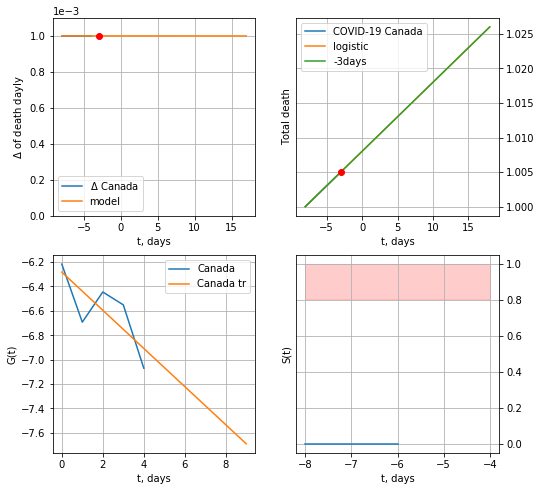

Canada data at: 2020-09-12
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


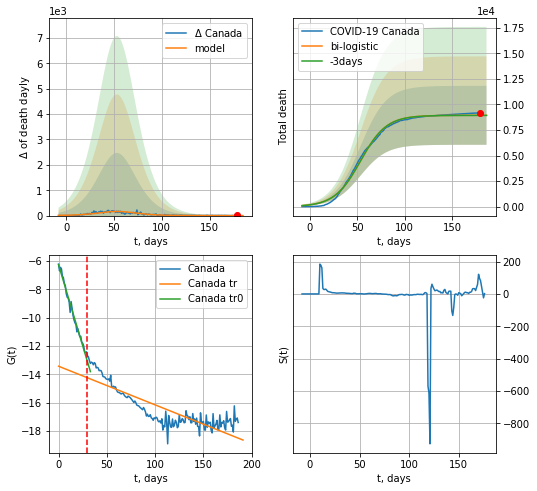

Canada data at: 2020-09-12
+3 day model MAPE: 0.0011038046810631552
model: bi-logistic
coeffs:  [8.93282372e+03 7.32873003e-02 5.34779417e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.32278353159036716
forecast at the end of period: +7 days
	 deltaDaydeath:  0
	 total death:  8933 ± 2883
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.720648
 intercept: -13.426032
 slope: -0.027291


In [2189]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


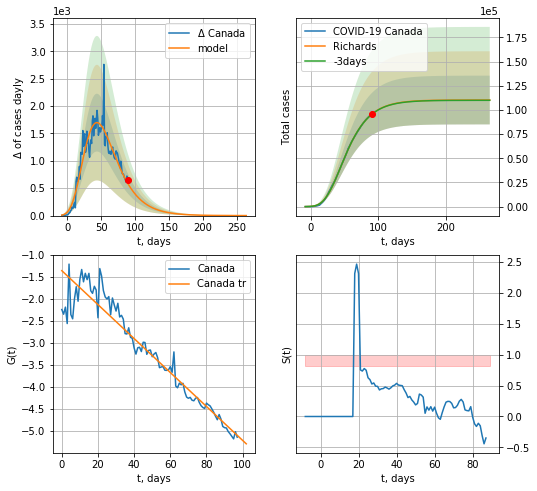

Canada data at: 2020-09-12
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207939e+05  3.57046378e+00 -6.12039169e+01  1.17938660e-02]
rational stdev: 0.228612
forecast at the end of period: +175 days
	 deltaDaycases: 0
	 total cases: 110197 ± 25192
	 total death: 7422 ± 5090
trend coefficient of determination: 0.921084
 intercept: -1.352092
 slope: -0.038614


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


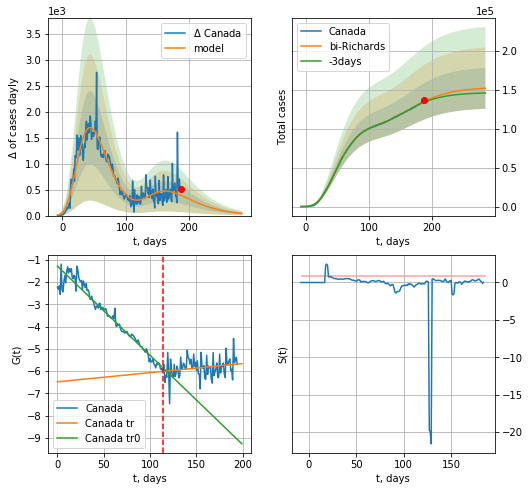

Canada data at: 2020-09-12
+3 day model MAPE: 0.007777
model: bi-Richards
coeffs: [4.29608650e+04 2.98569662e+00 8.27125461e-01 9.44076703e-03]
rational stdev: 0.172973
forecast at the end of period: +98 days
	 deltaDaycases: 41
	 total cases: 151679 ± 26236
	 total death: 10216 ± 5301
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.947980
 intercept: -1.282754
 slope: -0.040077
trend coefficient of determination: 0.047956
 intercept: -6.474914
 slope: 0.004102


In [2191]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,38*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


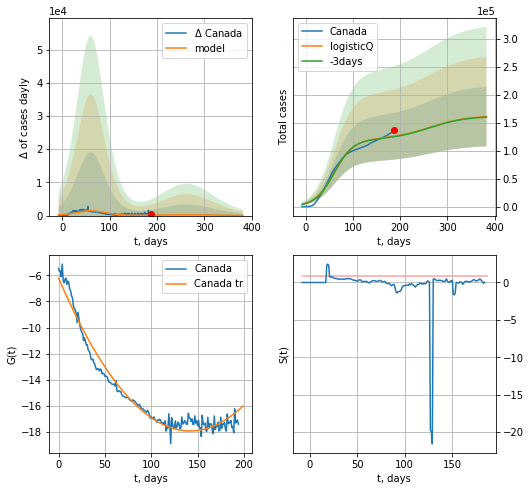

Canada data at: 2020-09-12
+3 day model MAPE: 0.007517
model: logisticQ
coeffs: [ 1.20330787e+05  5.96364301e-08  6.03449020e+01 -8.24488964e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.331714
forecast at the end of period: +196 days
	 deltaDaycases: 49
	 total cases: 160865 ± 53361
	 total death: 10835 ± 10782
trend coefficient of determination: 0.968271
 intercept_: -6.206682955335159
 coeffs_: [ 0.         -0.16526209  0.00058286]


In [2192]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
190 2020-09-08  60895   15903  1846.0
191 2020-09-09  61541   16408  1849.0
192 2020-09-10  62126   16833  1852.0
193 2020-09-11  62813   17314  1855.0
194 2020-09-12  63310   17556  1860.0


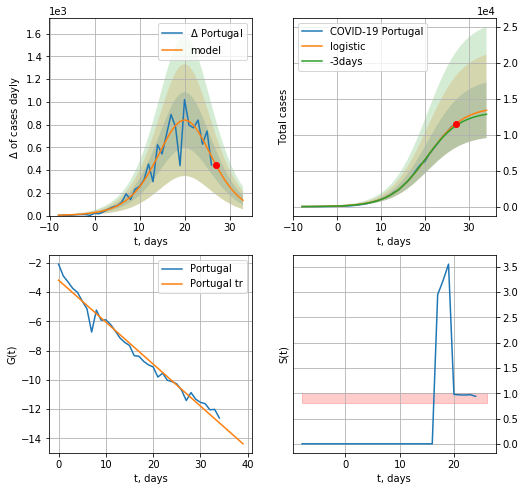

Portugal data at: 2020-09-12
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +7 days
	 deltaDaycases:  134
	 total cases:  13426 ± 3867
	 total death:  394 ± 340
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


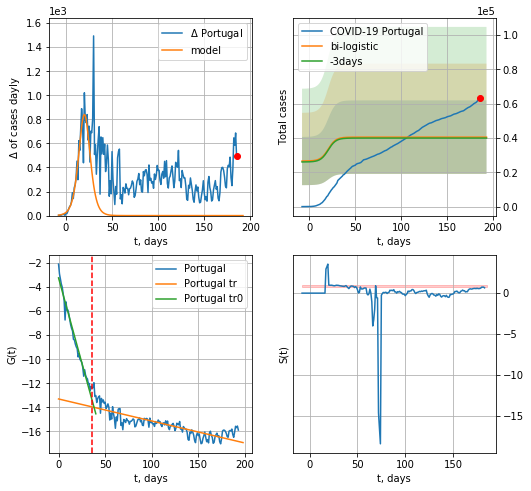

Portugal data at: 2020-09-12
+3 day model MAPE: 0.01346558910340068
model: bi-logistic
coeffs:  [ 2.12503989e+04 -7.84903854e+00  1.98675363e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5290091995722286
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  40506 ± 21428
	 total death:  1190 ± 1888
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.690488
 intercept: -13.308927
 slope: -0.018344


In [2193]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


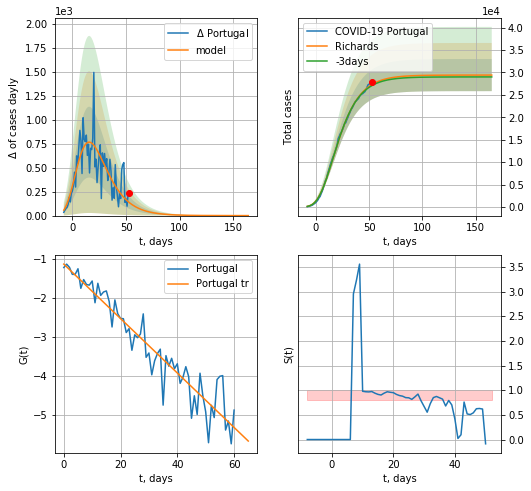

Portugal data at: 2020-09-12
+3 day model MAPE: 0.008857
model: Richards
coeffs: [ 2.94208673e+04  7.56194935e+00 -4.94130809e+01  9.41350515e-03]
rational stdev: 0.121788
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 29420 ± 3583
	 total death: 864 ± 315
trend coefficient of determination: 0.903152
 intercept: -1.140009
 slope: -0.069674


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


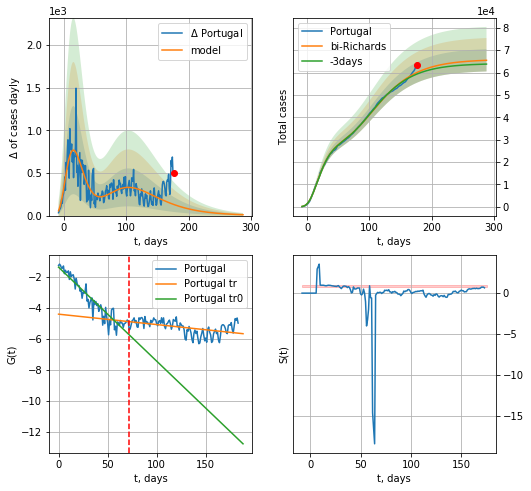

Portugal data at: 2020-09-12
+3 day model MAPE: 0.011854
model: bi-Richards
coeffs: [ 3.64556288e+04  2.13823156e+00 -7.67610291e+01  1.14713210e-02]
rational stdev: 0.076006
forecast at the end of period: +112 days
	 deltaDaycases: 10
	 total cases: 65465 ± 4975
	 total death: 1923 ± 438
bi-Richards approximation splitting point: 72
trend coefficient of determination: 0.889586
 intercept: -1.349041
 slope: -0.060890
trend coefficient of determination: 0.224924
 intercept: -4.395388
 slope: -0.006726


In [2194]:
iL = 10
vL=72+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2196]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

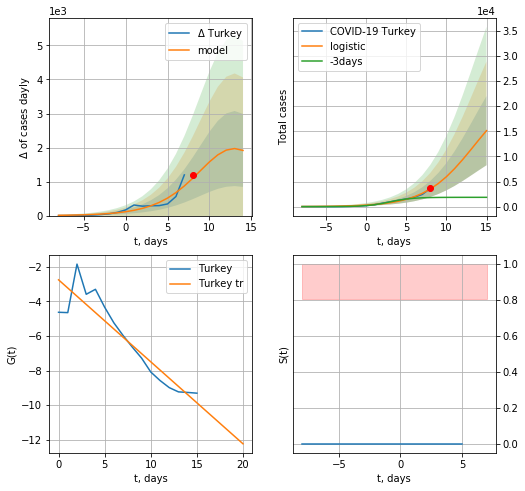

Turkey data at: 2020-09-12
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +7 days
	 deltaDaycases:  1915
	 total cases:  15126 ± 6885
	 total death:  365 ± 498
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


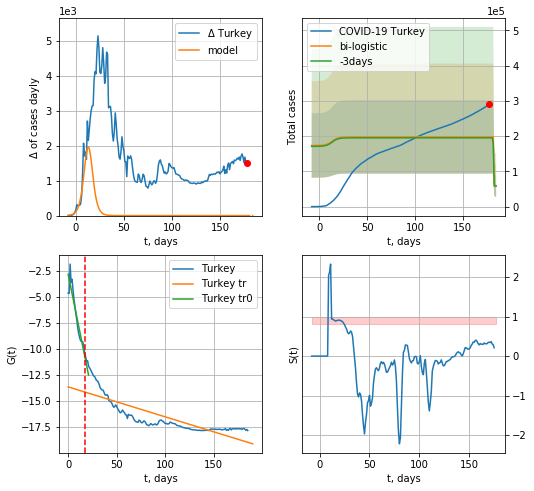

Turkey data at: 2020-09-12
+3 day model MAPE: 0.013075985069883297
model: bi-logistic
coeffs:  [ 1.38663925e+05 -2.46687324e+01  1.82886667e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5265200480977881
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  58933 ± 31029
	 total death:  1424 ± 2249
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.657483
 intercept: -13.635641
 slope: -0.028802


In [2197]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


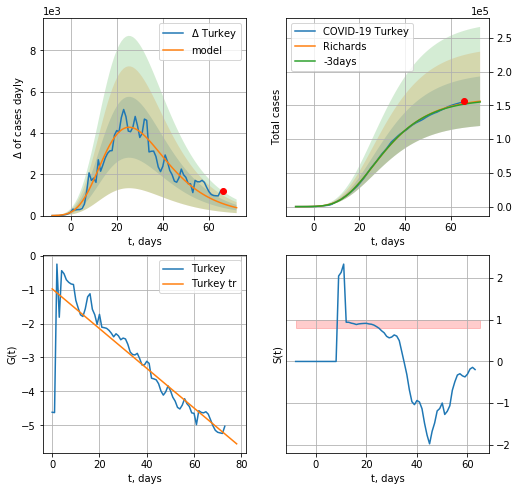

Turkey data at: 2020-09-12
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +7 days
	 deltaDaycases: 382
	 total cases: 156063 ± 36686
	 total death: 3771 ± 2659
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


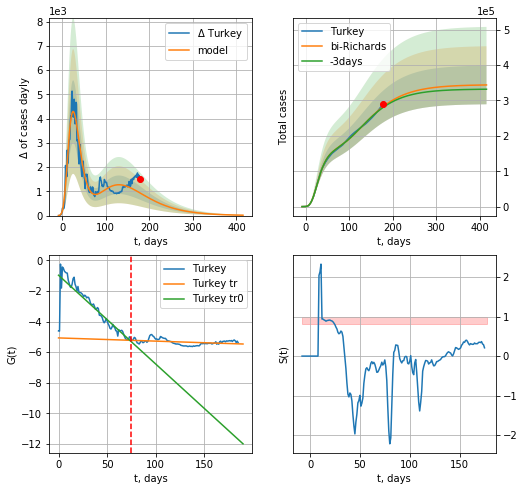

Turkey data at: 2020-09-12
+3 day model MAPE: 0.008388
model: bi-Richards
coeffs: [ 1.83487683e+05  1.84275055e+00 -1.10994870e+02  1.02454541e-02]
rational stdev: 0.159019
forecast at the end of period: +238 days
	 deltaDaycases: 16
	 total cases: 343868 ± 54681
	 total death: 8309 ± 3963
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.777925
 intercept: -0.971827
 slope: -0.058035
trend coefficient of determination: 0.129755
 intercept: -5.072315
 slope: -0.002094


In [2200]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2201]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


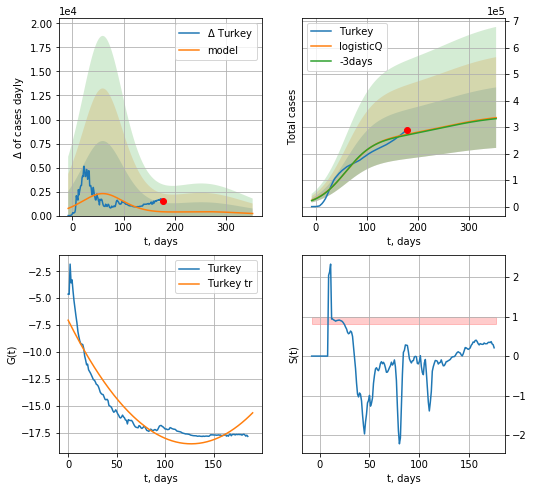

Turkey data at: 2020-09-12
+3 day model MAPE: 0.011251
model: logisticQ
coeffs: [ 2.58903404e+05  4.02970349e-08  5.92880718e+01 -8.59902407e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.340067
forecast at the end of period: +175 days
	 deltaDaycases: 217
	 total cases: 335805 ± 114196
	 total death: 8114 ± 8277
trend coefficient of determination: 0.883778
 intercept_: -7.045598859278302
 coeffs_: [ 0.         -0.18131552  0.000716  ]


In [2202]:
x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [2203]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.023744911804613297

In [2204]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
188 2020-09-08  71947.0   12665  2147.0
189 2020-09-09  72453.0   12225  2159.0
190 2020-09-10  73047.0   12030  2169.0
191 2020-09-11  73650.0   11743  2182.0
192 2020-09-12  73650.0   10809  2182.0


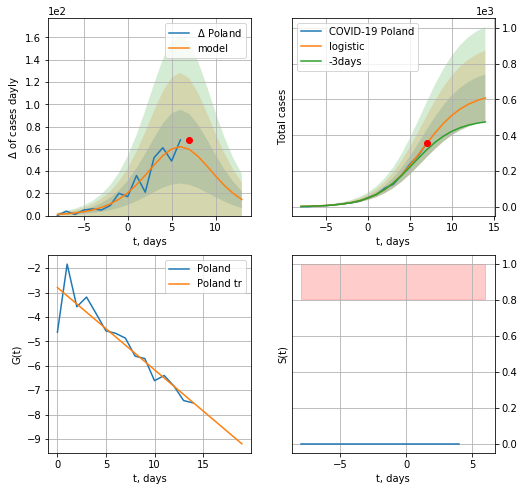

Poland data at: 2020-09-12
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +7 days
	 deltaDaycases:  14
	 total cases:  608 ± 132
	 total death:  18 ± 11
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


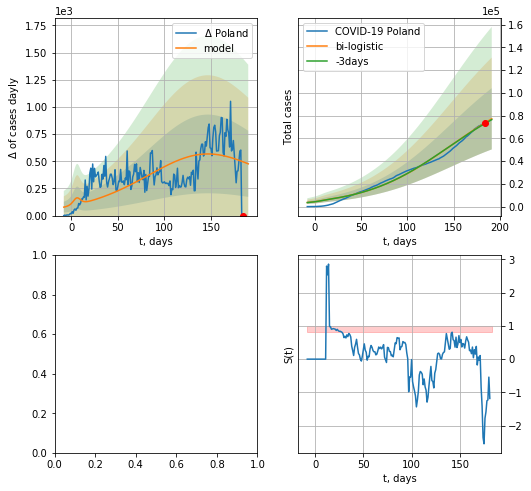

In [2205]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


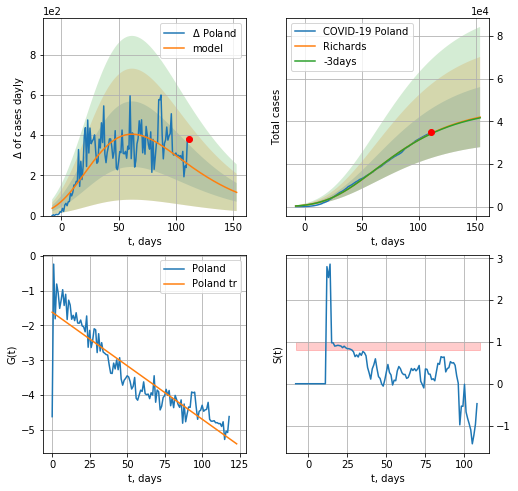

Poland data at: 2020-09-11
+3 day model MAPE: 0.004129
model: Richards
coeffs: [ 4.71367602e+04  2.41241361e+00 -1.35493652e+02  9.71752957e-03]
rational stdev: 0.335893
forecast at the end of period: +43 days
	 deltaDaycases: 115
	 total cases: 41969 ± 14097
	 total death: 1246 ± 1255
trend coefficient of determination: 0.829985
 intercept: -1.620348
 slope: -0.030685


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


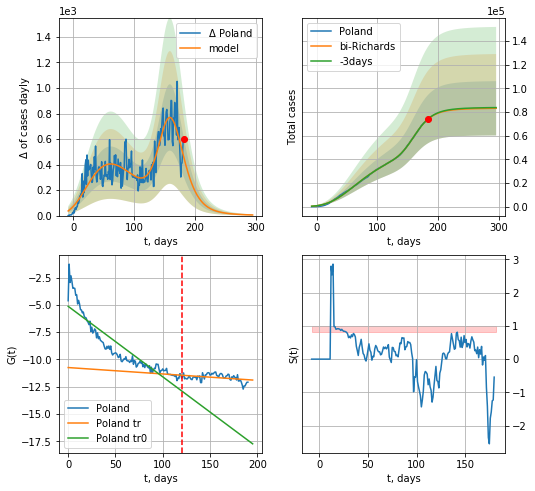

Poland data at: 2020-09-11
+3 day model MAPE: 0.001851
model: bi-Richards
coeffs: [3.61349738e+04 1.01597512e-01 1.54135802e+02 6.49130672e-01]
rational stdev: 0.276032
forecast at the end of period: +113 days
	 deltaDaycases: 4
	 total cases: 83071 ± 22930
	 total death: 2466 ± 2042
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.829344
 intercept: -5.135299
 slope: -0.064536
trend coefficient of determination: 0.134229
 intercept: -10.738793
 slope: -0.005862


In [1995]:
vL = 120
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


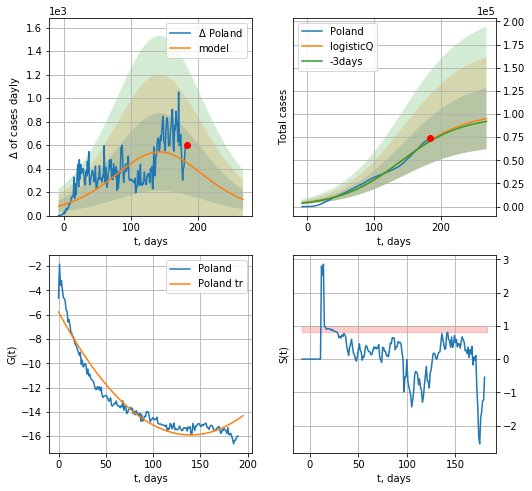

Poland data at: 2020-09-11
+3 day model MAPE: 0.012024
model: logisticQ
coeffs: [ 1.00534046e+05  9.77155444e-08  1.42622193e+02 -2.19582095e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347903
forecast at the end of period: +85 days
	 deltaDaycases: 137
	 total cases: 94929 ± 33026
	 total death: 2818 ± 2941
trend coefficient of determination: 0.918856
 intercept_: -5.77904996536024
 coeffs_: [ 0.         -0.14496476  0.00051895]


In [1996]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
199 2020-09-08  139013.0   30366  1048.0
200 2020-09-09  142582.0   31771  1054.0
201 2020-09-10  146542.0   33926  1077.0
202 2020-09-11  148564.0   35746  1090.0
203 2020-09-12  153217.0   37490  1103.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


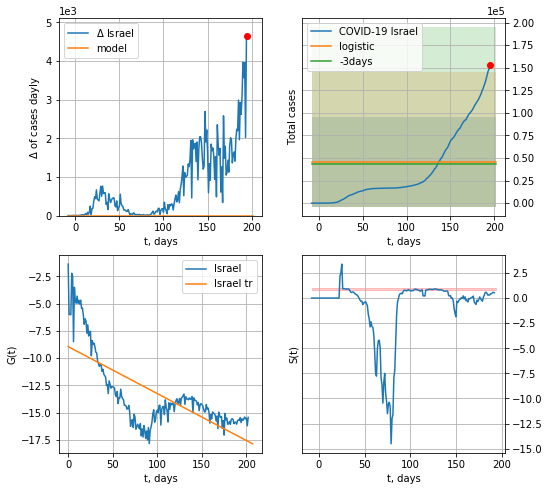

Israel data at: 2020-09-12
+3 day model MAPE: 0.047973007224346914
model: logistic
coeffs:  [ 3.67442750e+04 -1.57238417e+01  3.90461683e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0828781334215511
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  45930 ± 49736
	 total death:  330 ± 1072
trend coefficient of determination: 0.528289
 intercept: -8.945066
 slope: -0.043039


In [2206]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


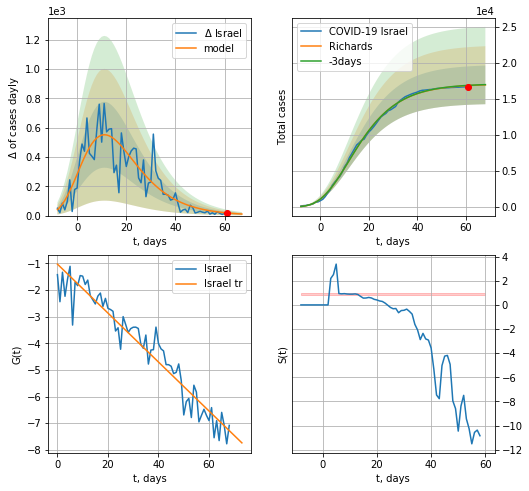

Israel data at: 2020-09-12
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 1.70515692e+04  6.43104023e+00 -3.67761649e+01  1.37703182e-02]
rational stdev: 0.158197
forecast at the end of period: +7 days
	 deltaDaycases: 10
	 total cases: 16936 ± 2679
	 total death: 121 ± 57
trend coefficient of determination: 0.925544
 intercept: -1.027515
 slope: -0.091953


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


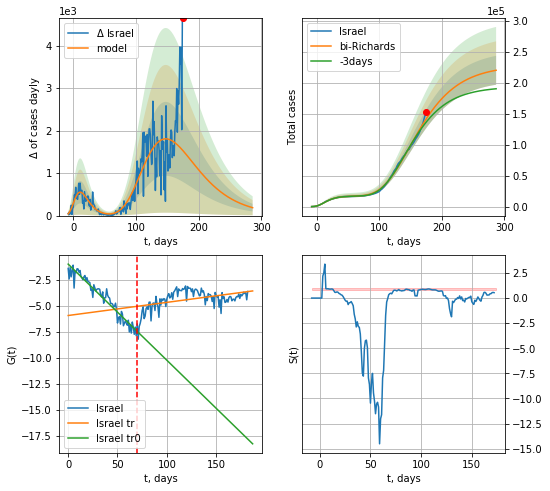

Israel data at: 2020-09-12
+3 day model MAPE: 0.039179
model: bi-Richards
coeffs: [ 2.11348125e+05  2.01517296e+00 -4.27083885e+01  1.16004092e-02]
rational stdev: 0.105951
forecast at the end of period: +112 days
	 deltaDaycases: 186
	 total cases: 220369 ± 23348
	 total death: 1586 ± 504
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.928093
 intercept: -0.997221
 slope: -0.092495
trend coefficient of determination: 0.210576
 intercept: -5.943310
 slope: 0.012638


In [2207]:
x = forecastRR('Israel',dfIS[20:90],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


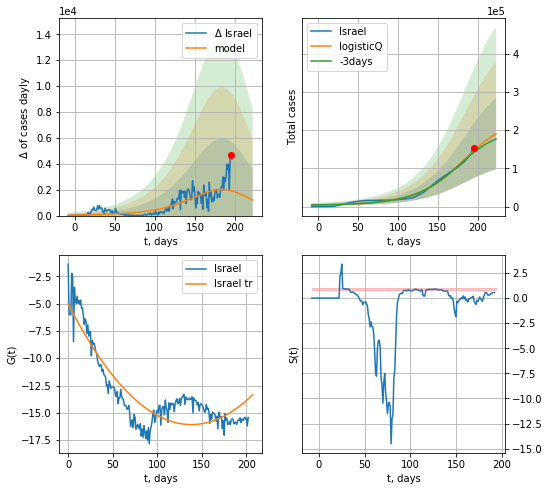

Israel data at: 2020-09-12
+3 day model MAPE: 0.029806
model: logisticQ
coeffs: [ 2.22990994e+05  7.57578042e-05  1.77849315e+02 -2.92709208e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.488730
forecast at the end of period: +28 days
	 deltaDaycases: 1200
	 total cases: 190499 ± 93103
	 total death: 1371 ± 2010
trend coefficient of determination: 0.789823
 intercept_: -5.035344841295208
 coeffs_: [ 0.         -0.15974794  0.00057777]


In [2208]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2210]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date    cases  active   death
196 2020-09-08  44837.0    5119  2018.0
197 2020-09-09  45306.0    5187  2019.0
198 2020-09-10  45711.0    5591  2020.0
199 2020-09-11  46239.0    6119  2020.0
200 2020-09-12  46704.0    6184  2020.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


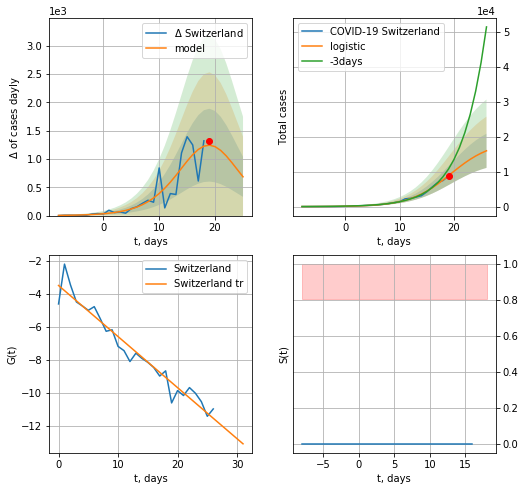

Switzerland data at: 2020-09-12
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +7 days
	 deltaDaycases:  685
	 total cases:  15957 ± 4883
	 total death:  690 ± 633
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


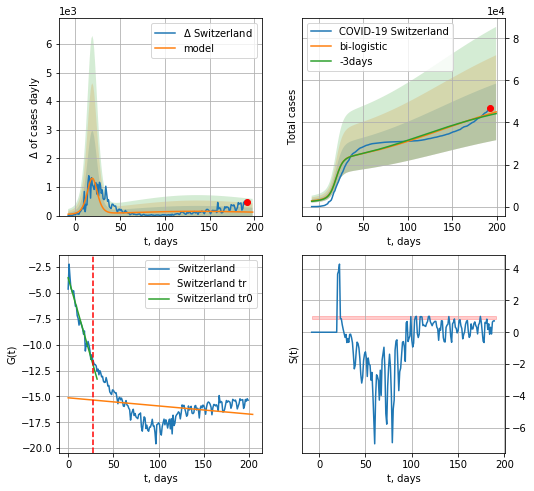

Switzerland data at: 2020-09-12
+3 day model MAPE: 0.01511700970479563
model: bi-logistic
coeffs:  [3.11101417e+04 1.75435323e-02 1.27460841e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2989184142921533
forecast at the end of period: +7 days
	 deltaDaycases:  121
	 total cases:  45035 ± 13462
	 total death:  1947 ± 1745
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.071229
 intercept: -15.131706
 slope: -0.007853


In [2211]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


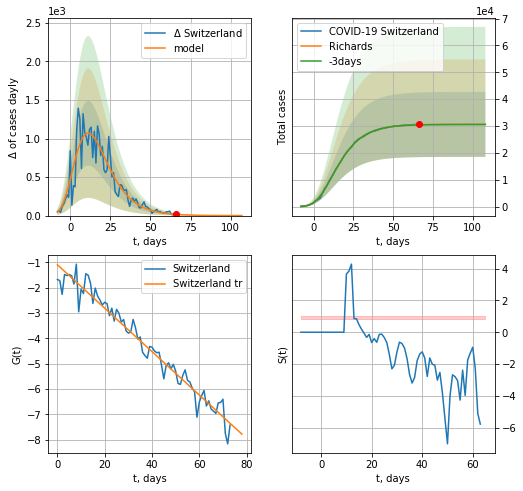

Switzerland data at: 2020-09-12
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 30627 ± 12087
	 total death: 1324 ± 1567
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


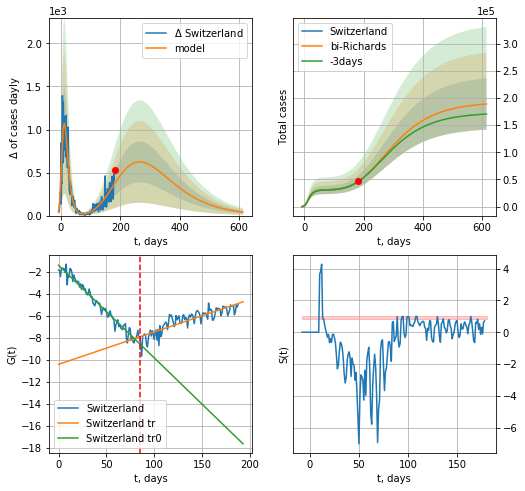

Switzerland data at: 2020-09-12
+3 day model MAPE: 0.002517
model: bi-Richards
coeffs: [ 1.62089600e+05  2.47098640e-01 -2.75930493e+01  4.32821449e-02]
rational stdev: 0.250145
forecast at the end of period: +434 days
	 deltaDaycases: 40
	 total cases: 188889 ± 47249
	 total death: 8169 ± 6130
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.963806
 intercept: -1.405452
 slope: -0.084207
trend coefficient of determination: 0.753710
 intercept: -10.426003
 slope: 0.029486


In [2212]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:-1],d1,7*86-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [2213]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [2214]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
182 2020-09-08  140479.0   76505  2979.0
183 2020-09-09  143030.0   76712  3023.0
184 2020-09-10  145612.0   78675  3076.0
185 2020-09-11  148756.0   80365  3148.0
186 2020-09-12  151859.0   82264  3178.0


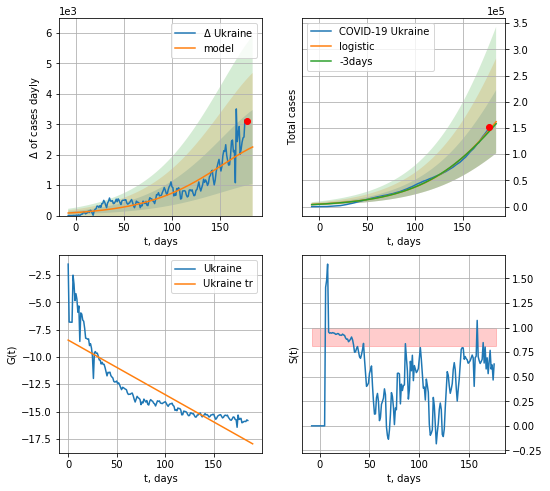

Ukraine data at: 2020-09-12
+3 day model MAPE: 0.018768766969508566
model: logistic
coeffs:  [4.61803895e+05 2.14122423e-02 2.14030620e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3722573013655133
forecast at the end of period: +7 days
	 deltaDaycases:  2253
	 total cases:  161991 ± 60302
	 total death:  3335 ± 3724
trend coefficient of determination: 0.743393
 intercept: -8.459862
 slope: -0.049987


In [2216]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


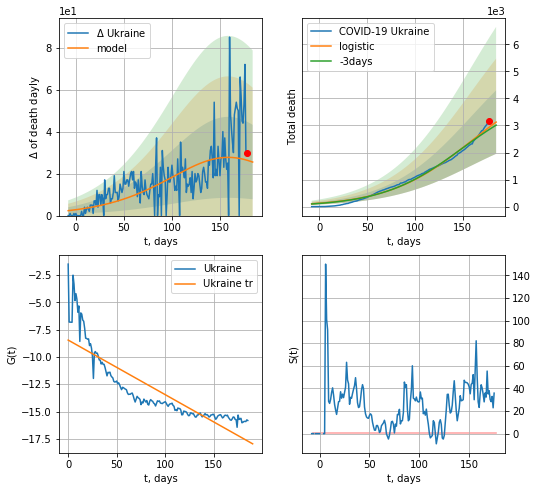

Ukraine data at: 2020-09-12
+3 day model MAPE: 0.03135703297417099
model: logistic
coeffs:  [4.84671164e+03 2.28888740e-02 1.58958208e+02]
rational stdev:  0.37540558833761195
forecast at the end of period: +7 days
	 total death:  3124 ± 1173
trend coefficient of determination: 0.743393
 intercept: -8.459862
 slope: -0.049987


In [2217]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


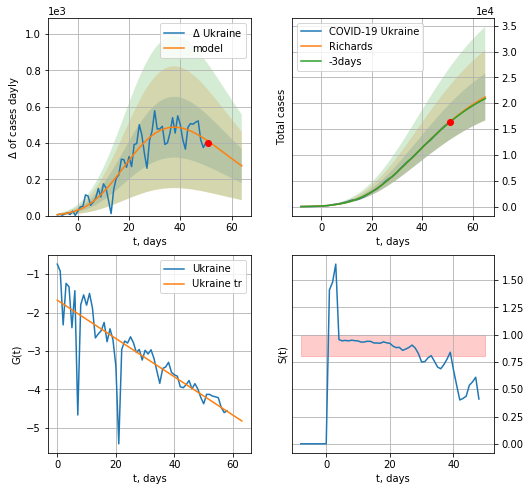

Ukraine data at: 2020-09-12
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +14 days
	 deltaDaycases: 273
	 total cases: 21196 ± 4520
	 total death: 436 ± 278
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


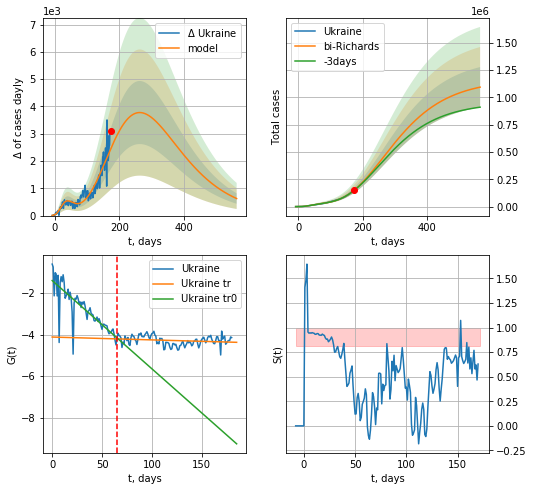

Ukraine data at: 2020-09-12
+3 day model MAPE: 0.010542
model: bi-Richards
coeffs: [ 1.13647863e+06  4.22497069e-01 -1.56292203e+02  2.16034089e-02]
rational stdev: 0.168089
forecast at the end of period: +392 days
	 deltaDaycases: 624
	 total cases: 1093366 ± 183783
	 total death: 22514 ± 11353
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.672965
 intercept: -1.401915
 slope: -0.042461
trend coefficient of determination: 0.041600
 intercept: -4.120499
 slope: -0.001369


In [2218]:
vL = 70#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*26-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*80-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [2219]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [1829]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

IN
           date   cases  active    death
202 2020-09-08  391112   31156  22542.0
203 2020-09-09  393425   31645  22669.0
204 2020-09-10  395488   31848  22798.0
205 2020-09-11  397801   32349  22913.0
206 2020-09-12  399940   32395  23029.0


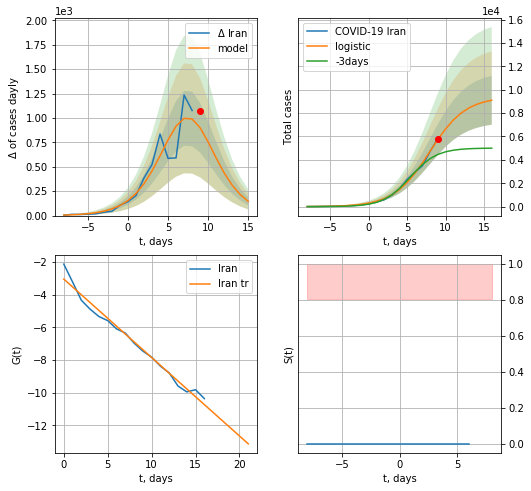

Iran data at: 2020-09-12
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +7 days
	 deltaDaycases:  145
	 total cases:  9101 ± 2090
	 total death:  524 ± 361
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


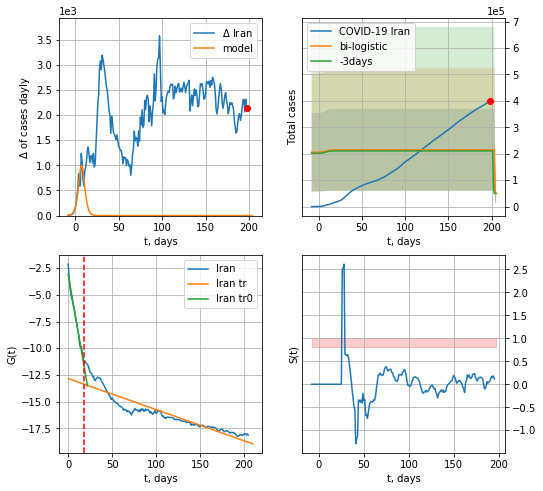

Iran data at: 2020-09-12
+3 day model MAPE: 0.019532320853126804
model: bi-logistic
coeffs:  [ 1.64402810e+05 -6.38175236e+01  2.03248952e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7209707586212304
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  50486 ± 36399
	 total death:  2907 ± 6287
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.852851
 intercept: -12.838757
 slope: -0.029148


In [2220]:
dfIN = read_df(pd.DataFrame(),"IN")
x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


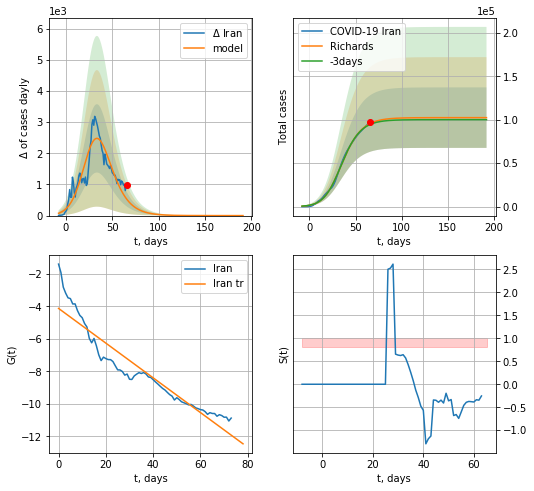

Iran data at: 2020-09-12
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478152e+05 1.52216307e-01 2.65523943e+01 5.45962781e-01]
rational stdev: 0.339941
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 102477 ± 34836
	 total death: 5900 ± 6016
trend coefficient of determination: 0.893485
 intercept: -4.118018
 slope: -0.106957


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


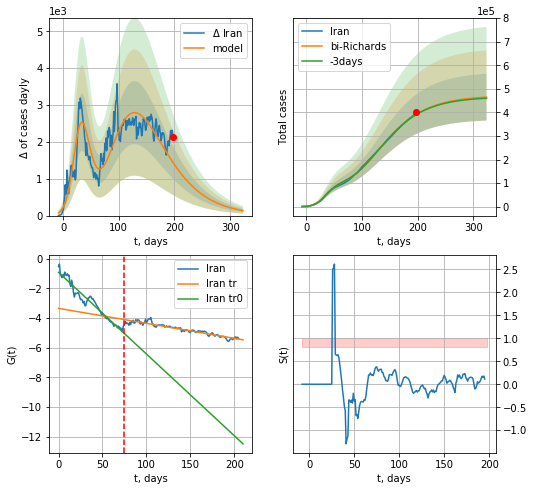

Iran data at: 2020-09-12
+3 day model MAPE: 0.004014
model: bi-Richards
coeffs: [ 3.68915132e+05  1.94125163e+00 -9.07122383e+01  1.06494936e-02]
rational stdev: 0.213720
forecast at the end of period: +126 days
	 deltaDaycases: 134
	 total cases: 464902 ± 99358
	 total death: 26769 ± 17163
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949241
 intercept: -0.909828
 slope: -0.055063
trend coefficient of determination: 0.904692
 intercept: -3.340428
 slope: -0.010094


In [2221]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


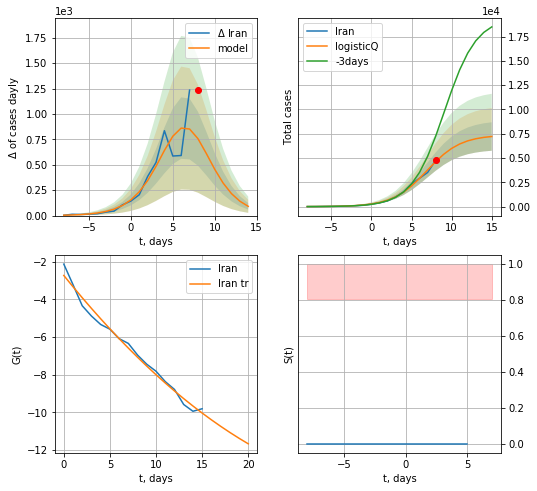

Iran data at: 2020-09-12
+3 day model MAPE: 0.437962
model: logisticQ
coeffs: [ 7.36885077e+03  7.42724103e-05 -6.37161781e+03  6.90116795e+00]
rational stdev: 0.203007
forecast at the end of period: +7 days
	 deltaDaycases: 90
	 total cases: 7214 ± 1464
	 total death: 415 ± 252
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


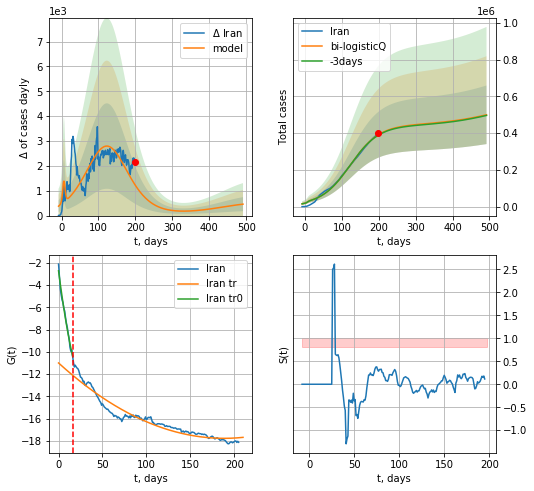

Iran data at: 2020-09-12
+3 day model MAPE: 0.005373
model: bi-logisticQ
coeffs: [ 4.36641347e+05  1.18255918e-07  1.22838432e+02 -2.15814007e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319000
forecast at the end of period: +294 days
	 deltaDaycases: 459
	 total cases: 500290 ± 159592
	 total death: 28807 ± 27568
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.934161
 intercept_: -11.002410965032313
 coeffs_: [ 0.         -0.07183153  0.00019049]


In [2222]:
x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
192 2020-09-08  1035789.0  166414  18135.0
193 2020-09-09  1041007.0  165734  18263.0
194 2020-09-10  1046370.0  165402  18365.0
195 2020-09-11  1051874.0  165343  18484.0
196 2020-09-12  1057362.0  168008  18578.0


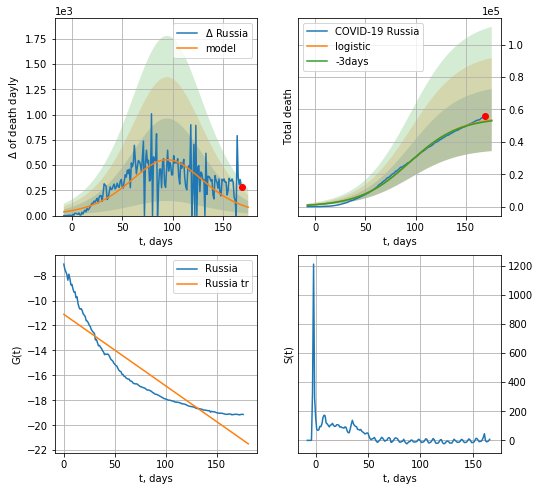

Russia data at: 2020-09-12
+3 day model MAPE: 0.0092713801831393
model: logistic
coeffs:  [5.56190033e+04 3.97793222e-02 9.49247476e+01]
rational stdev:  0.358511596956553
forecast at the end of period: +7 days
	 total death:  53492 ± 19177
trend coefficient of determination: 0.826902
 intercept: -11.103280
 slope: -0.057370


In [2224]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


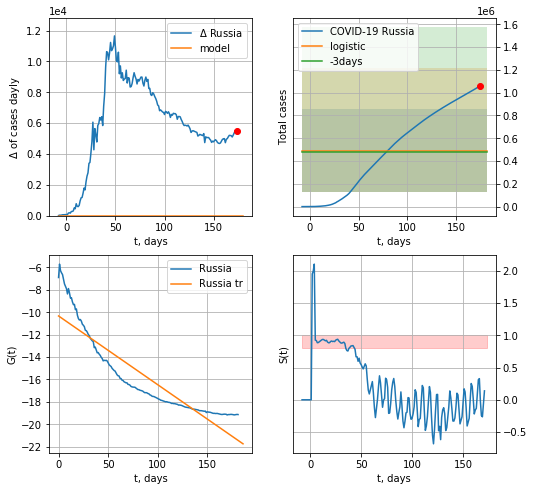

Russia data at: 2020-09-12
+3 day model MAPE: 0.019470326480652302
model: logistic
coeffs:  [ 4.90174082e+05 -1.26881702e+01  3.15807742e+02]
rational stdev:  0.738882589132641
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  490174 ± 362181
	 total death:  8568 ± 18992
trend coefficient of determination: 0.821525
 intercept: -10.331182
 slope: -0.061358


In [2225]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


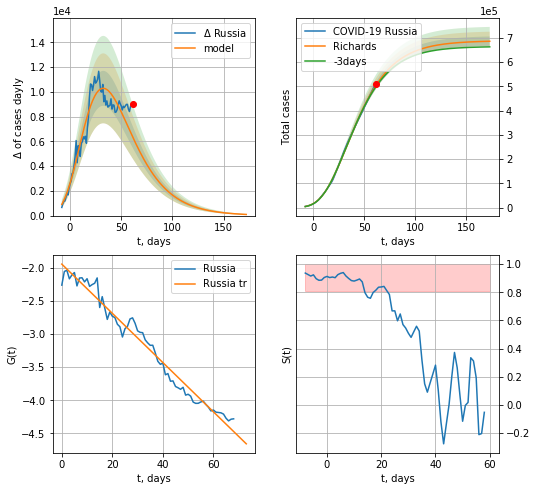

Russia data at: 2020-09-12
+3 day model MAPE: 0.010822
model: Richards
coeffs: [ 6.88418485e+05  2.24771706e+00 -6.48448453e+01  1.82243445e-02]
rational stdev: 0.028811
forecast at the end of period: +112 days
	 deltaDaycases: 92
	 total cases: 686204 ± 19770
	 total death: 11994 ± 1036
trend coefficient of determination: 0.974032
 intercept: -1.941717
 slope: -0.037219


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


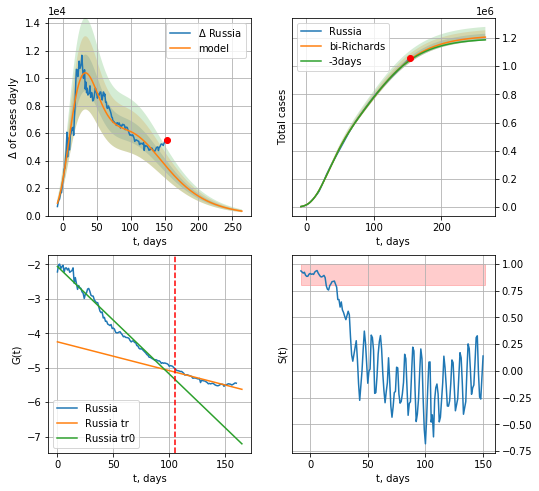

Russia data at: 2020-09-12
+3 day model MAPE: 0.004313
model: bi-Richards
coeffs: [ 5.30567671e+05  1.79281547e+00 -6.35068343e+01  1.35431694e-02]
rational stdev: 0.020035
forecast at the end of period: +112 days
	 deltaDaycases: 324
	 total cases: 1205648 ± 24155
	 total death: 21074 ± 1266
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.971804
 intercept: -2.060813
 slope: -0.031198
trend coefficient of determination: 0.840950
 intercept: -4.248167
 slope: -0.008354


In [2226]:
vL = 105 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


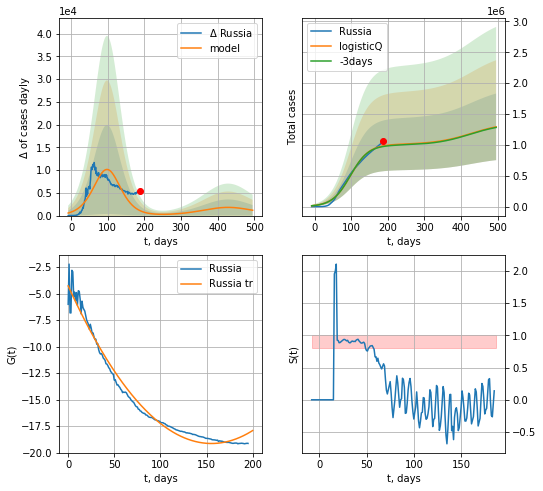

Russia data at: 2020-09-12
+3 day model MAPE: 0.009994
model: logisticQ
coeffs: [ 1.00835288e+06  9.35087534e-08  9.83085018e+01 -4.29749794e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.417505
forecast at the end of period: +308 days
	 deltaDaycases: 1177
	 total cases: 1292835 ± 539764
	 total death: 22598 ± 28304
trend coefficient of determination: 0.979304
 intercept_: -4.267132928274583
 coeffs_: [ 0.         -0.19137161  0.00061558]


In [2227]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active   death
230 2020-09-08  72234.0    7575  1377.0
231 2020-09-09  72726.0    7233  1393.0
232 2020-09-10  73221.0    6980  1406.0
233 2020-09-11  73901.0    6899  1412.0
234 2020-09-12  74544.0    6841  1423.0


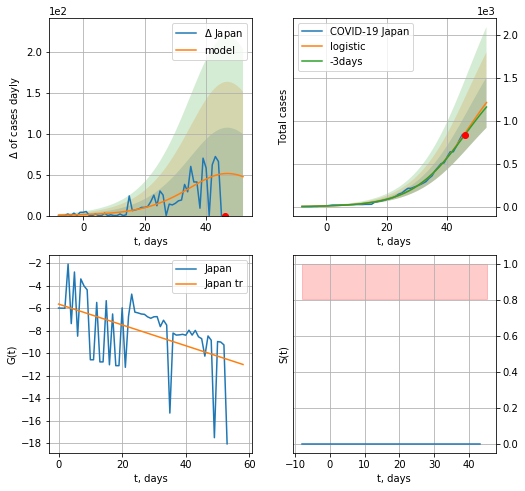

Japan data at: 2020-09-12
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +7 days
	 deltaDaycases:  47
	 total cases:  1211 ± 293
	 total death:  23 ± 16
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


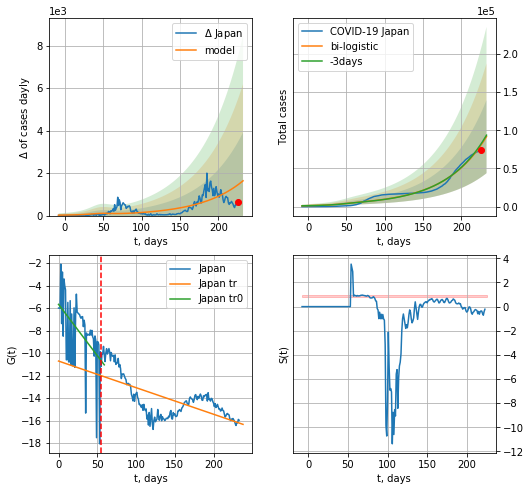

Japan data at: 2020-09-12
+3 day model MAPE: 0.018210986362541995
model: bi-logistic
coeffs:  [4.73113464e+07 1.84171715e-02 5.73169951e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5226304240971016
forecast at the end of period: +7 days
	 deltaDaycases:  1635
	 total cases:  91671 ± 47910
	 total death:  1749 ± 2742
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.440104
 intercept: -10.712872
 slope: -0.023642


In [2228]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

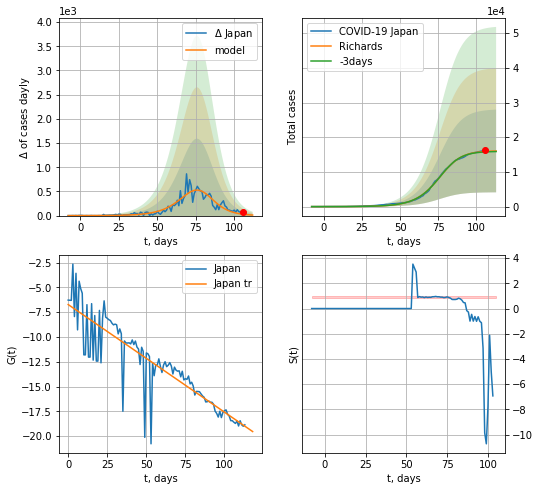

Japan data at: 2020-09-12
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043525e+04 1.05070375e-01 7.85362635e+01 1.40112814e+00]
rational stdev: 0.743333
forecast at the end of period: +7 days
	 deltaDaycases: 11
	 total cases: 16032 ± 11917
	 total death: 306 ± 682
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


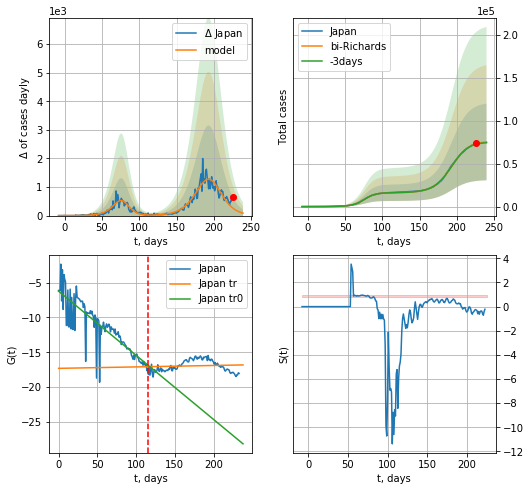

Japan data at: 2020-09-12
+3 day model MAPE: 0.008902
model: bi-Richards
coeffs: [6.02968611e+04 7.53232501e-02 1.95233203e+02 1.18357900e+00]
rational stdev: 0.592527
forecast at the end of period: +14 days
	 deltaDaycases: 84
	 total cases: 75475 ± 44721
	 total death: 1440 ± 2559
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.721395
 intercept: -6.234172
 slope: -0.092076
trend coefficient of determination: 0.007371
 intercept: -17.313602
 slope: 0.002064


In [2229]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


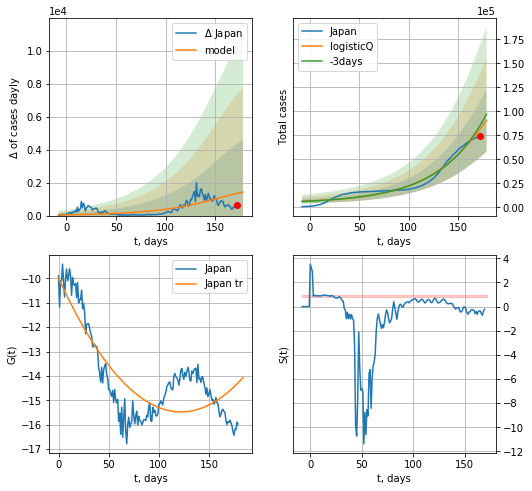

Japan data at: 2020-09-12
+3 day model MAPE: 0.046238
model: logisticQ
coeffs: [ 2.02472442e+05  6.04426147e-05  1.86413078e+02 -2.99787528e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.358382
forecast at the end of period: +7 days
	 deltaDaycases: 1421
	 total cases: 90604 ± 32470
	 total death: 1729 ± 1858
trend coefficient of determination: 0.676786
 intercept_: -9.988617688272624
 coeffs_: [ 0.         -0.08991719  0.0003681 ]


In [2230]:
x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
194 2020-09-08  76548.0       0  6244.0
195 2020-09-09  77688.0       0  6246.0
196 2020-09-10  78511.0       0  6249.0
197 2020-09-11  79781.0       0  6252.0
198 2020-09-12  81012.0       0  6253.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


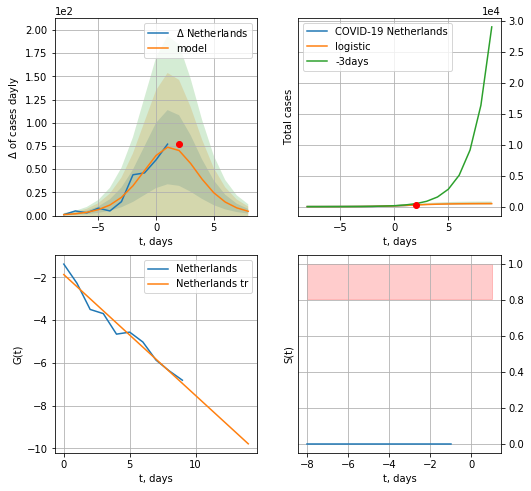

Netherlands data at: 2020-09-12
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +7 days
	 deltaDaycases:  4
	 total cases:  482 ± 114
	 total death:  37 ± 26
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


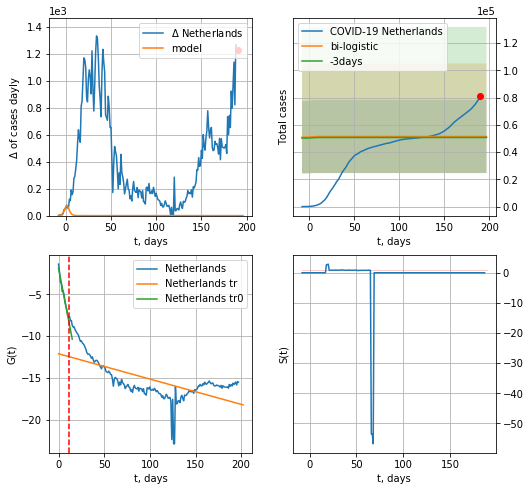

Netherlands data at: 2020-09-12
+3 day model MAPE: 0.014513922332437361
model: bi-logistic
coeffs:  [ 4.07900338e+04 -7.61409100e+00  2.12142251e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5210948050074692
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  51475 ± 26823
	 total death:  3973 ± 6210
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.432850
 intercept: -12.095987
 slope: -0.030244


In [2231]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


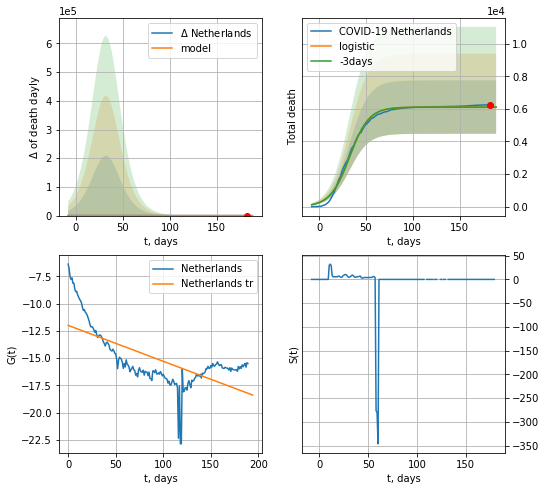

Netherlands data at: 2020-09-12
+3 day model MAPE: 0.000647458682160787
model: logistic
coeffs:  [6.11123632e+03 9.71953094e-02 3.25065064e+01]
rational stdev:  0.26849064097113107
forecast at the end of period: +7 days
	 total death:  6111 ± 1640
trend coefficient of determination: 0.456529
 intercept: -11.998068
 slope: -0.032927


In [2232]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


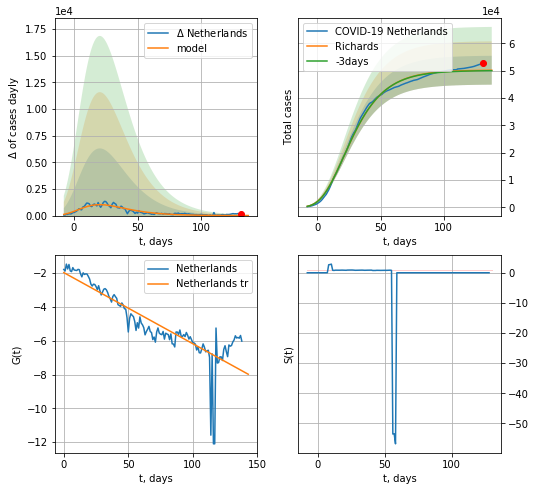

Netherlands data at: 2020-09-12
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +7 days
	 deltaDaycases: 4
	 total cases: 50168 ± 5283
	 total death: 3872 ± 1223
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


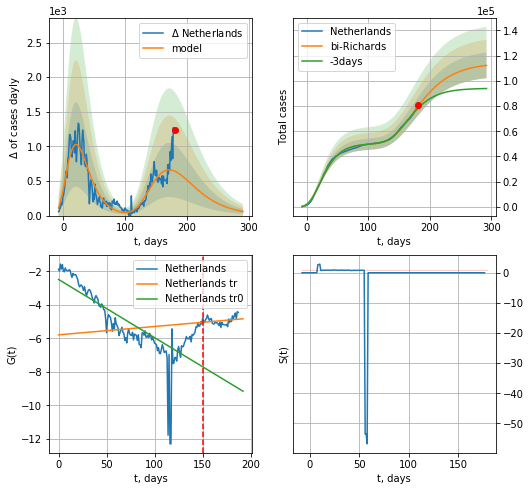

Netherlands data at: 2020-09-12
+3 day model MAPE: 0.019816
model: bi-Richards
coeffs: [6.40377362e+04 1.18722852e+00 4.02344911e+01 2.38724317e-02]
rational stdev: 0.090611
forecast at the end of period: +112 days
	 deltaDaycases: 59
	 total cases: 112179 ± 10164
	 total death: 8658 ± 2353
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.624663
 intercept: -2.488286
 slope: -0.034708
trend coefficient of determination: 0.055574
 intercept: -5.790446
 slope: 0.004982


In [2233]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2234]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


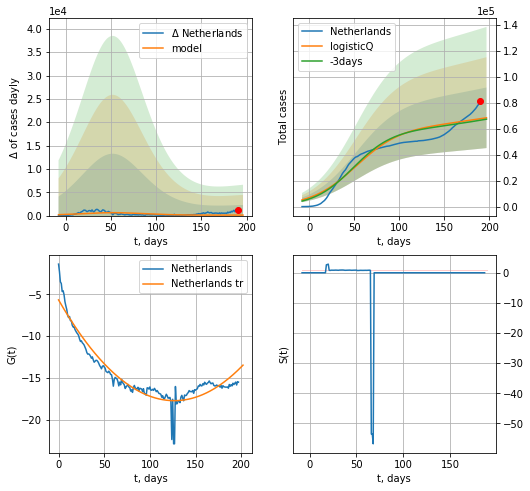

Netherlands data at: 2020-09-12
+3 day model MAPE: 0.017046
model: logisticQ
coeffs: [ 6.08685288e+04  2.30524109e-08  5.18304376e+01 -1.74737834e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.341028
forecast at the end of period: +7 days
	 deltaDaycases: 107
	 total cases: 68402 ± 23327
	 total death: 5279 ± 5400
trend coefficient of determination: 0.900781
 intercept_: -5.66197144429567
 coeffs_: [ 0.         -0.19001115  0.00074964]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


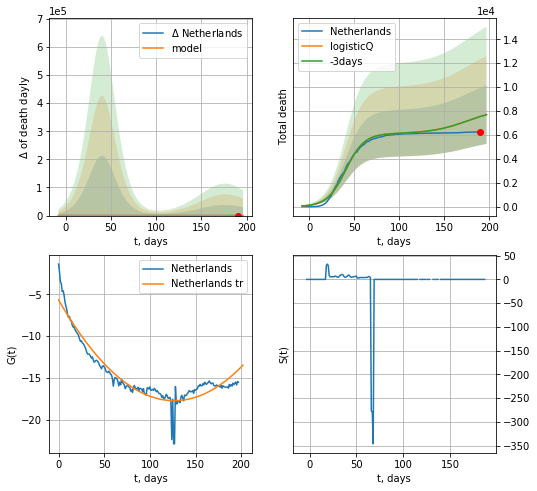

Netherlands data at: 2020-09-12
+3 day model MAPE: 0.000278
model: logisticQ
coeffs: [ 6.11056917e+03  2.84046965e-07  4.05081476e+01 -3.42965616e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317961
forecast at the end of period: +7 days
	 total death: 7693 ± 2446
trend coefficient of determination: 0.900781
 intercept_: -5.66197144429567
 coeffs_: [ 0.         -0.19001115  0.00074964]


In [2236]:
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [2237]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
195 2020-09-08  30583.0    4072  747.0
196 2020-09-09  31247.0    4456  748.0
197 2020-09-10  31827.0    4820  750.0
198 2020-09-11  32696.0    5363  754.0
199 2020-09-12  33159.0    5643  756.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


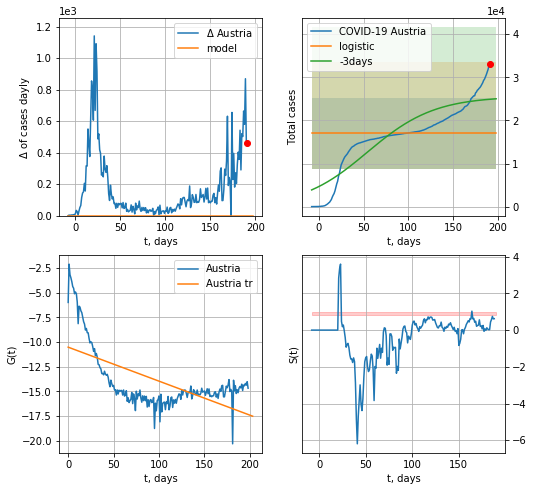

Austria data at: 2020-09-12
+3 day model MAPE: 0.3162779559226477
model: logistic
coeffs:  [16038.36004877   -38.79811179   215.77928247]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.4822271139269769
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  17040 ± 8217
	 total death:  388 ± 561
trend coefficient of determination: 0.384899
 intercept: -10.528135
 slope: -0.034407


In [2238]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


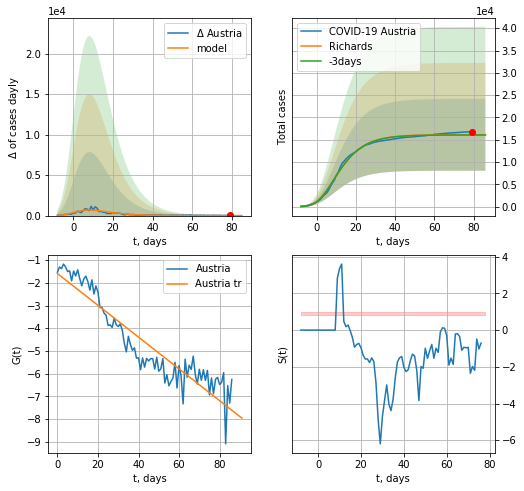

Austria data at: 2020-09-12
+3 day model MAPE: 0.003709
model: Richards
coeffs: [ 1.61192499e+04  1.98642454e+01 -3.60141550e+01  5.80916335e-03]
rational stdev: 0.499924
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 16117 ± 8057
	 total death: 367 ± 550
trend coefficient of determination: 0.864773
 intercept: -1.593329
 slope: -0.069938


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


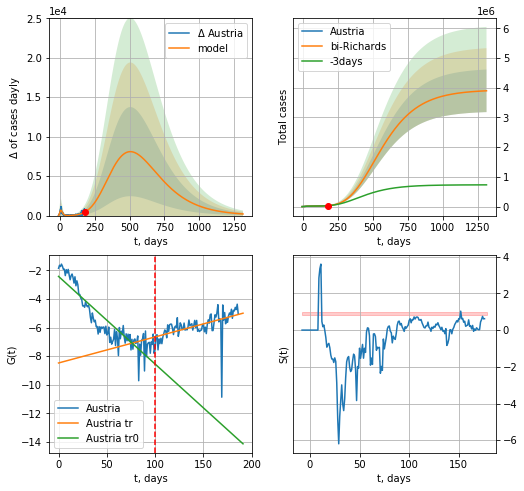

Austria data at: 2020-09-12
+3 day model MAPE: 0.022305
model: bi-Richards
coeffs: [3.91465799e+06 8.18236689e-02 5.27725032e+01 7.12003308e-02]
rational stdev: 0.183892
forecast at the end of period: +1134 days
	 deltaDaycases: 206
	 total cases: 3895333 ± 716322
	 total death: 88810 ± 48994
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.815737
 intercept: -2.424230
 slope: -0.061333
trend coefficient of determination: 0.290076
 intercept: -8.482064
 slope: 0.018237


In [2239]:
vL=100+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d12f(1),186*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


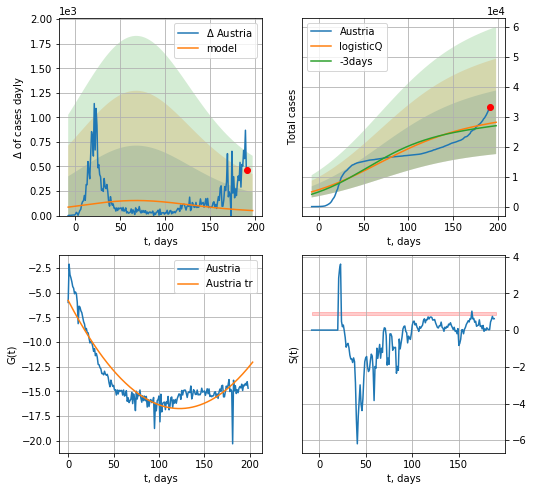

Austria data at: 2020-09-12
+3 day model MAPE: 0.039991
model: logisticQ
coeffs: [ 2.69943644e+04  1.92105272e-08  6.59835005e+01 -1.12285025e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.376958
forecast at the end of period: +7 days
	 deltaDaycases: 51
	 total cases: 28139 ± 10607
	 total death: 641 ± 724
trend coefficient of determination: 0.838911
 intercept_: -5.8000460566543754
 coeffs_: [ 0.         -0.17841014  0.00072729]


In [2240]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
191 2020-09-08  89141.0   60627  9912.0
192 2020-09-09  89691.0   61139  9917.0
193 2020-09-10  90568.0   61992  9917.0
194 2020-09-11  91537.0   62929  9919.0
195 2020-09-12  92478.0   63846  9923.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


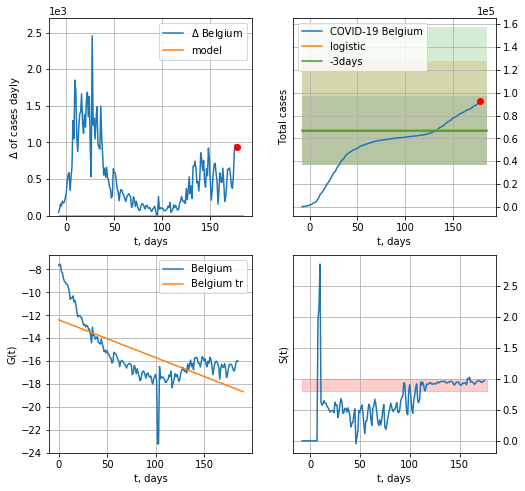

Belgium data at: 2020-09-12
+3 day model MAPE: 0.011665297809526525
model: logistic
coeffs:  [ 5.36120583e+04 -1.10076150e+01  3.30126437e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.45036765065590856
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  67015 ± 30181
	 total death:  7190 ± 9714
trend coefficient of determination: 0.471767
 intercept: -12.395403
 slope: -0.033032


In [2241]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

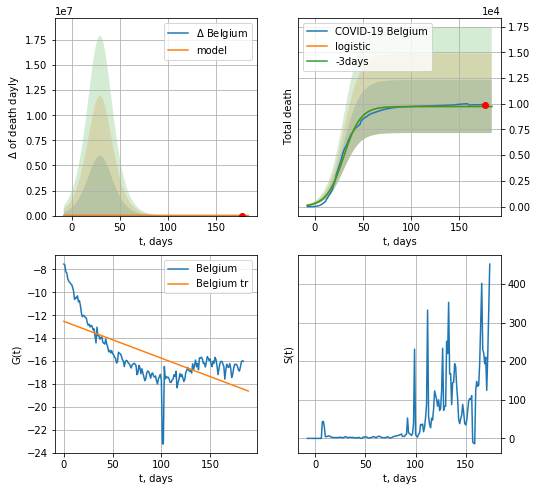

Belgium data at: 2020-09-12
+3 day model MAPE: 0.0005306719703117909
model: logistic
coeffs:  [9.73330794e+03 1.13893350e-01 2.99105626e+01]
rational stdev:  0.2648670146768042
forecast at the end of period: +7 days
	 total death:  9733 ± 2578
trend coefficient of determination: 0.463873
 intercept: -12.531068
 slope: -0.032195


In [2242]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


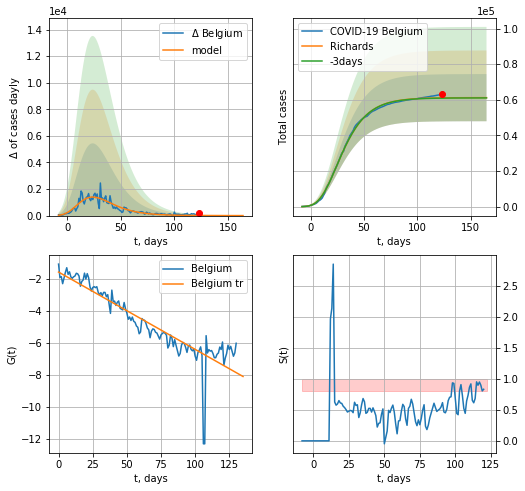

Belgium data at: 2020-09-12
+3 day model MAPE: 0.002325
model: Richards
coeffs: [ 6.11994198e+04  7.57384886e+00 -5.28924887e+01  8.21594131e-03]
rational stdev: 0.216332
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 61189 ± 13237
	 total death: 6565 ± 4260
trend coefficient of determination: 0.812352
 intercept: -1.573316
 slope: -0.048332


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


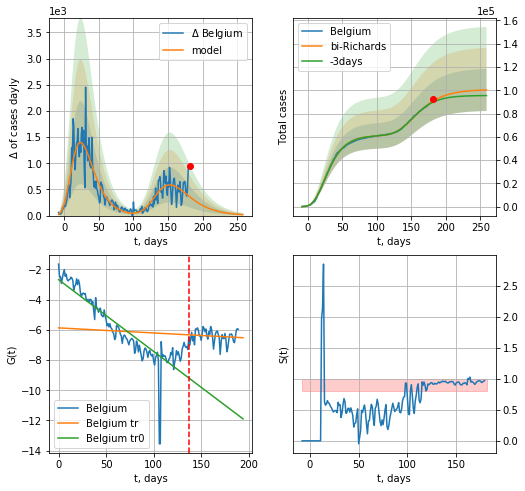

Belgium data at: 2020-09-12
+3 day model MAPE: 0.011905
model: bi-Richards
coeffs: [3.94764248e+04 3.53717572e-01 1.03494039e+02 1.20664503e-01]
rational stdev: 0.180168
forecast at the end of period: +77 days
	 deltaDaycases: 18
	 total cases: 100249 ± 18061
	 total death: 10756 ± 5813
bi-Richards approximation splitting point: 137
trend coefficient of determination: 0.783421
 intercept: -2.681777
 slope: -0.047480
trend coefficient of determination: 0.015197
 intercept: -5.873869
 slope: -0.003354


In [2244]:
iL = 5
vL = 137+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2245]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2246]:
dfBZ.tail()

,date,cases,active,death
196,2020-09-08,4165124.0,640373,127517.0
197,2020-09-09,4199332.0,617343,128653.0
198,2020-09-10,4239763.0,612851,129575.0
199,2020-09-11,4283978.0,622849,130474.0
200,2020-09-12,4315858.0,631163,131274.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


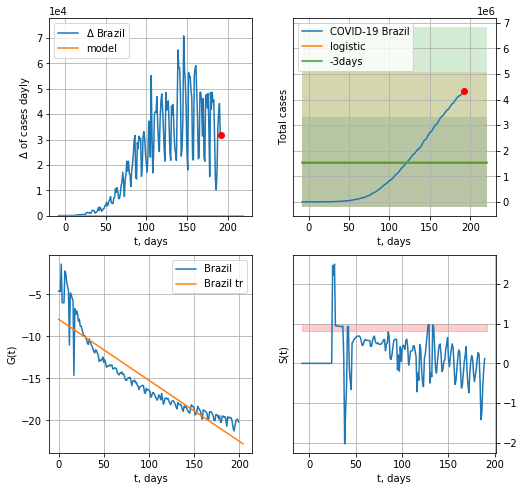

Brazil data at: 2020-09-12
+3 day model MAPE: 0.037795299000844926
model: logistic
coeffs:  [ 1.25743675e+06 -2.28036857e+01  5.48364321e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.1169155663343338
forecast at the end of period: +28 days
	 deltaDaycases:  0
	 total cases:  1571795 ± 1755563
	 total death:  47808 ± 160192
trend coefficient of determination: 0.851873
 intercept: -7.974341
 slope: -0.072578


In [2247]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


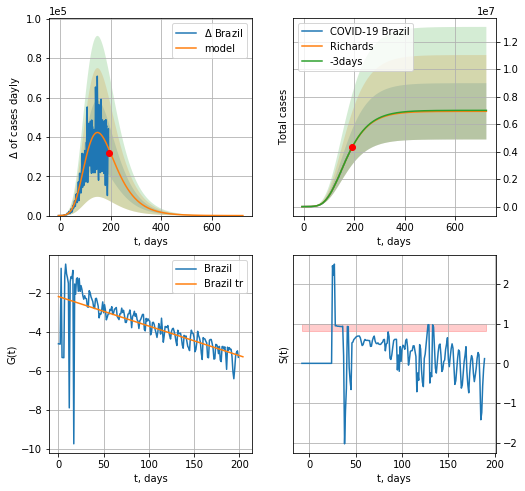

Brazil data at: 2020-09-12
+3 day model MAPE: 0.001801
model: Richards
coeffs: [ 6.92656820e+06  6.32390650e-01 -6.86619233e+01  2.65717053e-02]
rational stdev: 0.295326
forecast at the end of period: +532 days
	 deltaDaycases: 7
	 total cases: 6926140 ± 2045469
	 total death: 210670 ± 186648
trend coefficient of determination: 0.465388
 intercept: -2.191315
 slope: -0.015163


In [2248]:
x = forecastRR('Brazil',dfBZ[:],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


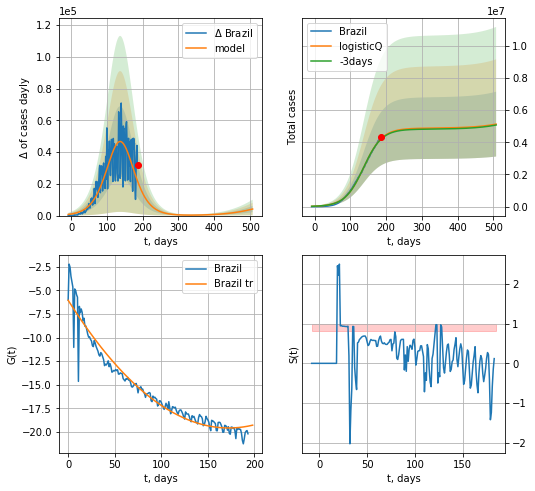

Brazil data at: 2020-09-12
+3 day model MAPE: 0.006527
model: logisticQ
coeffs: [ 4.87265309e+06  2.64910955e-07  1.37531422e+02 -1.44428505e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392848
forecast at the end of period: +322 days
	 deltaDaycases: 4131
	 total cases: 5125840 ± 2013673
	 total death: 155910 ± 183746
trend coefficient of determination: 0.943034
 intercept_: -6.057160694354819
 coeffs_: [ 0.         -0.15672765  0.0004544 ]


In [2249]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2250]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
206 2020-09-08  26465.0    2821  781.0
207 2020-09-09  26513.0    2689  788.0
208 2020-09-10  26565.0    2551  797.0
209 2020-09-11  26607.0    2475  803.0
210 2020-09-12  26651.0    2501  810.0


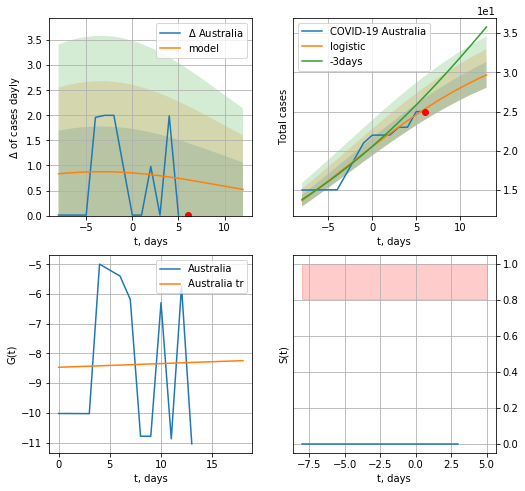

Australia data at: 2020-09-12
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  29 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


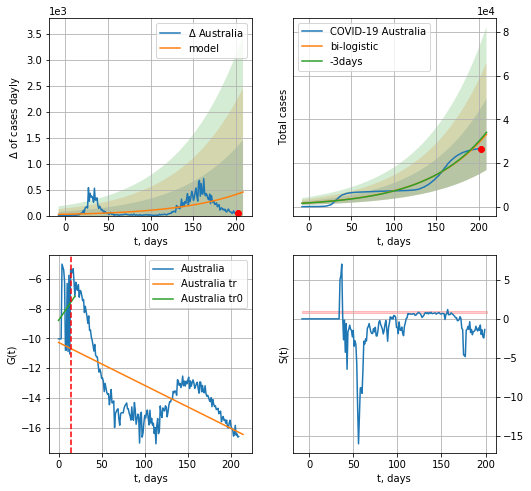

Australia data at: 2020-09-12
+3 day model MAPE: 0.023289579968347112
model: bi-logistic
coeffs:  [1.12768472e+06 1.42078863e-02 4.55155027e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.4945653652833821
forecast at the end of period: +7 days
	 deltaDaycases:  453
	 total cases:  33176 ± 16407
	 total death:  1008 ± 1495
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.375080
 intercept: -10.265909
 slope: -0.028931


In [2251]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


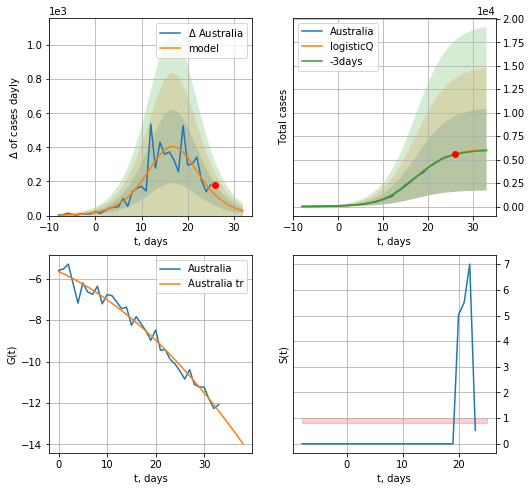

Australia data at: 2020-09-12
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +7 days
	 deltaDaycases: 28
	 total cases: 6073 ± 4353
	 total death: 184 ± 395
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


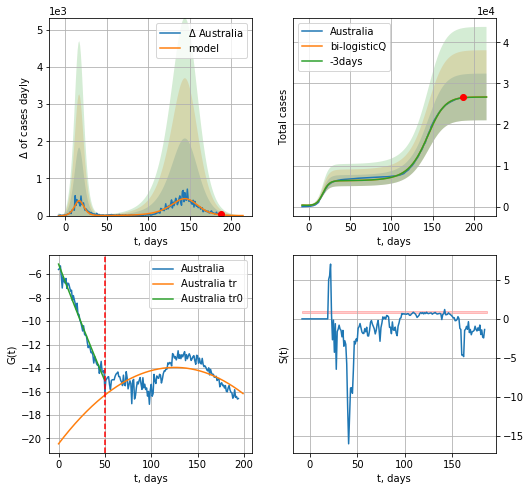

Australia data at: 2020-09-12
+3 day model MAPE: 0.000945
model: bi-logisticQ
coeffs: [ 2.05330794e+04  4.08286404e-04  1.42238355e+02 -7.31779447e+01]
rational stdev: 0.212685
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 26697 ± 5678
	 total death: 811 ± 517
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.345764
 intercept_: -20.45439491848687
 coeffs_: [ 0.          0.1036234  -0.00041263]


In [2252]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,28*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


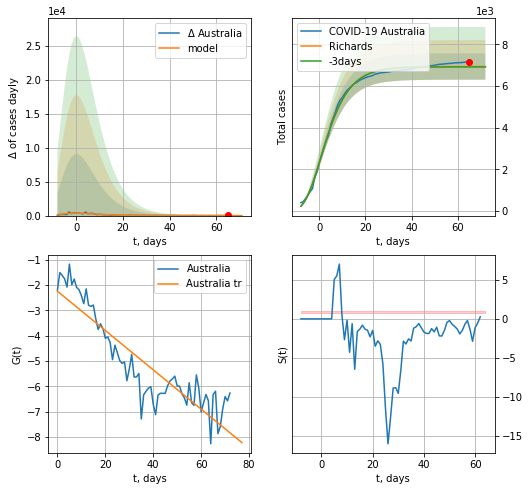

Australia data at: 2020-09-12
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 210 ± 57
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


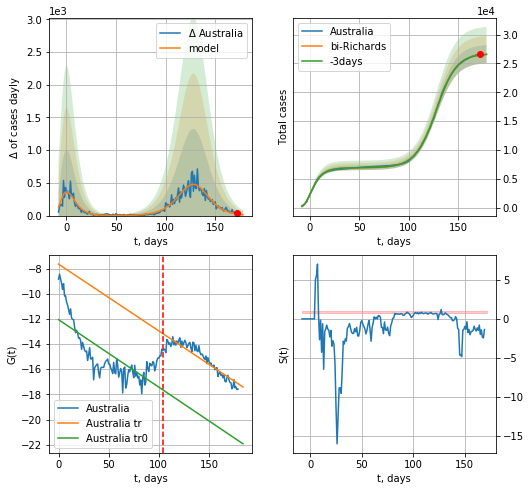

Australia data at: 2020-09-12
+3 day model MAPE: 0.002170
model: bi-Richards
coeffs: [1.97986320e+04 9.06921849e-02 1.29261613e+02 1.09668486e+00]
rational stdev: 0.059076
forecast at the end of period: +7 days
	 deltaDaycases: 13
	 total cases: 26605 ± 1571
	 total death: 808 ± 143
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.545048
 intercept: -12.061124
 slope: -0.053632
trend coefficient of determination: 0.848645
 intercept: -7.648118
 slope: -0.053075


In [2253]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,25*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
194 2020-09-08  9559.0     295  128.0
195 2020-09-09  9583.0     312  128.0
196 2020-09-10  9628.0     333  128.0
197 2020-09-11  9810.0     501  128.0
198 2020-09-12  9868.0     551  128.0


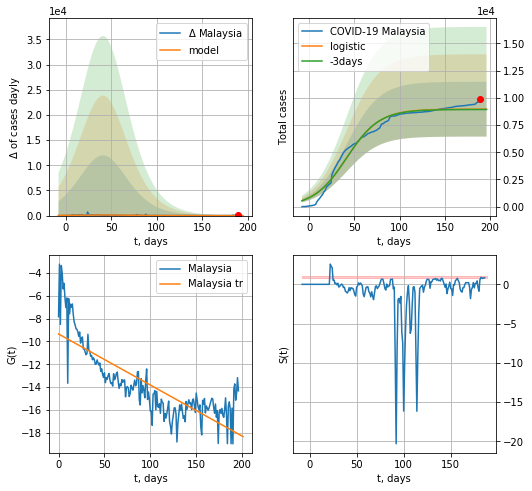

Malaysia data at: 2020-09-12
+3 day model MAPE: 0.0038868330698675897
model: logistic
coeffs:  [8.96360719e+03 5.48981837e-02 4.13758169e+01]
rational stdev:  0.28105115281337795
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  8961 ± 2518
	 total death:  116 ± 97
trend coefficient of determination: 0.665617
 intercept: -9.340391
 slope: -0.044845


In [2254]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

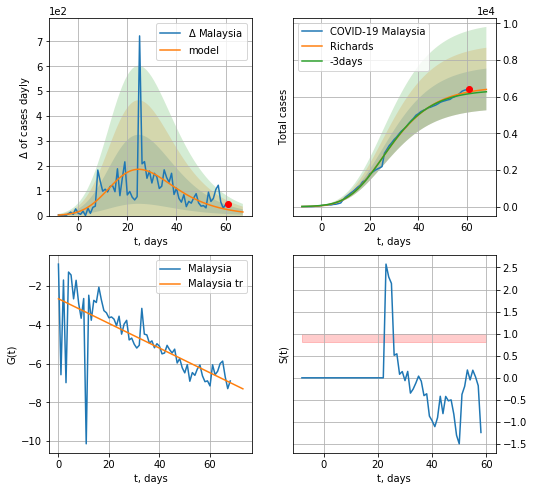

Malaysia data at: 2020-09-12
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55737988e+03 3.88576721e-01 7.38244597e+00 2.20016068e-01]
rational stdev: 0.177893
forecast at the end of period: +7 days
	 deltaDaycases: 14
	 total cases: 6392 ± 1137
	 total death: 82 ± 43
trend coefficient of determination: 0.508700
 intercept: -2.652908
 slope: -0.063638


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


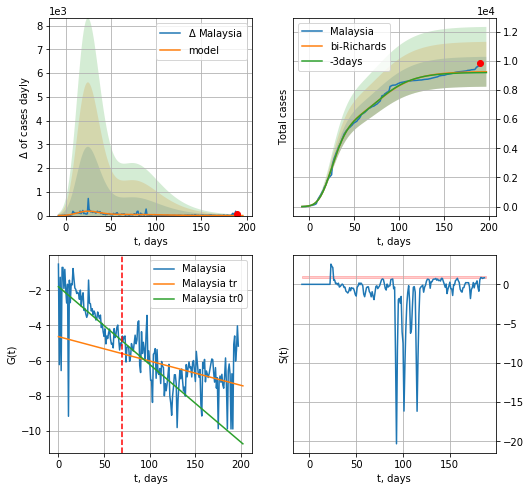

Malaysia data at: 2020-09-12
+3 day model MAPE: 0.005849
model: bi-Richards
coeffs: [ 2.70433944e+03  1.20336869e+01 -4.60199767e+01  3.65556544e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.110868
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 9244 ± 1024
	 total death: 119 ± 39
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.323834
 intercept: -1.798995
 slope: -0.044148
trend coefficient of determination: 0.160278
 intercept: -4.633067
 slope: -0.013832


In [2255]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d12f(1),T18*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


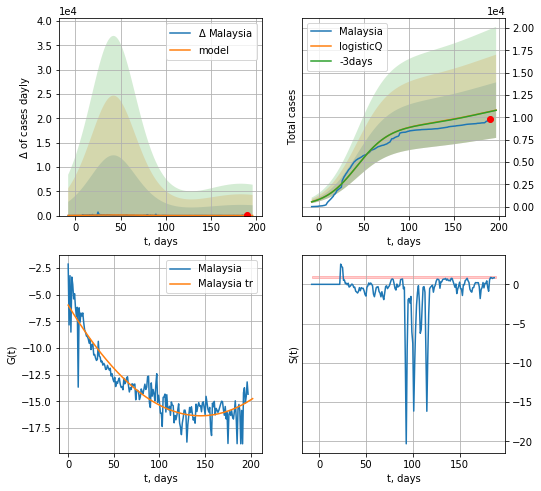

Malaysia data at: 2020-09-12
+3 day model MAPE: 0.001531
model: logisticQ
coeffs: [ 8.96125460e+03  6.99537880e-08  4.23738982e+01 -7.86970016e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.287566
forecast at the end of period: +7 days
	 deltaDaycases: 21
	 total cases: 10814 ± 3109
	 total death: 140 ± 120
trend coefficient of determination: 0.863667
 intercept_: -5.969454717545464
 coeffs_: [ 0.         -0.14335345  0.0004945 ]


In [2256]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
193 2020-09-08  1788.0     125   24.0
194 2020-09-09  1792.0     120   24.0
195 2020-09-10  1793.0     114   24.0
196 2020-09-11  1795.0     108   24.0
197 2020-09-12  1797.0      97   24.0


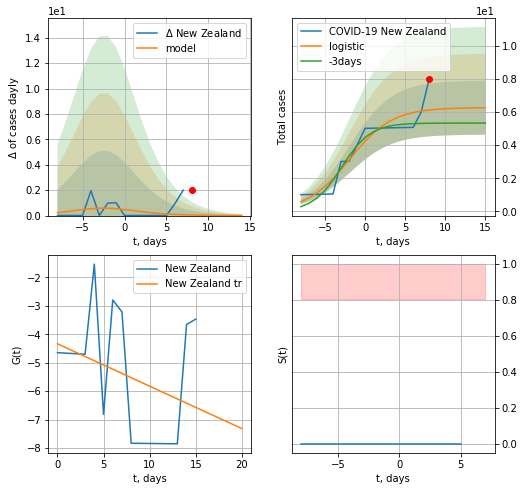

New Zealand data at: 2020-09-12
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


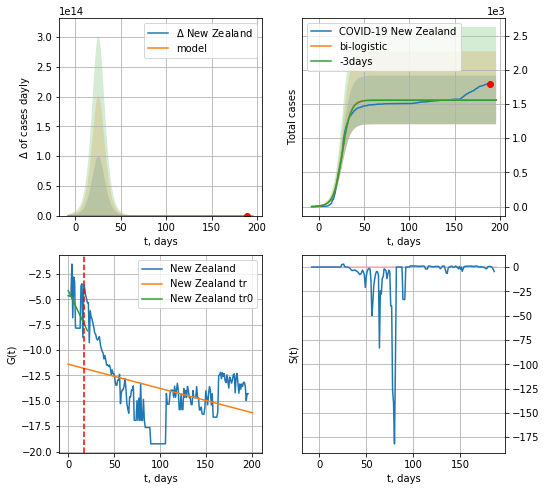

New Zealand data at: 2020-09-12
+3 day model MAPE: 0.003228276208334043
model: bi-logistic
coeffs:  [1.55308405e+03 2.12570557e-01 2.57913264e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.2279230373386478
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  1559 ± 355
	 total death:  20 ± 13
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.146195
 intercept: -11.391640
 slope: -0.023832


In [2257]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

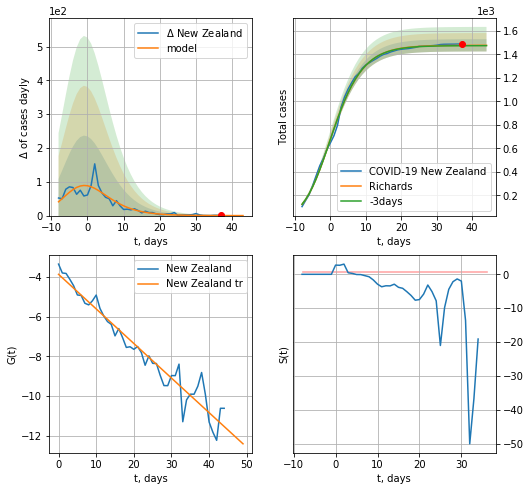

New Zealand data at: 2020-09-12
+3 day model MAPE: 0.001934
model: Richards
coeffs: [ 1.47843037e+03  4.42667510e-01 -4.31586094e+00  4.51659797e-01]
rational stdev: 0.035414
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1478 ± 52
	 total death: 19 ± 2
trend coefficient of determination: 0.938751
 intercept: -3.882685
 slope: -0.173595


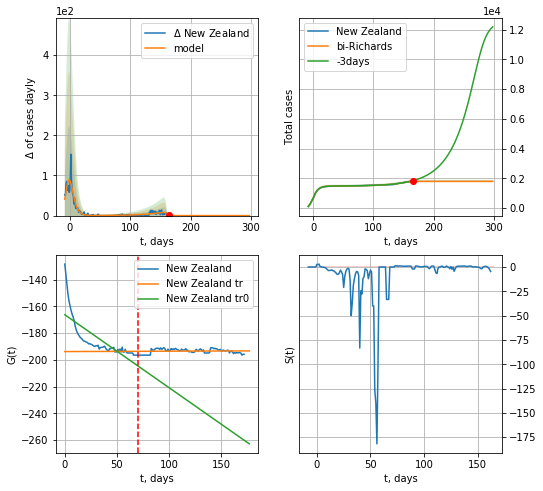

New Zealand data at: 2020-09-12
+3 day model MAPE: 0.028703
model: bi-Richards
coeffs: [3.16815437e+02 3.05669309e-02 1.60359601e+02 2.52254733e+01]
rational stdev: 0.020176
forecast at the end of period: +133 days
	 deltaDaycases: 0
	 total cases: 1795 ± 36
	 total death: 23 ± 1
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.594449
 intercept: -166.220842
 slope: -0.545979
trend coefficient of determination: 0.002595
 intercept: -193.800176
 slope: 0.002885


In [2258]:
iL = 24
vL = 70+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[iL:],d1,43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2260]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
193 2020-09-08  73208.0     571  721.0
194 2020-09-09  73402.0     677  726.0
195 2020-09-10  73591.0     656  732.0
196 2020-09-11  73784.0     677  738.0
197 2020-09-12  73975.0     684  744.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


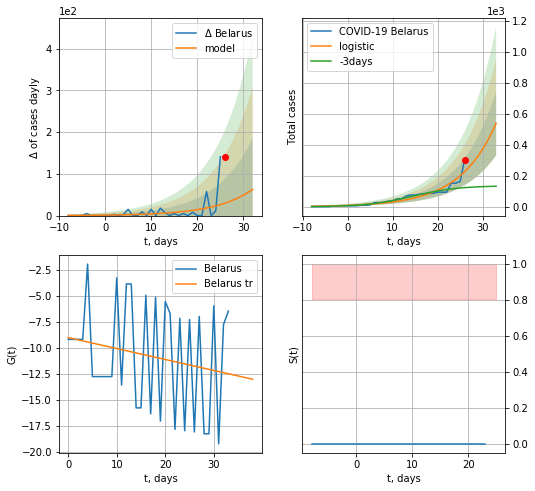

Belarus data at: 2020-09-12
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +7 days
	 deltaDaycases:  62
	 total cases:  538 ± 207
	 total death:  5 ± 5
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


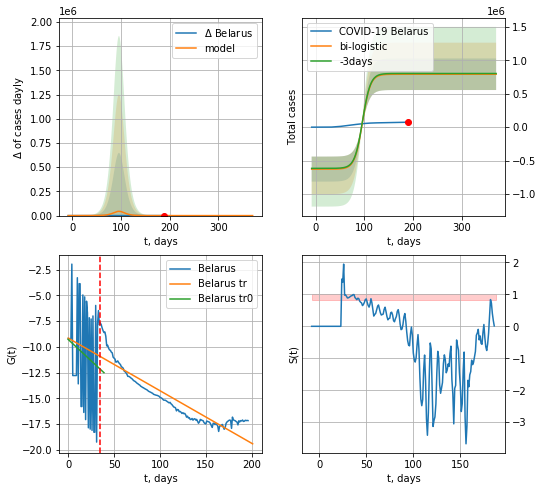

Belarus data at: 2020-09-12
+3 day model MAPE: 0.013761715066739648
model: bi-logistic
coeffs:  [-6.28609701e+05  1.40229762e+01 -3.17098381e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.2980390974529893
forecast at the end of period: +182 days
	 deltaDaycases:  0
	 total cases:  793364 ± 236453
	 total death:  7979 ± 7134
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.849609
 intercept: -9.160265
 slope: -0.051069


In [2261]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
193 2020-09-08  73208.0     571  721.0
194 2020-09-09  73402.0     677  726.0
195 2020-09-10  73591.0     656  732.0
196 2020-09-11  73784.0     677  738.0
197 2020-09-12  73975.0     684  744.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


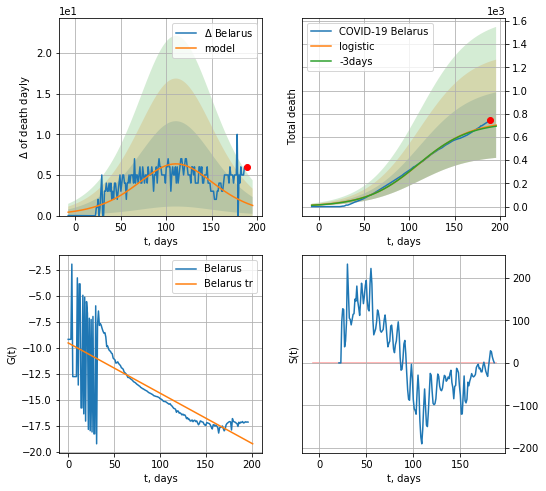

Belarus data at: 2020-09-12
+3 day model MAPE: 0.012077379708339619
model: logistic
coeffs:  [7.40108827e+02 3.44178672e-02 1.11003662e+02]
rational stdev:  0.401833478848623
forecast at the end of period: +7 days
	 total death:  702 ± 282
trend coefficient of determination: 0.577331
 intercept: -9.552949
 slope: -0.048273


In [2262]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


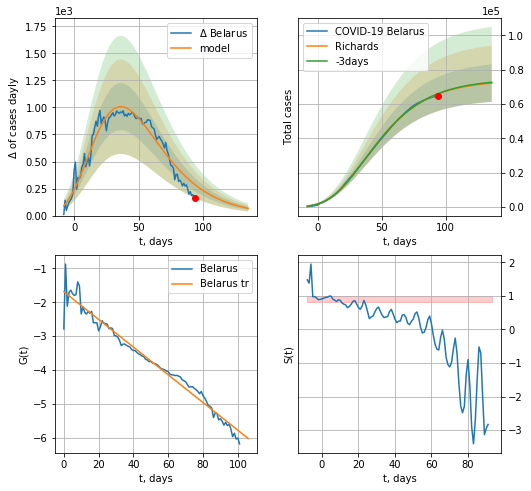

Belarus data at: 2020-09-12
+3 day model MAPE: 0.003895
model: Richards
coeffs: [ 7.39400828e+04  2.08941690e+00 -7.10697110e+01  1.78759875e-02]
rational stdev: 0.151367
forecast at the end of period: +42 days
	 deltaDaycases: 67
	 total cases: 72152 ± 10921
	 total death: 725 ± 329
trend coefficient of determination: 0.968921
 intercept: -1.685593
 slope: -0.040947


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


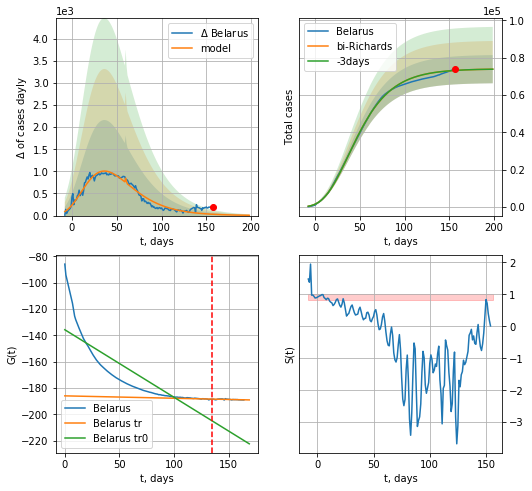

Belarus data at: 2020-09-12
+3 day model MAPE: 0.000000
model: bi-Richards
coeffs: [-126.66304739   -7.7710882    60.80915816   16.3305076 ]
rational stdev: 0.102353
forecast at the end of period: +42 days
	 deltaDaycases: 6
	 total cases: 73768 ± 7550
	 total death: 741 ± 227
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.720559
 intercept: -135.728401
 slope: -0.512658
trend coefficient of determination: 0.312577
 intercept: -185.941025
 slope: -0.018221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


In [2263]:
iL=32
vL = 135+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belarus',dfBR[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


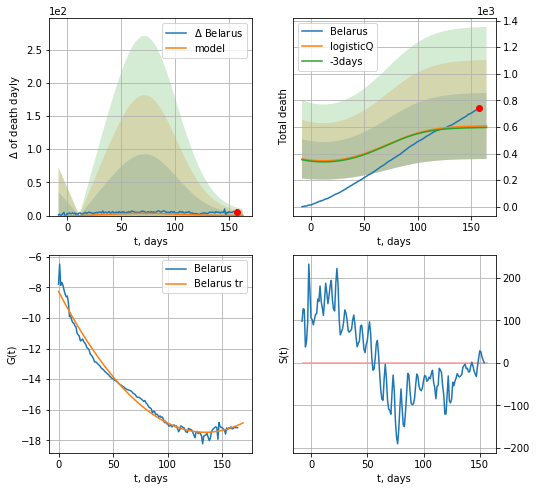

Belarus data at: 2020-09-12
+3 day model MAPE: 0.018954
model: logisticQ
coeffs: [5.13912320e+02 2.87371547e-04 2.06238793e+01 2.01481398e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408949
forecast at the end of period: +7 days
	 total death: 607 ± 248
trend coefficient of determination: 0.982752
 intercept_: -8.276771312314743
 coeffs_: [ 0.         -0.1368893   0.00050959]


In [2264]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

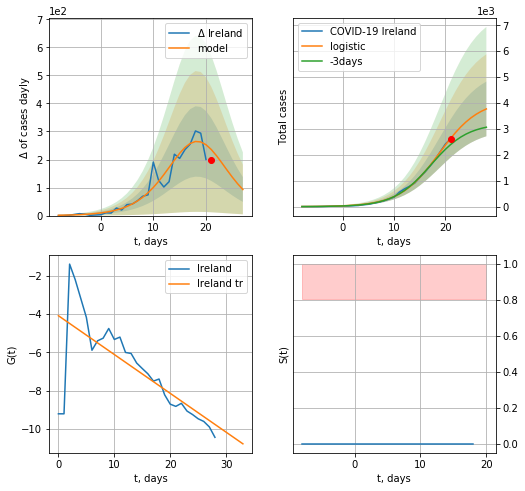

Ireland data at: 2020-09-12
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +7 days
	 deltaDaycases:  92
	 total cases:  3771 ± 1055
	 total death:  218 ± 182
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


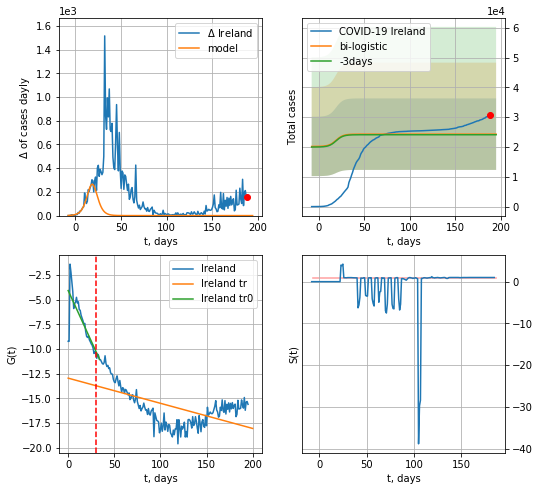

Ireland data at: 2020-09-12
+3 day model MAPE: 0.008239992924305042
model: bi-logistic
coeffs:  [ 1.61474490e+04 -1.22789747e+01  3.06237116e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.49339287384401603
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  24311 ± 11995
	 total death:  1410 ± 2087
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.337187
 intercept: -12.940428
 slope: -0.025481


In [2265]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


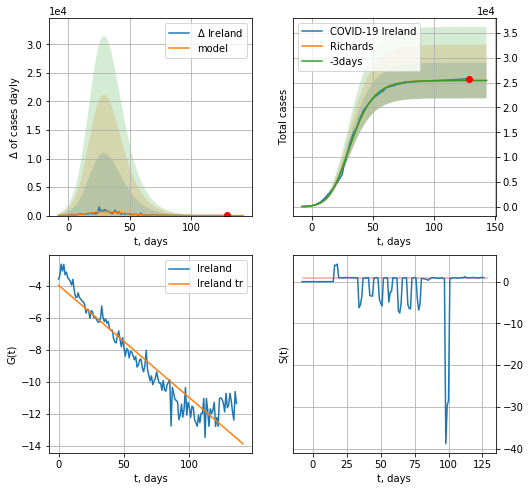

Ireland data at: 2020-09-12
+3 day model MAPE: 0.000894
model: Richards
coeffs: [2.54407353e+04 2.28847737e-01 1.92916171e+01 3.96517588e-01]
rational stdev: 0.141278
forecast at the end of period: +14 days
	 deltaDaycases: 0
	 total cases: 25439 ± 3594
	 total death: 1476 ± 625
trend coefficient of determination: 0.901596
 intercept: -3.946012
 slope: -0.070416


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


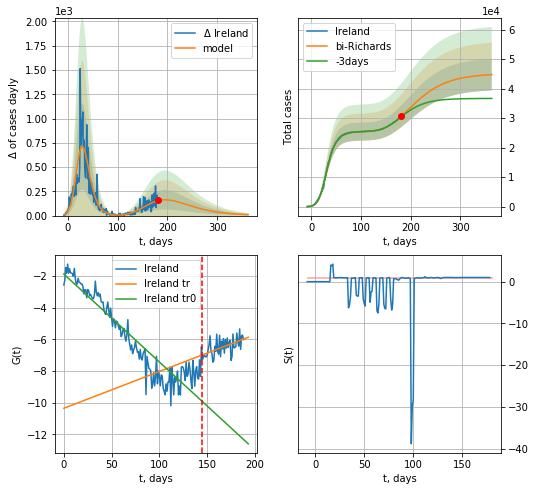

Ireland data at: 2020-09-12
+3 day model MAPE: 0.005714
model: bi-Richards
coeffs: [1.97047643e+04 3.16326956e-01 8.34104039e+01 7.35894357e-02]
rational stdev: 0.120414
forecast at the end of period: +182 days
	 deltaDaycases: 9
	 total cases: 44750 ± 5388
	 total death: 2596 ± 937
bi-Richards approximation splitting point: 145
trend coefficient of determination: 0.865870
 intercept: -1.889940
 slope: -0.055447
trend coefficient of determination: 0.286265
 intercept: -10.351601
 slope: 0.023204


In [2267]:
ivL = 7
vL = 145 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
189 2020-09-08  425541   16129  11682.0
190 2020-09-09  427027   15770  11702.0
191 2020-09-10  428669   15532  11781.0
192 2020-09-11  430535   15621  11850.0
193 2020-09-12  432666   15852  11895.0


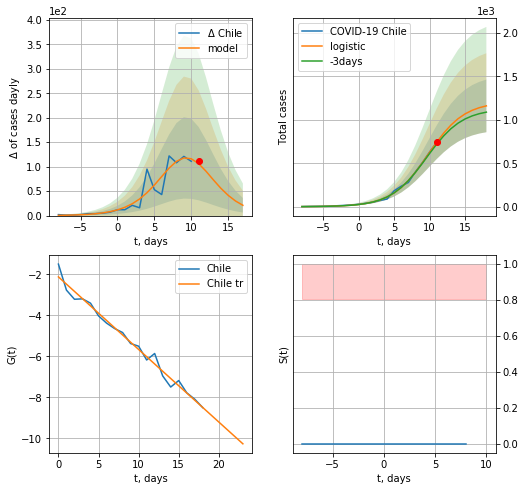

Chile data at: 2020-09-12
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +7 days
	 deltaDaycases:  21
	 total cases:  1161 ± 303
	 total death:  31 ± 24
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


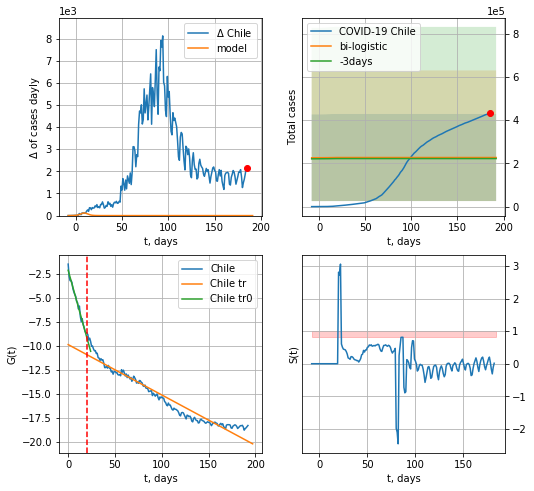

Chile data at: 2020-09-12
+3 day model MAPE: 0.021970213880014175
model: bi-logistic
coeffs:  [ 1.80729318e+05 -3.65316684e+01  8.76342160e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8867702209465097
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  227119 ± 201402
	 total death:  6244 ± 16610
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.936828
 intercept: -9.876525
 slope: -0.052386


In [2268]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


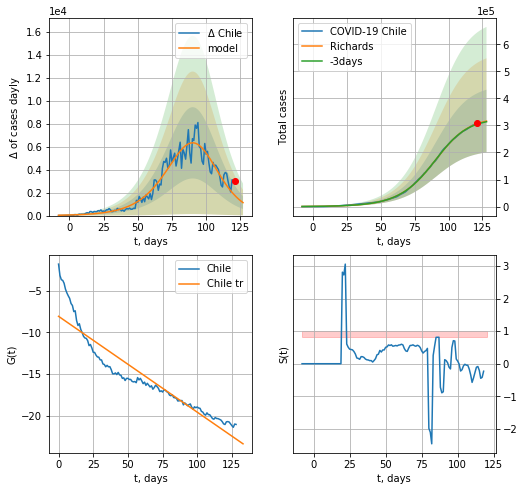

Chile data at: 2020-09-12
+3 day model MAPE: 0.006062
model: Richards
coeffs: [3.29740872e+05 6.47237974e-02 9.37490232e+01 1.29835958e+00]
rational stdev: 0.366980
forecast at the end of period: +7 days
	 deltaDaycases: 1131
	 total cases: 316135 ± 116015
	 total death: 8691 ± 9568
trend coefficient of determination: 0.871763
 intercept: -8.084056
 slope: -0.114797


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


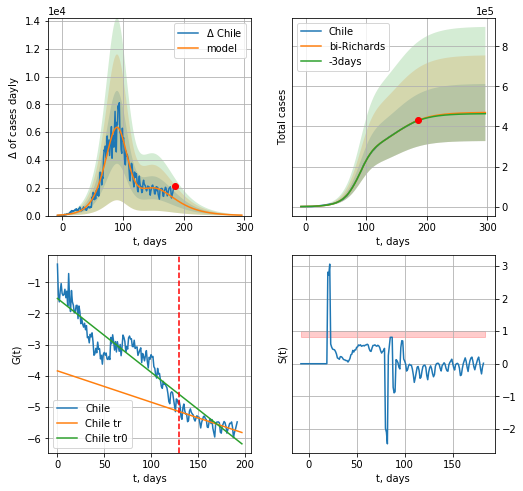

Chile data at: 2020-09-12
+3 day model MAPE: 0.003478
model: bi-Richards
coeffs: [1.40495866e+05 2.86746748e+00 3.36689030e+01 1.25644571e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.303364
forecast at the end of period: +112 days
	 deltaDaycases: 30
	 total cases: 469391 ± 142396
	 total death: 12904 ± 11743
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.820734
 intercept: -1.519978
 slope: -0.023650
trend coefficient of determination: 0.566517
 intercept: -3.840657
 slope: -0.010028


In [2269]:
vL = 130
x = forecastRR('Chile',dfCL[:vL],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


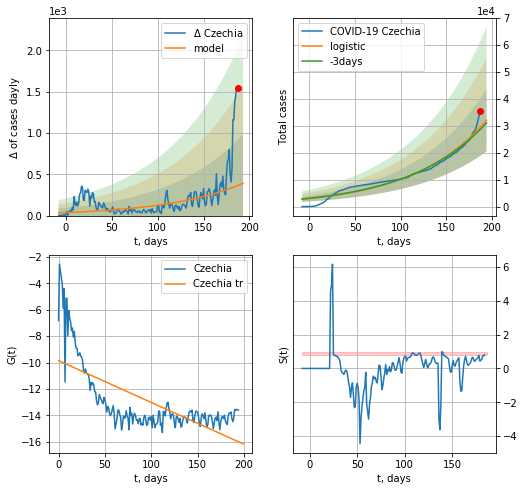

Czechia data at: 2020-09-12
+3 day model MAPE: 0.029969737941969544
model: logistic
coeffs:  [3.13715596e+07 1.22542113e-02 7.55807720e+02]
rational stdev:  0.3598596331694332
forecast at the end of period: +7 days
	 deltaDaycases:  390
	 total cases:  32076 ± 11543
	 total death:  410 ± 442
trend coefficient of determination: 0.467507
 intercept: -9.852109
 slope: -0.031709


In [2270]:
x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


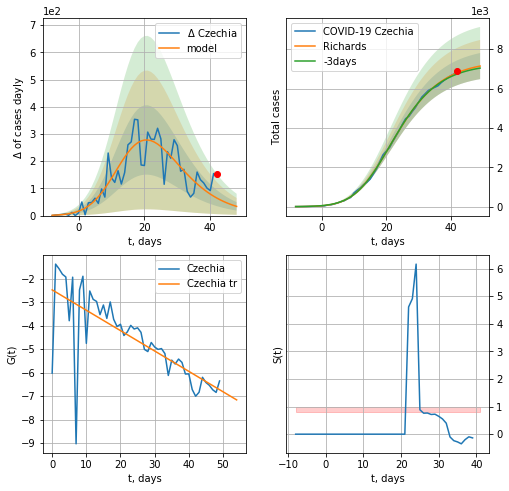

Czechia data at: 2020-09-12
+3 day model MAPE: 0.010228
model: Richards
coeffs: [7.42051660e+03 4.02436253e-01 1.04335240e+01 2.89181992e-01]
rational stdev: 0.092864
forecast at the end of period: +7 days
	 deltaDaycases: 33
	 total cases: 7139 ± 662
	 total death: 91 ± 25
trend coefficient of determination: 0.545044
 intercept: -2.483478
 slope: -0.086661


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


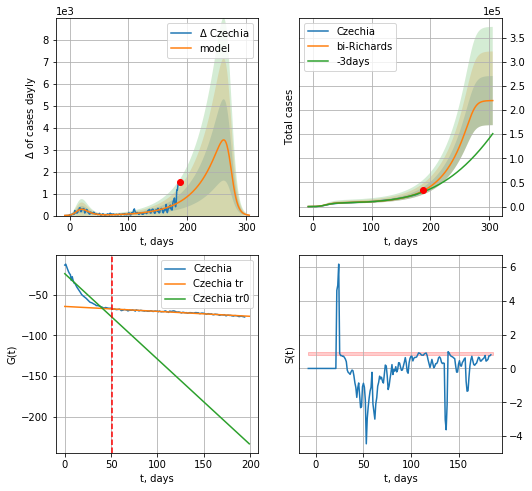

Czechia data at: 2020-09-12
+3 day model MAPE: 0.070594
model: bi-Richards
coeffs: [2.12109677e+05 2.48567849e-02 2.73196260e+02 7.08903727e+00]
rational stdev: 0.231691
forecast at the end of period: +119 days
	 deltaDaycases: 17
	 total cases: 219437 ± 50841
	 total death: 2807 ± 1951
bi-Richards approximation splitting point: 51
trend coefficient of determination: 0.881566
 intercept: -24.134961
 slope: -1.051557
trend coefficient of determination: 0.951543
 intercept: -64.391044
 slope: -0.060748


In [2275]:
vL= 51
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,41*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

          date   cases    active    death
184 2020-09-08  642860  123217.0  68484.0
185 2020-09-09  647507  123430.0  69095.0
186 2020-09-10  652364  123865.0  69649.0
187 2020-09-11  658299  124352.0  70183.0
188 2020-09-12  663973  125844.0  70604.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp


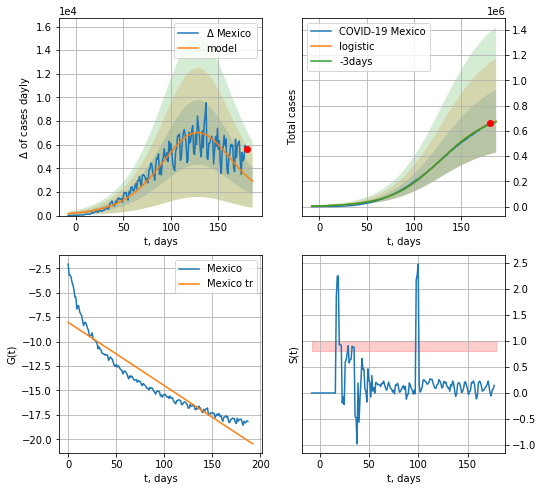

Mexico data at: 2020-09-12
+3 day model MAPE: 0.006986895809813667
model: logistic
coeffs:  [7.35442833e+05 3.79554348e-02 1.28285128e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3676346627461779
forecast at the end of period: +7 days
	 deltaDaycases:  2914
	 total cases:  676186 ± 248589
	 total death:  71902 ± 79301
trend coefficient of determination: 0.862152
 intercept: -8.036692
 slope: -0.064739


In [2276]:
print (dfMX.tail())
x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


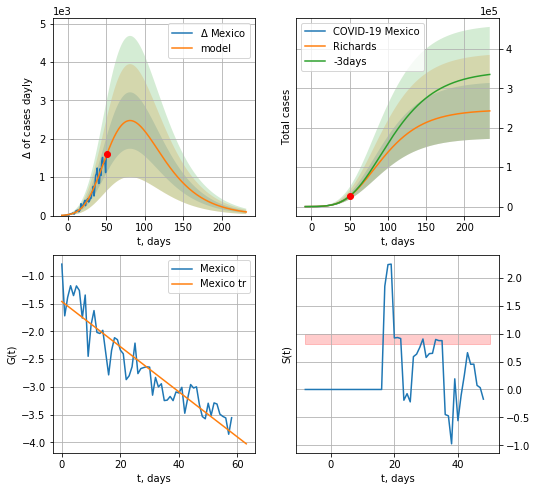

Mexico data at: 2020-09-12
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +182 days
	 deltaDaycases: 95
	 total cases: 242851 ± 71059
	 total death: 25823 ± 22667
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


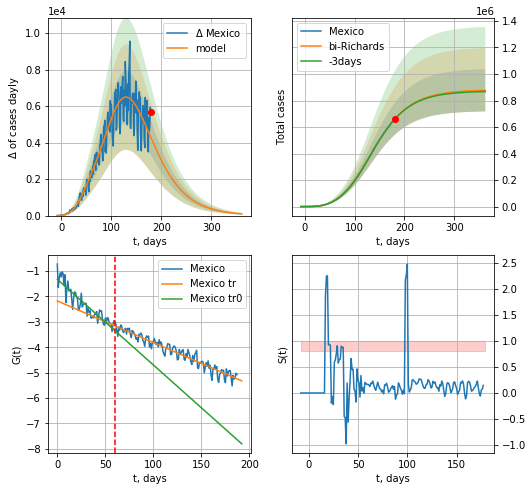

Mexico data at: 2020-09-12
+3 day model MAPE: 0.002369
model: bi-Richards
coeffs: [ 6.34741535e+05  9.67683324e-01 -2.38831356e+01  2.36550239e-02]
rational stdev: 0.181691
forecast at the end of period: +182 days
	 deltaDaycases: 92
	 total cases: 876950 ± 159333
	 total death: 93251 ± 50828
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.832830
 intercept: -1.323868
 slope: -0.033757
trend coefficient of determination: 0.922349
 intercept: -2.177325
 slope: -0.016394


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


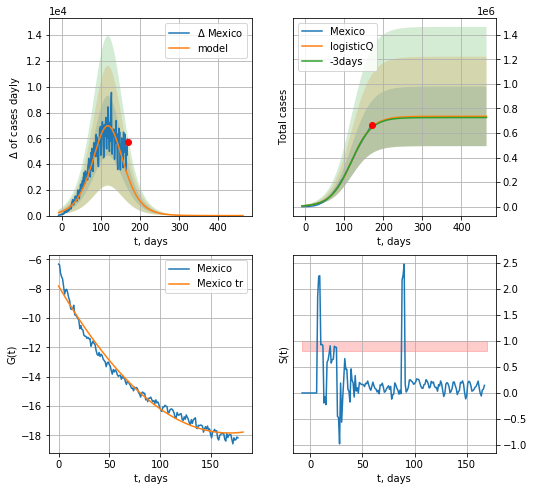

Mexico data at: 2020-09-12
+3 day model MAPE: 0.007347
model: logisticQ
coeffs: [ 7.35747782e+05  3.04156964e-07  1.18317366e+02 -1.24542334e+05]
rational stdev: 0.330087
forecast at the end of period: +294 days
	 deltaDaycases: 0
	 total cases: 735746 ± 242860
	 total death: 78236 ± 77473
trend coefficient of determination: 0.983953
 intercept_: -7.81481784683718
 coeffs_: [ 0.         -0.11886124  0.00035241]


In [2277]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
183 2020-09-08  3163.0    1069   86.0  676600.0
184 2020-09-09  3199.0    1083   86.0  682097.0
185 2020-09-10  3243.0    1108   86.0  687118.0
186 2020-09-11  3296.0    1127   86.0  692118.0
187 2020-09-12  3335.0    1178   87.0  694139.0


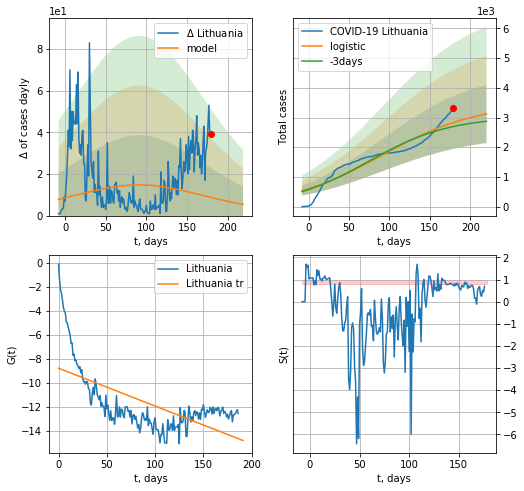

Lithuania data at: 2020-09-12
+3 day model MAPE: 0.05085326250447267
model: logistic
coeffs:  [3.46744828e+03 1.70036154e-02 9.12394078e+01]
rational stdev:  0.3133945047161554
forecast at the end of period: +41 days
	 deltaDaycases:  5
	 total cases:  3118 ± 977
	 total death:  80 ± 75
trend coefficient of determination: 0.399601
 intercept: -8.775633
 slope: -0.031529


In [2279]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [2280]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [2281]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


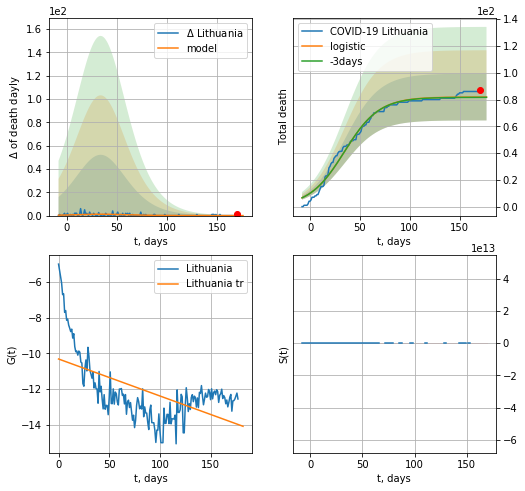

Lithuania data at: 2020-09-12
+3 day model MAPE: 0.0025281385814956365
model: logistic
coeffs:  [8.18667850e+01 5.71939739e-02 3.44582542e+01]
rational stdev:  0.21339166581177718
forecast at the end of period: +7 days
	 total death:  81 ± 17
trend coefficient of determination: 0.334182
 intercept: -10.320069
 slope: -0.020714


In [2282]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


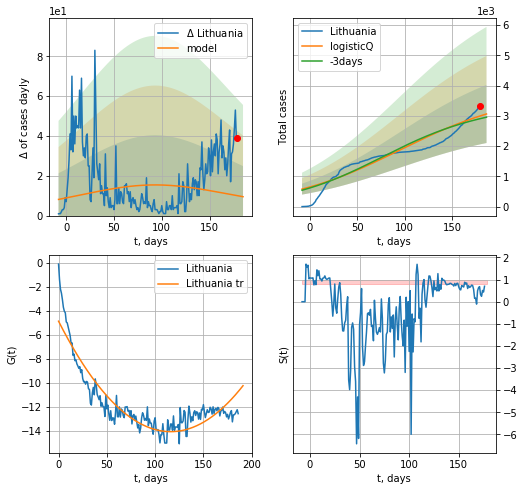

Lithuania data at: 2020-09-12
+3 day model MAPE: 0.031306
model: logisticQ
coeffs: [ 3.46667001e+03  2.71282388e-08  9.12124139e+01 -6.26674262e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313368
forecast at the end of period: +7 days
	 deltaDaycases: 9
	 total cases: 3062 ± 959
	 total death: 78 ± 73
trend coefficient of determination: 0.836033
 intercept_: -4.861793442072484
 coeffs_: [ 0.         -0.15846517  0.00068245]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


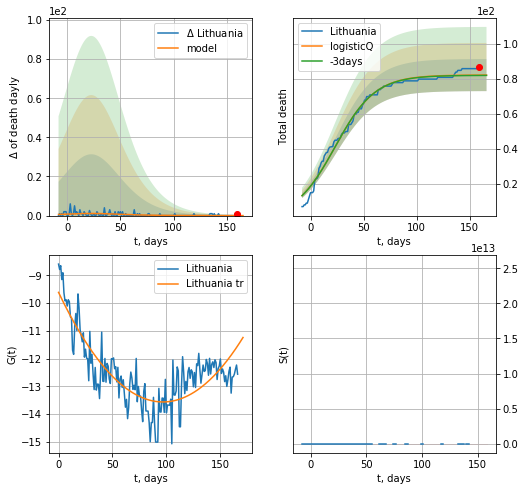

Lithuania data at: 2020-09-12
+3 day model MAPE: 0.002454
model: logisticQ
coeffs: [ 8.23681472e+01  1.61550347e-07  2.31689947e+01 -3.26421817e+05]
rational stdev: 0.111638
forecast at the end of period: +7 days
	 total death: 82 ± 9
trend coefficient of determination: 0.696154
 intercept_: -9.610232473483059
 coeffs_: [ 0.         -0.08169534  0.00042211]


In [2283]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


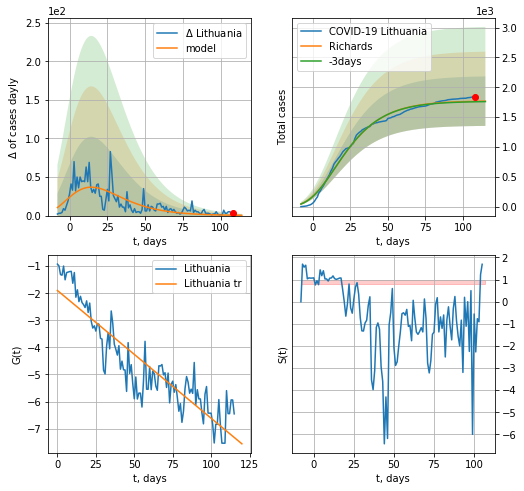

Lithuania data at: 2020-09-12
+3 day model MAPE: 0.004317
model: Richards
coeffs: [ 1.77501763e+03  1.31639926e+01 -8.14596876e+01  4.29803165e-03]
rational stdev: 0.234279
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1768 ± 414
	 total death: 45 ± 31
trend coefficient of determination: 0.820394
 intercept: -1.897700
 slope: -0.047186


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


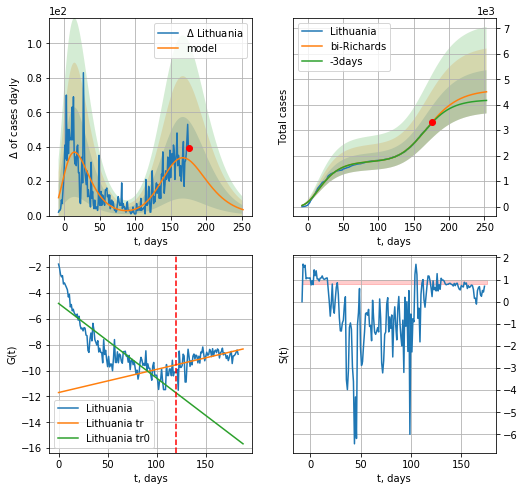

Lithuania data at: 2020-09-12
+3 day model MAPE: 0.007007
model: bi-Richards
coeffs: [2.81749017e+03 7.69602925e-02 1.51922556e+02 5.28308302e-01]
rational stdev: 0.188255
forecast at the end of period: +77 days
	 deltaDaycases: 3
	 total cases: 4507 ± 848
	 total death: 116 ± 65
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.773038
 intercept: -4.805318
 slope: -0.057741
trend coefficient of determination: 0.270590
 intercept: -11.696317
 slope: 0.017912


In [2284]:
iL = 3
vL =120+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

In [2285]:
#dfLT['cases'].values
#x = forecastRR('Lithuania',dfLT[130:],d1,30*7-dT,addpred=False)#

In [2286]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
185 2020-09-08  6974.0     594  124.0
186 2020-09-09  7023.0     607  124.0
187 2020-09-10  7088.0     567  124.0
188 2020-09-11  7159.0     638  124.0
189 2020-09-12  7194.0     673  124.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


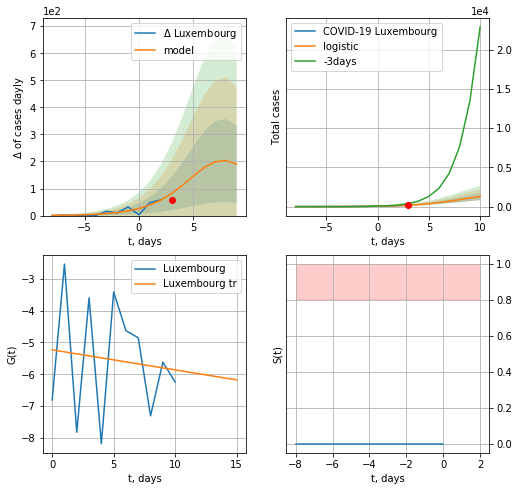

Luxembourg data at: 2020-09-12
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +7 days
	 deltaDaycases:  189
	 total cases:  1281 ± 458
	 total death:  22 ± 23
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


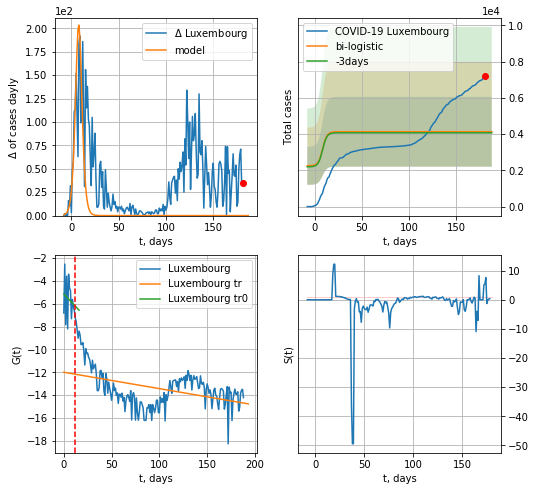

Luxembourg data at: 2020-09-12
+3 day model MAPE: 0.01445108588120893
model: bi-logistic
coeffs:  [2006.12200924  -11.66393665  309.64433226] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.4662169900201327
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  4134 ± 1927
	 total death:  71 ± 99
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.180301
 intercept: -11.992297
 slope: -0.014336


In [2287]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


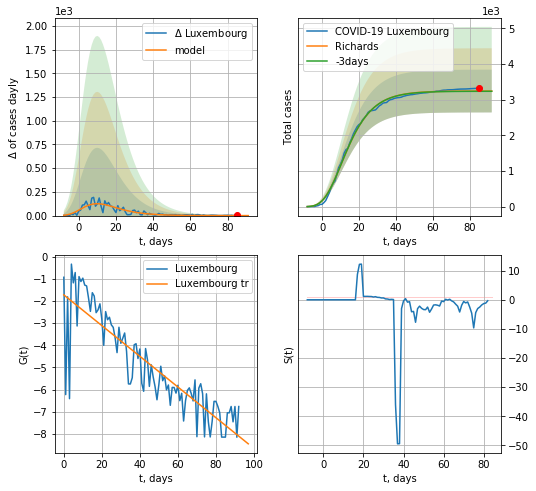

Luxembourg data at: 2020-09-12
+3 day model MAPE: 0.002007
model: Richards
coeffs: [ 3.24138545e+03  2.02715004e+01 -3.96622957e+01  5.18542030e-03]
rational stdev: 0.184858
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 3240 ± 599
	 total death: 55 ± 30
trend coefficient of determination: 0.764532
 intercept: -1.723997
 slope: -0.069294


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


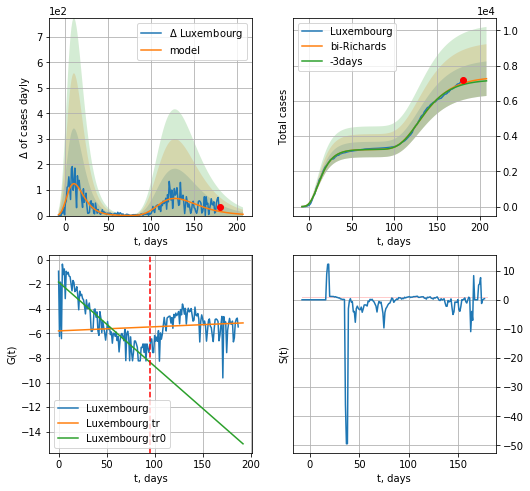

Luxembourg data at: 2020-09-12
+3 day model MAPE: 0.010410
model: bi-Richards
coeffs: [4.12777126e+03 2.72893755e+00 3.58382291e+01 1.63521441e-02]
rational stdev: 0.134920
forecast at the end of period: +28 days
	 deltaDaycases: 5
	 total cases: 7254 ± 978
	 total death: 125 ± 50
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.769236
 intercept: -1.823558
 slope: -0.068493
trend coefficient of determination: 0.007498
 intercept: -5.796942
 slope: 0.003372


In [2288]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


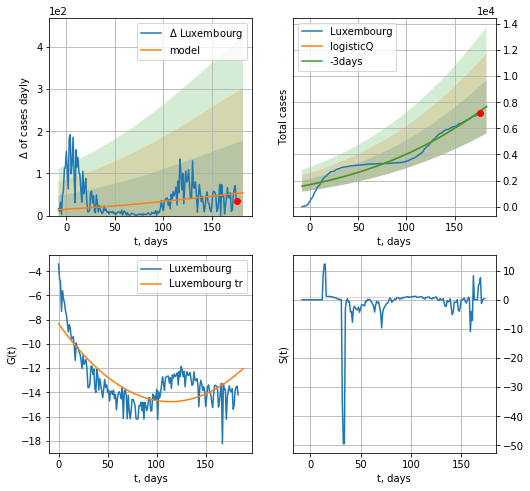

Luxembourg data at: 2020-09-12
+3 day model MAPE: 0.003265
model: logisticQ
coeffs: [ 2.81775686e+04  3.94531556e-07  2.83968965e+02 -2.45936703e+04]
rational stdev: 0.266799
forecast at the end of period: +7 days
	 deltaDaycases: 54
	 total cases: 7650 ± 2041
	 total death: 131 ± 104
trend coefficient of determination: 0.568342
 intercept_: -8.33924970042602
 coeffs_: [ 0.         -0.1129738   0.00049593]


In [2289]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [2291]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases   active    death
192 2020-09-08  110757.0   8888.0  10627.0
193 2020-09-09  112166.0  10223.0  10701.0
194 2020-09-10  113206.0  11215.0  10749.0
195 2020-09-11  114732.0  12654.0  10836.0
196 2020-09-12  116451.0  14345.0  10864.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


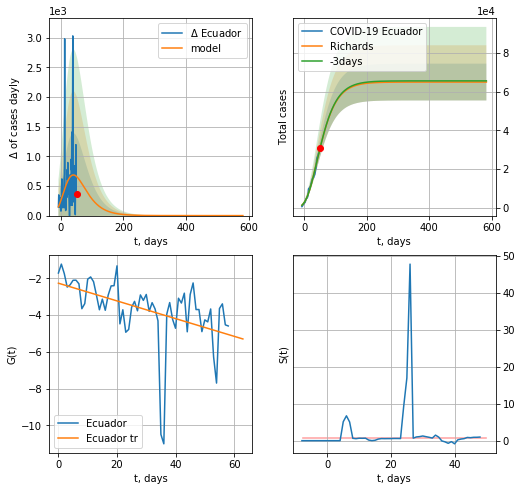

Ecuador data at: 2020-09-12
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +532 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 6054 ± 2656
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


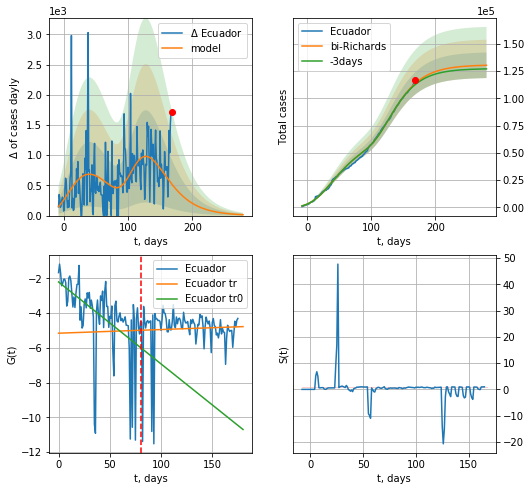

Ecuador data at: 2020-09-12
+3 day model MAPE: 0.009079
model: bi-Richards
coeffs: [ 6.58296935e+04  4.66849919e+00 -7.26394230e+00  7.54504476e-03]
rational stdev: 0.090089
forecast at the end of period: +112 days
	 deltaDaycases: 14
	 total cases: 130318 ± 11740
	 total death: 12157 ± 3285
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.272927
 intercept: -2.201828
 slope: -0.047220
trend coefficient of determination: 0.002145
 intercept: -5.154797
 slope: 0.002105


In [2293]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [2294]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
196 2020-09-08  8337.0     651  336.0
197 2020-09-09  8430.0     593  337.0
198 2020-09-10  8512.0     675  337.0
199 2020-09-11  8512.5     675  337.0
200 2020-09-12  8557.0     720  337.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


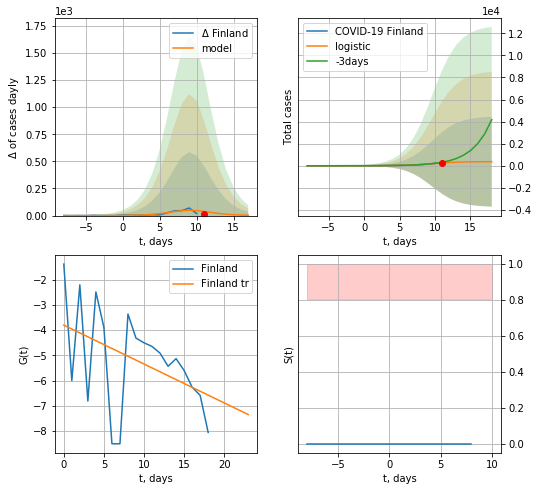

Finland data at: 2020-09-12
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +7 days
	 deltaDaycases:  2
	 total cases:  369 ± 4070
	 total death:  14 ± 463
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


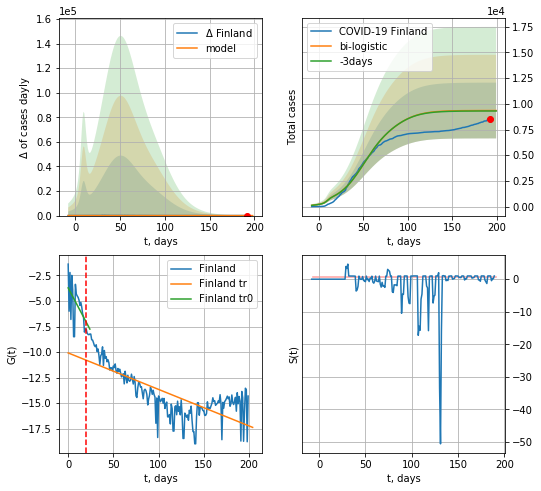

Finland data at: 2020-09-12
+3 day model MAPE: 0.004787264449382725
model: bi-logistic
coeffs:  [7.17947531e+03 7.00747796e-02 4.97045465e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.2900537849631083
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  9346 ± 2710
	 total death:  368 ± 320
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.574734
 intercept: -10.087994
 slope: -0.035762


In [2296]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


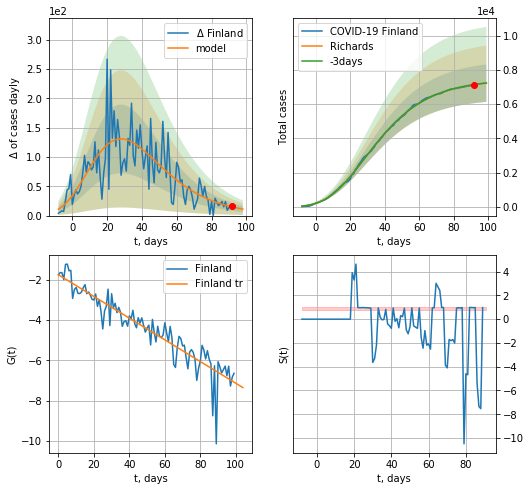

Finland data at: 2020-09-12
+3 day model MAPE: 0.001115
model: Richards
coeffs: [ 7.44184304e+03  7.14884094e-01 -2.55188087e+01  6.92679823e-02]
rational stdev: 0.151514
forecast at the end of period: +7 days
	 deltaDaycases: 11
	 total cases: 7219 ± 1093
	 total death: 284 ± 129
trend coefficient of determination: 0.862147
 intercept: -1.759889
 slope: -0.053817


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


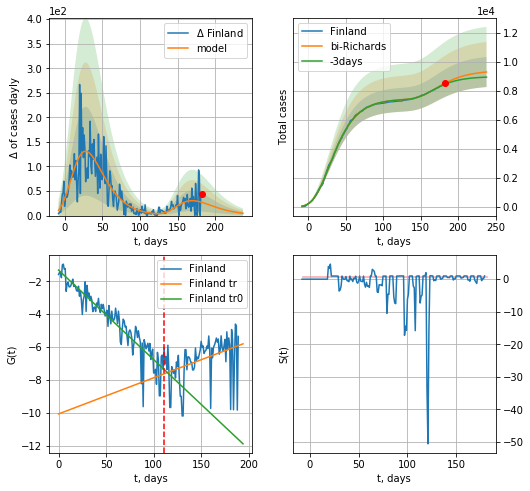

Finland data at: 2020-09-12
+3 day model MAPE: 0.008062
model: bi-Richards
coeffs: [1.96799512e+03 3.94770381e+00 6.13228427e+01 1.05677293e-02]
rational stdev: 0.111512
forecast at the end of period: +56 days
	 deltaDaycases: 4
	 total cases: 9295 ± 1036
	 total death: 366 ± 122
bi-Richards approximation splitting point: 111
trend coefficient of determination: 0.868973
 intercept: -1.318384
 slope: -0.054477
trend coefficient of determination: 0.143225
 intercept: -10.068740
 slope: 0.021971


In [2297]:
vL = 86 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

In [2298]:
#x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
182 2020-09-08  17313  4324.0  692.0
183 2020-09-09  17435  4259.0  702.0
184 2020-09-10  17598  4273.0  706.0
185 2020-09-11  17799  4336.0  713.0
186 2020-09-12  17891  4416.0  717.0


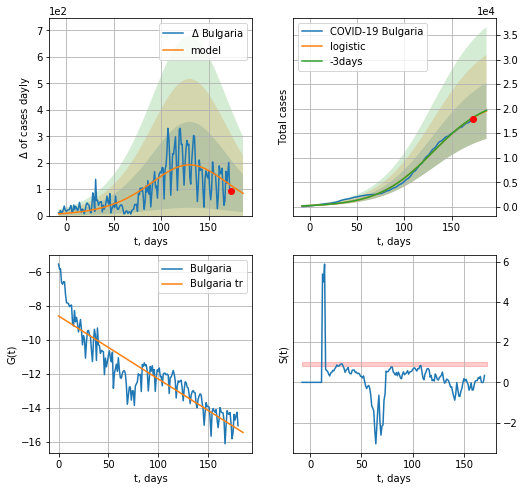

Bulgaria data at: 2020-09-12
+3 day model MAPE: 0.004764699704516098
model: logistic
coeffs:  [2.23038602e+04 3.44150217e-02 1.30124335e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.29205048844136583
forecast at the end of period: +14 days
	 deltaDaycases:  84
	 total cases:  19544 ± 5707
	 total death:  783 ± 686
trend coefficient of determination: 0.811791
 intercept: -8.608553
 slope: -0.037038


In [2299]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


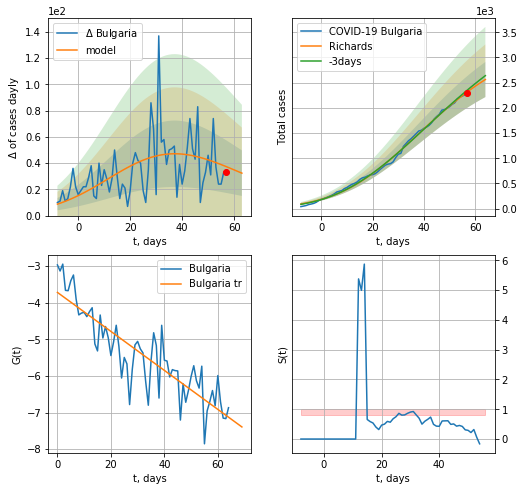

Bulgaria data at: 2020-09-12
+3 day model MAPE: 0.017233
model: Richards
coeffs: [3.47700846e+03 1.26494247e-01 1.24704401e+01 3.39632264e-01]
rational stdev: 0.135837
forecast at the end of period: +7 days
	 deltaDaycases: 32
	 total cases: 2562 ± 348
	 total death: 102 ± 41
trend coefficient of determination: 0.758376
 intercept: -3.716233
 slope: -0.053312


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


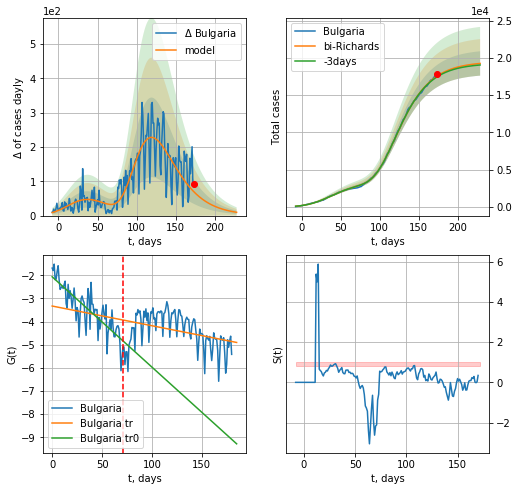

Bulgaria data at: 2020-09-12
+3 day model MAPE: 0.005916
model: bi-Richards
coeffs: [1.60329362e+04 2.57229230e+00 1.01087947e+01 1.48738221e-02]
rational stdev: 0.084895
forecast at the end of period: +56 days
	 deltaDaycases: 9
	 total cases: 19262 ± 1635
	 total death: 771 ± 196
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.675637
 intercept: -2.062845
 slope: -0.039014
trend coefficient of determination: 0.129221
 intercept: -3.327037
 slope: -0.008506


In [2300]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


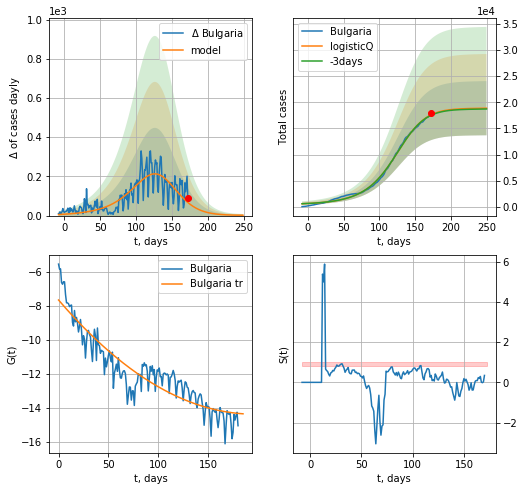

Bulgaria data at: 2020-09-12
+3 day model MAPE: 0.004862
model: logisticQ
coeffs: [ 1.87609737e+04  1.38264734e-04  1.20828646e+02 -2.01429040e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.274676
forecast at the end of period: +77 days
	 deltaDaycases: 1
	 total cases: 18860 ± 5180
	 total death: 755 ± 622
trend coefficient of determination: 0.851202
 intercept_: -7.670832259057212
 coeffs_: [ 0.         -0.06847071  0.00017462]


In [2301]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
194 2020-09-08  3447.0   103.0   58.0
195 2020-09-09  3454.0    86.0   58.0
196 2020-09-10  3461.0    91.0   58.0
197 2020-09-11  3466.0    96.0   58.0
198 2020-09-12  3473.0   103.0   58.0


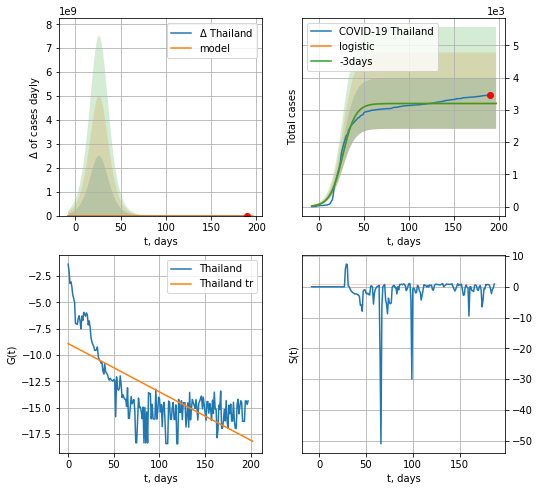

Thailand data at: 2020-09-12
+3 day model MAPE: 0.0019258572392187505
model: logistic
coeffs:  [3.20284974e+03 1.42787864e-01 2.66581772e+01]
rational stdev:  0.2467354287484404
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  3202 ± 790
	 total death:  53 ± 39
trend coefficient of determination: 0.529512
 intercept: -8.920902
 slope: -0.045833


In [2302]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [2303]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


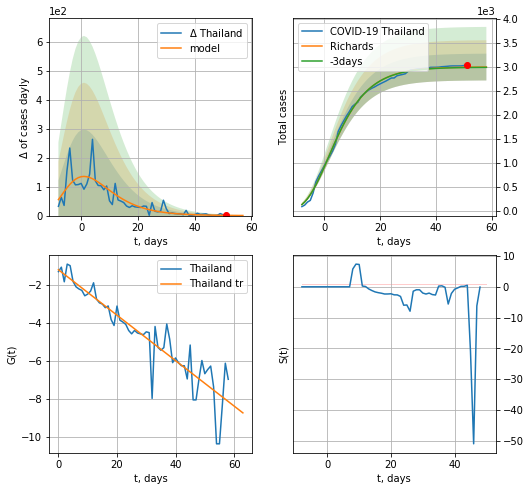

Thailand data at: 2020-09-12
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 2993 ± 279
	 total death: 49 ± 13
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


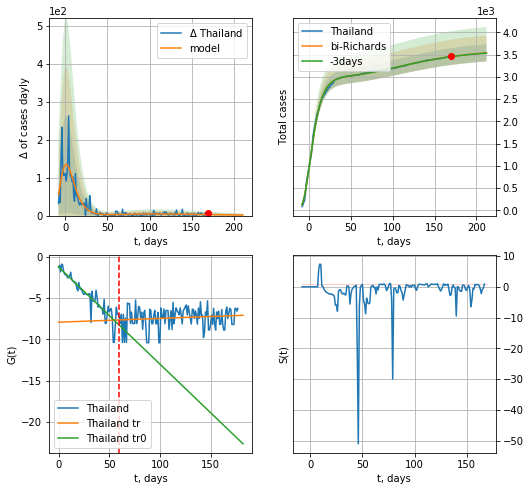

Thailand data at: 2020-09-12
+3 day model MAPE: 0.000792
model: bi-Richards
coeffs: [ 6.29092759e+02  2.81380545e+00 -1.63079822e+02  6.60767264e-03]
rational stdev: 0.054838
forecast at the end of period: +42 days
	 deltaDaycases: 1
	 total cases: 3542 ± 194
	 total death: 59 ± 9
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843236
 intercept: -1.241021
 slope: -0.117522
trend coefficient of determination: 0.015739
 intercept: -7.927079
 slope: 0.004583


In [2304]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d12f(1),30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


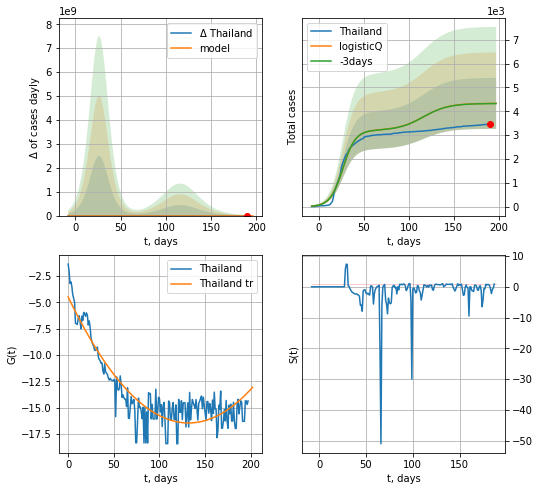

Thailand data at: 2020-09-12
+3 day model MAPE: 0.001864
model: logisticQ
coeffs: [ 3.20285699e+03  3.01681665e-07  2.66589038e+01 -4.73111974e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.246829
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 4333 ± 1069
	 total death: 72 ± 53
trend coefficient of determination: 0.840939
 intercept_: -4.496318411462628
 coeffs_: [ 0.         -0.18127959  0.00068755]


In [2305]:
x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


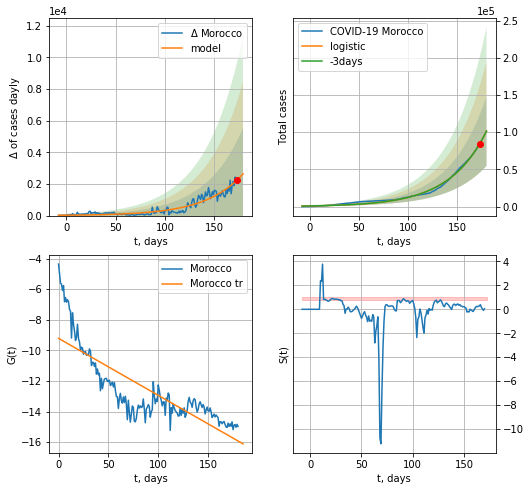

Morocco data at: 2020-09-12
+3 day model MAPE: 0.000425780035987586
model: logistic
coeffs:  [1.12334565e+08 2.63244880e-02 4.46249927e+02]
rational stdev:  0.46003017805007707
forecast at the end of period: +7 days
	 deltaDaycases:  2633
	 total cases:  101437 ± 46664
	 total death:  1865 ± 2573
trend coefficient of determination: 0.671364
 intercept: -9.214848
 slope: -0.037274


In [2306]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


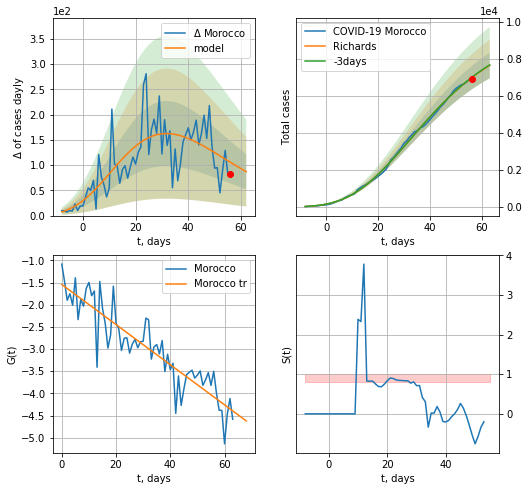

Morocco data at: 2020-09-12
+3 day model MAPE: 0.002854
model: Richards
coeffs: [ 9.80051535e+03  2.80051836e+00 -5.84633428e+01  1.62270604e-02]
rational stdev: 0.090760
forecast at the end of period: +7 days
	 deltaDaycases: 87
	 total cases: 7660 ± 695
	 total death: 140 ± 38
trend coefficient of determination: 0.815717
 intercept: -1.543258
 slope: -0.045268


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


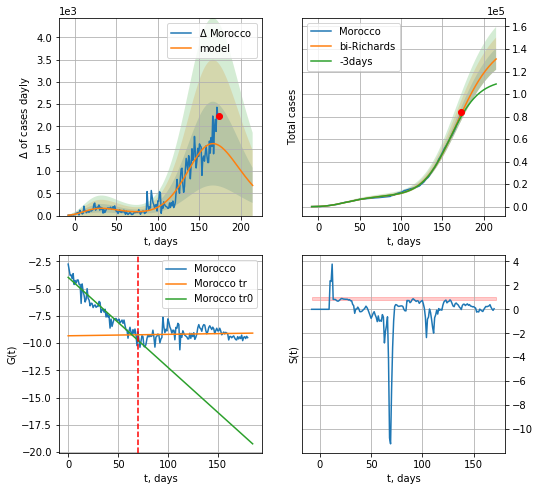

Morocco data at: 2020-09-12
+3 day model MAPE: 0.031174
model: bi-Richards
coeffs: [1.40415125e+05 7.54725243e-02 1.49834586e+02 5.17351230e-01]
rational stdev: 0.072445
forecast at the end of period: +42 days
	 deltaDaycases: 677
	 total cases: 131126 ± 9499
	 total death: 2411 ± 523
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.921268
 intercept: -3.967172
 slope: -0.082532
trend coefficient of determination: 0.006268
 intercept: -9.326937
 slope: 0.001317


In [2307]:
vL = 75 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


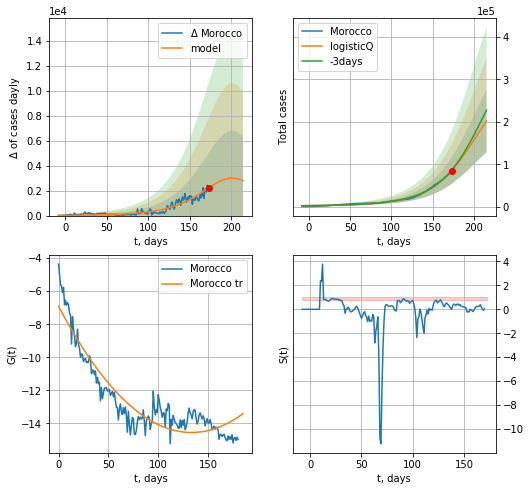

Morocco data at: 2020-09-12
+3 day model MAPE: 0.014616
model: logisticQ
coeffs: [ 2.97460215e+05  7.70227541e-05  1.96877584e+02 -3.22622634e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366253
forecast at the end of period: +42 days
	 deltaDaycases: 2790
	 total cases: 202082 ± 74013
	 total death: 3716 ± 4082
trend coefficient of determination: 0.865431
 intercept_: -6.912123873938468
 coeffs_: [ 0.         -0.11446032  0.00042882]


In [2308]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2310]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases   active   death
195 2020-09-08   97033.0  52228.0  3967.0
196 2020-09-09   98304.0  53284.0  4018.0
197 2020-09-10   99684.0  54609.0  4065.0
198 2020-09-11  101075.0  55965.0  4100.0
199 2020-09-12  102386.0  55448.0  4127.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


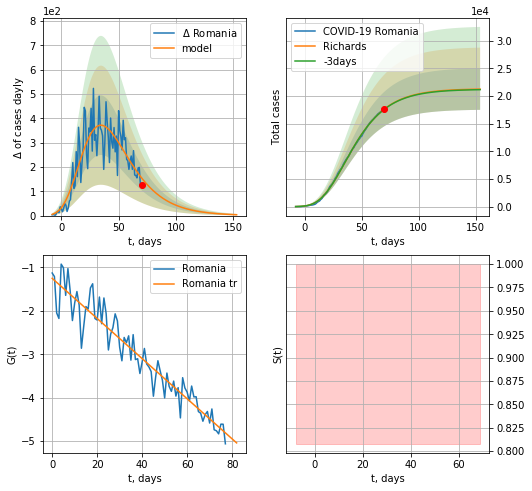

Romania data at: 2020-09-12
+3 day model MAPE: 0.002252
model: Richards
coeffs: [ 2.13019559e+04  3.77233819e+00 -5.65502366e+01  1.26521698e-02]
rational stdev: 0.176385
forecast at the end of period: +84 days
	 deltaDaycases: 3
	 total cases: 21229 ± 3744
	 total death: 855 ± 452
trend coefficient of determination: 0.908550
 intercept: -1.252366
 slope: -0.046196


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


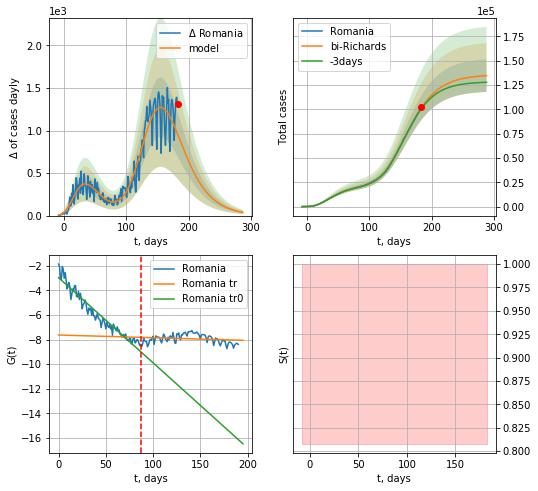

Romania data at: 2020-09-12
+3 day model MAPE: 0.009388
model: bi-Richards
coeffs: [1.14344549e+05 1.01056768e-01 1.26168126e+02 3.49735914e-01]
rational stdev: 0.124046
forecast at the end of period: +105 days
	 deltaDaycases: 38
	 total cases: 134580 ± 16694
	 total death: 5424 ± 2018
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.936029
 intercept: -2.970137
 slope: -0.069214
trend coefficient of determination: 0.034361
 intercept: -7.628034
 slope: -0.002208


In [2311]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,39*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

In [2312]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [2313]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
213 2020-09-08  2081101  452508  141547.0
214 2020-09-09  2107705  465638  141713.0
215 2020-09-10  2141216  481032  141908.0
216 2020-09-11  2186075  497783  142130.0
217 2020-09-12  2208576  512814  142236.0


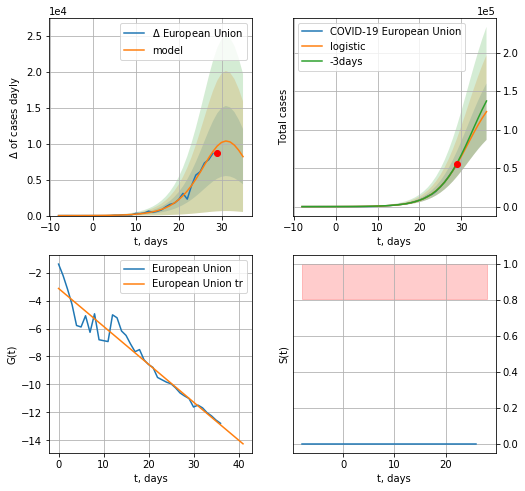

European Union data at: 2020-09-12
+3 day model MAPE: 0.026430260679971996
model: logistic
coeffs:  [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.29731227366451135
forecast at the end of period: +7 days
	 deltaDaycases:  8193
	 total cases:  123312 ± 36662
	 total death:  7941 ± 7082
trend coefficient of determination: 0.939076
 intercept: -3.128192
 slope: -0.271364


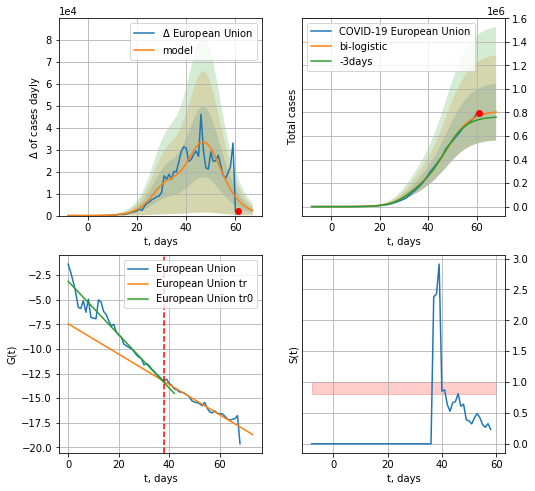

European Union data at: 2020-09-12
+3 day model MAPE: 0.04651915802684479
model: bi-logistic
coeffs:  [6.50647976e+05 2.01824362e-01 4.76677897e+01] [1.63557146e+05 2.54069754e-01 3.15927312e+01]
rational stdev:  0.30016662391822424
forecast at the end of period: +7 days
	 deltaDaycases:  2321
	 total cases:  803619 ± 241219
	 total death:  51754 ± 46604
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend coefficient of determination: 0.919558
 intercept: -7.446330
 slope: -0.154010


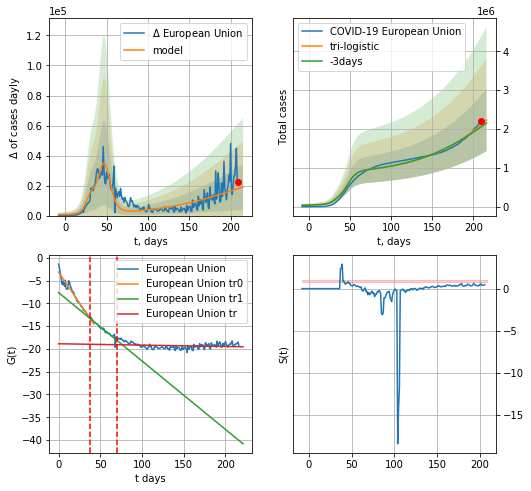

European Union data at: 2020-09-12
+3 day model MAPE: 0.02686162435473656
model: tri-logistic
coeffs:  [5.94298371e+06 1.77415326e-02 2.81657515e+02] [1.63557146e+05 2.54069754e-01 3.15927312e+01 6.50647976e+05
 2.01824362e-01 4.76677897e+01]
forecast rational stdev:  0.35897532804128895
forecast at the end of period: +7 days
	 deltaDaycases:  19020
	 total cases:  2227354 ± 799565
	 total death:  143445 ± 154479
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.943288
 intercept: -3.133643
 slope: -0.270910
trend1 coefficient of determination: 0.917496
 intercept: -7.627918
 slope: -0.150227
trend coefficient of determination: 0.038894
 intercept: -18.867178
 slope: -0.002962


In [2314]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


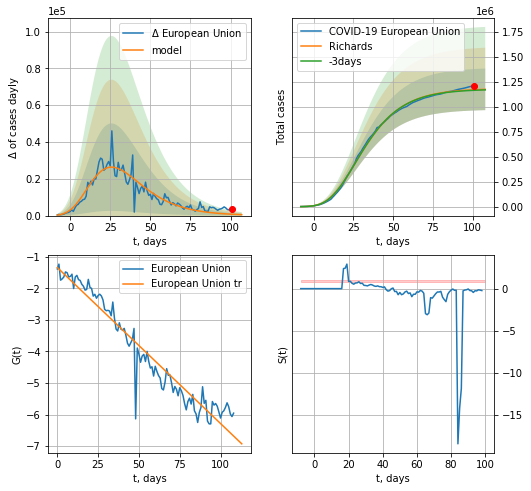

European Union data at: 2020-09-12
+3 day model MAPE: 0.004510
model: Richards
coeffs: [ 1.18204696e+06  8.96706485e+00 -5.59023207e+01  6.77910245e-03]
rational stdev: 0.177380
forecast at the end of period: +7 days
	 deltaDaycases: 510
	 total cases: 1173864 ± 208220
	 total death: 75598 ± 40228
trend coefficient of determination: 0.933679
 intercept: -1.341249
 slope: -0.049432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


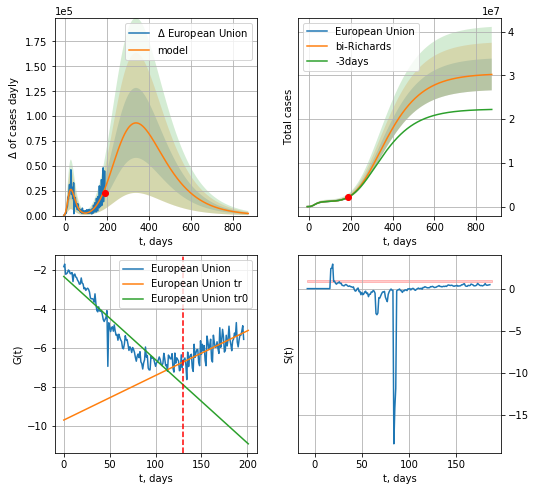

European Union data at: 2020-09-12
+3 day model MAPE: 0.007213
model: bi-Richards
coeffs: [2.92489326e+07 1.34029858e-01 3.51105276e+01 6.67510084e-02]
rational stdev: 0.119968
forecast at the end of period: +686 days
	 deltaDaycases: 2128
	 total cases: 30193079 ± 3622213
	 total death: 1944484 ± 699829
bi-Richards approximation splitting point: 130
trend coefficient of determination: 0.880651
 intercept: -2.328183
 slope: -0.042827
trend coefficient of determination: 0.527110
 intercept: -9.713090
 slope: 0.022948


In [2315]:
vL = 130+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,122*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

In [2317]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1911]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [1912]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [1913]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [1914]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [1915]:
#dfIC[:]

IC
           date   cases  active  death
191 2020-09-08  2150.0      80   10.0
192 2020-09-09  2153.0      76   10.0
193 2020-09-10  2157.0      75   10.0
194 2020-09-11  2161.0      72   10.0
195 2020-09-12  2162.0      67   10.0


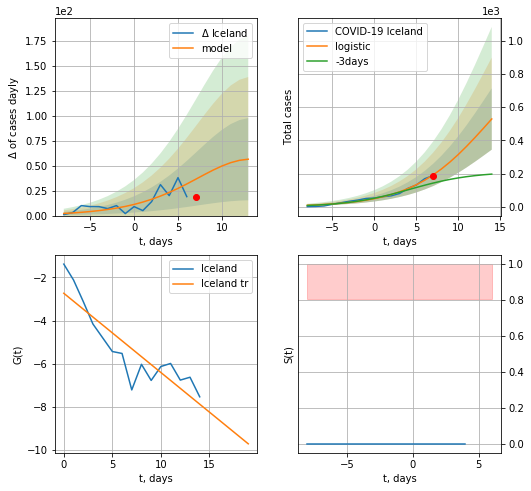

Iceland data at: 2020-09-12
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +7 days
	 deltaDaycases:  56
	 total cases:  529 ± 184
	 total death:  2 ± 2
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


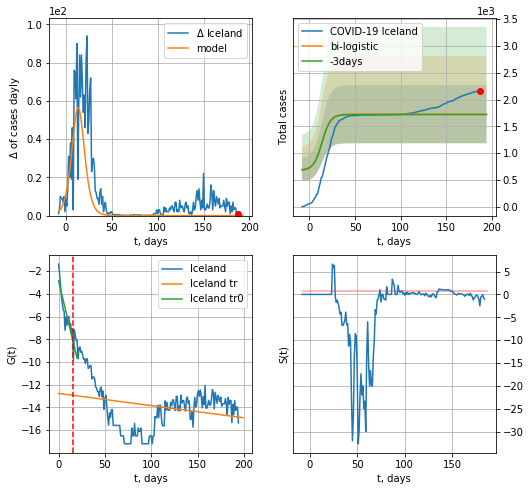

Iceland data at: 2020-09-12
+3 day model MAPE: 0.004544796771376336
model: bi-logistic
coeffs:  [644.02400874  -3.23435095 203.90517771] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.31425004078320157
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  1727 ± 542
	 total death:  7 ± 6
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.063379
 intercept: -12.763434
 slope: -0.010721


In [2318]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


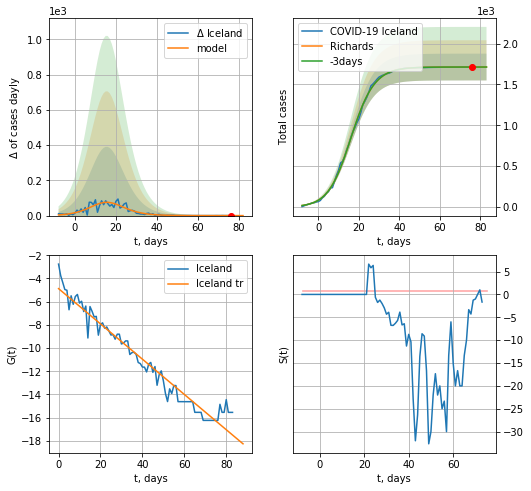

Iceland data at: 2020-09-12
+3 day model MAPE: 0.000010
model: Richards
coeffs: [1.71330052e+03 1.94502632e-01 1.51528095e+01 8.70905557e-01]
rational stdev: 0.095562
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1713 ± 163
	 total death: 7 ± 2
trend coefficient of determination: 0.952024
 intercept: -4.875300
 slope: -0.151986


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


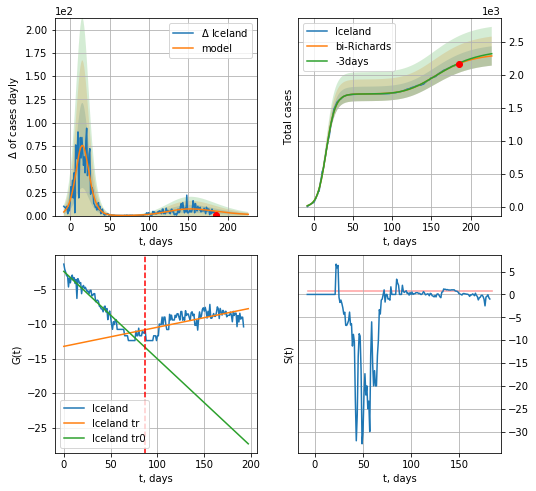

Iceland data at: 2020-09-12
+3 day model MAPE: 0.003263
model: bi-Richards
coeffs: [6.13491360e+02 1.04522080e-01 1.25789162e+02 3.57485039e-01]
rational stdev: 0.064114
forecast at the end of period: +42 days
	 deltaDaycases: 1
	 total cases: 2289 ± 146
	 total death: 10 ± 1
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.935123
 intercept: -2.426702
 slope: -0.126337
trend coefficient of determination: 0.409217
 intercept: -13.247465
 slope: 0.027613


In [2320]:
vL = 87+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [2322]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
182 2020-09-08   98407  25549.0  2107.0
183 2020-09-09   99042  25507.0  2116.0
184 2020-09-10   99715  25385.0  2127.0
185 2020-09-11  100330  25332.0  2140.0
186 2020-09-12  101041  25410.0  2155.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


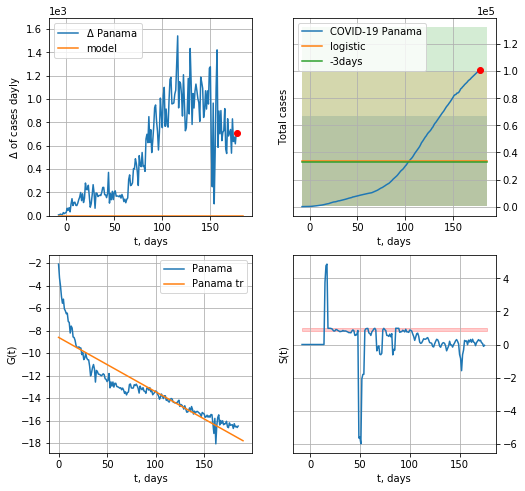

Panama data at: 2020-09-12
+3 day model MAPE: 0.033337283765733014
model: logistic
coeffs:  [ 3.36929786e+04 -2.86486045e+01  7.03711895e+02]
rational stdev:  0.9789549209651811
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  33692 ± 32983
	 total death:  718 ± 2108
trend coefficient of determination: 0.816503
 intercept: -8.605619
 slope: -0.048309


In [2323]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


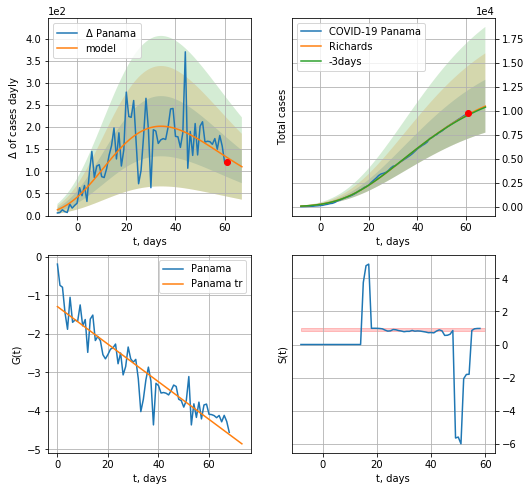

Panama data at: 2020-09-12
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +7 days
	 deltaDaycases: 110
	 total cases: 10468 ± 2754
	 total death: 223 ± 176
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


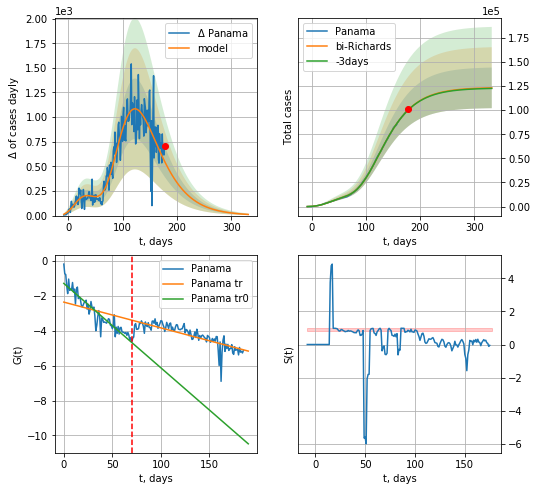

Panama data at: 2020-09-12
+3 day model MAPE: 0.001905
model: bi-Richards
coeffs: [ 1.10028935e+05  1.71003305e+00 -3.21853108e+01  1.55839705e-02]
rational stdev: 0.171092
forecast at the end of period: +154 days
	 deltaDaycases: 11
	 total cases: 123087 ± 21059
	 total death: 2625 ± 1347
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874199
 intercept: -1.288969
 slope: -0.048359
trend coefficient of determination: 0.630877
 intercept: -2.360751
 slope: -0.014761


In [2325]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


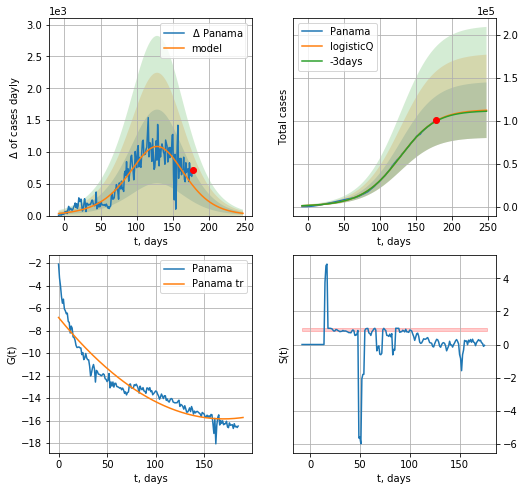

Panama data at: 2020-09-12
+3 day model MAPE: 0.004112
model: logisticQ
coeffs: [ 1.12833351e+05  2.76840919e-05  1.26743664e+02 -1.26232167e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288243
forecast at the end of period: +70 days
	 deltaDaycases: 35
	 total cases: 112307 ± 32371
	 total death: 2395 ± 2071
trend coefficient of determination: 0.894862
 intercept_: -6.8376735425183615
 coeffs_: [ 0.         -0.10596018  0.00031163]


In [2326]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


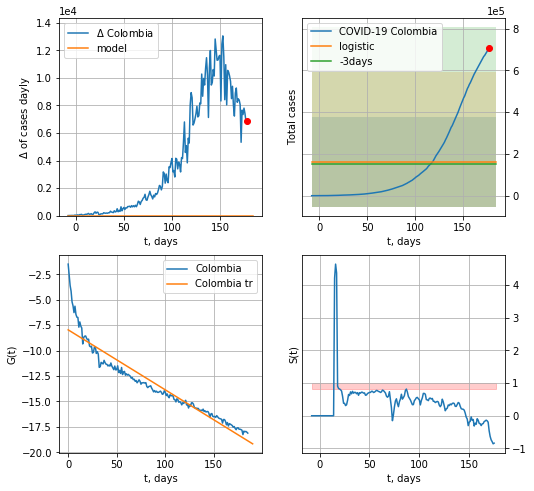

Colombia data at: 2020-09-12
+3 day model MAPE: 0.05703048328858854
model: logistic
coeffs:  [ 1.62887255e+05 -1.22963589e+01  3.01985705e+02]
rational stdev:  1.320915294833745
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  162887 ± 215160
	 total death:  5223 ± 20697
trend coefficient of determination: 0.893787
 intercept: -7.962779
 slope: -0.058934


In [2327]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

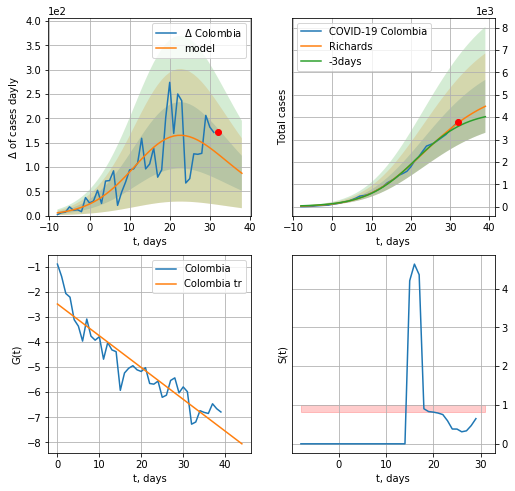

Colombia data at: 2020-09-12
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +7 days
	 deltaDaycases: 87
	 total cases: 4487 ± 1183
	 total death: 143 ± 113
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


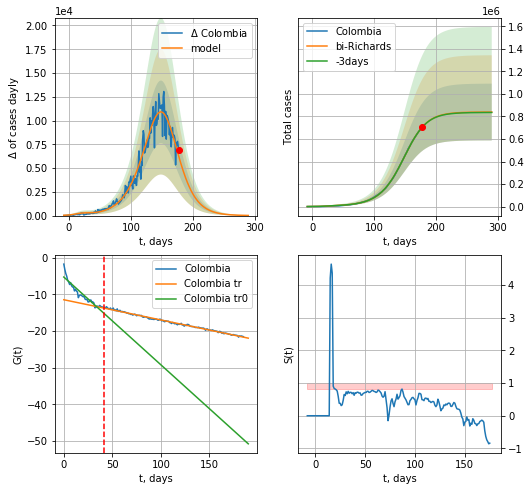

Colombia data at: 2020-09-12
+3 day model MAPE: 0.001198
model: bi-Richards
coeffs: [8.33971567e+05 4.48926768e-02 1.52841882e+02 1.25707587e+00]
rational stdev: 0.300096
forecast at the end of period: +112 days
	 deltaDaycases: 16
	 total cases: 839136 ± 251821
	 total death: 26908 ± 24224
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.886597
 intercept: -5.307793
 slope: -0.239425
trend coefficient of determination: 0.993822
 intercept: -11.500793
 slope: -0.055157


In [2328]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2329]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
188 2020-09-08  46938.0  12184.0  1571.0
189 2020-09-09  47216.0  12256.0  1581.0
190 2020-09-10  47488.0  12335.0  1591.0
191 2020-09-11  47752.0  12430.0  1599.0
192 2020-09-12  48007.0  12527.0  1605.0


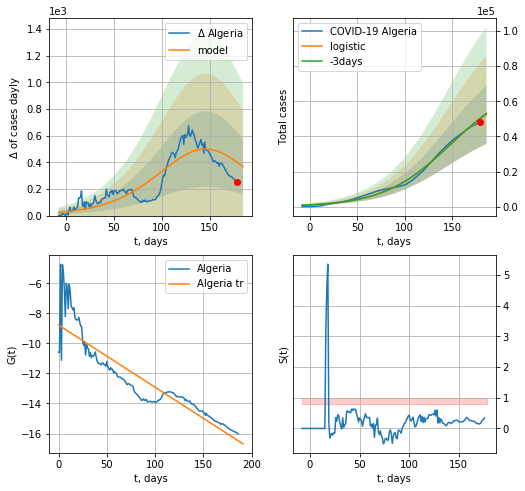

Algeria data at: 2020-09-12
+3 day model MAPE: 0.01077326895603644
model: logistic
coeffs:  [6.90001309e+04 2.89156953e-02 1.46258164e+02]
rational stdev:  0.317791277216429
forecast at the end of period: +7 days
	 deltaDaycases:  367
	 total cases:  52395 ± 16650
	 total death:  1751 ± 1669
trend coefficient of determination: 0.818723
 intercept: -8.784643
 slope: -0.041361


In [2330]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

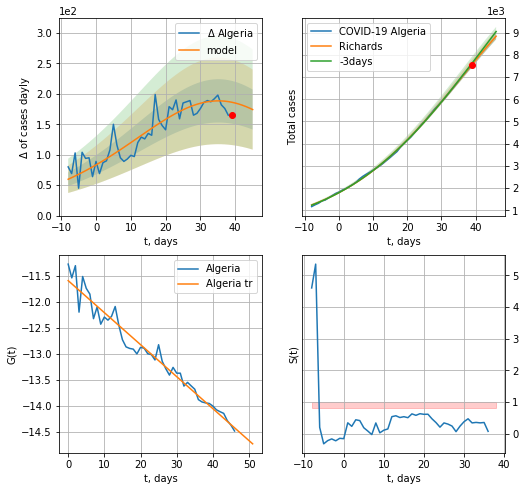

Algeria data at: 2020-09-12
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014715e+04 4.98947140e-02 3.86388173e+01 1.19488229e+00]
rational stdev: 0.015787
forecast at the end of period: +7 days
	 deltaDaycases: 174
	 total cases: 8836 ± 139
	 total death: 295 ± 13
trend coefficient of determination: 0.959635
 intercept: -11.589811
 slope: -0.061720


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


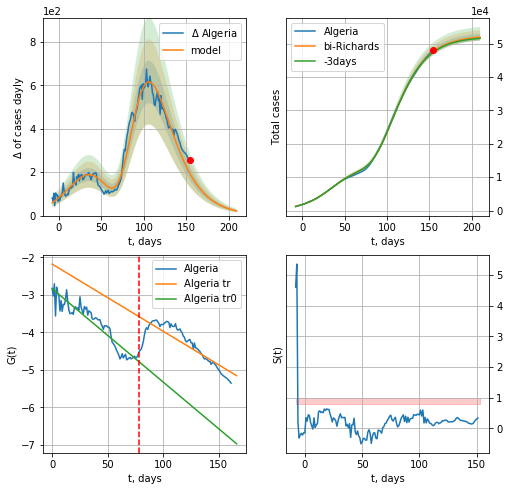

Algeria data at: 2020-09-12
+3 day model MAPE: 0.003798
model: bi-Richards
coeffs: [3.90621029e+04 3.83703663e+00 3.40425898e-01 1.10228398e-02]
rational stdev: 0.019632
forecast at the end of period: +56 days
	 deltaDaycases: 21
	 total cases: 51967 ± 1020
	 total death: 1737 ± 102
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.887947
 intercept: -2.838801
 slope: -0.024913
trend coefficient of determination: 0.715191
 intercept: -2.181662
 slope: -0.017921


In [2331]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2332]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active   death
183 2020-09-08  203342  49806.0  8336.0
184 2020-09-09  207203  51237.0  8456.0
185 2020-09-10  210940  52179.0  8544.0
186 2020-09-11  214746  53638.0  8650.0
187 2020-09-12  218382  54649.0  8723.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


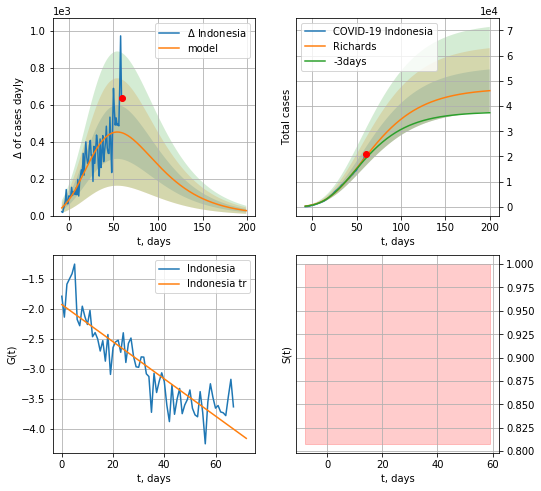

Indonesia data at: 2020-09-12
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +140 days
	 deltaDaycases: 26
	 total cases: 46102 ± 8433
	 total death: 1857 ± 1019
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


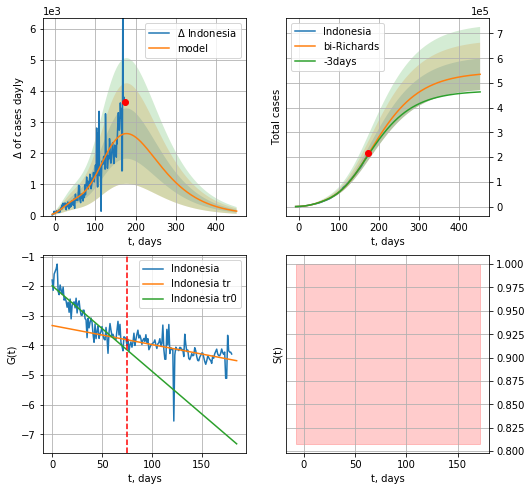

Indonesia data at: 2020-09-12
+3 day model MAPE: 0.016994
model: bi-Richards
coeffs: [ 4.97960318e+05  9.12824500e-01 -1.11611782e+02  1.56164818e-02]
rational stdev: 0.119407
forecast at the end of period: +280 days
	 deltaDaycases: 143
	 total cases: 534998 ± 63882
	 total death: 21549 ± 7719
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.797749
 intercept: -1.986388
 slope: -0.028808
trend coefficient of determination: 0.252208
 intercept: -3.326816
 slope: -0.006411


In [2414]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d12f(1),64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


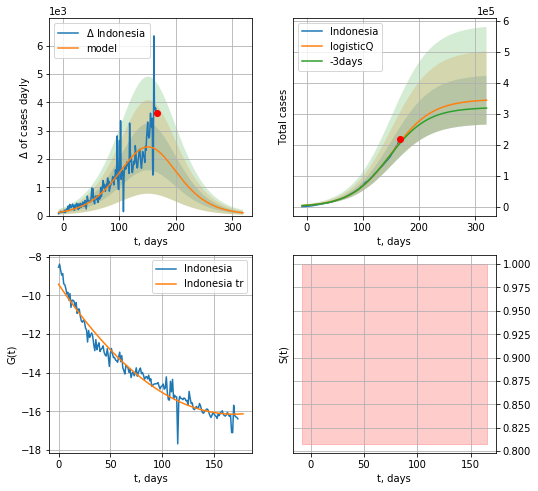

Indonesia data at: 2020-09-12
+3 day model MAPE: 0.019705
model: logisticQ
coeffs: [ 3.46368363e+05  4.93569716e-07  1.51118502e+02 -5.66593458e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.229036
forecast at the end of period: +154 days
	 deltaDaycases: 98
	 total cases: 344431 ± 78887
	 total death: 13873 ± 9532
trend coefficient of determination: 0.962499
 intercept_: -9.432569208167072
 coeffs_: [ 0.         -0.07946011  0.00023497]


In [2415]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date   cases   active   death
185 2020-09-08  245143  55614.0  3986.0
186 2020-09-09  248947  58823.0  4066.0
187 2020-09-10  252964  62250.0  4108.0
188 2020-09-11  257863  66455.0  4292.0
189 2020-09-12  261216  49277.0  4371.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


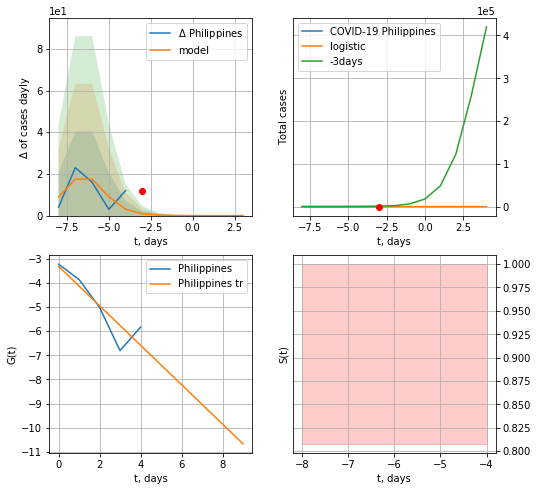

Philippines data at: 2020-09-12
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


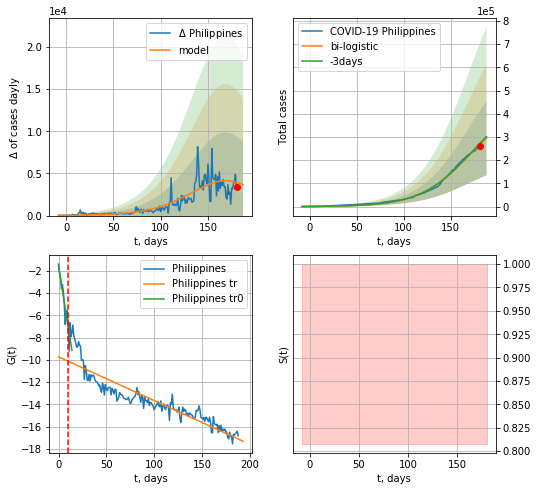

Philippines data at: 2020-09-12
+3 day model MAPE: 0.01662799957342924
model: bi-logistic
coeffs:  [4.39991383e+05 3.76129136e-02 1.69160337e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.541836241325222
forecast at the end of period: +7 days
	 deltaDaycases:  3681
	 total cases:  294897 ± 159786
	 total death:  4934 ± 8020
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.829862
 intercept: -9.724264
 slope: -0.039331


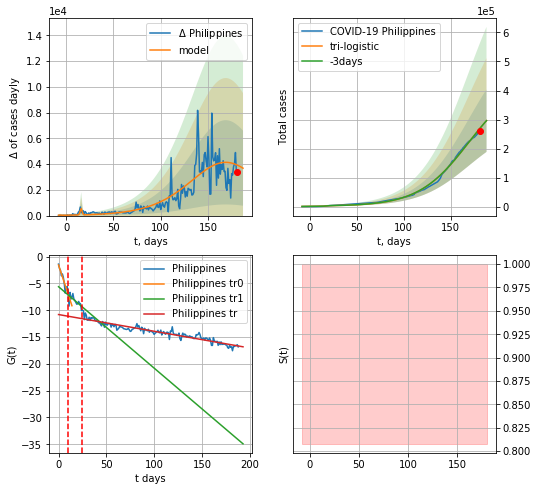

Philippines data at: 2020-09-12
+3 day model MAPE: 0.0005649477172111981
model: tri-logistic
coeffs:  [1279.559266      1.63517032   16.38503925] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  4.39991383e+05
  3.76129136e-02  1.69160337e+02]
forecast rational stdev:  0.3635039011188232
forecast at the end of period: +7 days
	 deltaDaycases:  3681
	 total cases:  296177 ± 107661
	 total death:  4956 ± 5404
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.907521
 intercept: -10.795463
 slope: -0.031171


In [2334]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

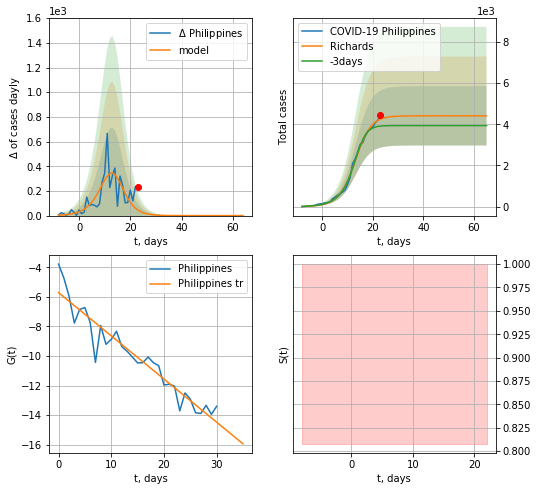

Philippines data at: 2020-09-12
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +42 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 73 ± 71
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


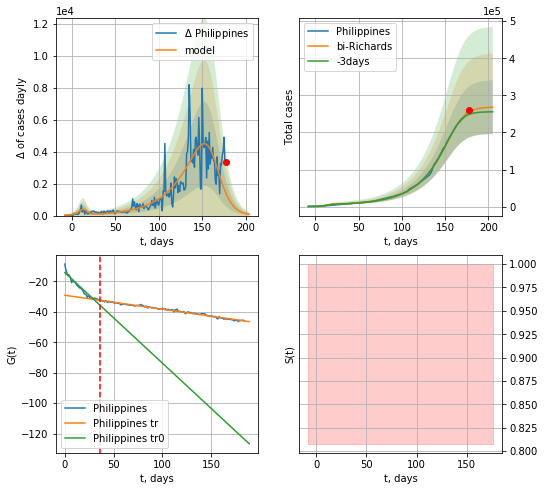

Philippines data at: 2020-09-12
+3 day model MAPE: 0.026135
model: bi-Richards
coeffs: [2.64254470e+05 3.43237284e-02 1.63290160e+02 3.33046295e+00]
rational stdev: 0.269400
forecast at the end of period: +28 days
	 deltaDaycases: 80
	 total cases: 267992 ± 72196
	 total death: 4484 ± 3623
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.930201
 intercept: -14.107768
 slope: -0.595969
trend coefficient of determination: 0.987698
 intercept: -29.079310
 slope: -0.091674


In [2335]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


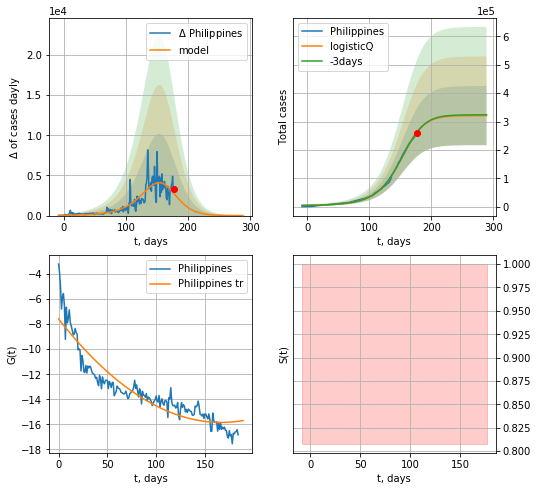

Philippines data at: 2020-09-12
+3 day model MAPE: 0.003419
model: logisticQ
coeffs: [ 3.20436383e+05  1.46633447e-04  1.49653402e+02 -1.95172610e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324830
forecast at the end of period: +112 days
	 deltaDaycases: 7
	 total cases: 320825 ± 104213
	 total death: 5368 ± 5231
trend coefficient of determination: 0.863459
 intercept_: -7.590673739005168
 coeffs_: [ 0.         -0.09904575  0.00029717]


In [2336]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date    cases  active  death
192 2020-09-08  11832.0    7738  290.0
193 2020-09-09  12080.0    7983  293.0
194 2020-09-10  12452.0    8351  297.0
195 2020-09-11  12734.0    8630  300.0
196 2020-09-12  13036.0    8930  302.0


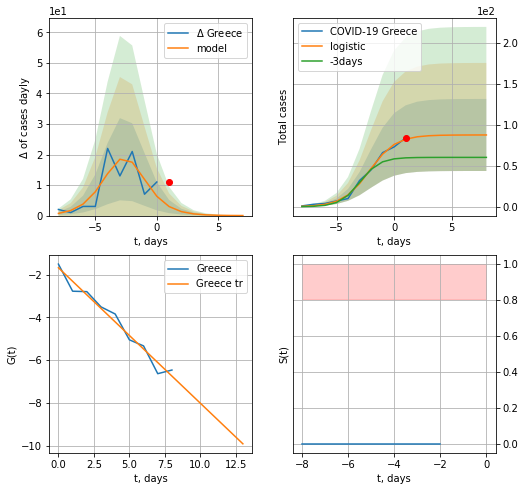

Greece data at: 2020-09-12
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  2 ± 3
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


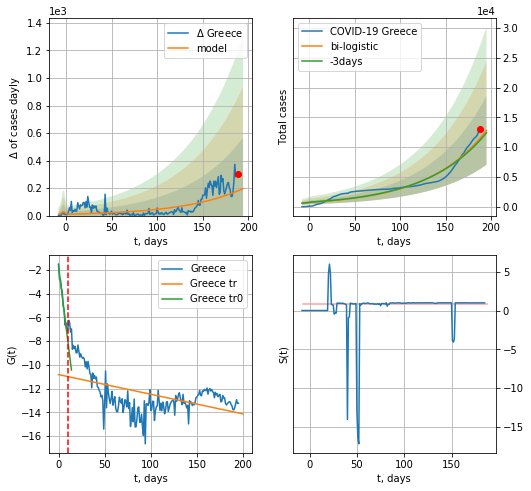

Greece data at: 2020-09-12
+3 day model MAPE: 0.03111711339568263
model: bi-logistic
coeffs:  [5.83873860e+07 1.55337219e-02 7.37732111e+02] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.4516497200838572
forecast at the end of period: +7 days
	 deltaDaycases:  196
	 total cases:  12817 ± 5789
	 total death:  296 ± 401
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.254280
 intercept: -10.824300
 slope: -0.016587


In [2337]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


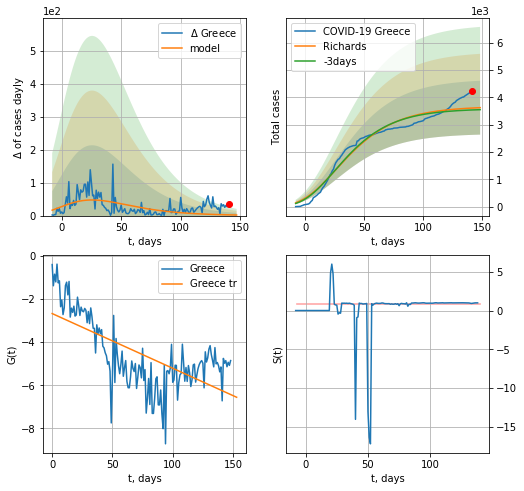

Greece data at: 2020-09-12
+3 day model MAPE: 0.019952
model: Richards
coeffs: [ 3.67300317e+03  8.86166446e+00 -1.31342745e+02  3.96579151e-03]
rational stdev: 0.271998
forecast at the end of period: +7 days
	 deltaDaycases: 1
	 total cases: 3622 ± 985
	 total death: 83 ± 67
trend coefficient of determination: 0.441158
 intercept: -2.678204
 slope: -0.025333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


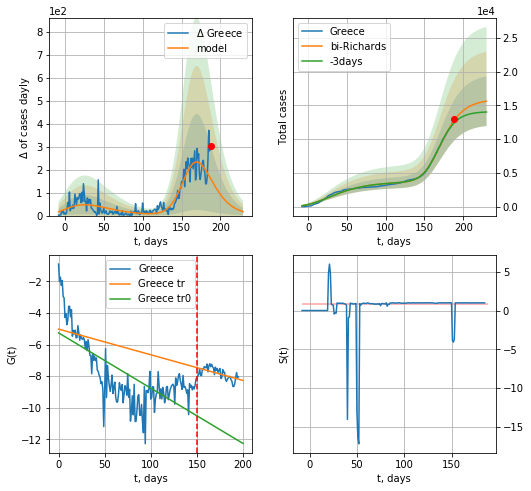

Greece data at: 2020-09-12
+3 day model MAPE: 0.030300
model: bi-Richards
coeffs: [1.22160634e+04 1.39975892e-01 1.57408760e+02 4.51584520e-01]
rational stdev: 0.235071
forecast at the end of period: +42 days
	 deltaDaycases: 17
	 total cases: 15615 ± 3670
	 total death: 361 ± 254
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.503239
 intercept: -5.256990
 slope: -0.035022
trend coefficient of determination: 0.334161
 intercept: -5.017267
 slope: -0.016268


In [2338]:
iL = 0
vL = 150+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


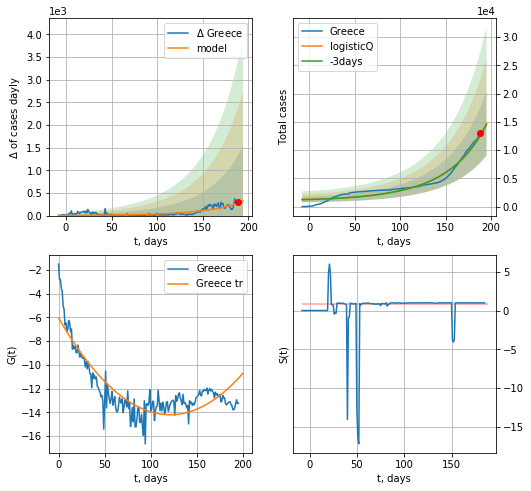

Greece data at: 2020-09-12
+3 day model MAPE: 0.012181
model: logisticQ
coeffs: [ 1.91962417e+07  4.89675652e-05  4.13626824e+02 -4.74955658e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386066
forecast at the end of period: +7 days
	 deltaDaycases: 320
	 total cases: 14723 ± 5684
	 total death: 341 ± 394
trend coefficient of determination: 0.762235
 intercept_: -6.038496951760374
 coeffs_: [ 0.         -0.13527642  0.0005597 ]


In [2339]:
x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date    cases  active  death
186 2020-09-08   9715.0    5103  628.0
187 2020-09-09  10191.0    5571  630.0
188 2020-09-10  10909.0    6264  631.0
189 2020-09-11  11825.0    7134  633.0
190 2020-09-12  12309.0    7603  637.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


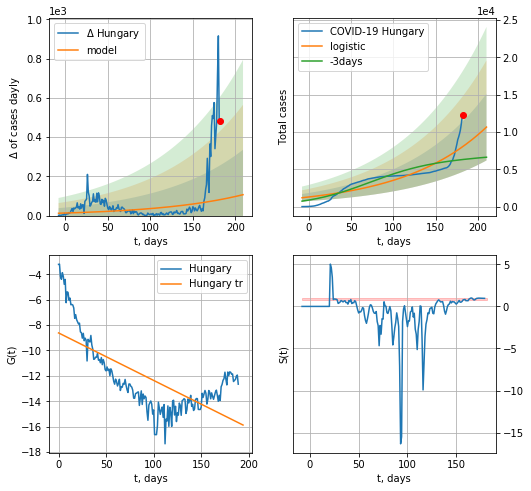

Hungary data at: 2020-09-12
+3 day model MAPE: 0.28492616539904675
model: logistic
coeffs:  [4.73826910e+06 1.00602493e-02 8.15775801e+02]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.41955238281004814
forecast at the end of period: +28 days
	 deltaDaycases:  106
	 total cases:  10664 ± 4474
	 total death:  551 ± 693
trend coefficient of determination: 0.485497
 intercept: -8.616845
 slope: -0.037390


In [2340]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


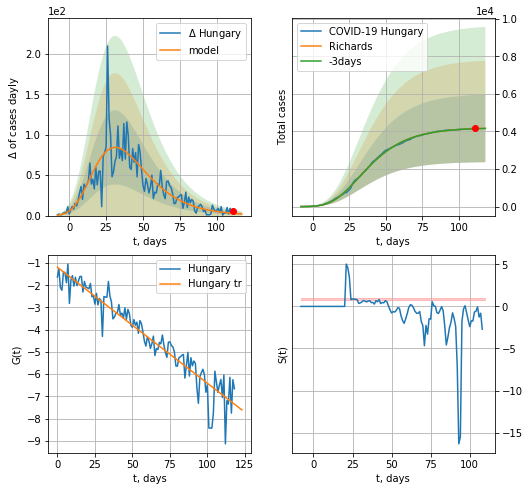

Hungary data at: 2020-09-12
+3 day model MAPE: 0.000650
model: Richards
coeffs: [ 4.20148323e+03  4.05226624e+00 -4.64835566e+01  1.35854381e-02]
rational stdev: 0.432271
forecast at the end of period: +7 days
	 deltaDaycases: 2
	 total cases: 4165 ± 1800
	 total death: 215 ± 278
trend coefficient of determination: 0.905264
 intercept: -1.190861
 slope: -0.052185


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


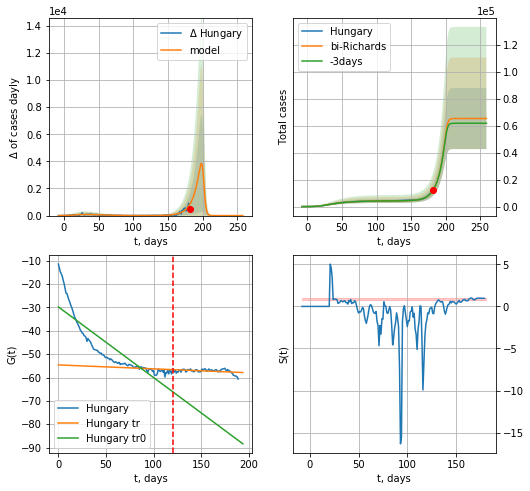

Hungary data at: 2020-09-12
+3 day model MAPE: 0.009893
model: bi-Richards
coeffs: [6.10179710e+04 1.01780136e-01 2.01711809e+02 6.09738211e+00]
rational stdev: 0.346649
forecast at the end of period: +77 days
	 deltaDaycases: 0
	 total cases: 65219 ± 22608
	 total death: 3375 ± 3509
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.759438
 intercept: -29.777850
 slope: -0.302141
trend coefficient of determination: 0.146916
 intercept: -54.598975
 slope: -0.016797


In [2341]:
vL = 120
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


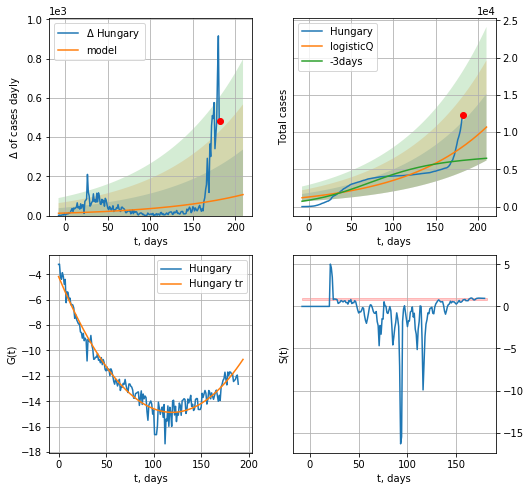

Hungary data at: 2020-09-12
+3 day model MAPE: 0.308345
model: logisticQ
coeffs: [ 8.67380357e+05  4.51534568e-07  6.32333197e+02 -2.27810790e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419538
forecast at the end of period: +28 days
	 deltaDaycases: 106
	 total cases: 10684 ± 4482
	 total death: 552 ± 694
trend coefficient of determination: 0.955519
 intercept_: -4.175812657679211
 coeffs_: [ 0.         -0.17912534  0.00074993]


In [2342]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


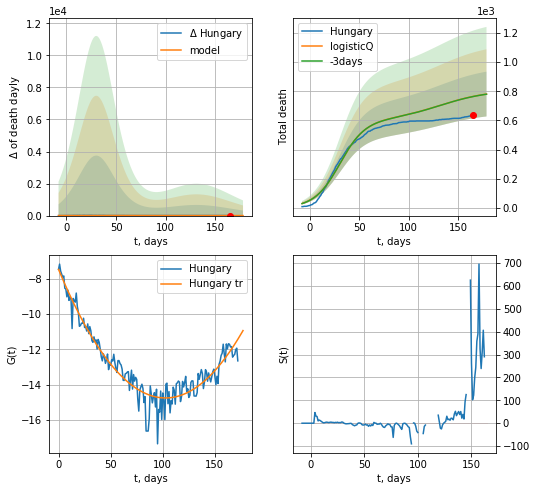

Hungary data at: 2020-09-12
+3 day model MAPE: 0.001104
model: logisticQ
coeffs: [ 5.97934461e+02  1.67541053e-07  3.03392366e+01 -4.66525249e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.196839
forecast at the end of period: +14 days
	 total death: 780 ± 153
trend coefficient of determination: 0.911272
 intercept_: -7.479420519184576
 coeffs_: [ 0.         -0.14172534  0.00069025]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


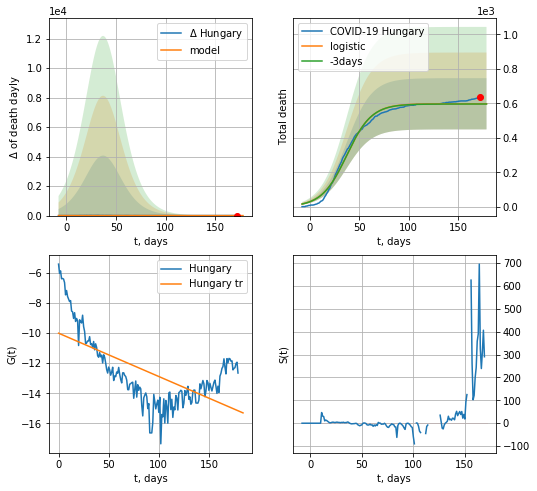

Hungary data at: 2020-09-12
+3 day model MAPE: 0.002255884869170486
model: logistic
coeffs:  [5.97562478e+02 7.90545171e-02 3.73403507e+01]
rational stdev:  0.24879596528840214
forecast at the end of period: +7 days
	 total death:  597 ± 148
trend coefficient of determination: 0.401086
 intercept: -10.009239
 slope: -0.028743


In [2343]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

MT
           date   cases  active  death
184 2020-09-08  2099.0     356   14.0
185 2020-09-09  2162.0     388   14.0
186 2020-09-10  2204.0     387   14.0
187 2020-09-11  2247.0     399   15.0
188 2020-09-12  2274.0     409   15.0


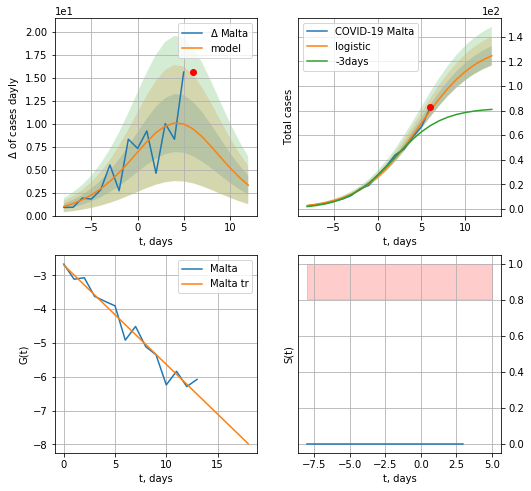

Malta data at: 2020-09-12
model: logistic
coeffs:  [135.01423457   0.29914202   4.75768623]
rational stdev:  0.06279874283082902
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  124 ± 7
	 total death:  0 ± 0
trend coefficient of determination: 0.952124
 intercept: -2.695789
 slope: -0.293811


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


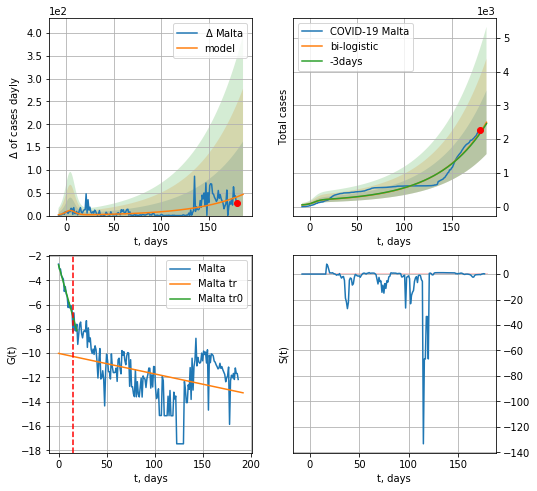

Malta data at: 2020-09-12
+3 day model MAPE: 0.013927706140696959
model: bi-logistic
coeffs:  [1.06157875e+07 1.98664664e-02 6.10323002e+02] [135.01423457   0.29914202   4.75768623]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.37681631974794194
forecast at the end of period: +7 days
	 deltaDaycases:  46
	 total cases:  2498 ± 941
	 total death:  16 ± 18
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.953633
 intercept: -2.737437
 slope: -0.284200
trend coefficient of determination: 0.143022
 intercept: -10.013585
 slope: -0.016910


In [2344]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


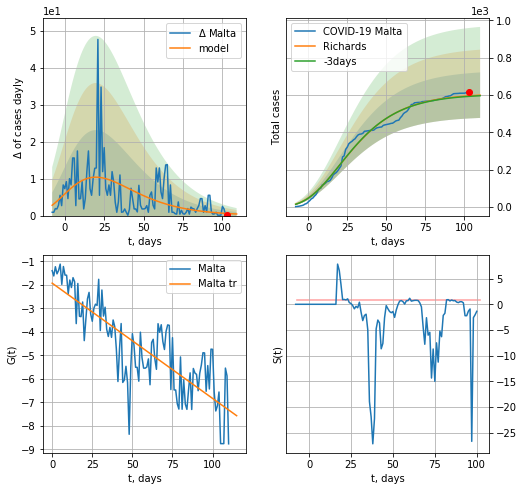

Malta data at: 2020-09-12
+3 day model MAPE: 0.004738
model: Richards
coeffs: [ 6.08571201e+02  8.24808839e+00 -9.10069288e+01  5.64853369e-03]
rational stdev: 0.203304
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 599 ± 121
	 total death: 3 ± 1
trend coefficient of determination: 0.678551
 intercept: -1.925365
 slope: -0.049026


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


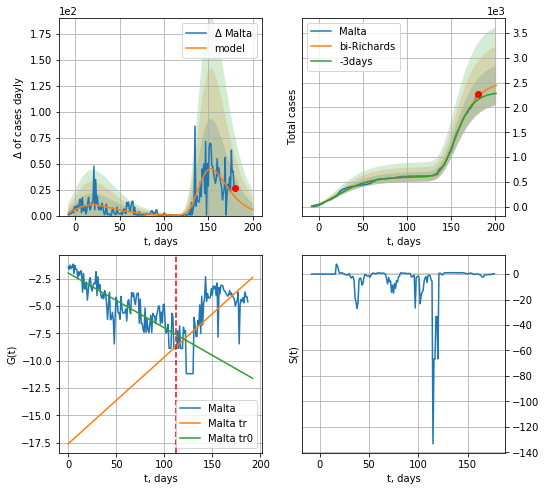

Malta data at: 2020-09-12
+3 day model MAPE: 0.031366
model: bi-Richards
coeffs: [1.92230613e+03 2.74465224e+00 9.51078643e+01 2.34298592e-02]
rational stdev: 0.160935
forecast at the end of period: +21 days
	 deltaDaycases: 5
	 total cases: 2442 ± 393
	 total death: 16 ± 7
bi-Richards approximation splitting point: 112
trend coefficient of determination: 0.690042
 intercept: -1.973815
 slope: -0.050181
trend coefficient of determination: 0.462868
 intercept: -17.597702
 slope: 0.079283


In [2345]:
vL = 112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,27*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


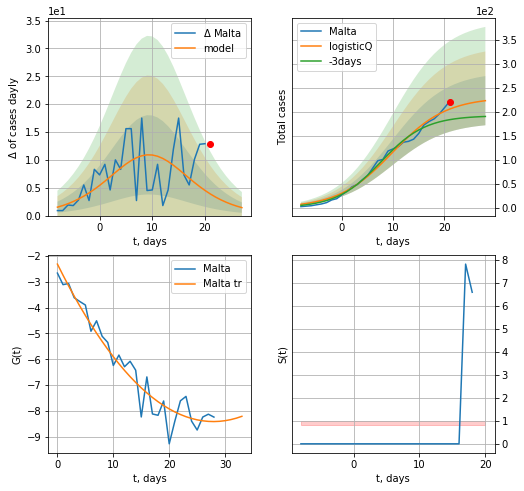

Malta data at: 2020-09-12
+3 day model MAPE: 0.130307
model: logisticQ
coeffs: [ 2.30072980e+02  3.58401181e-06  9.85050068e+00 -5.29673769e+04]
rational stdev: 0.229349
forecast at the end of period: +7 days
	 deltaDaycases: 1
	 total cases: 222 ± 51
	 total death: 1 ± 0
trend coefficient of determination: 0.934916
 intercept_: -2.3194397645380054
 coeffs_: [ 0.         -0.4365547   0.00782096]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


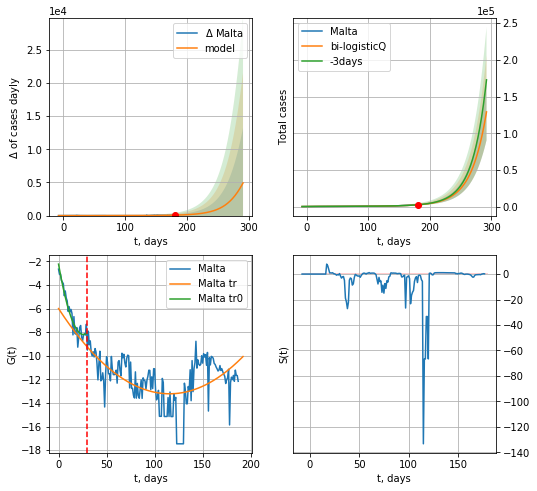

Malta data at: 2020-09-12
+3 day model MAPE: 0.027120
model: bi-logisticQ
coeffs: [ 8.65965516e+05  7.02289003e-05  3.28187968e+02 -3.94333725e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299225
forecast at the end of period: +112 days
	 deltaDaycases: 4919
	 total cases: 129060 ± 38618
	 total death: 851 ± 763
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.927936
 intercept_: -2.238018849909004
 coeffs_: [ 0.         -0.46099164  0.00890422]
trend coefficient of determination: 0.282120
 intercept_: -6.003250859650428
 coeffs_: [ 0.         -0.12491992  0.00054041]


In [2346]:
x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
182 2020-09-08  4888.0  1904.0   37.0
183 2020-09-09  5088.0  2028.0   37.0
184 2020-09-10  5252.0  2134.0   37.0
185 2020-09-11  5453.0  2301.0   38.0
186 2020-09-12  5532.0  2370.0   38.0


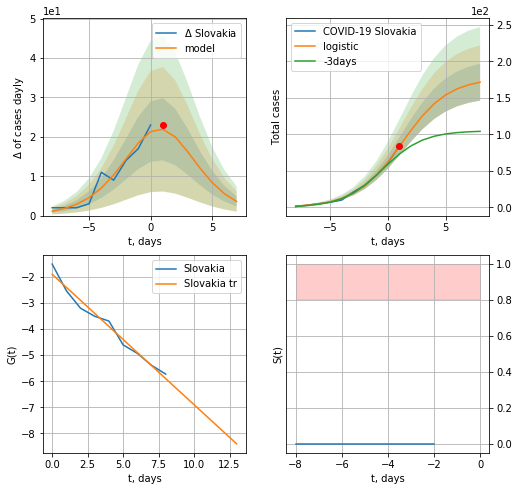

Slovakia data at: 2020-09-12
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +7 days
	 deltaDaycases:  3
	 total cases:  171 ± 25
	 total death:  1 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


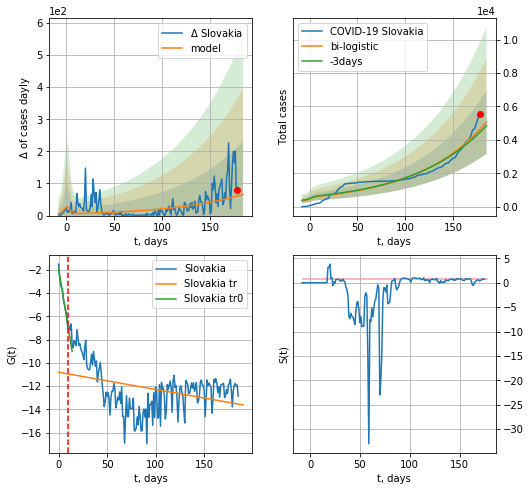

Slovakia data at: 2020-09-12
+3 day model MAPE: 0.03918349204383622
model: bi-logistic
coeffs:  [1.43095759e+07 1.36351905e-02 7.70350433e+02] [177.28786061   0.49967231   1.23158076]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.37478837152685257
forecast at the end of period: +7 days
	 deltaDaycases:  66
	 total cases:  5067 ± 1899
	 total death:  34 ± 38
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.138370
 intercept: -10.810659
 slope: -0.014810


In [2347]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


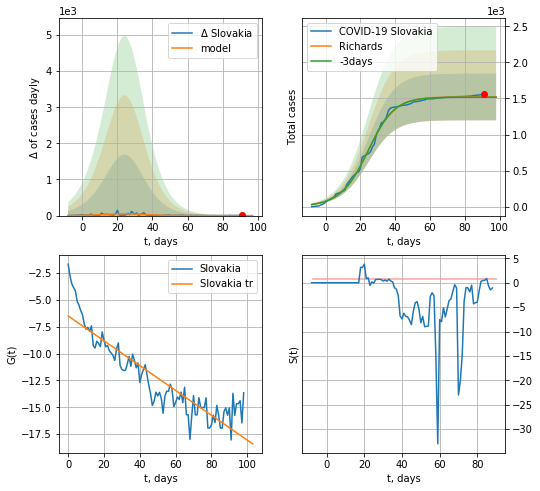

Slovakia data at: 2020-09-12
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109568e+03 1.16938732e-01 2.55808264e+01 1.14750291e+00]
rational stdev: 0.212800
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1521 ± 323
	 total death: 10 ± 6
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


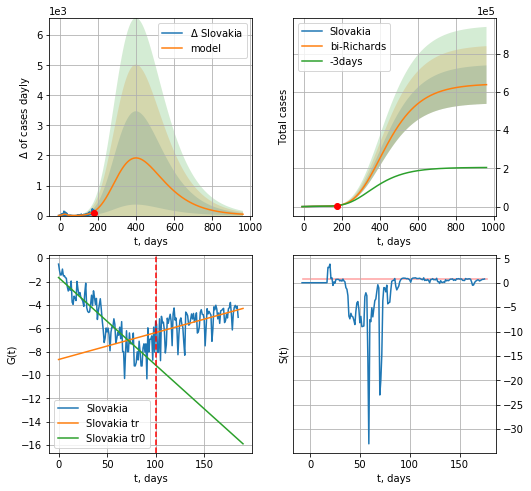

Slovakia data at: 2020-09-12
+3 day model MAPE: 0.024180
model: bi-Richards
coeffs: [6.42048427e+05 9.02937687e-02 1.21009852e+02 9.41080606e-02]
rational stdev: 0.157834
forecast at the end of period: +784 days
	 deltaDaycases: 45
	 total cases: 638218 ± 100732
	 total death: 4384 ± 2075
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.805569
 intercept: -1.657526
 slope: -0.074898
trend coefficient of determination: 0.259270
 intercept: -8.672762
 slope: 0.023005


In [2349]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d12f(1),136*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2350]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
187 2020-09-08  3312.0   590.0  135.0
188 2020-09-09  3403.0   590.0  135.0
189 2020-09-10  3497.0   700.0  135.0
190 2020-09-11  3603.0   769.0  135.0
191 2020-09-12  3702.0   837.0  135.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


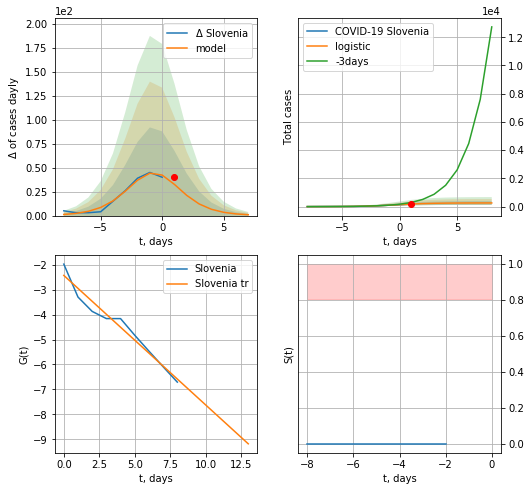

Slovenia data at: 2020-09-12
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  260 ± 138
	 total death:  9 ± 14
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


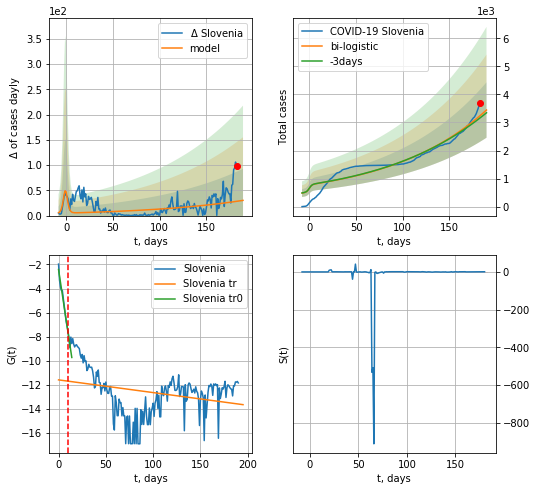

Slovenia data at: 2020-09-12
+3 day model MAPE: 0.02568502051187588
model: bi-logistic
coeffs:  [1.37790193e+06 9.52855234e-03 8.26889259e+02] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.28669273328797573
forecast at the end of period: +7 days
	 deltaDaycases:  30
	 total cases:  3442 ± 986
	 total death:  128 ± 110
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.077556
 intercept: -11.585610
 slope: -0.010544


In [2416]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


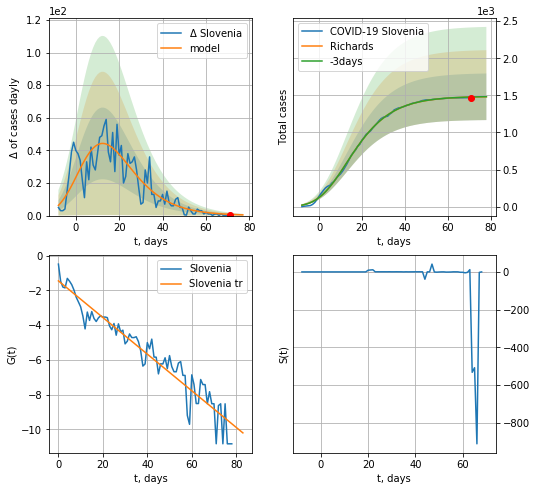

Slovenia data at: 2020-09-12
+3 day model MAPE: 0.001063
model: Richards
coeffs: [ 1.48543612e+03  5.20176508e-01 -7.42026148e+00  1.68829761e-01]
rational stdev: 0.211962
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1480 ± 313
	 total death: 55 ± 34
trend coefficient of determination: 0.919511
 intercept: -1.449330
 slope: -0.105393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


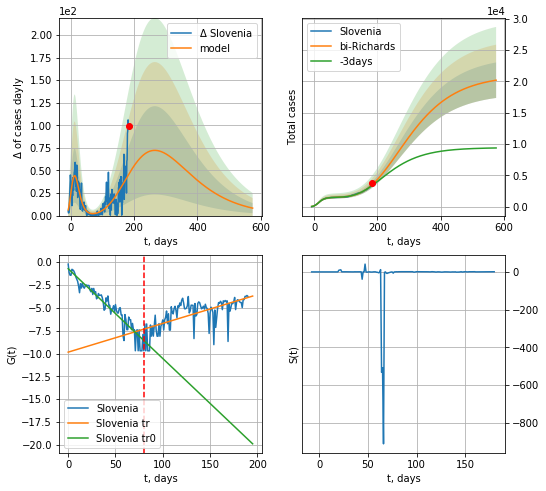

Slovenia data at: 2020-09-12
+3 day model MAPE: 0.037998
model: bi-Richards
coeffs: [ 1.95104608e+04  6.88803625e-01 -1.50049685e+02  1.47277740e-02]
rational stdev: 0.140477
forecast at the end of period: +392 days
	 deltaDaycases: 8
	 total cases: 20167 ± 2833
	 total death: 755 ± 318
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.909582
 intercept: -0.711441
 slope: -0.098348
trend coefficient of determination: 0.430561
 intercept: -9.849195
 slope: 0.031486


In [2417]:
vL = 80
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2006]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
182 2020-09-08  31994   630.0  727.0
183 2020-09-09  32078   570.0  728.0
184 2020-09-10  32136   464.0  729.0
185 2020-09-11  32228   398.0  730.0
186 2020-09-12  32300   469.0  731.0


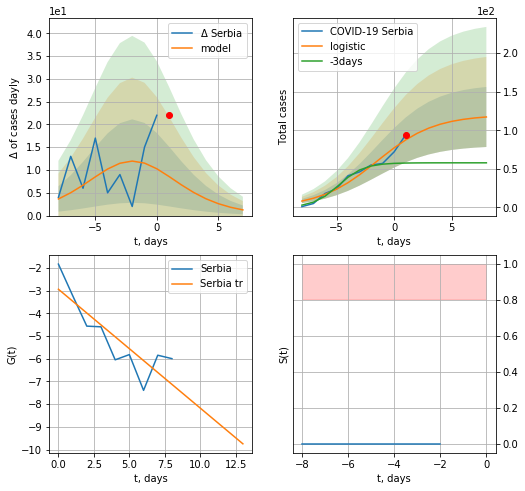

Serbia data at: 2020-09-12
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +7 days
	 deltaDaycases:  1
	 total cases:  117 ± 38
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


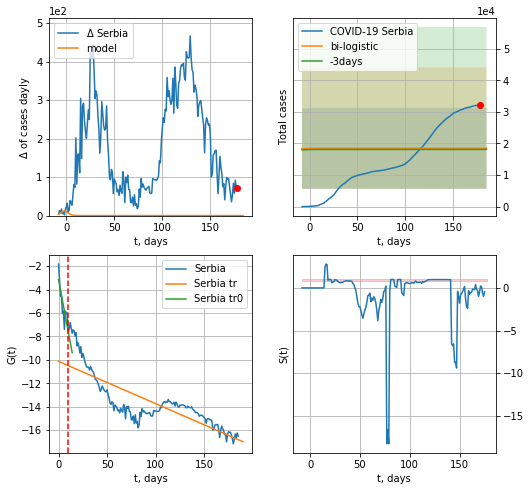

Serbia data at: 2020-09-12
+3 day model MAPE: 0.019614862733472318
model: bi-logistic
coeffs:  [ 1.46742051e+04 -1.89779143e+00  2.04311138e+02] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6942393133174896
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  18462 ± 12817
	 total death:  417 ± 868
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.668850
 intercept: -10.126356
 slope: -0.036079


In [2353]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


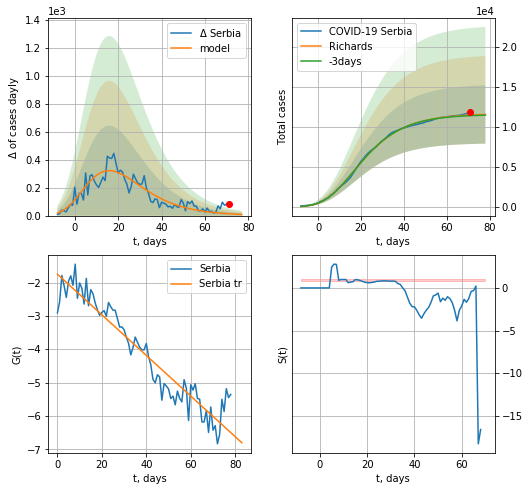

Serbia data at: 2020-09-12
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +7 days
	 deltaDaycases: 8
	 total cases: 11558 ± 3650
	 total death: 261 ± 247
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


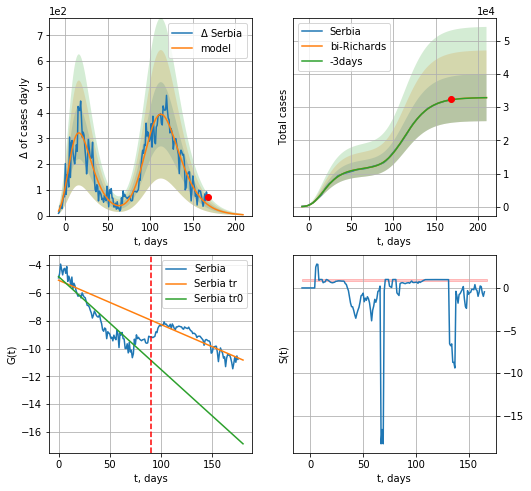

Serbia data at: 2020-09-12
+3 day model MAPE: 0.000578
model: bi-Richards
coeffs: [2.12587649e+04 1.36065681e-01 9.98379982e+01 4.50010713e-01]
rational stdev: 0.216007
forecast at the end of period: +42 days
	 deltaDaycases: 3
	 total cases: 32865 ± 7099
	 total death: 743 ± 481
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.864213
 intercept: -4.826169
 slope: -0.066797
trend coefficient of determination: 0.746715
 intercept: -5.086613
 slope: -0.031890


In [2354]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2356]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date    cases  active  death
192 2020-09-08  12626.0  2587.0  206.0
193 2020-09-09  12917.0  2567.0  208.0
194 2020-09-10  13107.0  2430.0  211.0
195 2020-09-11  13368.0  2429.0  218.0
196 2020-09-12  13533.0  2410.0  224.0


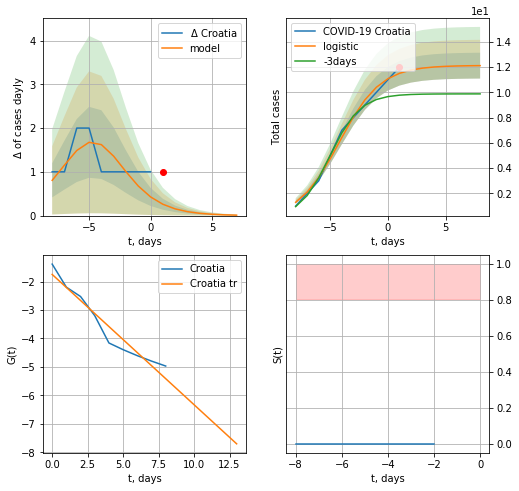

Croatia data at: 2020-09-12
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


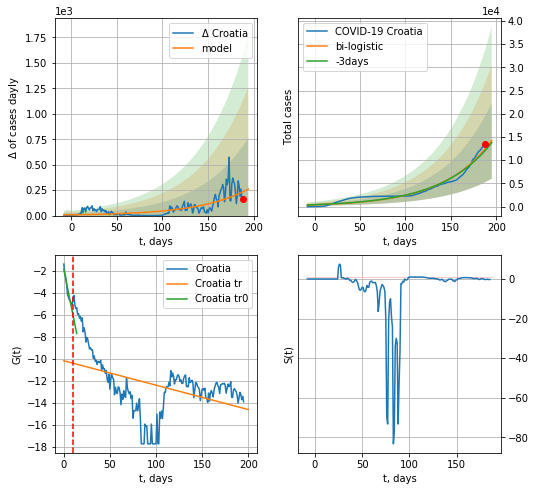

Croatia data at: 2020-09-12
+3 day model MAPE: 0.026910507240936885
model: bi-logistic
coeffs:  [5.56473591e+07 1.85866105e-02 6.40213315e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.5757837493554775
forecast at the end of period: +7 days
	 deltaDaycases:  260
	 total cases:  14187 ± 8169
	 total death:  234 ± 404
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.191196
 intercept: -10.182047
 slope: -0.022196


In [2357]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


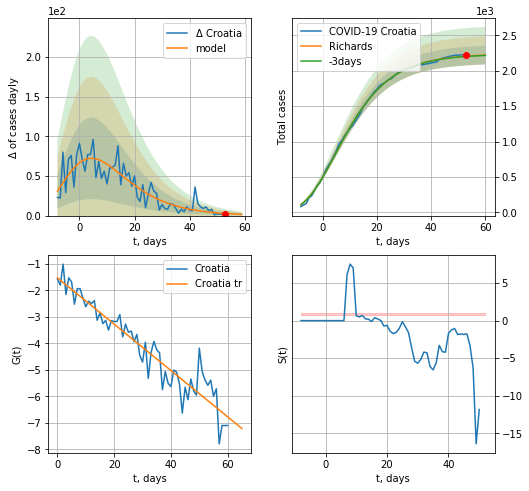

Croatia data at: 2020-09-12
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963098e+03  7.95198453e+00 -4.62549964e+01  1.10913889e-02]
rational stdev: 0.059687
forecast at the end of period: +7 days
	 deltaDaycases: 1
	 total cases: 2222 ± 132
	 total death: 36 ± 6
trend coefficient of determination: 0.897394
 intercept: -1.522030
 slope: -0.087533


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


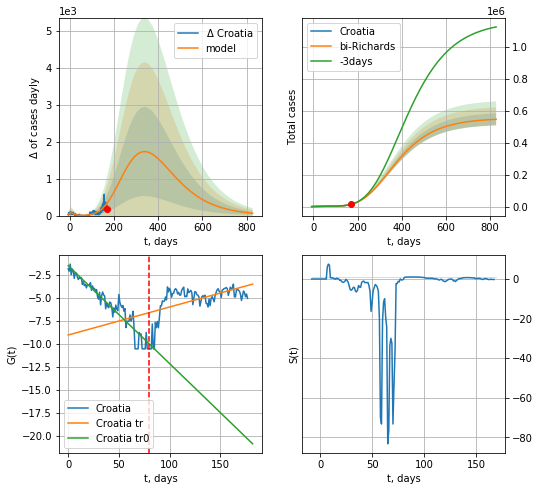

Croatia data at: 2020-09-12
+3 day model MAPE: 0.014191
model: bi-Richards
coeffs: [5.52324227e+05 1.35190433e-01 2.77505327e+01 6.51151152e-02]
rational stdev: 0.068417
forecast at the end of period: +658 days
	 deltaDaycases: 64
	 total cases: 547218 ± 37439
	 total death: 9057 ± 1858
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.905939
 intercept: -1.453035
 slope: -0.106645
trend coefficient of determination: 0.303048
 intercept: -9.013410
 slope: 0.030463


In [2358]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,118*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2359]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date   cases  active   death
186 2020-09-08  100228   14782  5560.0
187 2020-09-09  100403   14137  5577.0
188 2020-09-10  100557   13370  5590.0
189 2020-09-11  100708   12628  5607.0
190 2020-09-12  100856   11968  5627.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


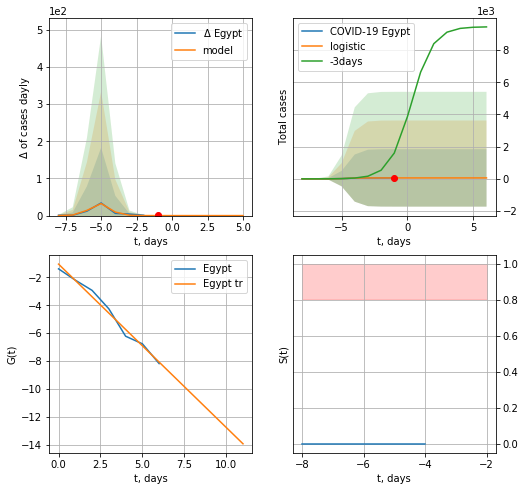

Egypt data at: 2020-09-12
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


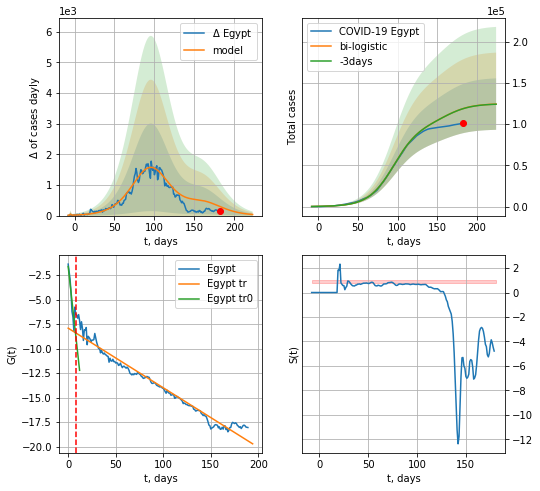

Egypt data at: 2020-09-12
+3 day model MAPE: 0.0009170007725156575
model: bi-logistic
coeffs:  [9.97859423e+04 6.21175273e-02 9.55242480e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.2509265022166844
forecast at the end of period: +42 days
	 deltaDaycases:  35
	 total cases:  124225 ± 31171
	 total death:  6930 ± 5216
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.966234
 intercept: -7.914912
 slope: -0.060783


In [2360]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


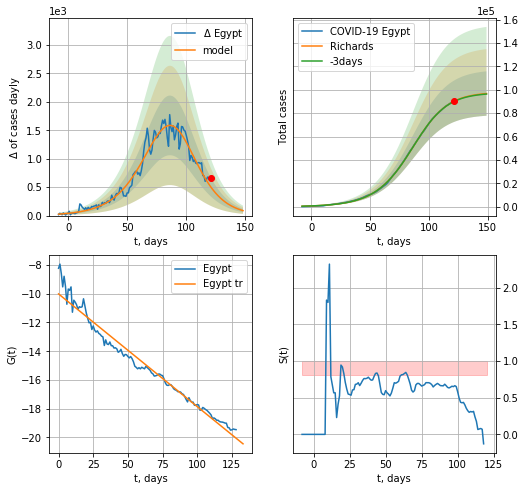

Egypt data at: 2020-09-12
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +28 days
	 deltaDaycases: 87
	 total cases: 96818 ± 18992
	 total death: 5401 ± 3178
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


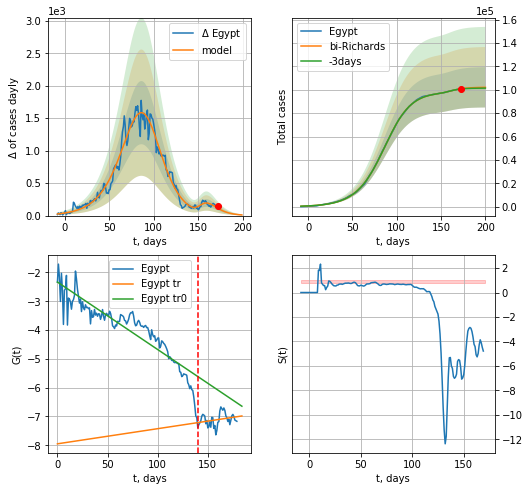

Egypt data at: 2020-09-12
+3 day model MAPE: 0.001925
model: bi-Richards
coeffs: [4.12997311e+03 1.88090016e+00 1.33793588e+02 5.58956589e-02]
rational stdev: 0.168665
forecast at the end of period: +28 days
	 deltaDaycases: 10
	 total cases: 102070 ± 17215
	 total death: 5694 ± 2881
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.833360
 intercept: -2.332096
 slope: -0.023434
trend coefficient of determination: 0.074643
 intercept: -7.949957
 slope: 0.005256


In [2365]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,28*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Egypt",dfEG[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


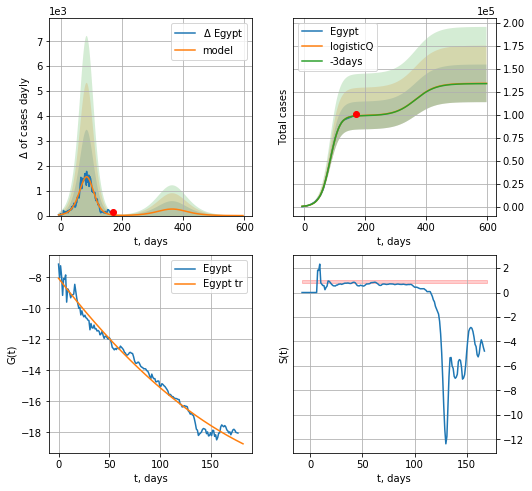

Egypt data at: 2020-09-12
+3 day model MAPE: 0.002188
model: logisticQ
coeffs: [ 9.93371018e+04  5.10342795e-05  8.35174029e+01 -1.14699113e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.152401
forecast at the end of period: +427 days
	 deltaDaycases: 0
	 total cases: 134488 ± 20496
	 total death: 7503 ± 3430
trend coefficient of determination: 0.982947
 intercept_: -8.068612961485897
 coeffs_: [ 0.         -0.08475555  0.0001436 ]


In [2366]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
189 2020-09-08  269578  55597.0  7657.0
190 2020-09-09  273821  56096.0  7732.0
191 2020-09-10  278418  56787.0  7814.0
192 2020-09-11  282672  57395.0  7881.0
193 2020-09-12  286778  57554.0  7941.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


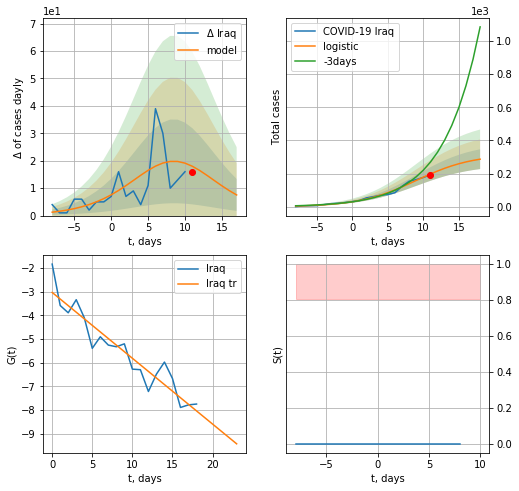

Iraq data at: 2020-09-12
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +7 days
	 deltaDaycases:  7
	 total cases:  287 ± 59
	 total death:  7 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


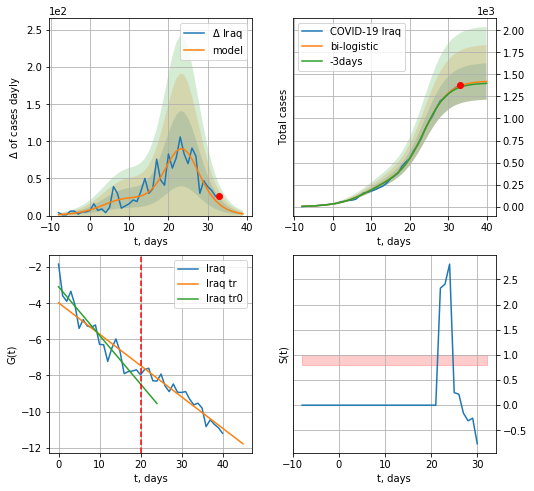

Iraq data at: 2020-09-12
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +7 days
	 deltaDaycases:  2
	 total cases:  1419 ± 206
	 total death:  39 ± 17
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


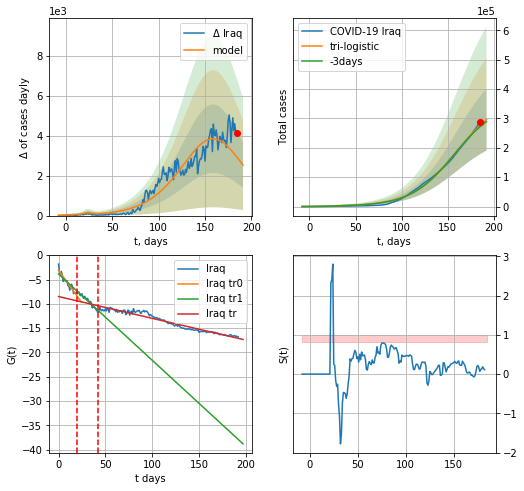

Iraq data at: 2020-09-12
+3 day model MAPE: 0.01834430749026243
model: tri-logistic
coeffs:  [3.69252476e+05 4.16564312e-02 1.59194735e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.3560298724680714
forecast at the end of period: +7 days
	 deltaDaycases:  2521
	 total cases:  295654 ± 105261
	 total death:  8186 ± 8743
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.945178
 intercept: -8.499865
 slope: -0.044791


In [2367]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


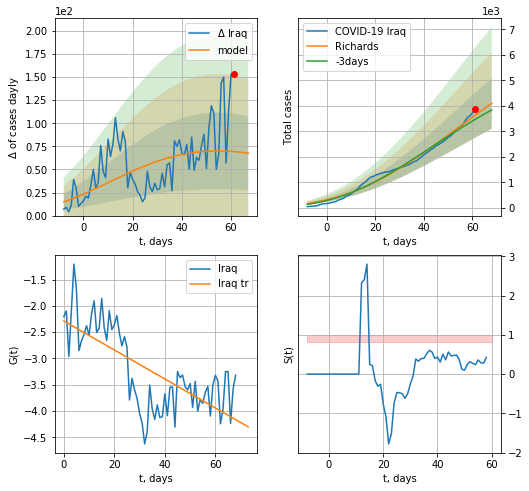

Iraq data at: 2020-09-12
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +7 days
	 deltaDaycases: 67
	 total cases: 4106 ± 997
	 total death: 113 ± 82
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


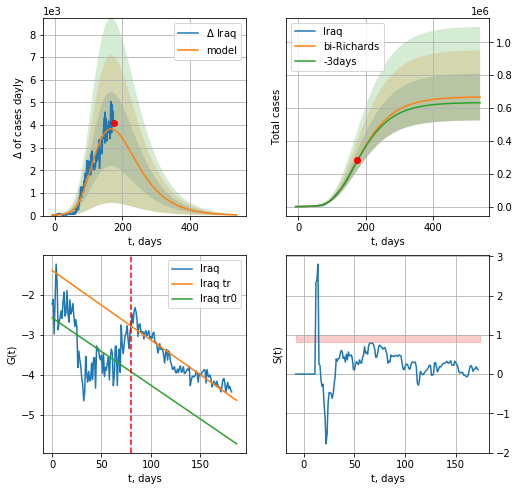

Iraq data at: 2020-09-12
+3 day model MAPE: 0.008575
model: bi-Richards
coeffs: [ 6.60329215e+05  1.06899939e+00 -9.88472446e+01  1.48028034e-02]
rational stdev: 0.213332
forecast at the end of period: +364 days
	 deltaDaycases: 29
	 total cases: 667156 ± 142325
	 total death: 18473 ± 11822
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.279962
 intercept: -2.575520
 slope: -0.016883
trend coefficient of determination: 0.879539
 intercept: -1.387803
 slope: -0.017411


In [2369]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2371]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [2372]:
#len(dfAR)

AR
           date    cases   active   death
188 2020-09-08  46938.0  12184.0  1571.0
189 2020-09-09  47216.0  12256.0  1581.0
190 2020-09-10  47488.0  12335.0  1591.0
191 2020-09-11  47752.0  12430.0  1599.0
192 2020-09-12  48007.0  12527.0  1605.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


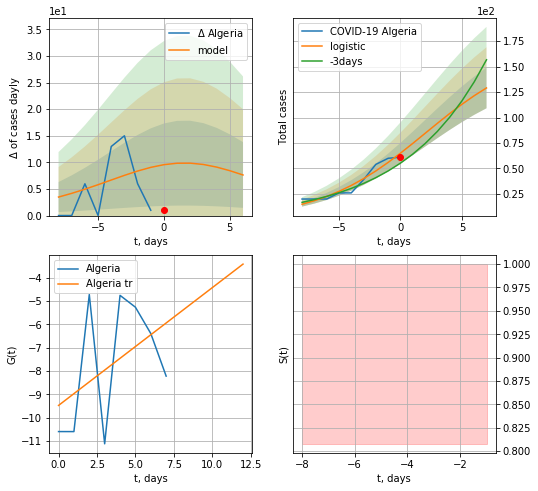

Algeria data at: 2020-09-12
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +7 days
	 deltaDaycases:  7
	 total cases:  129 ± 19
	 total death:  4 ± 1
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


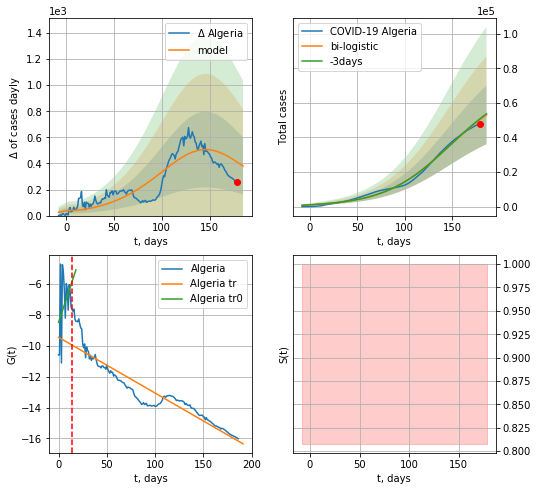

Algeria data at: 2020-09-12
+3 day model MAPE: 0.009760160104692574
model: bi-logistic
coeffs:  [6.79158312e+04 2.94158132e-02 1.45437415e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3196844000682862
forecast at the end of period: +7 days
	 deltaDaycases:  380
	 total cases:  53024 ± 16951
	 total death:  1772 ± 1699
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.872851
 intercept: -9.459146
 slope: -0.036062


In [2373]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


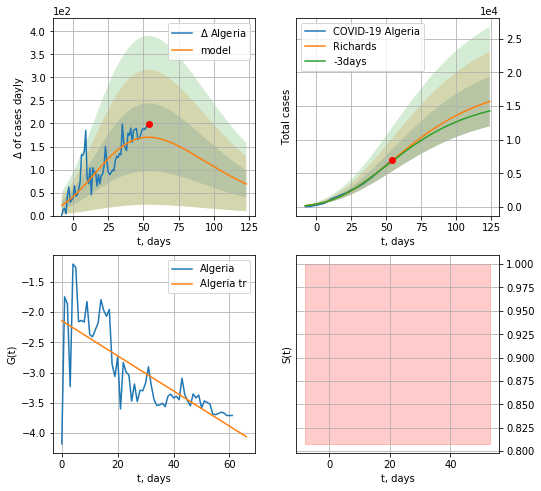

Algeria data at: 2020-09-12
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +70 days
	 deltaDaycases: 68
	 total cases: 15662 ± 3690
	 total death: 523 ± 369
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


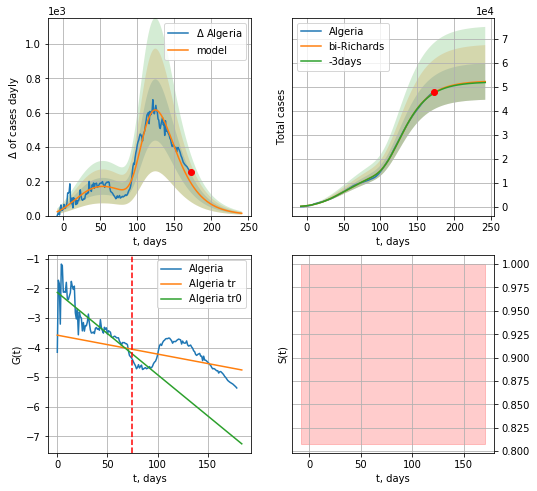

Algeria data at: 2020-09-12
+3 day model MAPE: 0.003961
model: bi-Richards
coeffs: [3.39541360e+04 3.79724707e+00 2.55530579e+01 1.16568142e-02]
rational stdev: 0.145503
forecast at the end of period: +70 days
	 deltaDaycases: 13
	 total cases: 52216 ± 7597
	 total death: 1745 ± 761
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.671842
 intercept: -2.140166
 slope: -0.027758
trend coefficient of determination: 0.163585
 intercept: -3.582521
 slope: -0.006377


In [2374]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


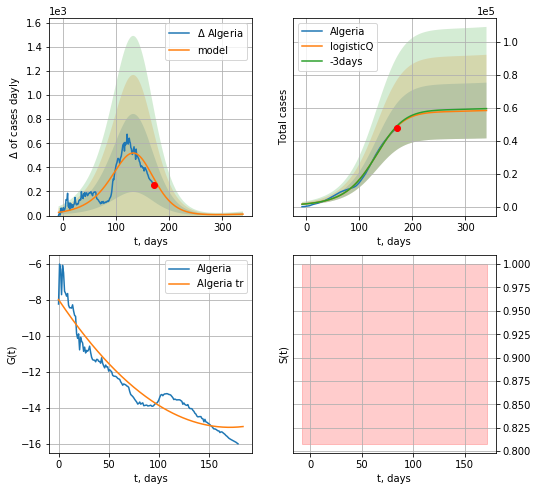

Algeria data at: 2020-09-12
+3 day model MAPE: 0.006943
model: logisticQ
coeffs: [ 5.74518858e+04  6.72686233e-05  1.27190639e+02 -4.03935335e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289685
forecast at the end of period: +168 days
	 deltaDaycases: 12
	 total cases: 58363 ± 16906
	 total death: 1951 ± 1695
trend coefficient of determination: 0.916905
 intercept_: -7.973904629887987
 coeffs_: [ 0.         -0.08345987  0.00024446]


In [2375]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
180 2020-09-08  1511.0   252.0   22.0
181 2020-09-09  1514.0   255.0   22.0
182 2020-09-10  1517.0   258.0   22.0
183 2020-09-11  1520.0   261.0   22.0
184 2020-09-12  1523.0   220.0   22.0


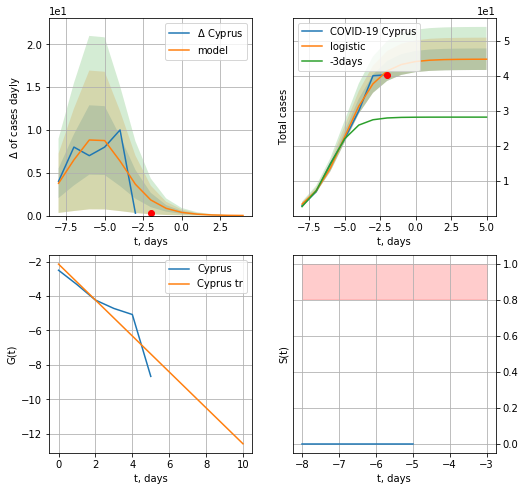

Cyprus data at: 2020-09-12
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


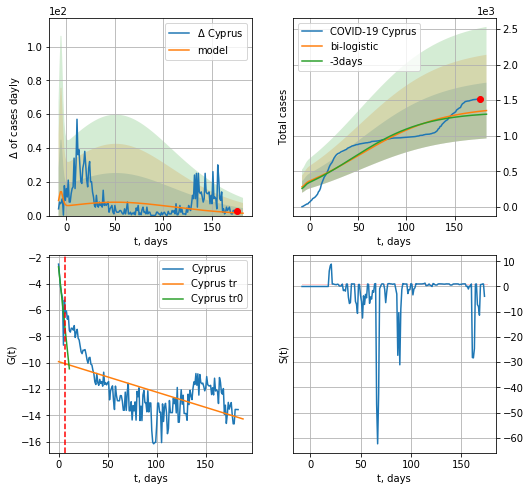

Cyprus data at: 2020-09-12
+3 day model MAPE: 0.03684478262040656
model: bi-logistic
coeffs:  [1.37182752e+03 2.31316073e-02 5.13808446e+01] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.2896527474614482
forecast at the end of period: +7 days
	 deltaDaycases:  1
	 total cases:  1354 ± 392
	 total death:  19 ± 16
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.332836
 intercept: -9.916012
 slope: -0.023158


In [2376]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


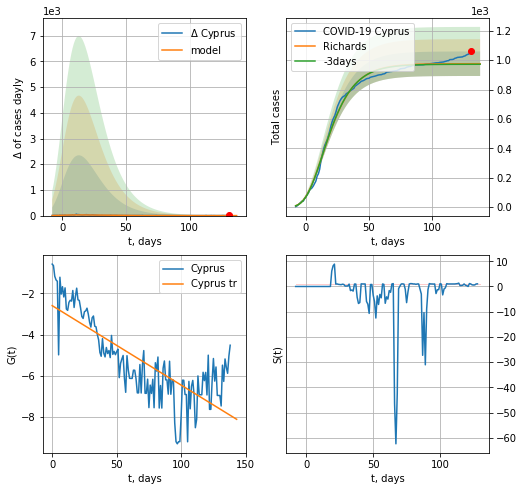

Cyprus data at: 2020-09-12
+3 day model MAPE: 0.003899
model: Richards
coeffs: [ 9.76316968e+02  1.29526584e+01 -5.80116939e+01  5.60254248e-03]
rational stdev: 0.085570
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 976 ± 83
	 total death: 14 ± 3
trend coefficient of determination: 0.611365
 intercept: -2.592811
 slope: -0.038703


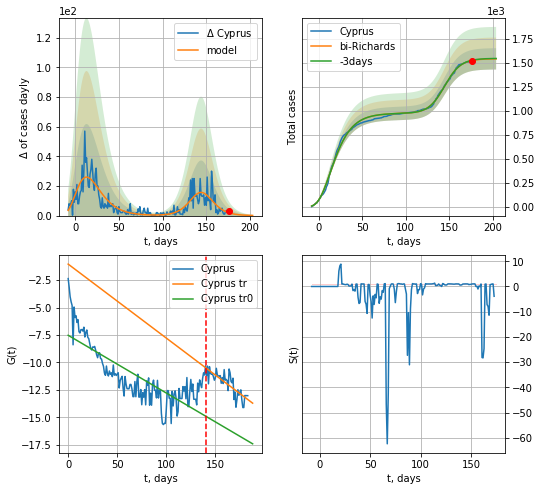

Cyprus data at: 2020-09-12
+3 day model MAPE: 0.001718
model: bi-Richards
coeffs: [5.68448028e+02 1.15936190e-01 1.43825698e+02 9.28209305e-01]
rational stdev: 0.071952
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1543 ± 111
	 total death: 22 ± 4
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.626703
 intercept: -7.530884
 slope: -0.052596
trend coefficient of determination: 0.652079
 intercept: -1.046789
 slope: -0.067385


In [2377]:
iL = 0
vL=140+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


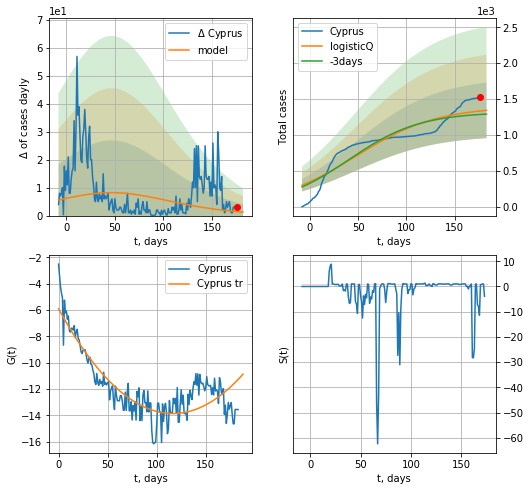

Cyprus data at: 2020-09-12
+3 day model MAPE: 0.037929
model: logisticQ
coeffs: [ 1.39833150e+03  2.34160936e-08  4.69824366e+01 -1.00477027e+06]
rational stdev: 0.288212
forecast at the end of period: +7 days
	 deltaDaycases: 1
	 total cases: 1343 ± 387
	 total death: 19 ± 16
trend coefficient of determination: 0.755034
 intercept_: -5.899864481405212
 coeffs_: [ 0.         -0.13660094  0.00058607]


In [2378]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active    death
185 2020-09-08  696190  136316.0  30123.0
186 2020-09-09  702776  135581.0  30236.0
187 2020-09-10  710067  134978.0  30344.0
188 2020-09-11  716670  133986.0  30470.0
189 2020-09-12  722832  132918.0  30593.0


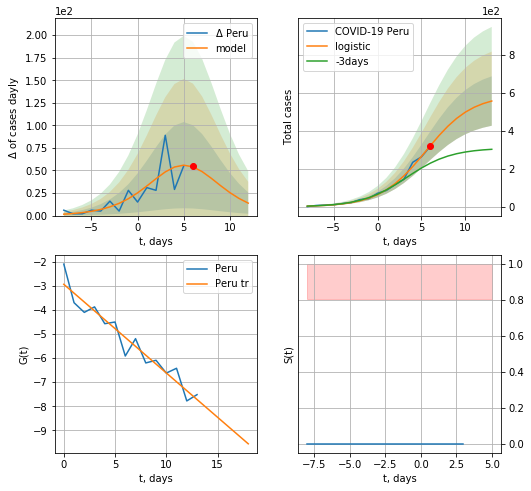

Peru data at: 2020-09-12
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +7 days
	 deltaDaycases:  13
	 total cases:  556 ± 130
	 total death:  23 ± 16
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


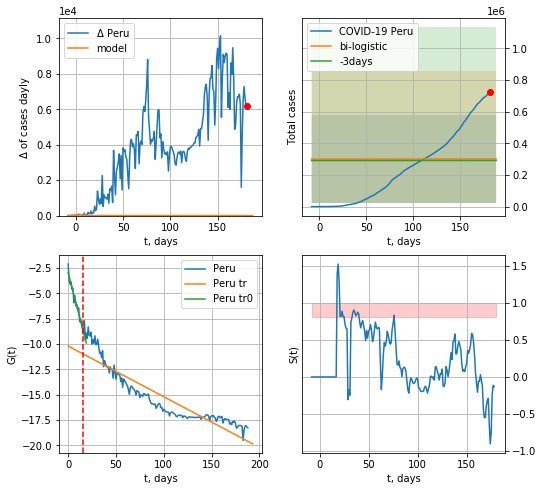

Peru data at: 2020-09-12
+3 day model MAPE: 0.03272509259103847
model: bi-logistic
coeffs:  [ 2.40319162e+05 -2.82656474e+01  6.80214193e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9233107873309929
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  300987 ± 277905
	 total death:  12738 ± 35283
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.839471
 intercept: -10.191161
 slope: -0.050000


In [2379]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


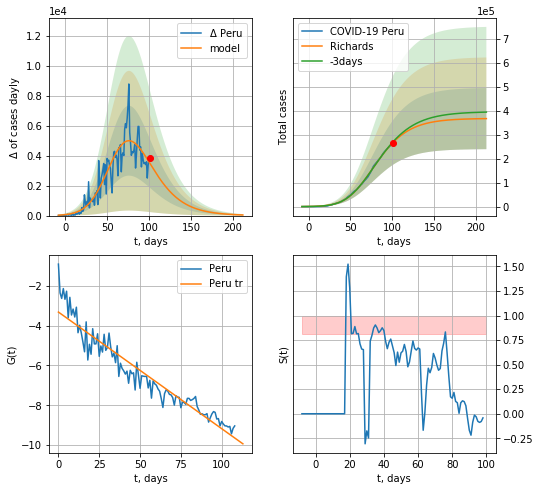

Peru data at: 2020-09-12
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +112 days
	 deltaDaycases: 41
	 total cases: 367551 ± 127687
	 total death: 15556 ± 16212
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


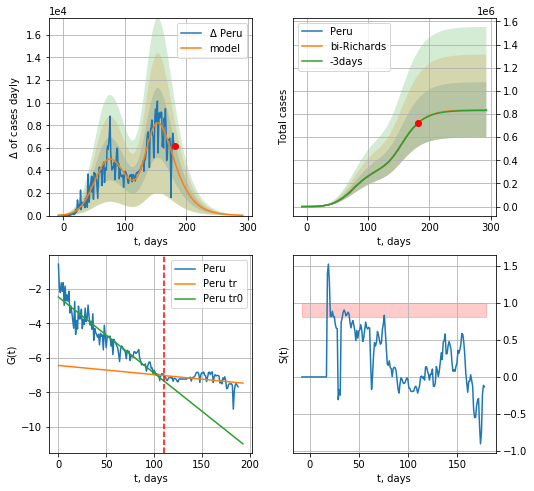

Peru data at: 2020-09-12
+3 day model MAPE: 0.001334
model: bi-Richards
coeffs: [4.68984909e+05 2.28704218e-01 1.24483444e+02 2.16052519e-01]
rational stdev: 0.285255
forecast at the end of period: +112 days
	 deltaDaycases: 27
	 total cases: 836907 ± 238731
	 total death: 35421 ± 30312
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.895278
 intercept: -2.481654
 slope: -0.044040
trend coefficient of determination: 0.150208
 intercept: -6.444212
 slope: -0.005297


In [2381]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [2382]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active    death
192 2020-09-08  4374314  901517.0  73953.0
193 2020-09-09  4465863  918989.0  75091.0
194 2020-09-10  4566726  947727.0  76336.0
195 2020-09-11  4663930  962018.0  77537.0
196 2020-09-12  4754356  973147.0  78614.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


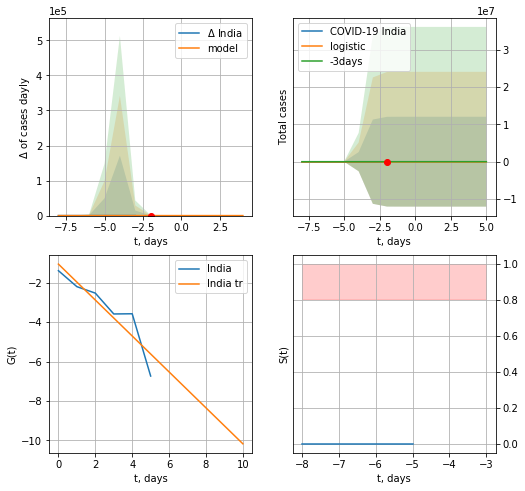

India data at: 2020-09-12
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


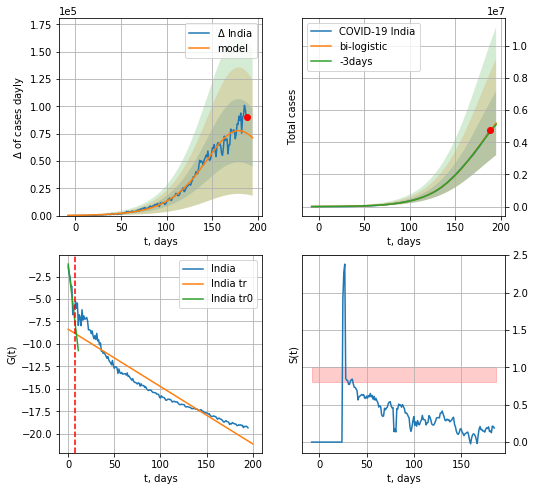

India data at: 2020-09-12
+3 day model MAPE: 0.011918574052931504
model: bi-logistic
coeffs:  [7.93835888e+06 3.90154176e-02 1.78918737e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.38393258019311466
forecast at the end of period: +7 days
	 deltaDaycases:  71219
	 total cases:  5188935 ± 1992201
	 total death:  85799 ± 98823
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.905940
 intercept: -8.361206
 slope: -0.063754


In [2383]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


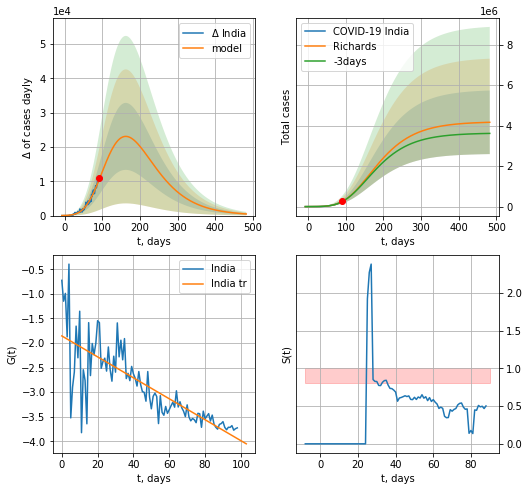

India data at: 2020-09-12
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +392 days
	 deltaDaycases: 474
	 total cases: 4166778 ± 1571313
	 total death: 68898 ± 77945
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


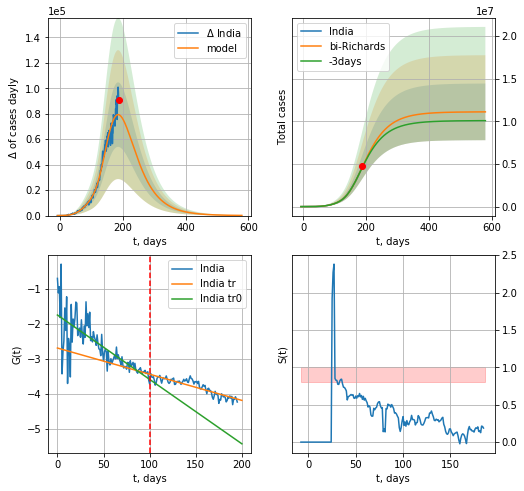

India data at: 2020-09-12
+3 day model MAPE: 0.012814
model: bi-Richards
coeffs: [6.92805105e+06 1.32142615e+00 1.04564160e+01 1.72322030e-02]
rational stdev: 0.298978
forecast at the end of period: +392 days
	 deltaDaycases: 129
	 total cases: 11117761 ± 3323964
	 total death: 183833 ± 164886
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.572945
 intercept: -1.748333
 slope: -0.018344
trend coefficient of determination: 0.782746
 intercept: -2.688705
 slope: -0.007458


In [2384]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2385]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases    active    death
188 2020-09-08  500034.0  123039.0  10405.0
189 2020-09-09  512293.0  119145.0  10658.0
190 2020-09-10  524198.0  123193.0  10907.0
191 2020-09-11  535705.0  124436.0  11148.0
192 2020-09-12  546481.0  125447.0  11263.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


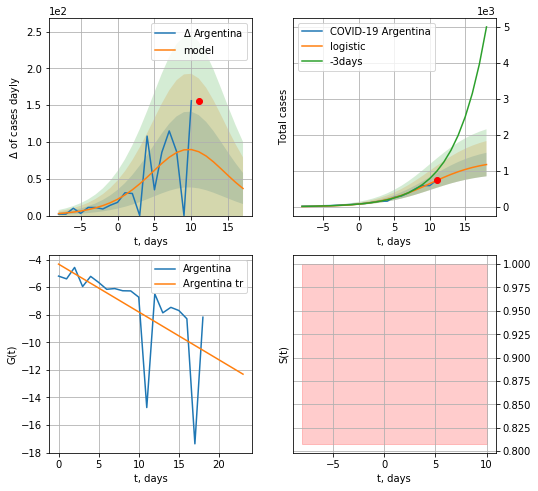

Argentina data at: 2020-09-12
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +7 days
	 deltaDaycases:  36
	 total cases:  1172 ± 325
	 total death:  24 ± 19
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


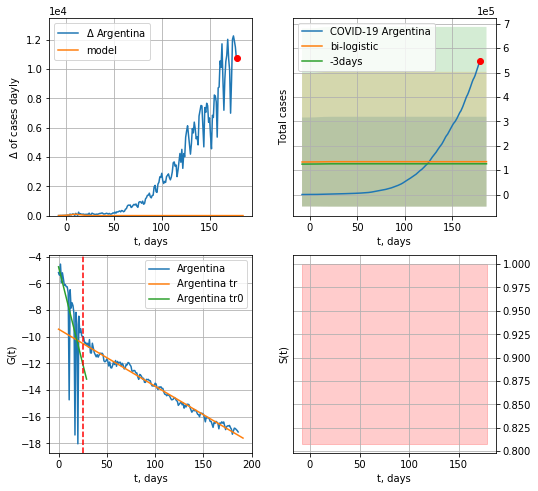

Argentina data at: 2020-09-12
+3 day model MAPE: 0.0688336206506897
model: bi-logistic
coeffs:  [ 1.06611491e+05 -9.05845607e+00  2.25127928e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3681604984251443
forecast at the end of period: +7 days
	 deltaDaycases:  0
	 total cases:  134570 ± 184113
	 total death:  2773 ± 11381
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.985812
 intercept: -9.437023
 slope: -0.042717


In [2386]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

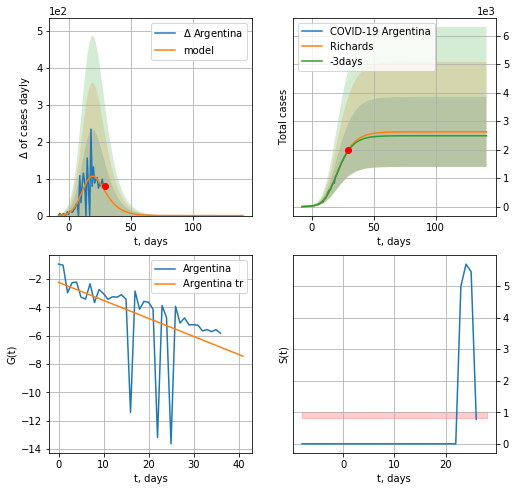

Argentina data at: 2020-09-12
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 54 ± 75
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


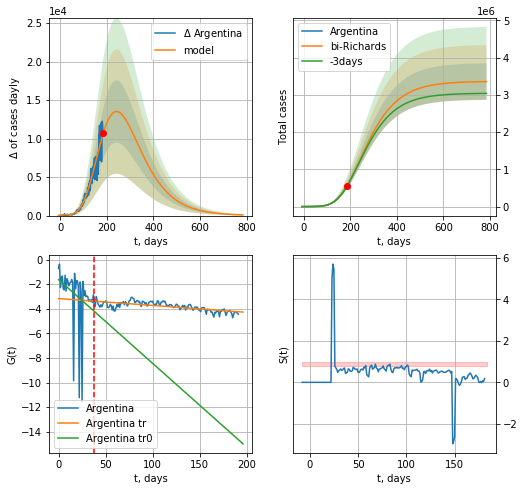

Argentina data at: 2020-09-12
+3 day model MAPE: 0.006391
model: bi-Richards
coeffs: [ 3.36142620e+06  2.84831096e-01 -4.89229361e+01  3.91680371e-02]
rational stdev: 0.145765
forecast at the end of period: +602 days
	 deltaDaycases: 86
	 total cases: 3356323 ± 489233
	 total death: 69173 ± 30248
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.091666
 intercept: -1.627488
 slope: -0.068136
trend coefficient of determination: 0.500154
 intercept: -3.169475
 slope: -0.005616


In [2388]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,110*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [2390]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


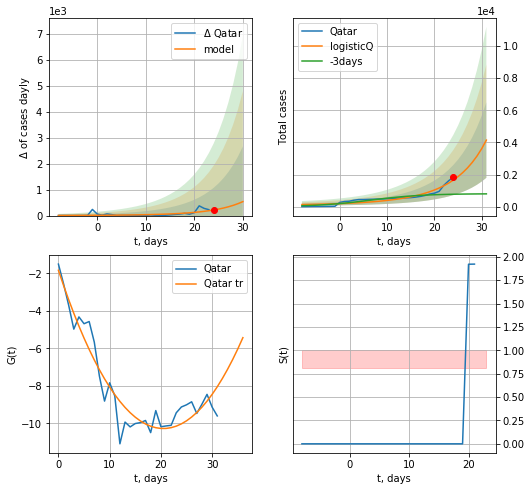

Qatar data at: 2020-09-12
+3 day model MAPE: 1.403665
model: logisticQ
coeffs: [ 4.67644951e+06  1.32940327e-03  6.79780107e+01 -1.11960184e+02]
rational stdev: 0.567221
forecast at the end of period: +7 days
	 deltaDaycases: 539
	 total cases: 4144 ± 2350
	 total death: 6 ± 10
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


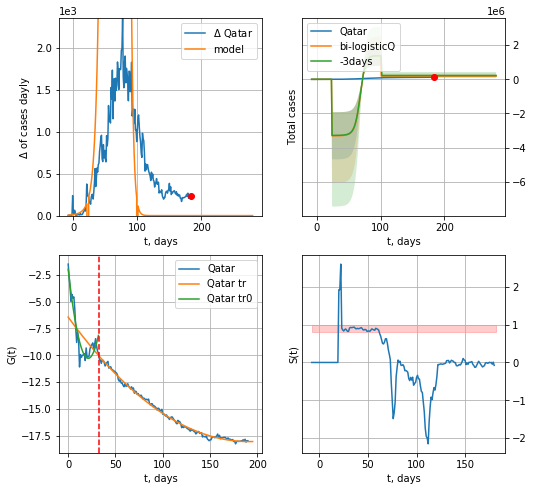

Qatar data at: 2020-09-12
+3 day model MAPE: 0.144093
model: bi-logisticQ
coeffs: [-3.31230318e+06  2.45480128e+00  2.30725655e+01 -2.63353464e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.417862
forecast at the end of period: +98 days
	 deltaDaycases: 0
	 total cases: 191028 ± 79823
	 total death: 322 ± 403
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.994516
 intercept_: -6.436820366460525
 coeffs_: [ 0.         -0.12165298  0.000319  ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [2391]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


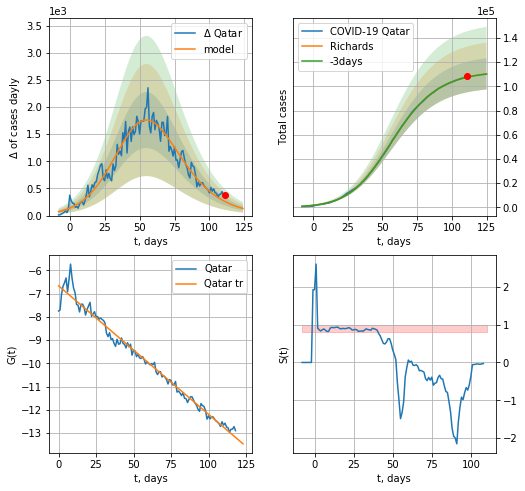

Qatar data at: 2020-09-12
+3 day model MAPE: 0.001516
model: Richards
coeffs: [1.12706951e+05 8.85775257e-02 4.66963678e+01 6.22812248e-01]
rational stdev: 0.117292
forecast at the end of period: +14 days
	 deltaDaycases: 131
	 total cases: 110340 ± 12942
	 total death: 186 ± 65
trend coefficient of determination: 0.978888
 intercept: -6.668569
 slope: -0.055185


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


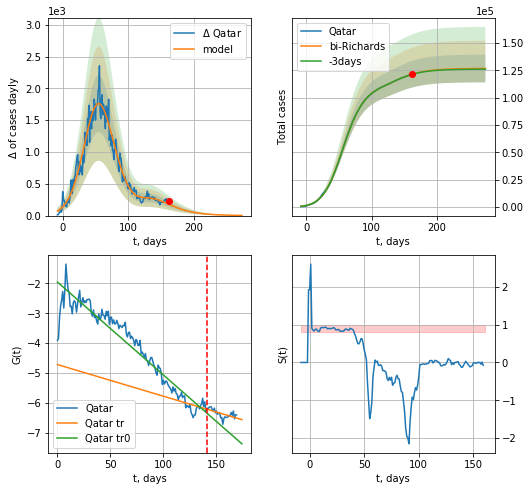

Qatar data at: 2020-09-12
+3 day model MAPE: 0.001017
model: bi-Richards
coeffs: [1.39735059e+04 3.01841721e+00 3.59077776e+01 1.34388271e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.099860
forecast at the end of period: +112 days
	 deltaDaycases: 2
	 total cases: 126613 ± 12643
	 total death: 213 ± 63
bi-Richards approximation splitting point: 141
trend coefficient of determination: 0.915665
 intercept: -1.956745
 slope: -0.031117
trend coefficient of determination: 0.400603
 intercept: -4.718115
 slope: -0.010599


In [2393]:
iL = 21
vL = 141 + iL
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [2394]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
206 2020-09-08  75098.0    7764  391.0
207 2020-09-09  75981.0    8229  393.0
208 2020-09-10  76911.0    8568  398.0
209 2020-09-11  77842.0    8982  398.0
210 2020-09-12  78849.0    9467  399.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


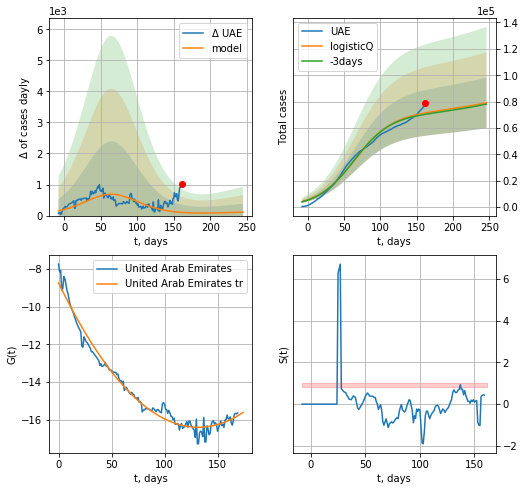

UAE data at: 2020-09-12
+3 day model MAPE: 0.015040
model: logisticQ
coeffs: [ 7.08006097e+04  8.14905746e-08  6.46406379e+01 -4.72656704e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.242548
forecast at the end of period: +84 days
	 deltaDaycases: 110
	 total cases: 79096 ± 19184
	 total death: 400 ± 291
trend coefficient of determination: 0.976879
 intercept_: -8.730285927015379
 coeffs_: [ 0.         -0.11646671  0.00044189]


In [2395]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


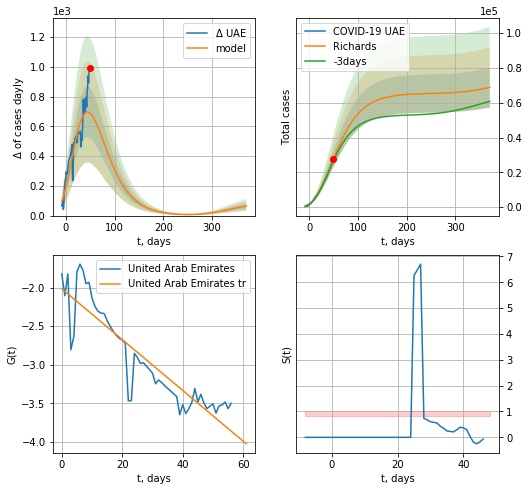

UAE data at: 2020-09-12
+3 day model MAPE: 0.033064
model: Richards
coeffs: [ 6.54730205e+04  1.80418558e+00 -9.61766575e+01  1.61791633e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.168241
forecast at the end of period: +322 days
	 deltaDaycases: 65
	 total cases: 68845 ± 11582
	 total death: 348 ± 175
trend coefficient of determination: 0.815296
 intercept: -2.016406
 slope: -0.032930


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


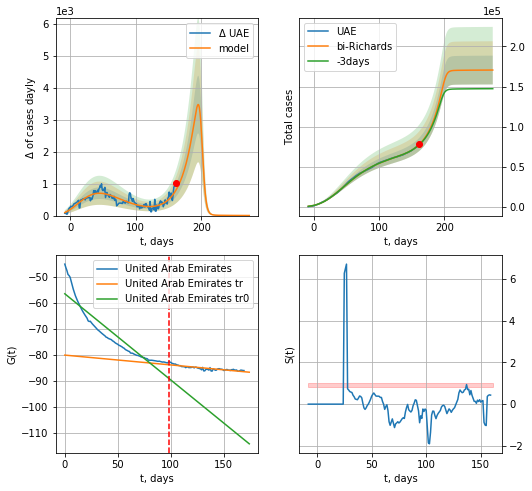

UAE data at: 2020-09-12
+3 day model MAPE: 0.006909
model: bi-Richards
coeffs: [1.05129242e+05 5.00103498e-02 2.01219854e+02 7.24546495e+00]
rational stdev: 0.105103
forecast at the end of period: +112 days
	 deltaDaycases: 2
	 total cases: 170520 ± 17922
	 total death: 862 ± 271
bi-Richards approximation splitting point: 98
trend coefficient of determination: 0.867522
 intercept: -56.607644
 slope: -0.330705
trend coefficient of determination: 0.752282
 intercept: -80.127410
 slope: -0.037671


In [2396]:
iL = 40
vL = 98 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [2397]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
189 2020-09-08  322237.0   19854  4137.0
190 2020-09-09  323012.0   19881  4165.0
191 2020-09-10  323720.0   19533  4189.0
192 2020-09-11  324407.0   19261  4213.0
193 2020-09-12  325050.0   18974  4240.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


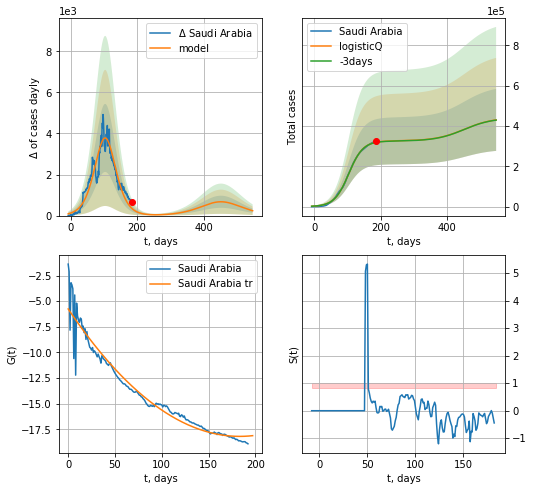

Saudi Arabia data at: 2020-09-12
+3 day model MAPE: 0.002550
model: logisticQ
coeffs: [ 3.26110222e+05  3.52760145e-07  1.03909103e+02 -1.31313145e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.357406
forecast at the end of period: +364 days
	 deltaDaycases: 236
	 total cases: 430498 ± 153862
	 total death: 5615 ± 6020
trend coefficient of determination: 0.948071
 intercept_: -5.761866952303569
 coeffs_: [ 0.         -0.1356748   0.00037021]


In [2398]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


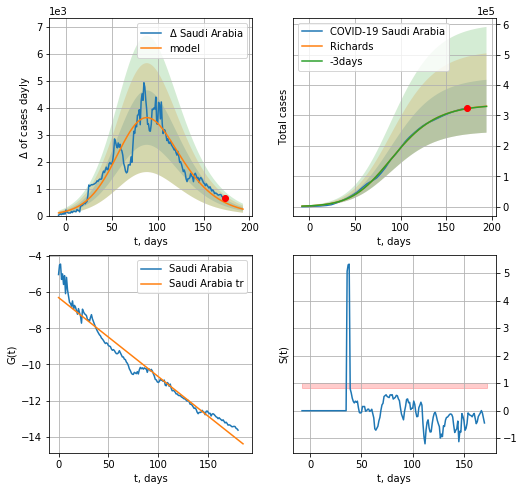

Saudi Arabia data at: 2020-09-12
+3 day model MAPE: 0.001391
model: Richards
coeffs: [3.36640616e+05 6.43437387e-02 7.42393645e+01 5.83137795e-01]
rational stdev: 0.263345
forecast at the end of period: +21 days
	 deltaDaycases: 239
	 total cases: 330282 ± 86978
	 total death: 4308 ± 3403
trend coefficient of determination: 0.958084
 intercept: -6.305937
 slope: -0.043659


In [2399]:
x = forecastRR('Saudi Arabia',dfSA[12:],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
182 2020-09-08  3140.0     182   12.0
183 2020-09-09  3147.0     189   12.0
184 2020-09-10  3155.0     188   12.0
185 2020-09-11  3169.0     188   12.0
186 2020-09-12  3195.0     200   12.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


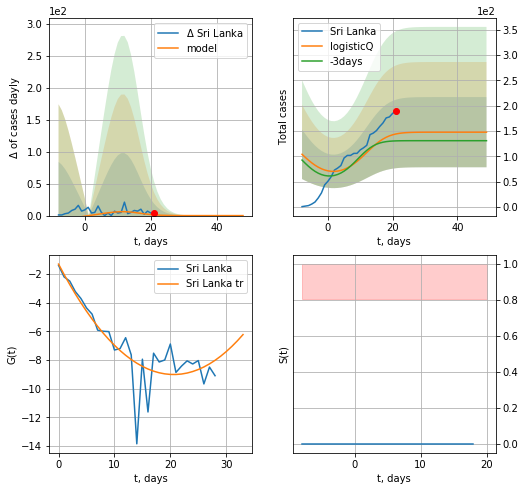

Sri Lanka data at: 2020-09-12
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp


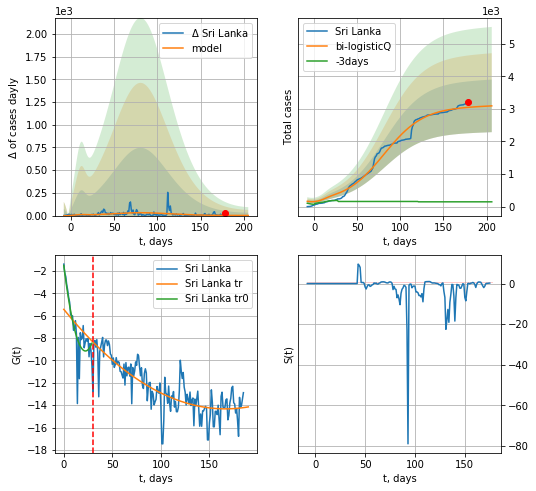

Sri Lanka data at: 2020-09-12
+3 day model MAPE: 19.606930
model: bi-logisticQ
coeffs: [ 2.91712511e+03  1.22111182e-07  8.10394647e+01 -3.57840280e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.261144
forecast at the end of period: +28 days
	 deltaDaycases: 1
	 total cases: 3091 ± 807
	 total death: 11 ± 8
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.657741
 intercept_: -5.4317847933823735
 coeffs_: [ 0.         -0.10683733  0.0003207 ]


In [2400]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

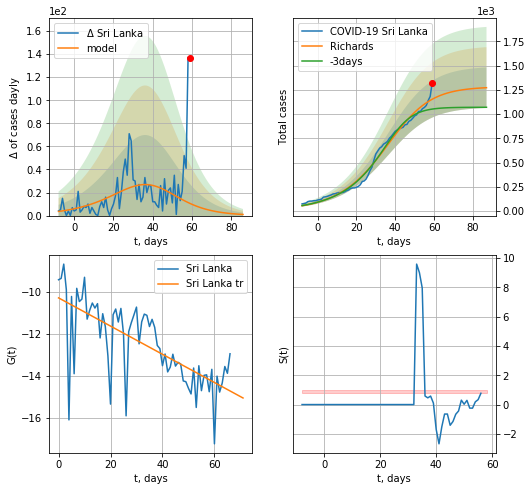

Sri Lanka data at: 2020-09-12
+3 day model MAPE: 0.103361
model: Richards
coeffs: [1.28171157e+03 6.47995832e-02 4.07030001e+01 1.48770145e+00]
rational stdev: 0.164364
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1271 ± 209
	 total death: 4 ± 1
trend coefficient of determination: 0.481079
 intercept: -10.284657
 slope: -0.067327


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


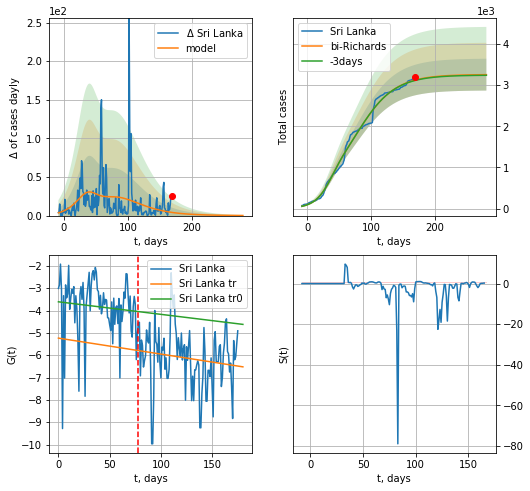

Sri Lanka data at: 2020-09-12
+3 day model MAPE: 0.003037
model: bi-Richards
coeffs: [ 1.97858635e+03  2.64711072e+00 -5.53461360e+01  1.19185747e-02]
rational stdev: 0.118793
forecast at the end of period: +112 days
	 deltaDaycases: 0
	 total cases: 3256 ± 386
	 total death: 12 ± 4
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.008909
 intercept: -3.609081
 slope: -0.005617
trend coefficient of determination: 0.022335
 intercept: -5.235532
 slope: -0.007145


In [2401]:
vL=88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
194 2020-09-08  299659.0    6794  6359.0
195 2020-09-09  299855.0    5540  6365.0
196 2020-09-10  300371.0    5795  6370.0
197 2020-09-11  300955.0    6046  6373.0
198 2020-09-12  301481.0    5673  6379.0


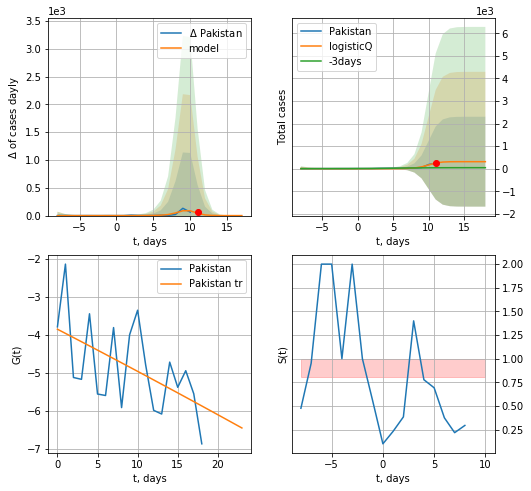

Pakistan data at: 2020-09-12
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


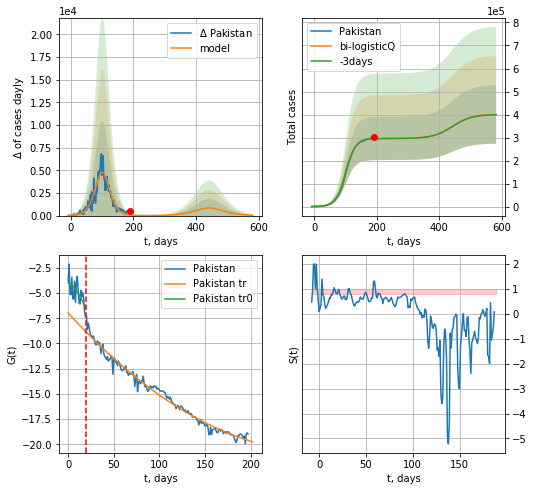

Pakistan data at: 2020-09-12
+3 day model MAPE: 0.002176
model: bi-logisticQ
coeffs: [ 2.96087784e+05  3.07053088e-06  1.01467215e+02 -2.09354341e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317070
forecast at the end of period: +392 days
	 deltaDaycases: 36
	 total cases: 400140 ± 126872
	 total death: 8466 ± 8052
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.983504
 intercept_: -6.972759263875126
 coeffs_: [ 0.         -0.09935194  0.00017882]


In [2402]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


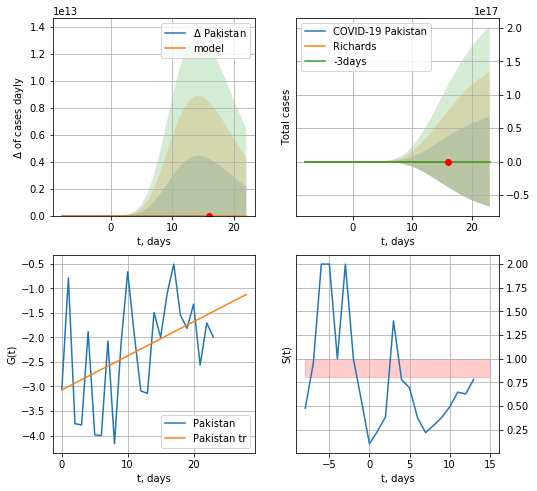

Pakistan data at: 2020-09-12
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
rational stdev: 49944222119087.820312
forecast at the end of period: +7 days
	 deltaDaycases: 55
	 total cases: 1343 ± 67092434766292208
	 total death: 28 ± 4195314658003377
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


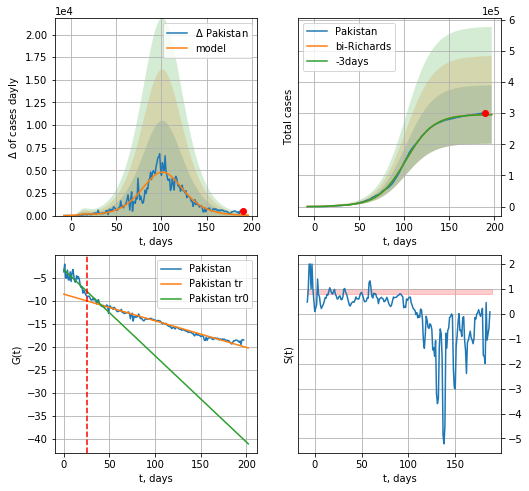

Pakistan data at: 2020-09-12
+3 day model MAPE: 0.002245
model: bi-Richards
coeffs: [2.94743392e+05 6.66873729e-02 1.00911169e+02 9.68203328e-01]
rational stdev: 0.317021
forecast at the end of period: +7 days
	 deltaDaycases: 40
	 total cases: 295767 ± 93764
	 total death: 6258 ± 5951
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.646151
 intercept: -3.275560
 slope: -0.187119
trend coefficient of determination: 0.972136
 intercept: -8.603049
 slope: -0.057818


In [2403]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
184 2020-09-08  329251.0   96890  4552.0
185 2020-09-09  331078.0   95681  4593.0
186 2020-09-10  332970.0   94786  4634.0
187 2020-09-11  334762.0   94070  4668.0
188 2020-09-12  336044.0   93071  4702.0


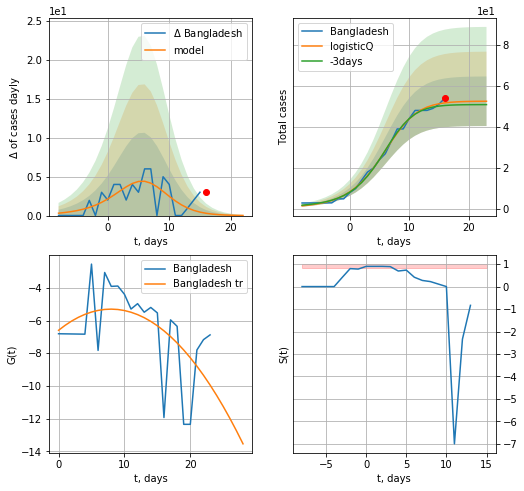

Bangladesh data at: 2020-09-12
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


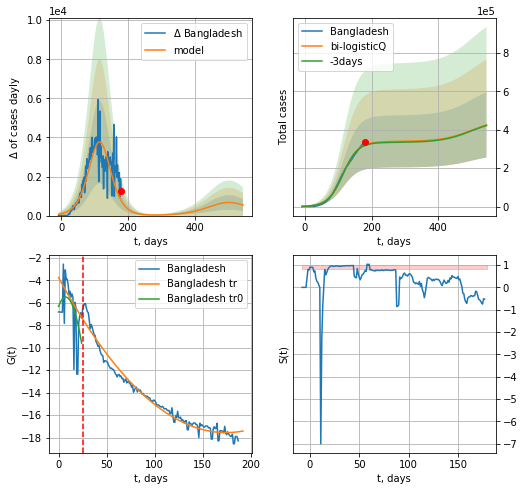

Bangladesh data at: 2020-09-12
+3 day model MAPE: 0.009493
model: bi-logisticQ
coeffs: [ 3.38917134e+05  1.87931373e-07  1.14988996e+02 -2.36564925e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399462
forecast at the end of period: +364 days
	 deltaDaycases: 540
	 total cases: 425713 ± 170056
	 total death: 5956 ± 7137
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.972115
 intercept_: -3.7454774265790025
 coeffs_: [ 0.         -0.15847009  0.00045449]


In [2404]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

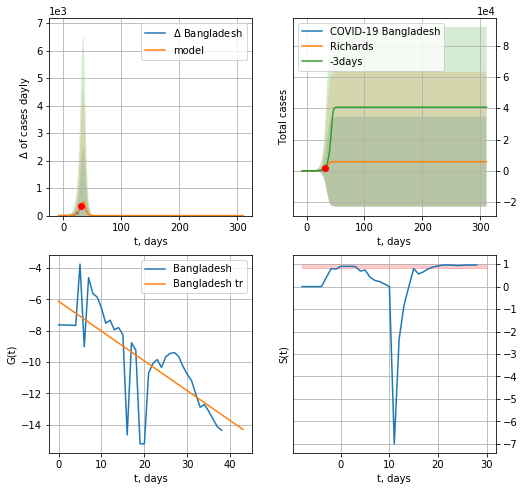

Bangladesh data at: 2020-09-12
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +280 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 81 ± 1194
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


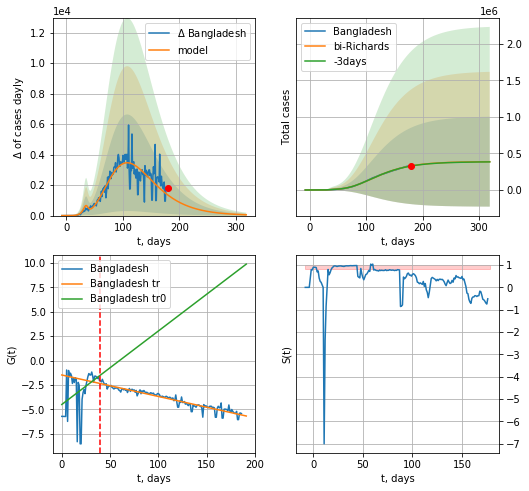

Bangladesh data at: 2020-09-12
+3 day model MAPE: 0.003820
model: bi-Richards
coeffs: [ 3.83557152e+05  1.49872782e+00 -5.77333193e+01  1.65185022e-02]
rational stdev: 1.586921
forecast at the end of period: +140 days
	 deltaDaycases: 51
	 total cases: 387332 ± 614665
	 total death: 5419 ± 25798
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.163571
 intercept: -4.506150
 slope: 0.075382
trend coefficient of determination: 0.914916
 intercept: -1.480213
 slope: -0.022030


In [2405]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
197 2020-09-08  91244.0    9042  548.0
198 2020-09-09  92082.0    9308  552.0
199 2020-09-10  92822.0    9226  556.0
200 2020-09-11  93475.0    9258  557.0
201 2020-09-12  94211.0    9249  558.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


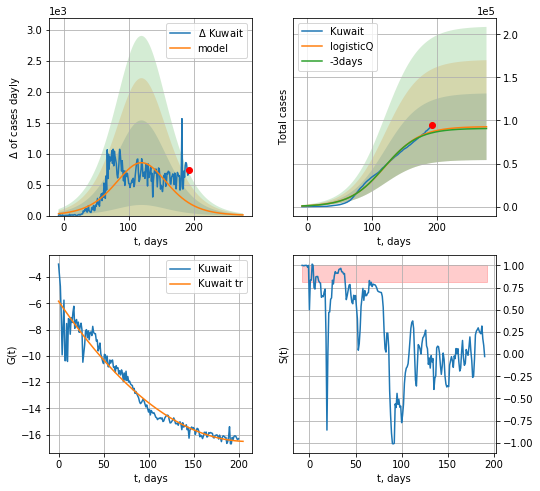

Kuwait data at: 2020-09-12
+3 day model MAPE: 0.015352
model: logisticQ
coeffs: [ 9.30129231e+04  1.03026364e-07  1.20149311e+02 -3.56850179e+05]
rational stdev: 0.416859
forecast at the end of period: +84 days
	 deltaDaycases: 10
	 total cases: 92723 ± 38652
	 total death: 549 ± 686
trend coefficient of determination: 0.944753
 intercept_: -5.830490772557518
 coeffs_: [ 0.         -0.10145586  0.00024069]


In [2406]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


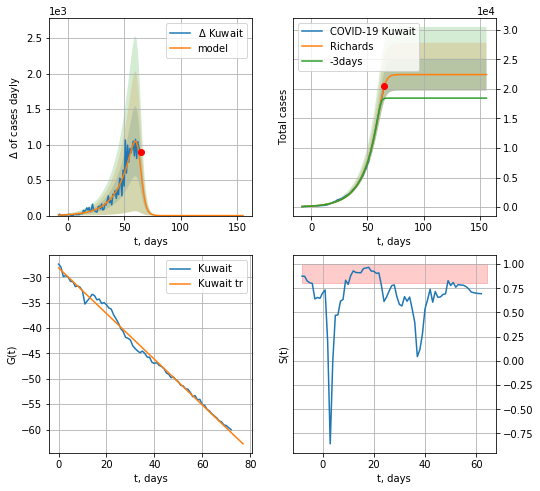

Kuwait data at: 2020-09-12
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +91 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 132 ± 47
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


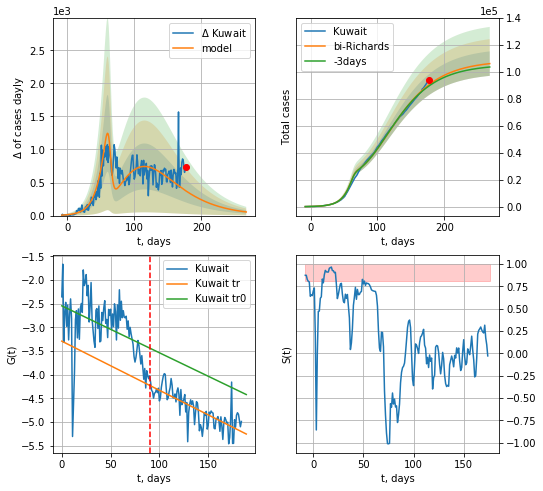

Kuwait data at: 2020-09-12
+3 day model MAPE: 0.010403
model: bi-Richards
coeffs: [ 8.61679277e+04  2.02178634e+00 -7.30768549e+01  1.16663261e-02]
rational stdev: 0.085497
forecast at the end of period: +91 days
	 deltaDaycases: 54
	 total cases: 106268 ± 9085
	 total death: 629 ± 161
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.172443
 intercept: -2.544210
 slope: -0.009908
trend coefficient of determination: 0.594290
 intercept: -3.290238
 slope: -0.010373


In [2407]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,37*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date     cases  active   death
191 2020-09-08  100131.0   24447  1889.0
192 2020-09-09  100937.0   24718  1914.0
193 2020-09-10  101716.0   24756  1926.0
194 2020-09-11  102232.0   24544  1941.0
195 2020-09-12  103092.0   24608  1953.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


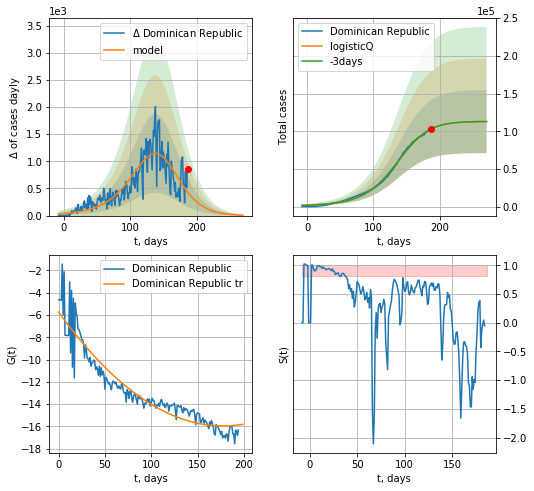

Dominican Republic data at: 2020-09-12
+3 day model MAPE: 0.000312
model: logisticQ
coeffs: [ 1.12958204e+05  6.98249671e-05  1.34104996e+02 -4.42405030e+02]
rational stdev: 0.370853
forecast at the end of period: +84 days
	 deltaDaycases: 7
	 total cases: 112834 ± 41845
	 total death: 2137 ± 2377
trend coefficient of determination: 0.890281
 intercept_: -5.735882887625854
 coeffs_: [ 0.         -0.11537789  0.00032507]


In [2408]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


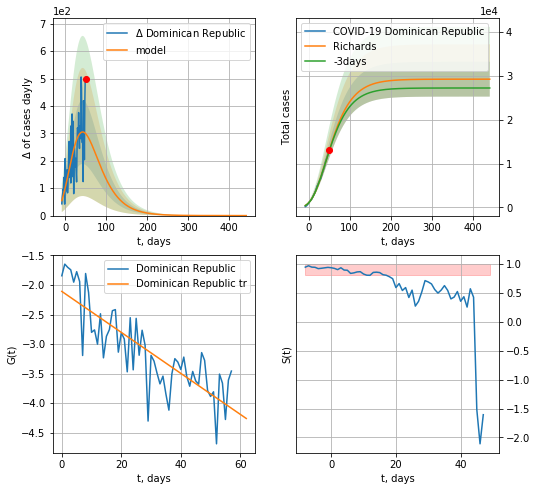

Dominican Republic data at: 2020-09-12
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +392 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 554 ± 225
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


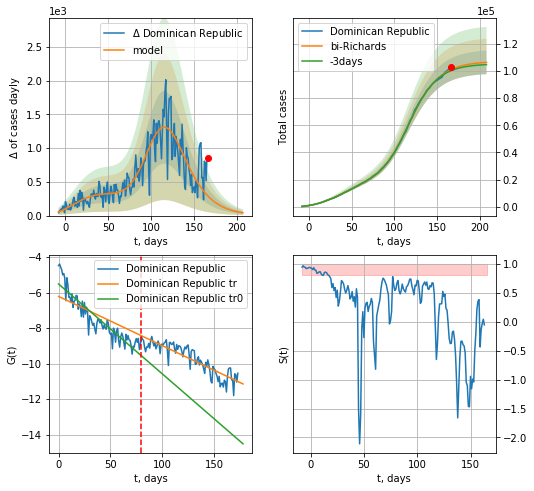

Dominican Republic data at: 2020-09-12
+3 day model MAPE: 0.008484
model: bi-Richards
coeffs: [7.79394671e+04 1.05716116e-01 1.03444775e+02 4.98412022e-01]
rational stdev: 0.081675
forecast at the end of period: +42 days
	 deltaDaycases: 41
	 total cases: 106313 ± 8683
	 total death: 2014 ± 493
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.843846
 intercept: -5.518336
 slope: -0.050533
trend coefficient of determination: 0.775145
 intercept: -6.217540
 slope: -0.027678


In [2409]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
185 2020-09-08  40556.0   10891  1087.0
186 2020-09-09  41144.0   11086  1096.0
187 2020-09-10  41704.0   11636  1106.0
188 2020-09-11  42183.0   10632  1114.0
189 2020-09-12  42714.0   11160  1117.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


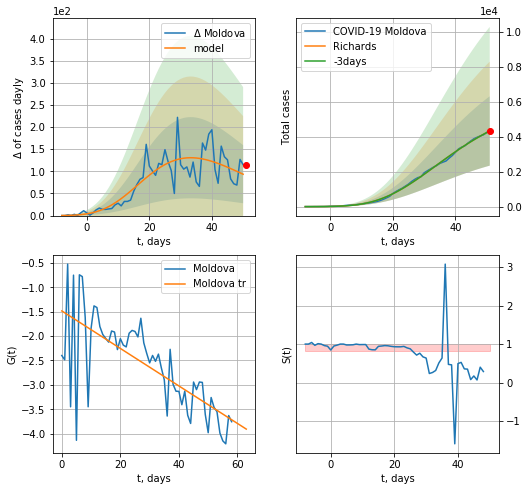

Moldova data at: 2020-09-12
Exception occurs


In [2410]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [2411]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
187 2020-09-08  640441.0   57626  15086.0
188 2020-09-09  642431.0   57328  15168.0
189 2020-09-10  644438.0   56170  15265.0
190 2020-09-11  646398.0   56433  15378.0
191 2020-09-12  648214.0   56364  15427.0


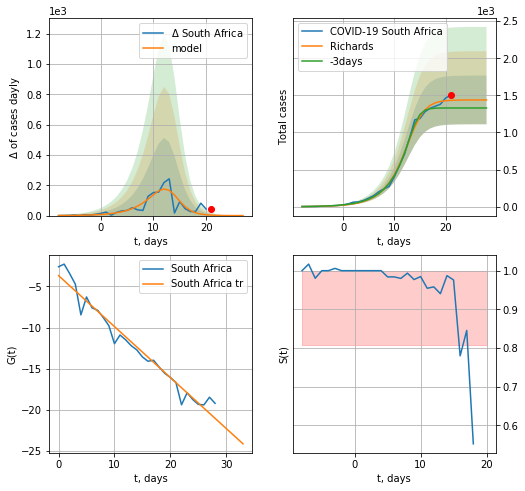

South Africa data at: 2020-09-12
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +7 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 34 ± 23
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


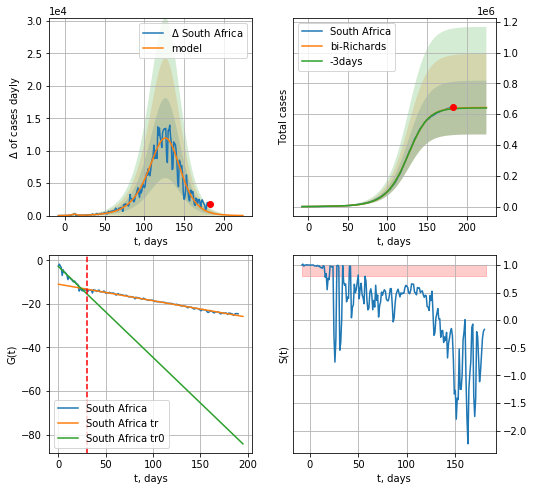

South Africa data at: 2020-09-12
+3 day model MAPE: 0.003716
model: bi-Richards
coeffs: [6.41934517e+05 5.97399648e-02 1.30917864e+02 1.39770374e+00]
rational stdev: 0.271262
forecast at the end of period: +42 days
	 deltaDaycases: 15
	 total cases: 643194 ± 174474
	 total death: 15307 ± 12456
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.940647
 intercept: -2.873876
 slope: -0.417321
trend coefficient of determination: 0.992047
 intercept: -10.989023
 slope: -0.075906


In [2412]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
177 2020-09-08  44557    2297  362.0
178 2020-09-09  45160    2580  368.0
179 2020-09-10  45927    2997  375.0
180 2020-09-11  46498    3093  382.0
181 2020-09-12  46850    2953  386.0


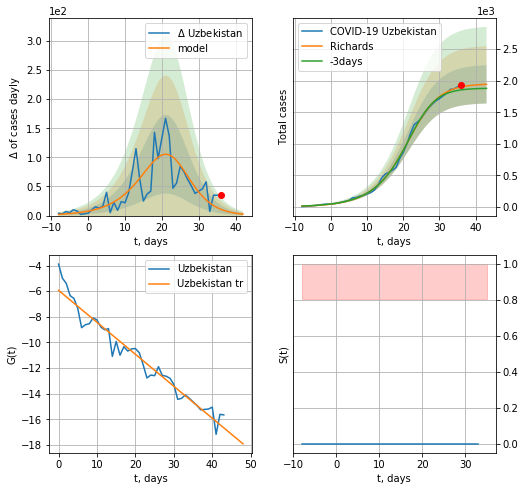

Uzbekistan data at: 2020-09-12
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +7 days
	 deltaDaycases: 2
	 total cases: 1942 ± 303
	 total death: 16 ± 7
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


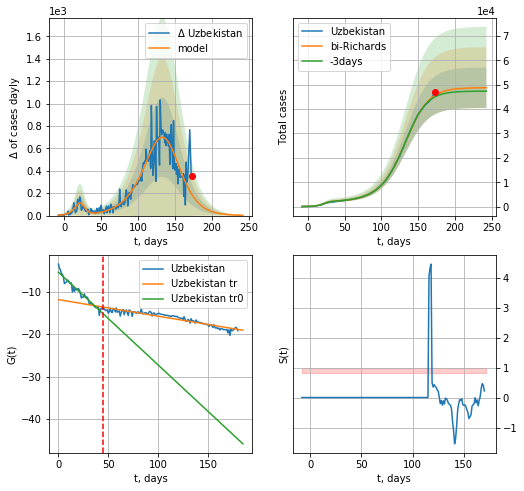

Uzbekistan data at: 2020-09-12
+3 day model MAPE: 0.014370
model: bi-Richards
coeffs: [4.68187193e+04 4.94965581e-02 1.37621533e+02 1.32867024e+00]
rational stdev: 0.170561
forecast at the end of period: +70 days
	 deltaDaycases: 2
	 total cases: 48735 ± 8312
	 total death: 401 ± 205
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.943346
 intercept: -5.362783
 slope: -0.218989
trend coefficient of determination: 0.895375
 intercept: -11.840575
 slope: -0.039052


In [2413]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [2018]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [2019]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,950,458","+6,789","289,160",431,"4,835,669","+5,032","2,825,629","18,336",,,,,,North America,\n,,
1,,\nAsia\n,"8,489,498","+7,970","162,628",96,"6,864,343","+26,714","1,462,527","19,357",,,,,,Asia,\n,,
2,,\nSouth America\n,"7,073,893",810,"227,166",47,"5,771,324","+1,556","1,075,403","15,251",,,,,,South America,\n,,
3,,\nEurope\n,"4,059,927","+10,127","212,433",140,"2,243,388","+4,579","1,604,106","6,426",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,352,693",,"32,556",,"1,096,779",,"223,358","1,486",,,,,,Africa,\n,,
5,,\nOceania\n,"29,967",46,843,7,"25,940",24,"3,184",25,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"28,957,157","+25,742","924,801",721,"20,838,094","+37,905","7,194,262","60,885","3,715",118.6,,,,All,\n,,
8,1,USA,"6,676,601",,"198,128",,"3,950,354",,"2,528,119","14,366","20,147",598,"91,703,503","276,720","331,393,984",North America,50,"1,673",4
9,2,India,"4,754,356","+2,568","78,614",,"3,702,595","+3,297","973,147","8,944","3,438",57,"56,260,928","40,689","1,382,715,488",Asia,291,"17,589",25


In [2020]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,950,458","+6,789","289,160",431,"4,835,669","+5,032","2,825,629","18,336",,,,,,North America,\n,,
1,,\nAsia\n,"8,489,498","+7,970","162,628",96,"6,864,343","+26,714","1,462,527","19,357",,,,,,Asia,\n,,
2,,\nSouth America\n,"7,073,893",810,"227,166",47,"5,771,324","+1,556","1,075,403","15,251",,,,,,South America,\n,,
3,,\nEurope\n,"4,059,927","+10,127","212,433",140,"2,243,388","+4,579","1,604,106","6,426",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,352,693",,"32,556",,"1,096,779",,"223,358","1,486",,,,,,Africa,\n,,


In [2021]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
136,129,Lithuania,"3,335",39,86,,"2,070",,"1,179",,"1,229",32,"694,139","255,733","2,714,310",Europe,814,"31,562",4
369,130,Lithuania,"3,296",53,86,,"2,070",21,"1,140",,"1,214",32,"692,223","255,027","2,714,310",Europe,824,"31,562",4
601,130,Lithuania,"3,243",44,86,,"2,049",19,"1,108",,"1,195",32,"687,118","253,146","2,714,310",Europe,837,"31,562",4


In [2022]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [2023]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"7,950,458","+6,789","289,160",431,"4,835,669","+5,032","2,825,629","18,336",,,,,,North America,\n,,
1,,\nAsia\n,"8,489,498","+7,970","162,628",96,"6,864,343","+26,714","1,462,527","19,357",,,,,,Asia,\n,,
2,,\nSouth America\n,"7,073,893",810,"227,166",47,"5,771,324","+1,556","1,075,403","15,251",,,,,,South America,\n,,
3,,\nEurope\n,"4,059,927","+10,127","212,433",140,"2,243,388","+4,579","1,604,106","6,426",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,352,693",,"32,556",,"1,096,779",,"223,358","1,486",,,,,,Africa,\n,,
5,,\nOceania\n,"29,967",46,843,7,"25,940",24,"3,184",25,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"28,957,157","+25,742","924,801",721,"20,838,094","+37,905","7,194,262","60,885","3,715",118.6,,,,All,\n,,
8,1,USA,"6,676,601",,"198,128",,"3,950,354",,"2,528,119","14,366","20,147",598,"91,703,503","276,720","331,393,984",North America,50,"1,673",4
9,2,India,"4,754,356","+2,568","78,614",,"3,702,595","+3,297","973,147","8,944","3,438",57,"56,260,928","40,689","1,382,715,488",Asia,291,"17,589",25


In [2024]:
df.at[21, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[45, 'TotalRecovered'] = 0
df.at[48, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[21,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[45,"ActiveCases"] = 0
df.at[48,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [2025]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,7950458,6789.0,289160.0,431.0,4835669.0,"+5,032",2825629,18336.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,8489498,7970.0,162628.0,96.0,6864343.0,"+26,714",1462527,19357.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,7073893,810.0,227166.0,47.0,5771324.0,"+1,556",1075403,15251.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1352693,NaN,32556.0,NaN,1096779.0,,223358,1486.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,29967,46.0,843.0,7.0,25940.0,24,3184,25.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,28957157,25742.0,924801.0,721.0,20838094.0,"+37,905",7194262,60885.0,3715.0,118.6,NaN,NaN,,All,\n,,
8,1,USA,6676601,NaN,198128.0,NaN,3950354.0,,2528119,14366.0,20147.0,598.0,91703503.0,276720.0,"331,393,984",North America,50,"1,673",4
9,2,India,4754356,2568.0,78614.0,NaN,3702595.0,"+3,297",973147,8944.0,3438.0,57.0,56260928.0,40689.0,"1,382,715,488",Asia,291,"17,589",25


In [2026]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,,Total:,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,,Europe,,,
227,,Total:,1352693,NaN,32556.0,NaN,1096779.0,,223358,1486.0,NaN,NaN,NaN,NaN,,Africa,,,
228,,Total:,29967,46.0,843.0,7.0,25940.0,24,3184,25.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
229,,Total:,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,,,
230,NaN,European Union,2208576,2202.0,142236.0,16.0,851158.0,NaN,512814,3235.0,4960.29972,319.451624,68516076.0,153882.081762,NaN,Europe,NaN,NaN,NaN


In [2027]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,7950458,6789.0,289160.0,431.0,4835669.0,"+5,032",2825629,18336.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,8489498,7970.0,162628.0,96.0,6864343.0,"+26,714",1462527,19357.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,7073893,810.0,227166.0,47.0,5771324.0,"+1,556",1075403,15251.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1352693,NaN,32556.0,NaN,1096779.0,,223358,1486.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [2028]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [2029]:
#df

In [2030]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,7950458,6789.0,289160.0,431.0,4835669.0,"+5,032",2825629,18336.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,8489498,7970.0,162628.0,96.0,6864343.0,"+26,714",1462527,19357.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,7073893,810.0,227166.0,47.0,5771324.0,"+1,556",1075403,15251.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,4059927,10127.0,212433.0,140.0,2243388.0,"+4,579",1604106,6426.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1352693,NaN,32556.0,NaN,1096779.0,,223358,1486.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,29967,46.0,843.0,7.0,25940.0,24,3184,25.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,28957157,25742.0,924801.0,721.0,20838094.0,"+37,905",7194262,60885.0,3715.0,118.6,NaN,NaN,,All,\n,,
8,1,USA,6676601,NaN,198128.0,NaN,3950354.0,,2528119,14366.0,20147.0,598.0,91703503.0,276720.0,"331,393,984",North America,50,"1,673",4
9,2,India,4754356,2568.0,78614.0,NaN,3702595.0,"+3,297",973147,8944.0,3438.0,57.0,56260928.0,40689.0,"1,382,715,488",Asia,291,"17,589",25
10,3,Brazil,4315858,NaN,131274.0,NaN,3553421.0,,631163,8318.0,20275.0,617.0,14505652.0,68145.0,"212,863,206",South America,49,"1,622",15


In [2031]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [2032]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [2033]:
len(countryDic)

76

In [2034]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-09-12,7950458,2825629,289160.0
Asia
Asia
Asia 2020-09-12,8489498,1462527,162628.0
South America
South America
South America 2020-09-12,7073893,1075403,227166.0
Europe
Europe
Europe 2020-09-12,4059927,1604106,212433.0
Africa
Africa
Africa 2020-09-12,1352693,223358,32556.0
Oceania
Oceania
Oceania 2020-09-12,29967,3184,843.0
World
World
World 2020-09-12,28957157,7194262,924801.0
USA
USA
USA 2020-09-12,6676601,2528119,198128.0
India
India
India 2020-09-12,4754356,973147,78614.0
Brazil
Brazil
Brazil 2020-09-12,4315858,631163,131274.0
Russia
Russia
Russia 2020-09-12,1062811,168008,18578.0
Peru
Peru
Peru 2020-09-12,722832,132918,30593.0
Colombia
Colombia
Colombia 2020-09-12,708964,93410,22734.0
Mexico
Mexico
Mexico 2020-09-12,663973,125844,70604.0
South Africa
South Africa
South Africa 2020-09-12,648214,56364,15427.0
Spain
Spain
Spain 2020-09-12,576697,0,29747.0
Argentina
Argentina
Argentina 2020-09-12,546481,125447,11263.0
Chile
Chile
Chile 2020

Tanzania
Tanzania
Tanzania 2020-09-12,509,305,21.0
Papua New Guinea
Papua New Guinea
Papua New Guinea 2020-09-12,508,271,5.0
Taiwan
Taiwan
Taiwan 2020-09-12,498,16,7.0
Burundi
Burundi
Burundi 2020-09-12,471,96,1.0
Comoros
Comoros
Comoros 2020-09-12,456,34,7.0
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-09-12,418,8,nan
Mauritius
Mauritius
Mauritius 2020-09-12,361,16,10.0
Eritrea
Eritrea
Eritrea 2020-09-12,361,57,nan
Isle of Man
Isle of Man
Isle of Man 2020-09-12,337,1,24.0
Gibraltar
Gibraltar
Gibraltar 2020-09-12,327,33,nan
Mongolia
Mongolia
Mongolia 2020-09-12,311,13,nan
Cambodia
Cambodia
Cambodia 2020-09-12,275,1,nan
Saint Martin
Saint Martin
Saint Martin 2020-09-12,256,143,6.0
Bhutan
Bhutan
Bhutan 2020-09-12,244,85,nan
Cayman Islands
Cayman Islands
Cayman Islands 2020-09-12,208,3,1.0
Barbados
Barbados
Barbados 2020-09-12,180,15,7.0
Bermuda
Bermuda
Bermuda 2020-09-12,177,7,9.0
Monaco
Monaco
Monaco 2020-09-12,169,45,1.0
Brunei 
Brunei 
Brunei  2020-09-12,145,3,3.0
Curaçao
Curaçao

In [2035]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [2036]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-09-12,6676601,2528119,198128.0

append data/coronaIT.csv 2020-09-12,286297,37503,35603.0

append data/coronaSP.csv 2020-09-12,576697,0,29747.0

append data/coronaGR.csv 2020-09-12,260546,15819,9427.0

append data/coronaFR.csv 2020-09-12,373911,253942,30910.0

append data/coronaIN.csv 2020-09-12,399940,32395,23029.0

append data/coronaGB.csv 2020-09-12,365174,0,41623.0

append data/coronaSZ.csv 2020-09-12,46704,6184,2020.0

append data/coronaKR.csv 2020-09-12,22176,3592,358.0

append data/coronaNG.csv 2020-09-12,12079,1443,265.0

append data/coronaSW.csv 2020-09-12,86505,0,5846.0

append data/coronaIS.csv 2020-09-12,153217,37490,1103.0

append data/coronaDK.csv 2020-09-12,19557,2680,630.0

append data/coronaPL.csv 2020-09-12,73650,10809,2182.0

append data/coronaES.csv 2020-09-12,2676,356,64.0

append data/coronaUkr.csv 2020-09-12,154335,82264,3178.0

append data/coronaLV.csv 2020-09-12,1474,191,35.0

append data/coronaLT.csv 2020-09-12,3335,1179,86.0

appe

In [2037]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [2038]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 38606


In [2039]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [2040]:
dfc.head()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
190,2020-02-25,25,2,2020,1,0,Afghanistan,AF,AFG,38041757.0,Asia,0.002629
183,2020-03-08,8,3,2020,4,0,Afghanistan,AF,AFG,38041757.0,Asia,0.010515
182,2020-03-11,11,3,2020,7,0,Afghanistan,AF,AFG,38041757.0,Asia,0.018401
181,2020-03-15,15,3,2020,10,0,Afghanistan,AF,AFG,38041757.0,Asia,0.026287
180,2020-03-16,16,3,2020,16,0,Afghanistan,AF,AFG,38041757.0,Asia,0.042059


In [2041]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [816]:
len(countriesEU)

27

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [ ]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

In [ ]:
TT/7.7776e3

In [ ]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

In [ ]:
sum(dfp.Population)/1e6

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [ ]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

In [ ]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

In [ ]:
#dfAll

In [ ]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

In [ ]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [ ]:
len(CList)

In [ ]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400